In [785]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
#yesterday1 = date.today() - timedelta(days=3)
d12f = lambda x:(date.today() - timedelta(days=x)).strftime("%Y-%m-%d")

countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
RkoreaCoeffs=[ 0.36242246,  2.56241634,  1.84890887,  0.13324732]
%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="pictures/coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("data/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

165


In [786]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    locStr = 'upper left'
    if Cntr in ['New Zealand']:
        locStr = 'lower right'
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc=locStr) 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RRR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))+coeffsUS[4]/(1 + np.exp( - coeffsUS[5] * (t - coeffsUS[6])* (t - coeffsUS[7])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.01 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSQ1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSQ1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL[1], np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL[1]]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS0(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS1(dfLV,vL=[0,1],pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [787]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])**0.5*(t- coeffs[3])**0.5 )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'RichardsQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_QR.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_QR.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: RichardsQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x


def forecast2RR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL,nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-Richards approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases',zoom=1.):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7]*coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop/4,  2.61212092e+01, -9.65961409e-01,  5.96529356e-03], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    if zoom != 1.:
        ax3.set_ylim([0,zoom])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL[1],nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL[0],nu=x[3])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSS1(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2QR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])+coeffsUS[0]/(1 + np.exp( - coeffsUS[4]*coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))**(1./coeffsUS[4])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

In [817]:
dfp = pd.read_csv("data/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly\nChange,Net\nChange,Density\n(P/Km²),Land Area\n(Km²),Migrants\n(net),Fert.\nRate,Med.\nAge,Urban\nPop %,World\nShare
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [818]:
popEU = sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

In [819]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("data/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [820]:
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,NaN,North America,7790513,5225.0,284506.0,629.0,4704062.0,"+4,776",2801945,18553.0,NaN,NaN,NaN,NaN,NaN,North America,\n,NaN,NaN
1,NaN,Asia,8106017,5515.0,157230.0,14.0,6546947.0,"+6,579",1401840,19243.0,NaN,NaN,NaN,NaN,NaN,Asia,\n,NaN,NaN
2,NaN,South America,6862894,1037.0,222322.0,49.0,5566454.0,"+2,118",1074118,15022.0,NaN,NaN,NaN,NaN,NaN,South America,\n,NaN,NaN
3,NaN,Europe,3917579,8971.0,211328.0,179.0,2205268.0,"+7,128",1500983,6208.0,NaN,NaN,NaN,NaN,NaN,Europe,\n,NaN,NaN
4,NaN,Africa,1328263,NaN,31962.0,NaN,1063653.0,NaN,232648,1468.0,NaN,NaN,NaN,NaN,NaN,Africa,\n,NaN,NaN


In [821]:
df.tail()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
225,NaN,Total:,3917579,8971.0,211328.0,179.0,2205268.0,"+7,128",1500983,6208.0,NaN,NaN,NaN,NaN,NaN,Europe,,NaN,NaN
226,NaN,Total:,1328263,NaN,31962.0,NaN,1063653.0,NaN,232648,1468.0,NaN,NaN,NaN,NaN,NaN,Africa,,NaN,NaN
227,NaN,Total:,29662,53.0,819.0,7.0,25493.0,182,3350,31.0,NaN,NaN,NaN,NaN,NaN,Australia/Oceania,,NaN,NaN
228,NaN,Total:,721,NaN,15.0,NaN,651.0,NaN,55,4.0,NaN,NaN,NaN,NaN,NaN,NaN,,NaN,NaN
229,NaN,European Union,2107705,1026.0,141713.0,7.0,835123.0,NaN,465638,3017.0,4733.750852,318.277005,65891240.0,147986.89261,NaN,Europe,NaN,NaN,NaN


In [822]:
dfAll.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,NaN,North America,7790513,5225.0,284506.0,629.0,4704062.0,"+4,776",2801945,18553.0,NaN,NaN,NaN,NaN,NaN,North America,\n,NaN,NaN
1,NaN,Asia,8106017,5515.0,157230.0,14.0,6546947.0,"+6,579",1401840,19243.0,NaN,NaN,NaN,NaN,NaN,Asia,\n,NaN,NaN
2,NaN,South America,6862894,1037.0,222322.0,49.0,5566454.0,"+2,118",1074118,15022.0,NaN,NaN,NaN,NaN,NaN,South America,\n,NaN,NaN
3,NaN,Europe,3917579,8971.0,211328.0,179.0,2205268.0,"+7,128",1500983,6208.0,NaN,NaN,NaN,NaN,NaN,Europe,\n,NaN,NaN
4,NaN,Africa,1328263,NaN,31962.0,NaN,1063653.0,NaN,232648,1468.0,NaN,NaN,NaN,NaN,NaN,Africa,\n,NaN,NaN


In [823]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
134,128.0,Lithuania,3163,0.0,86.0,0.0,2008.0,0,1069,0.0,1165.0,32.0,676600.0,249243.0,"2,714,619",Europe,858,"31,565",4


No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:815: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


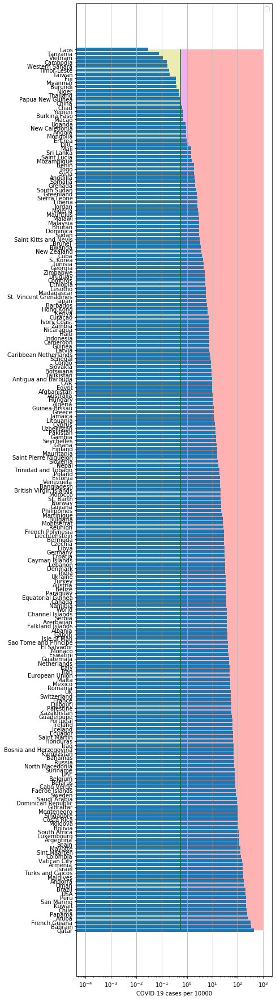

In [824]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="pictures/coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:815: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


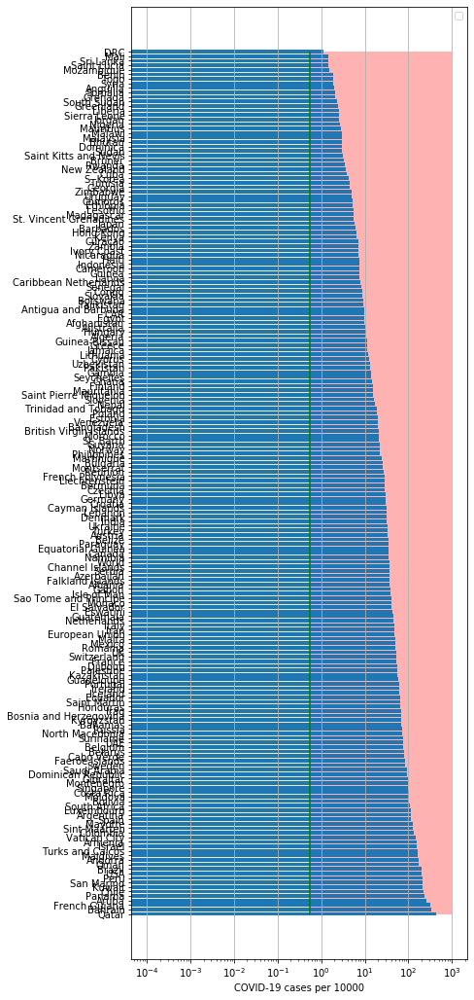

In [825]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="pictures/coronage1.png")

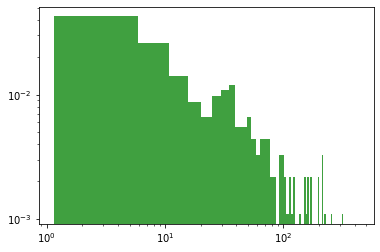

In [826]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [827]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
           date   cases  active    death
203 2020-09-05  519923       0  29418.0
204 2020-09-06  522728       0  29418.0
205 2020-09-07  525549       0  29516.0
206 2020-09-08  534513       0  29594.0
207 2020-09-09  543379       0  29628.0
GB
           date   cases  active    death
192 2020-09-05  344164       0  41549.0
193 2020-09-06  347152       0  41551.0
194 2020-09-07  350100       0  41554.0
195 2020-09-08  352560       0  41586.0
196 2020-09-09  355219       0  41594.0
IT
           date   cases  active    death
195 2020-09-05  276338   31194  35534.0
196 2020-09-06  277634   32078  35541.0
197 2020-09-07  278784   32993  35553.0
198 2020-09-08  280153   33789  35563.0
199 2020-09-09  281583   34734  35577.0
LT
           date   cases  active  death     tests
180 2020-09-05  3083.0    1043   86.0  663899.0
181 2020-09-06  3100.0    1059   86.0  666930.0
182 2020-09-07  3131.0    1051   86.0  671297.0
183 2020-09-08  3163.0    1069   86.0  676600.0
184 2020-09-09  3163.0  

In [828]:
dfBL = dfBL.fillna(0)
dfRM = dfRM.fillna(0)
dfSV = dfSV.fillna(0)
dfCT = dfCT.fillna(0)
#dfAR = dfAR.fillna(0)
dfSB = dfSB.fillna(0)
dfCP = dfCP.fillna(0)
dfID = dfID.fillna(0)
dfAG = dfAG.fillna(0)
dfMX = dfMX.fillna(0)
dfPU = dfPU.fillna(0)
dfIQ = dfIQ.fillna(0)
dfIE = dfIE.fillna(0)
dfPH = dfPH.fillna(0)
dfTH = dfTH.fillna(0)
dfMR = dfMR.fillna(0)
dfCP = dfCP.fillna(0)

In [829]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.5018329937605849
intercept: 1.2578571508952234
slope: [0.02071494]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:6: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  


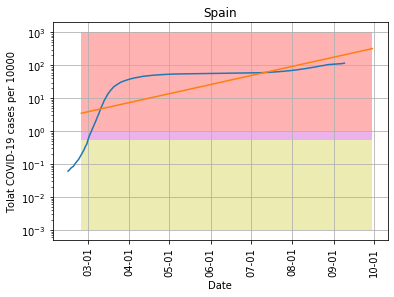

In [830]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-09-30', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaSP.png")
plt.show()

In [831]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.5545230307867148
intercept: -0.6826561082266958
slope: [0.03200969]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


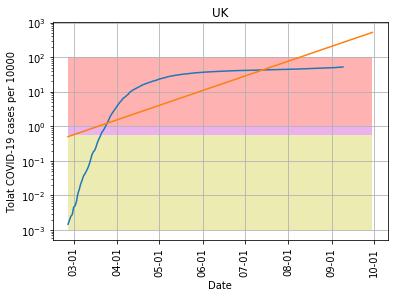

In [832]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-09-30', "pictures/coronaGB.png", model1, 'UK',100)

In [836]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 5.01378751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.6331505580564926
intercept: 1.063034258938153
slope: [-0.00747926]


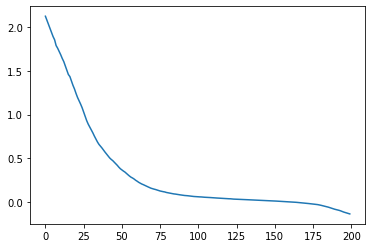

In [837]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  """


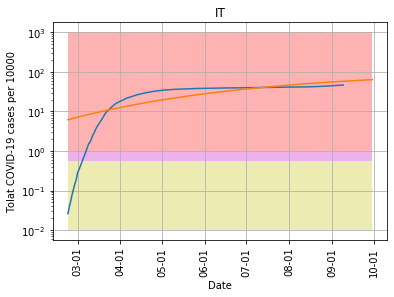

In [838]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-09-30', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaIT.png")
plt.show()

In [839]:
cs=y_pred11[-1]/10000.*populationIT

In [840]:
cs

385546.00166350894

In [841]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT[1:],populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.44796629978712205
intercept: -0.1280368441282389
slope: [0.01709589]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


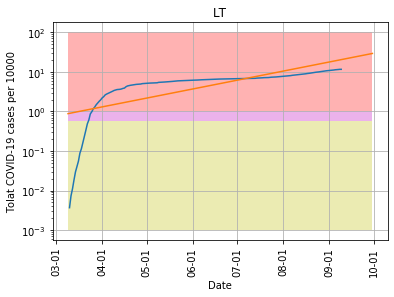

In [842]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
ss1t = plotpred(dfLT[1:],populationLT,'2020-03-09', '2020-09-30', "pictures/coronaLT.png", model1, 'LT',100)

In [843]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.7060856730277122
intercept: -2.643787326783076
slope: [0.04037753]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


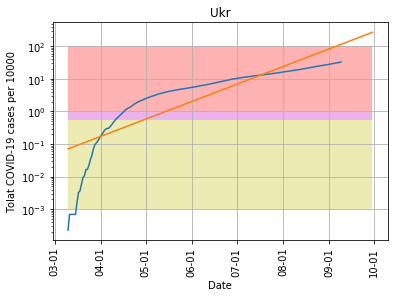

In [844]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-09-30', "pictures/coronaUkr.png", model11, 'Ukr',100)

No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  app.launch_new_instance()


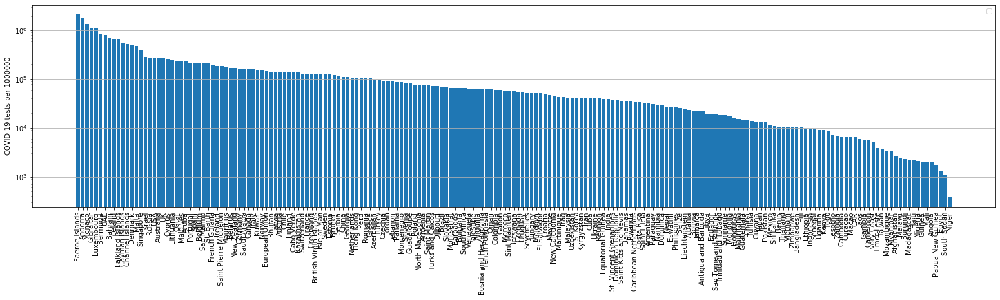

In [845]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("pictures/coronaTests.png")
plt.show()

In [846]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.6369756454829609
intercept: -0.2864829148785084
slope: [0.03670974]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


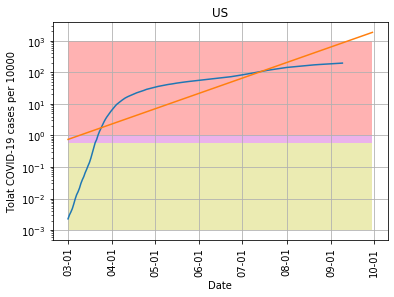

In [847]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-09-30', "pictures/coronaUS.png", model11, 'US',1000)

In [848]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country         0
229  European Union  0.067236


Text(0.5, 1.0, 'Death rate')

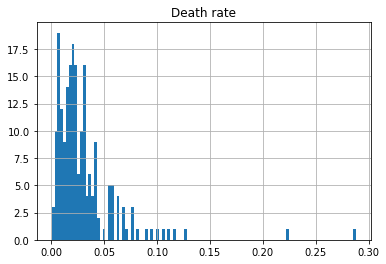

In [849]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh[dfTTh[0]>0].hist(bins=9*12)
plt.title("Death rate")
#plt.xlim([0,0.15])

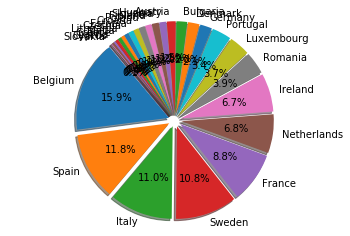

In [850]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [851]:
dfTTh.head()

,Country,Deathsper1Mpop
42,Belgium,855.0
15,Spain,634.0
25,Italy,589.0
44,Sweden,578.0
20,France,472.0


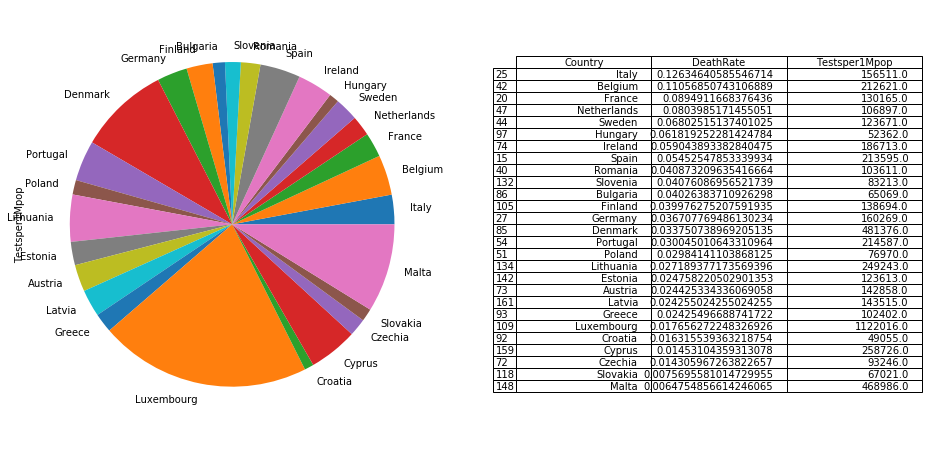

In [852]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
#dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate2.png")
plt.show()

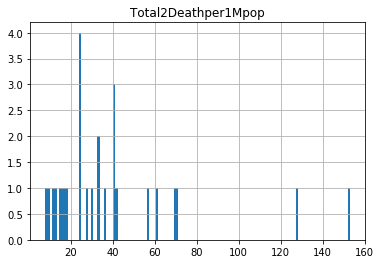

In [853]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [854]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
15,Spain,11621.0,634.0
20,France,5269.0,472.0
25,Italy,4659.0,589.0
27,Germany,3058.0,112.0
40,Romania,5117.0,209.0


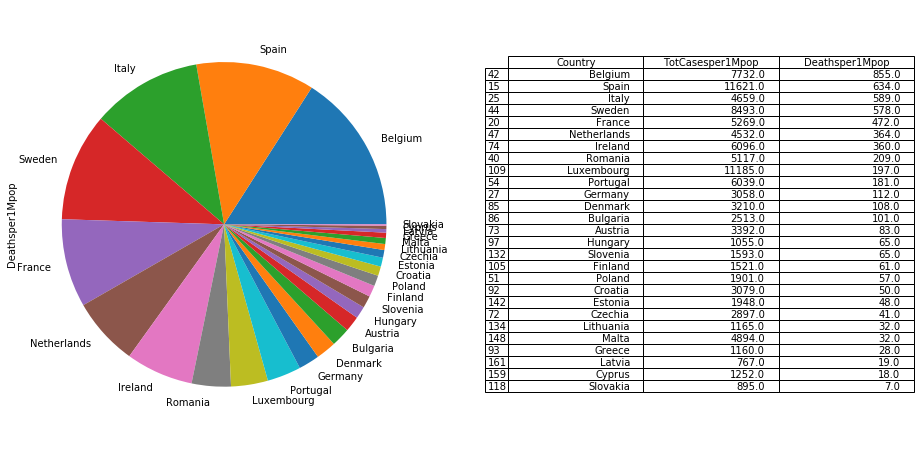

In [855]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate1.png")
plt.show()

In [856]:
dfAll.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,0.0,North America,7790513,5225.0,284506.0,629.0,4704062.0,"+4,776",2801945,18553.0,0.0,0.0,0.0,0.0,0,North America,\n,0,0
1,0.0,Asia,8106017,5515.0,157230.0,14.0,6546947.0,"+6,579",1401840,19243.0,0.0,0.0,0.0,0.0,0,Asia,\n,0,0
2,0.0,South America,6862894,1037.0,222322.0,49.0,5566454.0,"+2,118",1074118,15022.0,0.0,0.0,0.0,0.0,0,South America,\n,0,0
3,0.0,Europe,3917579,8971.0,211328.0,179.0,2205268.0,"+7,128",1500983,6208.0,0.0,0.0,0.0,0.0,0,Europe,\n,0,0
4,0.0,Africa,1328263,0.0,31962.0,0.0,1063653.0,0,232648,1468.0,0.0,0.0,0.0,0.0,0,Africa,\n,0,0


In [857]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
15,Spain,0.054407
20,France,0.040479
25,Italy,0.029768
27,Germany,0.019080
40,Romania,0.049387


In [858]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

     Country  Cases2Testsper1Mpop
      Sweden             0.068674
     Croatia             0.062766
       Spain             0.054407
     Romania             0.049387
 Netherlands             0.042396
      France             0.040479
    Bulgaria             0.038621
     Belgium             0.036365
     Ireland             0.032649
     Czechia             0.031068
       Italy             0.029768
    Portugal             0.028142
      Poland             0.024698
     Austria             0.023744
     Hungary             0.020148
    Slovenia             0.019144
     Germany             0.019080
     Estonia             0.015759
    Slovakia             0.013354
      Greece             0.011328
     Finland             0.010967
       Malta             0.010435
  Luxembourg             0.009969
     Denmark             0.006668
      Latvia             0.005344
      Cyprus             0.004839
   Lithuania             0.004674


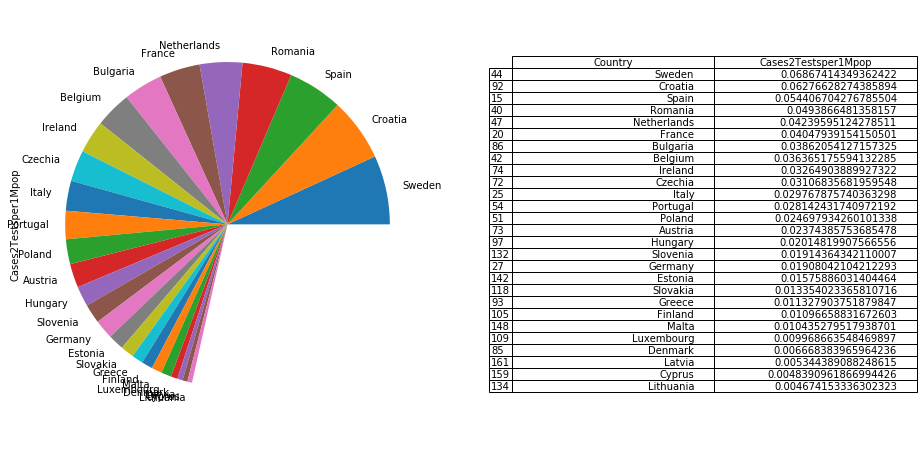

In [859]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDDh2.plot.pie(y='Cases2Testsper1Mpop',ax=ax1,labels=dfDDh2['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDDh2, loc='center')
#tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.show()

In [860]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
56,Singapore,0.000472,389320.0
34,Qatar,0.001696,239368.0
180,Burundi,0.002146,2328.0
103,Maldives,0.003509,230423.0
55,Bahrain,0.003551,705095.0
...,...,...,...
42,Belgium,0.110569,212621.0
19,UK,0.117094,259287.0
25,Italy,0.126346,156511.0
218,MS Zaandam,0.222222,0.0


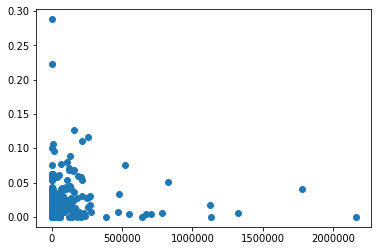

In [861]:
plt.plot(dfTTh["Testsper1Mpop"],dfTTh['DeathRate'],'o')

/usr/local/lib/python3.7/site-packages/matplotlib/patches.py:715: RuntimeWarning: invalid value encountered in double_scalars
  self._x1 = self._x0 + self._width
/usr/local/lib/python3.7/site-packages/matplotlib/projections/polar.py:55: RuntimeWarning: invalid value encountered in greater_equal
  r = np.where(r >= 0, r, np.nan)


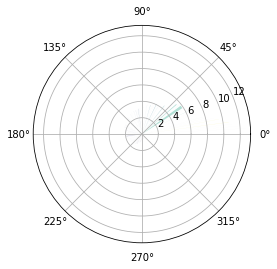

In [862]:
import numpy as np
import matplotlib.pyplot as plt


# Fixing random state for reproducibility
np.random.seed(19680801)

# Compute pie slices
N = len(dfTTh)
theta = np.linspace(0.0, 2*np.pi, N, endpoint=False)
radii = 100 * dfTTh['DeathRate']
width = 2*np.pi* 3.5/ dfTTh["Testsper1Mpop"]
colors = plt.cm.viridis(radii / 10.)

ax = plt.subplot(111, projection='polar')
ax.bar(theta, radii, width=width, bottom=0.0, color=colors, alpha=0.35)

plt.show()

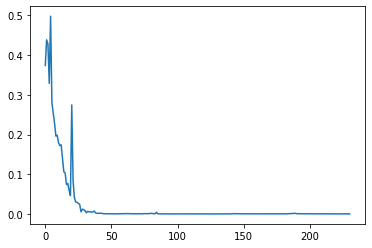

In [863]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [864]:
#np.diff(np.log(dfCN["cases"].values))

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in log
  """Entry point for launching an IPython kernel.


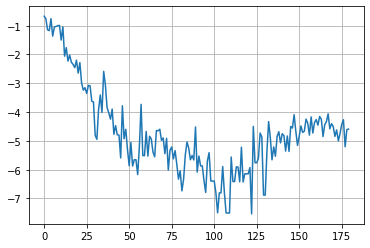

In [865]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))
plt.grid()

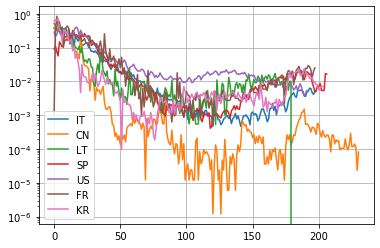

In [866]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

192 192
coefficient of determination: 0.708617893175052
intercept: -12.289233683498686
slope: [-0.0536556]


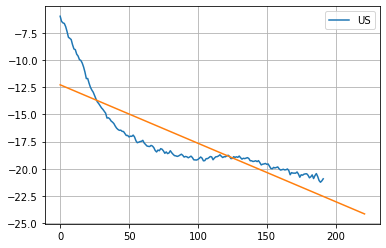

In [867]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("pictures/logdiffUS.png")
plt.show()

In [868]:
#np.diff(dfIT["cases"])

199 199
coefficient of determination: 0.6102540083677874
intercept: -12.781525368186339
slope: [-0.04191007]


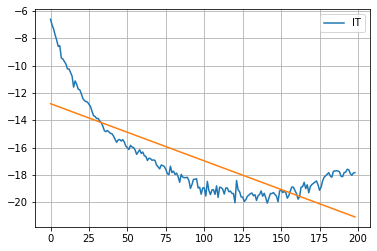

In [869]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [870]:
#model11.coef_

In [871]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

181 181
coefficient of determination: 0.8752325525008642
intercept: -16.276435955186077
slope: [-0.03464178]


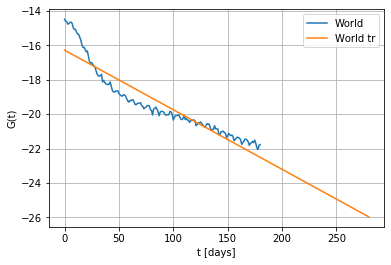

In [872]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("pictures/logdifflogcoronaW.png")

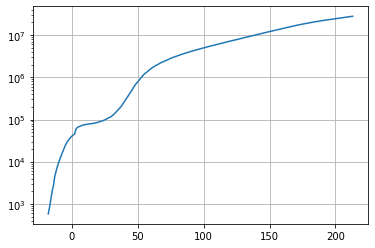

In [873]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [874]:
dfW['cases'].values

array([     580,      845,     1317,     2015,     2800,     4581,
           6058,     7813,     9823,    11950,    14553,    17391,
          20630,    24545,    28266,    31439,    34876,    37552,
          40553,    43099,    45134,    59287,    64438,    67100,
          69197,    71329,    73332,    75184,    75700,    76677,
          77673,    78651,    79205,    80087,    80828,    81820,
          83112,    84615,    86604,    88585,    90443,    93016,
          95314,    98425,   102050,   106099,   109991,   114381,
         118948,   126214,   134576,   145483,   156653,   169593,
         182490,   198238,   218822,   244933,   275597,   305036,
         337489,   378860,   422629,   471035,   531864,   596366,
         663079,   723279,   784738,   858355,   936237,  1016330,
        1117928,  1203058,  1274578,  1347566,  1432869,  1519195,
        1605277,  1700004,  1780713,  1853505,  1925330,  2000065,
        2084633,  2183942,  2252370,  2332650,  2407467,  2482

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 1.01980079e+08  3.10641423e-01 -2.10828038e+02  2.57519371e-02]


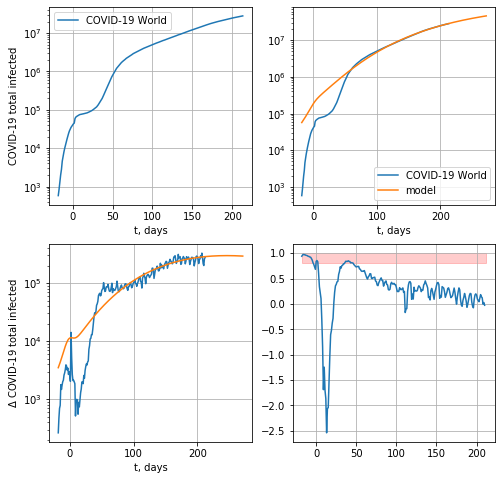

274477.2947949864


In [875]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("pictures/covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

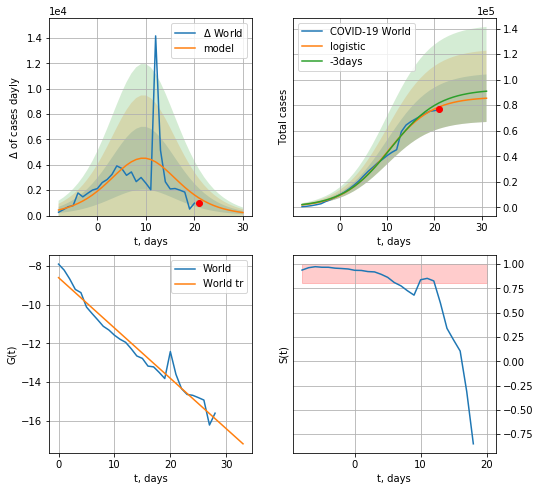

World data at: 2020-09-09
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +10 days
	 deltaDaycases:  239
	 total cases:  85429 ± 18607
	 total death:  2767 ± 1808
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


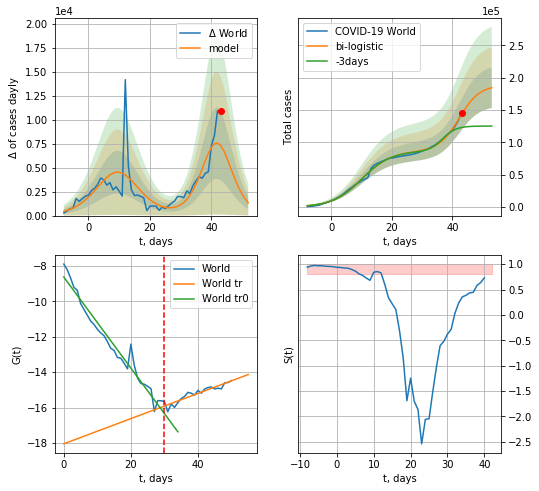

World data at: 2020-09-09
+3 day model MAPE: 0.21572977405755475
model: bi-logistic
coeffs:  [1.02227620e+05 2.95650803e-01 4.22367007e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860967254475
forecast at the end of period: +10 days
	 deltaDaycases:  1329
	 total cases:  184617 ± 31371
	 total death:  5980 ± 3048
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


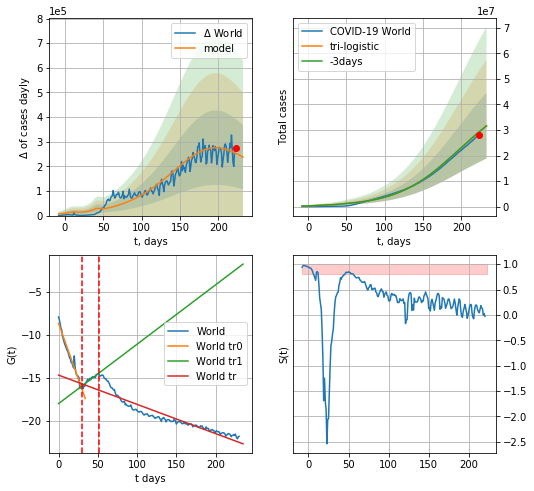

World data at: 2020-09-09
+3 day model MAPE: 0.003074896046380121
model: tri-logistic
coeffs:  [3.98052654e+07 2.57548481e-02 1.91834396e+02] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227620e+05
 2.95650803e-01 4.22367007e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.40644820567692175
forecast at the end of period: +10 days
	 deltaDaycases:  237219
	 total cases:  31705922 ± 12886815
	 total death:  1027076 ± 1252359
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.876004
 intercept: -14.657570
 slope: -0.033978


In [876]:
vL = 30
T18 = 25
x = forecast("World",dfW[:vL],d1,7*T18-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*T18-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*T18-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

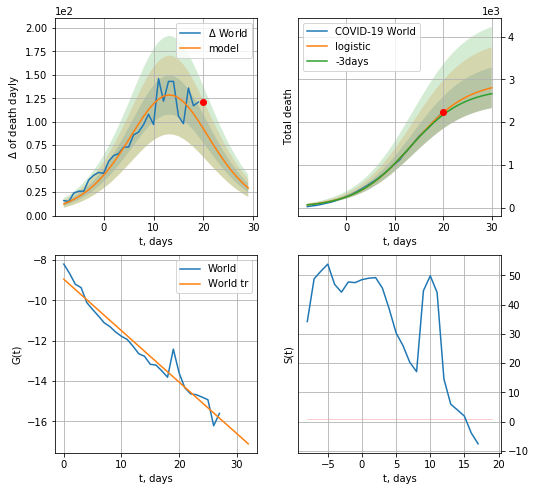

World data at: 2020-09-09
+3 day model MAPE: 0.027312195038559757
model: logistic
coeffs:  [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.16928081921473714
forecast at the end of period: +10 days
	 total death:  2803 ± 474
trend coefficient of determination: 0.959176
 intercept: -8.958870
 slope: -0.254930


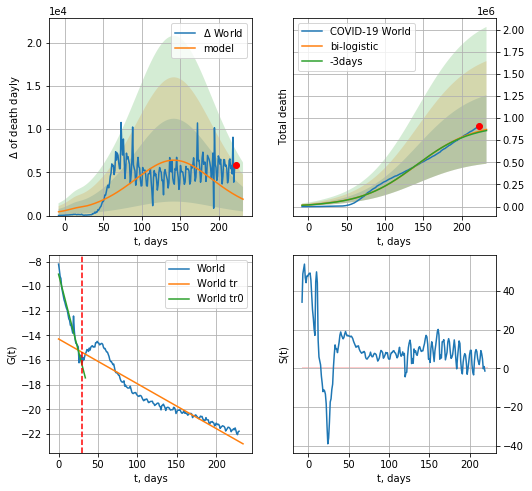

World data at: 2020-09-09
+3 day model MAPE: 0.012328856729016416
model: bi-logistic
coeffs:  [9.43017342e+05 2.71742168e-02 1.41833872e+02] [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.443475171084987
forecast at the end of period: +10 days
	 deltaDaydeath:  1895
	 total death:  871088 ± 386306
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.960969
 intercept: -9.026339
 slope: -0.247583
trend coefficient of determination: 0.899467
 intercept: -14.285448
 slope: -0.036386


In [877]:
vL = 30
vL1=52
x = forecast("World",dfW[1:vL],d1,7*T18-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[1:],d1,7*T18-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [878]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


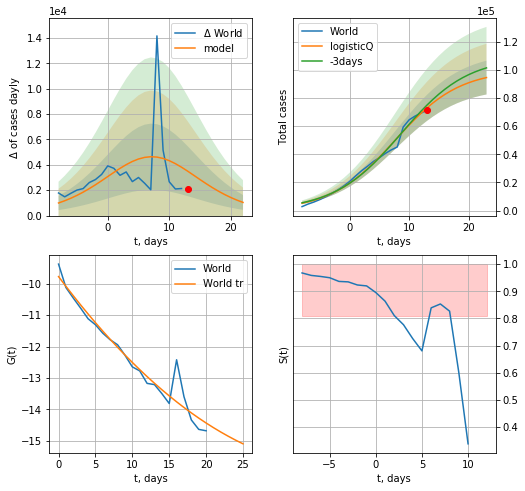

World data at: 2020-09-09
+3 day model MAPE: 0.031856
model: logisticQ
coeffs: [ 9.98643061e+04  1.79654926e-05  7.63889443e+00 -1.03374511e+04]
rational stdev: 0.126959
forecast at the end of period: +10 days
	 deltaDaycases: 1037
	 total cases: 94450 ± 11991
	 total death: 3059 ± 1165
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


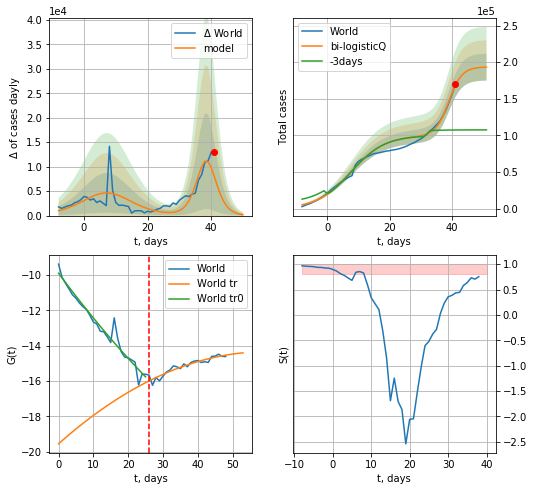

World data at: 2020-09-09
+3 day model MAPE: 0.635592
model: bi-logisticQ
coeffs: [ 9.37621522e+04  2.37764402e-05  3.89555041e+01 -2.00834102e+04]
rational stdev: 0.094698
forecast at the end of period: +10 days
	 deltaDaycases: 185
	 total cases: 193303 ± 18305
	 total death: 6261 ± 1778
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.893677
 intercept_: -19.558019139425994
 coeffs_: [ 0.          0.17538587 -0.00147405]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


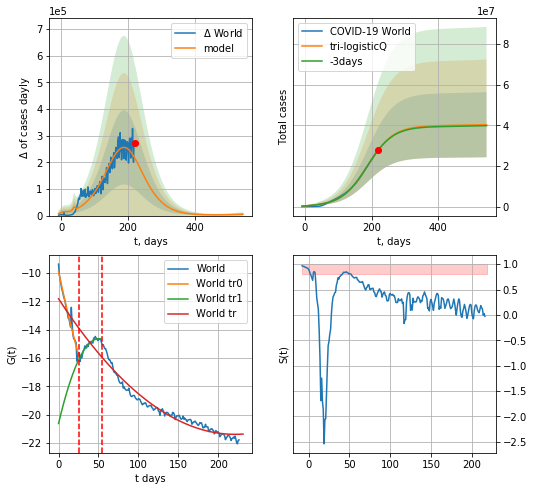

World data at: 2020-09-09
+3 day model MAPE: 0.003918
model: tri-logisticQ
coeffs: [ 3.97429167e+07  2.35213118e-07  1.87729218e+02 -1.09469549e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.397736
forecast at the end of period: +325 days
	 deltaDaycases: 5006
	 total cases: 40324260 ± 16038409
	 total death: 1306257 ± 1558636
tri-logisticQ approximation splitting points: 26,54
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.900515
 intercept_: -20.622215746086294
 coeffs_: [ 0.          0.23801537 -0.00236922]
trend coefficient of determination: 0.954606
 intercept_: -11.819994724407534
 coeffs_: [ 0.         -0.08660616  0.00019604]


In [879]:
vL=30 - 4
vL1=59 - 5
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
x = forecastRRR("World",dfW[4:vL],d1,7*T18-dT,1.0,False)
xx = forecast2RRR("World",dfW[4:vL1],d1,7*T18-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*70-dT, xx, shift=1.,addpred=True,xcoef=koreaCoeffs,vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


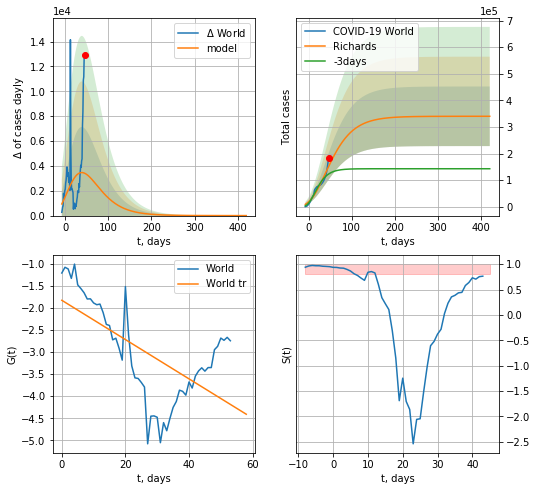

World data at: 2020-09-09
+3 day model MAPE: 0.241623
model: Richards
coeffs: [ 3.40076103e+05  3.50838629e+00 -1.35190892e+02  7.92527881e-03]
rational stdev: 0.329278
forecast at the end of period: +375 days
	 deltaDaycases: 0
	 total cases: 340067 ± 111976
	 total death: 11016 ± 10881
trend coefficient of determination: 0.389869
 intercept: -1.829859
 slope: -0.044449


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


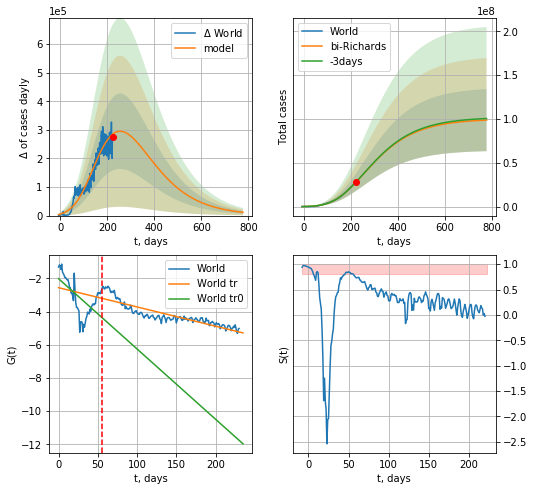

World data at: 2020-09-09
+3 day model MAPE: 0.002318
model: bi-Richards
coeffs: [ 9.97438773e+07  3.58198948e-01 -2.10603159e+02  2.27169883e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.359092
forecast at the end of period: +555 days
	 deltaDaycases: 11349
	 total cases: 98685329 ± 35437133
	 total death: 3196795 ± 3443832
bi-Richards approximation splitting point: 55
trend coefficient of determination: 0.364380
 intercept: -2.015177
 slope: -0.042368
trend coefficient of determination: 0.780481
 intercept: -2.557574
 slope: -0.011602


In [880]:
vL = 55
x = forecastRR("World",dfW[:vL],d1,60*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[:],d1,80*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

232


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


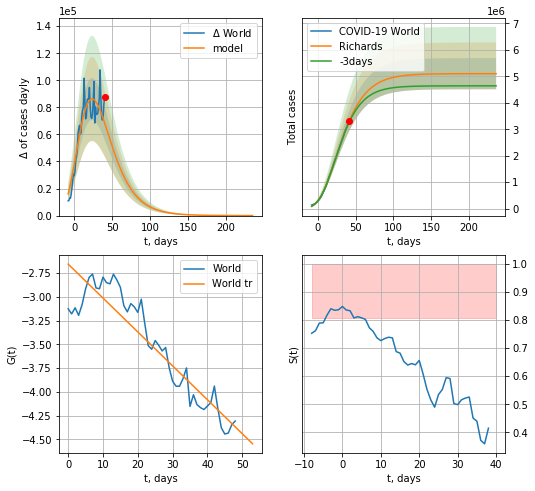

World data at: 2020-09-09
+3 day model MAPE: 0.014871
model: Richards
coeffs: [ 5.10253376e+06  1.04389323e+00 -4.20529569e+01  4.49999517e-02]
rational stdev: 0.115528
forecast at the end of period: +195 days
	 deltaDaycases: 11
	 total cases: 5102292 ± 589455
	 total death: 165282 ± 57283
trend coefficient of determination: 0.854894
 intercept: -2.655671
 slope: -0.035657


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


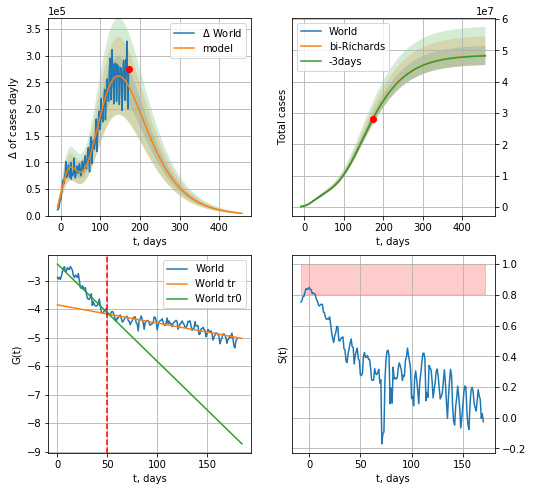

World data at: 2020-09-09
+3 day model MAPE: 0.000855
model: bi-Richards
coeffs: [ 4.34774722e+07  6.47005784e-01 -7.49484629e+01  2.55533009e-02]
rational stdev: 0.063048
forecast at the end of period: +285 days
	 deltaDaycases: 4201
	 total cases: 48327182 ± 3046945
	 total death: 1565502 ± 296106
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.847737
 intercept: -2.422108
 slope: -0.034095
trend coefficient of determination: 0.761757
 intercept: -3.853252
 slope: -0.006360


In [881]:
print (len(dfW))
vL = 100
x = forecastRR("World",dfW[50:vL],d1,40*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[50:],d1,50*9-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-50)
#x = forecastQR("World",dfW[50:],d1,30*9-dT,1.0,addpred=False)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


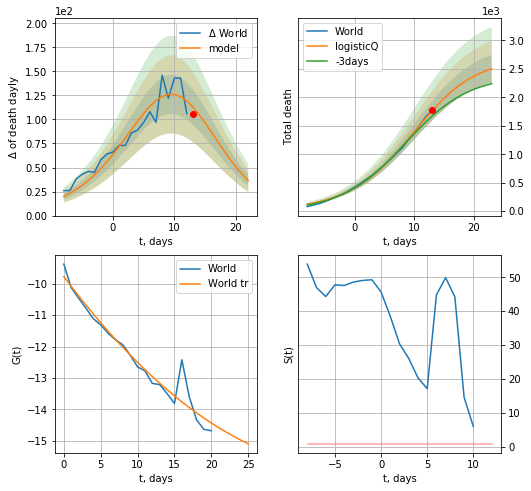

World data at: 2020-09-09
+3 day model MAPE: 0.067194
model: logisticQ
coeffs: [ 2.67018329e+03  8.28113131e-04  9.49649422e+00 -2.18461064e+02]
rational stdev: 0.098000
forecast at the end of period: +10 days
	 total death: 2502 ± 245
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


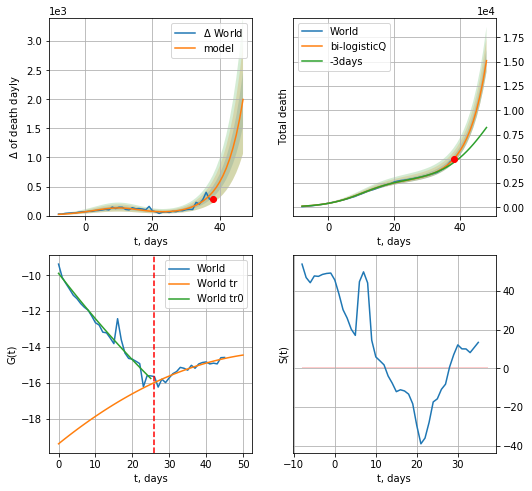

World data at: 2020-09-09
+3 day model MAPE: 0.105641
model: bi-logisticQ
coeffs: [ 6.44010385e+06  6.89934025e-04  7.95796325e+01 -2.38740330e+02]
rational stdev: 0.076590
forecast at the end of period: +10 days
	 total death: 15109 ± 1157
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.866834
 intercept_: -19.41123113056416
 coeffs_: [ 0.          0.16686573 -0.0013545 ]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:477: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


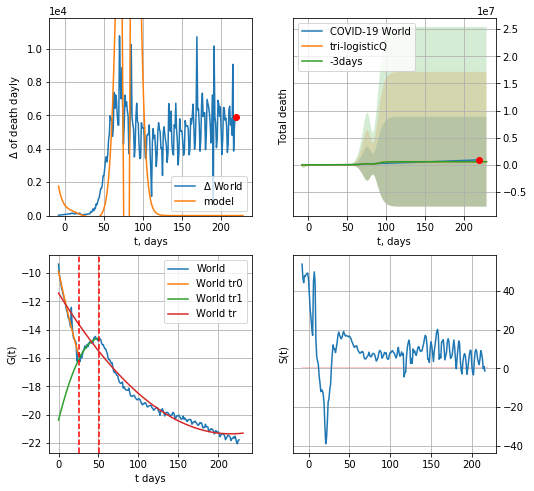

World data at: 2020-09-09
+3 day model MAPE: 0.013917
model: tri-logisticQ
coeffs: [-5.86776255e+06  2.12129575e-03 -3.98608621e+01  7.92754961e+01]
rational stdev: 14.393357
forecast at the end of period: +10 days
	 total death: 575011 ± 8276345
tri-logisticQ approximation splitting points: 26,51
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.890965
 intercept_: -20.382525077358043
 coeffs_: [ 0.          0.22422642 -0.00217733]
trend coefficient of determination: 0.954703
 intercept_: -11.42225678989665
 coeffs_: [ 0.         -0.09208907  0.00021354]


In [882]:
vL=30 - 4
vL1=51
x = forecastRRR("World",dfW[4:vL],d1,7*T18-dT,1.0,False,cases='death')
xx = forecast2RRR("World",dfW[4:vL1],d1,7*T18-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*T18-dT, xx, shift=1.,addpred=False,xcoef=[.35,.5,4.,1.],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


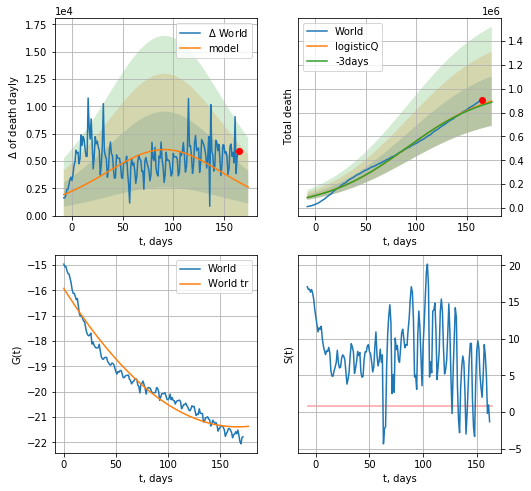

World data at: 2020-09-09
+3 day model MAPE: 0.009725
model: logisticQ
coeffs: [ 1.01897797e+06  8.67714903e-07  9.15710643e+01 -2.72445380e+04]
rational stdev: 0.231353
forecast at the end of period: +10 days
	 total death: 895895 ± 207267
trend coefficient of determination: 0.954606
 intercept_: -15.924986082078126
 coeffs_: [ 0.         -0.0654361   0.00019606]


In [883]:
x = forecastRRR("World",dfW[58:],d1,7*T18-dT,1.0,False,cases='death')

In [884]:
#trend(dfSP,'SP',10)

In [885]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

SP
           date   cases  active    death
203 2020-09-05  519923       0  29418.0
204 2020-09-06  522728       0  29418.0
205 2020-09-07  525549       0  29516.0
206 2020-09-08  534513       0  29594.0
207 2020-09-09  543379       0  29628.0


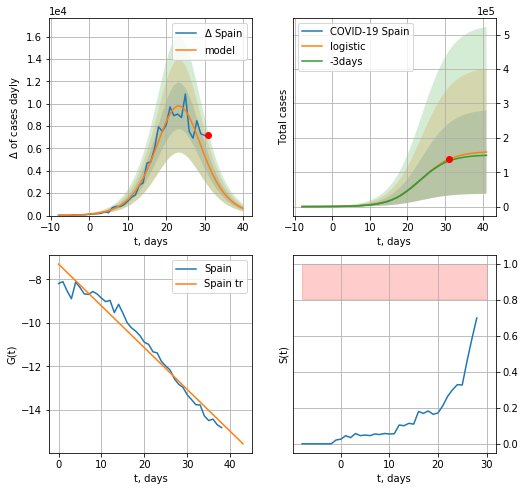

Spain data at: 2020-09-09
+3 day model MAPE: 0.04065647450118455
model: logistic
coeffs:  [1.61048783e+05 2.44209245e-01 2.38061166e+01]
rational stdev:  0.7646314126726975
forecast at the end of period: +10 days
	 deltaDaycases:  646
	 total cases:  158666 ± 121321
	 total death:  8651 ± 19844
trend coefficient of determination: 0.963842
 intercept: -7.302330
 slope: -0.192029


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


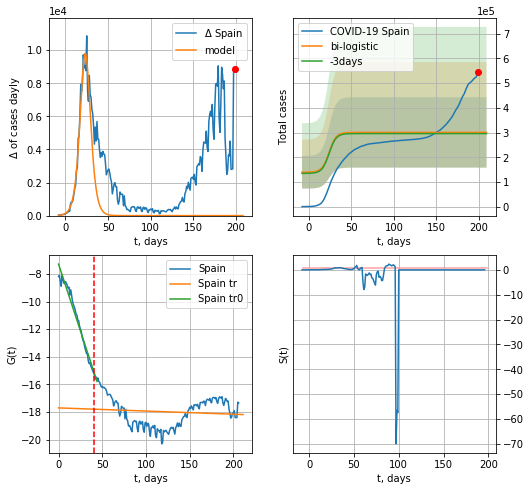

Spain data at: 2020-09-09
+3 day model MAPE: 0.016204824928771948
model: bi-logistic
coeffs:  [ 1.11519574e+05 -9.00331254e+00  2.23704159e+02] [1.61048783e+05 2.44209245e-01 2.38061166e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.47364224472955185
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  300448 ± 142304
	 total death:  16382 ± 23277
bi-logistic approximation splitting point: 40
trend0 coefficient of determination: 0.966463
 intercept: -7.292080
 slope: -0.192838
trend coefficient of determination: 0.009687
 intercept: -17.694626
 slope: -0.002275


In [886]:
try:
    dfSP = read_df(pd.DataFrame(),"SP")
    vL = 40#len(dfSP[:])-7-dT
    x = forecast('Spain',dfSP[:vL],d1,7*T18-dT,1.0,cases='cases')
    xx = forecast2('Spain',dfSP[:],d1,7*T18-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: divide by zero encountered in true_divide


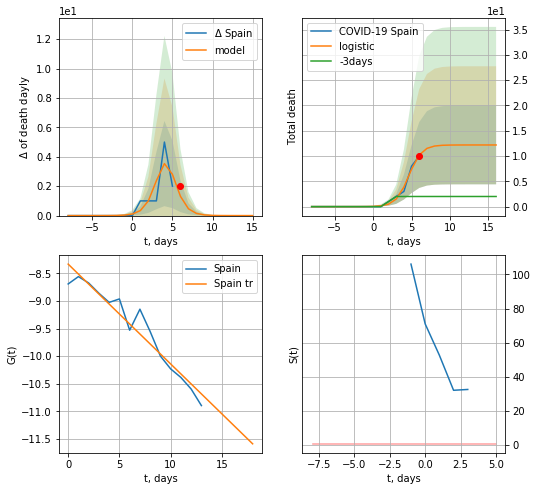

Spain data at: 2020-09-09
+3 day model MAPE: 4.756036700963932
model: logistic
coeffs:  [12.18291976  1.20295815  4.63698223]
rational stdev:  0.6384450788145528
forecast at the end of period: +10 days
	 total death:  12 ± 7
trend coefficient of determination: 0.932343
 intercept: -8.335143
 slope: -0.180548


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:251: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:251: RuntimeWarning: invalid value encountered in true_divide


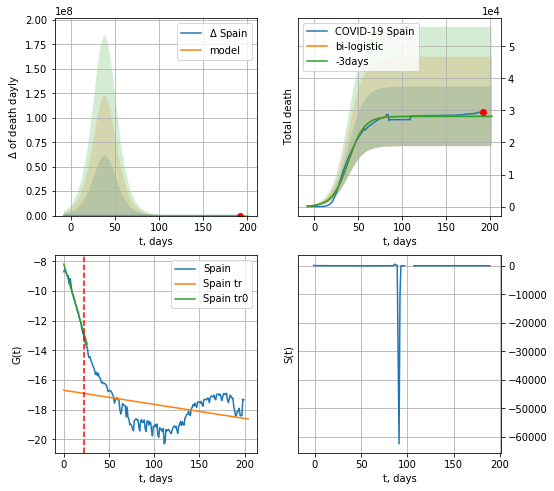

Spain data at: 2020-09-09
+3 day model MAPE: 0.0013166506621386119
model: bi-logistic
coeffs:  [2.81551108e+04 1.10633911e-01 3.87457185e+01] [12.18291976  1.20295815  4.63698223]
rational stdev:  0.3300713044955771
forecast at the end of period: +10 days
	 deltaDaydeath:  0
	 total death:  28167 ± 9297
bi-logistic approximation splitting point: 22
trend0 coefficient of determination: 0.977622
 intercept: -8.181737
 slope: -0.208457
trend coefficient of determination: 0.115700
 intercept: -16.684080
 slope: -0.009508


In [887]:
vL = 22#len(dfSP[:])-7-dT
#dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,7*T18-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*T18-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


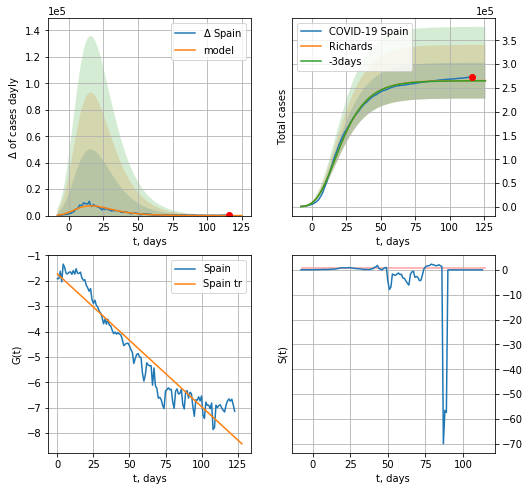

Spain data at: 2020-09-09
+3 day model MAPE: 0.001790
model: Richards
coeffs: [ 2.65380894e+05  1.27007595e+01 -5.07574734e+01  5.99372387e-03]
rational stdev: 0.141906
forecast at the end of period: +10 days
	 deltaDaycases: 5
	 total cases: 265317 ± 37650
	 total death: 14466 ± 6158
trend coefficient of determination: 0.908608
 intercept: -1.729338
 slope: -0.052332


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


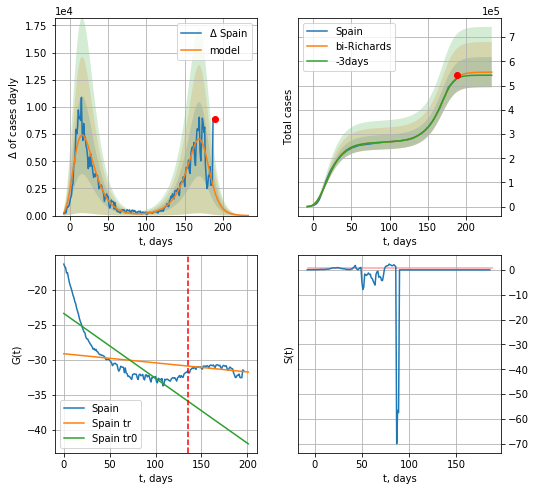

Spain data at: 2020-09-09
+3 day model MAPE: 0.010507
model: bi-Richards
coeffs: [2.90234219e+05 6.17311427e-02 1.74928412e+02 2.07299315e+00]
rational stdev: 0.112087
forecast at the end of period: +45 days
	 deltaDaycases: 9
	 total cases: 555542 ± 62269
	 total death: 30291 ± 10185
bi-Richards approximation splitting point: 135
trend coefficient of determination: 0.696363
 intercept: -23.388385
 slope: -0.092336
trend coefficient of determination: 0.196308
 intercept: -29.123200
 slope: -0.012962


In [892]:
iL = 10
vL = 135+iL#75+iL#135+1
x = forecastRR('Spain',dfSP[iL:vL-iL],d1,7*T18-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Spain',dfSP[iL:],d1,7*30-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


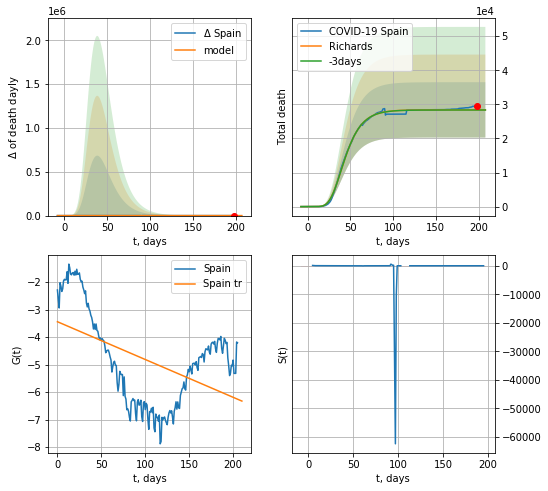

Spain data at: 2020-09-09
+3 day model MAPE: 0.001220
model: Richards
coeffs: [ 2.83755861e+04  1.07098796e+01 -2.73015507e+01  6.99989662e-03]
rational stdev: 0.285950
forecast at the end of period: +10 days
	 total death: 28375 ± 8113
trend coefficient of determination: 0.236033
 intercept: -3.442205
 slope: -0.013731


In [893]:
x = forecastRR('Spain',dfSP[1:],d1,7*T18-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


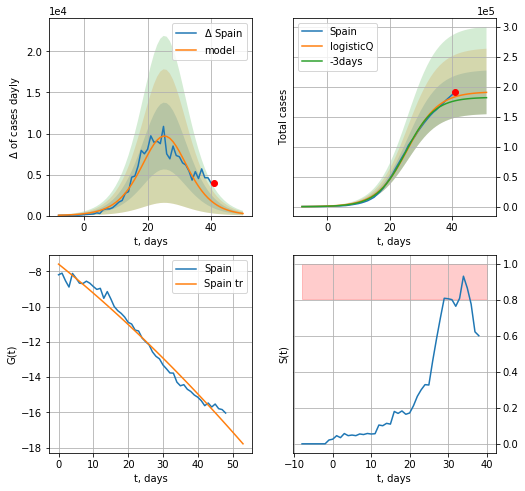

Spain data at: 2020-09-09
+3 day model MAPE: 0.039620
model: logisticQ
coeffs: [ 1.91639792e+05  4.37629447e-06  2.57854469e+01 -4.62652240e+04]
rational stdev: 0.190974
forecast at the end of period: +10 days
	 deltaDaycases: 256
	 total cases: 190490 ± 36378
	 total death: 10386 ± 5950
trend coefficient of determination: 0.980342
 intercept_: -7.592220633878184
 coeffs_: [ 0.         -0.15834655 -0.00063881]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


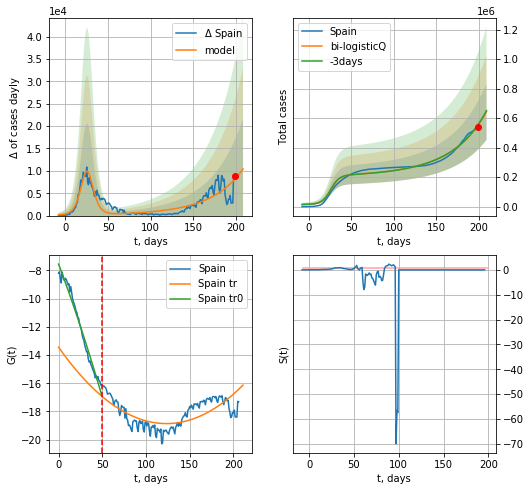

Spain data at: 2020-09-09
+3 day model MAPE: 0.007673
model: bi-logisticQ
coeffs: [ 4.51791191e+08  3.39808378e-05  4.32187606e+02 -7.01397780e+02]
rational stdev: 0.297185
forecast at the end of period: +10 days
	 deltaDaycases: 10425
	 total cases: 644427 ± 191514
	 total death: 35137 ± 31326
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.980214
 intercept_: -7.556685473365861
 coeffs_: [ 0.         -0.16443157 -0.0004811 ]
trend coefficient of determination: 0.471160
 intercept_: -13.444952280607293
 coeffs_: [ 0.         -0.08776585  0.00035563]


In [894]:
x = forecastRRR('Spain',dfSP[:50],d1,7*T18-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[:],d1,7*T18-dT,x,1.0,addpred=False,xcoef=koreaCoeffs,vL=50)#[.35,.5,3.,1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


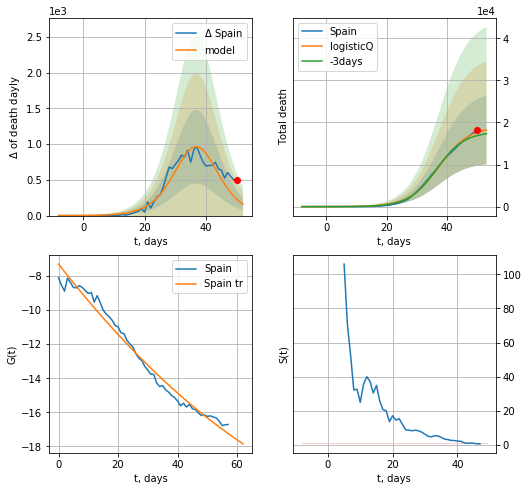

Spain data at: 2020-09-09
+3 day model MAPE: 0.047871
model: logisticQ
coeffs: [ 1.89599654e+04  5.38912704e-06  3.72491565e+01 -3.78046979e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.447682
forecast at the end of period: +3 days
	 total death: 18227 ± 8159
trend coefficient of determination: 0.978811
 intercept_: -7.301838938937334
 coeffs_: [ 0.         -0.22359908  0.00086295]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:347: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:347: RuntimeWarning: invalid value encountered in true_divide


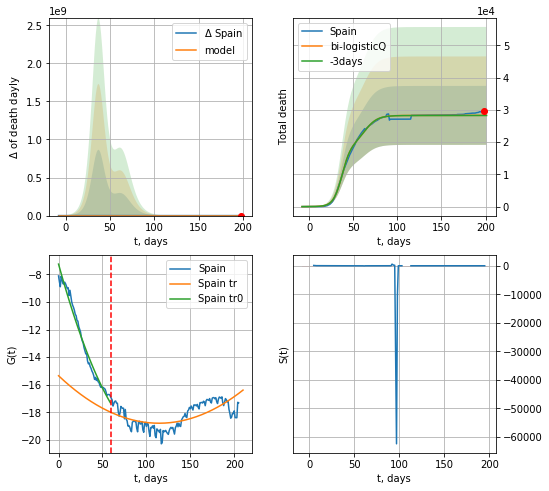

Spain data at: 2020-09-09
+3 day model MAPE: 0.001366
model: bi-logisticQ
coeffs: [ 9.33198676e+03  3.17297822e-07  6.32606303e+01 -4.34751772e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.323082
forecast at the end of period: +3 days
	 total death: 28310 ± 9146
bi-logisticQ approximation splitting point: 60
trend coefficient of determination: 0.978897
 intercept_: -7.2487934110171
 coeffs_: [ 0.         -0.2311524   0.00102662]
trend coefficient of determination: 0.416335
 intercept_: -15.35183947413834
 coeffs_: [ 0.         -0.06022835  0.00026318]


In [895]:
x = forecastRRR('Spain',dfSP[1:60],d1,7*24-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[1:],d1,7*24-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,cases='death',vL=60)

In [896]:
#x = forecastQR('Spain',dfSP[5:],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])

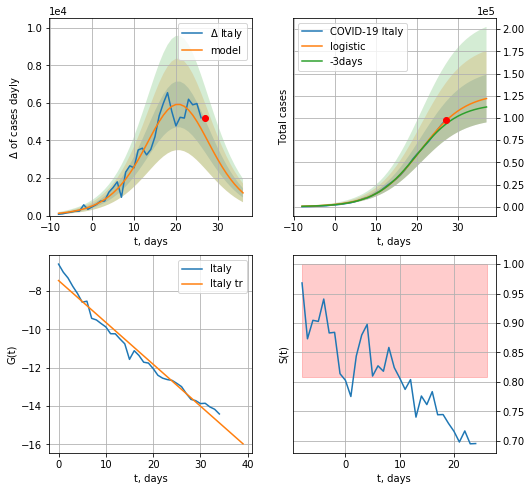

Italy data at: 2020-09-09
+3 day model MAPE: 0.0455783779571316
model: logistic
coeffs:  [1.28139025e+05 1.85112184e-01 2.10100291e+01]
rational stdev:  0.22065596629973358
forecast at the end of period: +10 days
	 deltaDaycases:  1208
	 total cases:  121825 ± 26881
	 total death:  15392 ± 10189
trend coefficient of determination: 0.974872
 intercept: -7.448746
 slope: -0.218671


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp


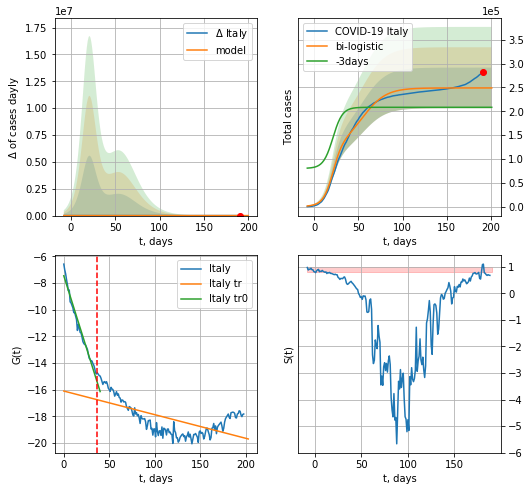

Italy data at: 2020-09-09
+3 day model MAPE: 0.19463889241690316
model: bi-logistic
coeffs:  [1.20798234e+05 7.69567215e-02 5.52274280e+01] [1.28139025e+05 1.85112184e-01 2.10100291e+01]
rational stdev:  0.17134615898252967
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  248935 ± 42654
	 total death:  31452 ± 16167
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975965
 intercept: -7.466589
 slope: -0.217097
trend coefficient of determination: 0.387017
 intercept: -16.110897
 slope: -0.017700


In [897]:
vL = 36#len(dfIT)-6-dT
x = forecast('Italy',dfIT[:vL],d1,T18*7-dT,1.0)
xx = forecast2('Italy',dfIT,d1,T18*7-dT,x,1.0,vL=vL)

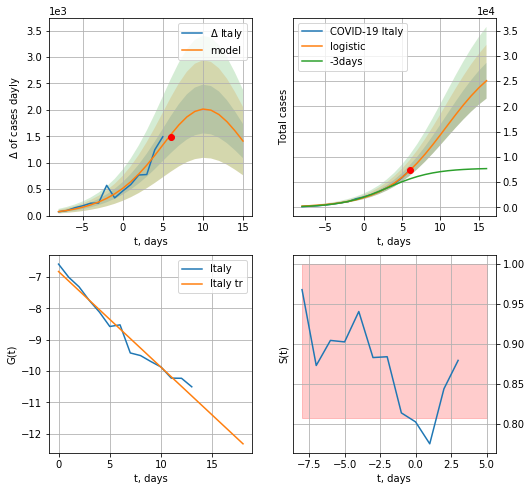

Italy data at: 2020-09-09
+3 day model MAPE: 0.4426444096966454
model: logistic
coeffs:  [3.14978219e+04 2.56455865e-01 1.06869170e+01]
rational stdev:  0.1414781796365507
forecast at the end of period: +10 days
	 deltaDaycases:  1410
	 total cases:  25077 ± 3547
	 total death:  3168 ± 1344
trend coefficient of determination: 0.972594
 intercept: -6.827533
 slope: -0.305163


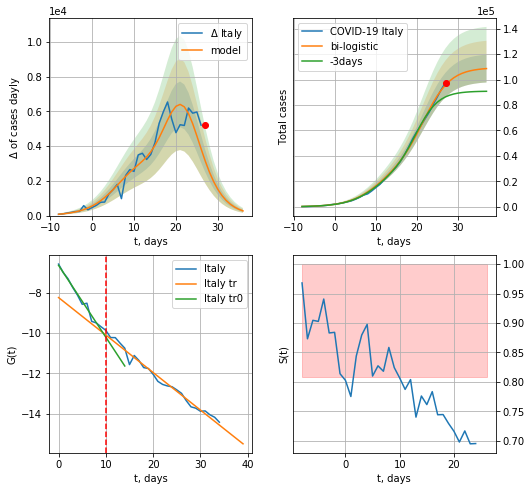

Italy data at: 2020-09-09
+3 day model MAPE: 0.1273932630183904
model: bi-logistic
coeffs:  [7.78644566e+04 3.07215545e-01 2.18188310e+01] [3.14978219e+04 2.56455865e-01 1.06869170e+01]
rational stdev:  0.10049358712471239
forecast at the end of period: +10 days
	 deltaDaycases:  269
	 total cases:  108597 ± 10913
	 total death:  13720 ± 4136
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:311: RuntimeWarning: overflow encountered in exp


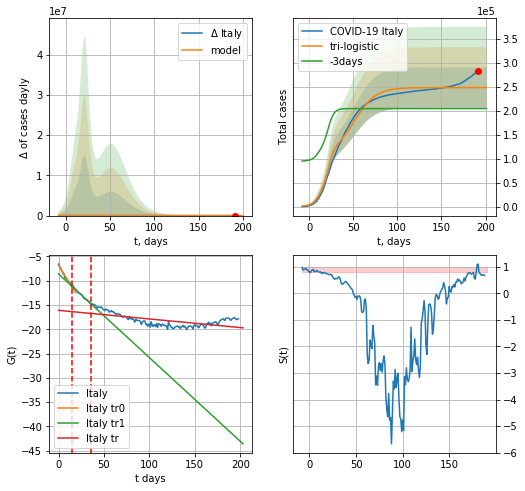

Italy data at: 2020-09-09
+3 day model MAPE: 0.2141002689470132
model: tri-logistic
coeffs:  [1.38585126e+05 8.28857914e-02 5.14392252e+01] [3.14978219e+04 2.56455865e-01 1.06869170e+01 7.78644566e+04
 3.07215545e-01 2.18188310e+01]
forecast rational stdev:  0.16978789999736155
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  247946 ± 42098
	 total death:  31327 ± 15956
tri-logistic approximation splitting points: 15,36
trend0 coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498
trend1 coefficient of determination: 0.980669
 intercept: -8.621660
 slope: -0.172200
trend coefficient of determination: 0.387017
 intercept: -16.110897
 slope: -0.017700


In [898]:
vL = 15#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*T18-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*T18-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*T18-dT, xx, shift=1.,addpred=False,xcoef=[.35,1.,1.5],vL=[vL,vL1])

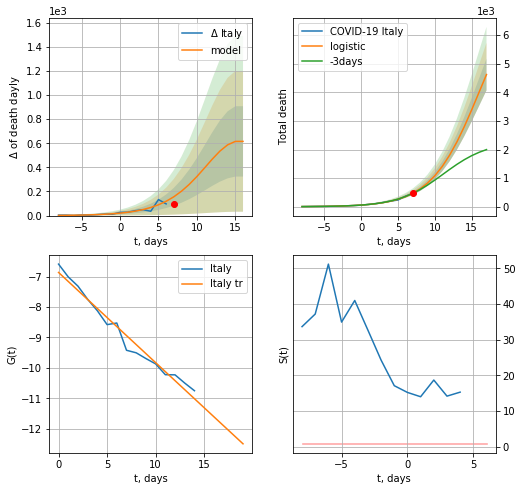

Italy data at: 2020-09-09
+3 day model MAPE: 0.04050488963495004
model: logistic
coeffs:  [8.02165383e+03 3.09187965e-01 1.60041387e+01]
rational stdev:  0.12009378173020563
forecast at the end of period: +10 days
	 total death:  4623 ± 555
trend coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498


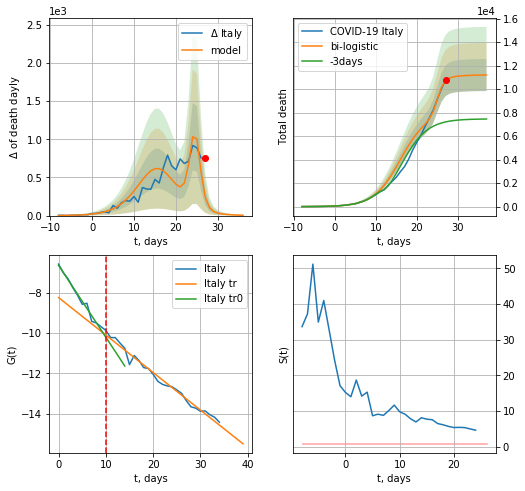

Italy data at: 2020-09-09
+3 day model MAPE: 0.5045402783114736
model: bi-logistic
coeffs:  [3.18986478e+03 1.24682064e+00 2.50159742e+01] [8.02165383e+03 3.09187965e-01 1.60041387e+01]
rational stdev:  0.12176299197618909
forecast at the end of period: +10 days
	 deltaDaydeath:  4
	 total death:  11199 ± 1363
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


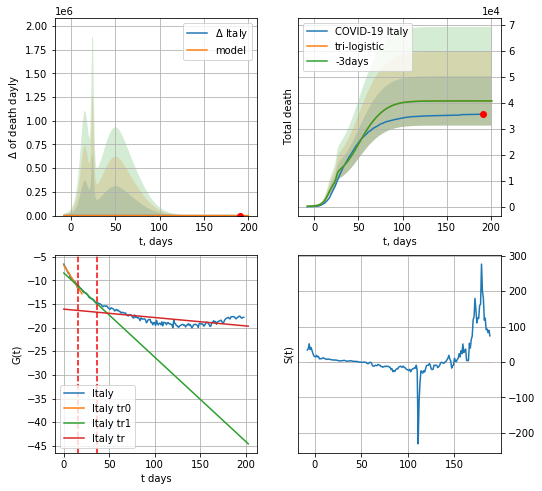

Italy data at: 2020-09-09
+3 day model MAPE: 0.0007537674542124788
model: tri-logistic
coeffs:  [2.35798343e+04 9.35563516e-02 4.91442885e+01] [8.02165383e+03 3.09187965e-01 1.60041387e+01 3.18986478e+03
 1.24682064e+00 2.50159742e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.23323785143685963
forecast at the end of period: +10 days
	 deltaDaydeath:  0
	 total death:  40686 ± 9489
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976775
 intercept: -6.838969
 slope: -0.302094
trend1 coefficient of determination: 0.986358
 intercept: -8.457993
 slope: -0.177909
trend coefficient of determination: 0.387017
 intercept: -16.110897
 slope: -0.017700


In [899]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*T18-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*T18-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*T18-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


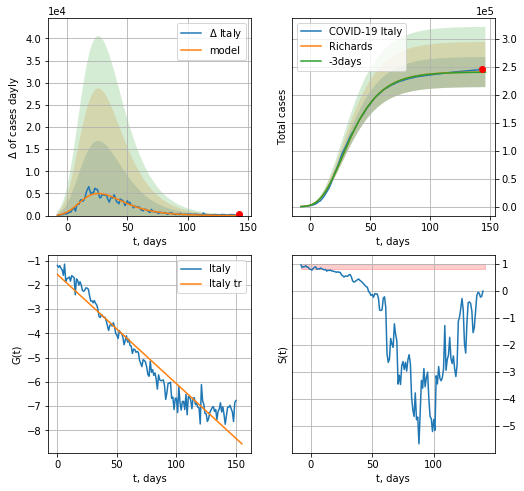

Italy data at: 2020-09-09
+3 day model MAPE: 0.001137
model: Richards
coeffs: [ 2.40825315e+05  8.29717345e+00 -6.16464143e+01  6.82557212e-03]
rational stdev: 0.111816
forecast at the end of period: +3 days
	 deltaDaycases: 16
	 total cases: 240549 ± 26897
	 total death: 30392 ± 10194
trend coefficient of determination: 0.940744
 intercept: -1.565853
 slope: -0.045125


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


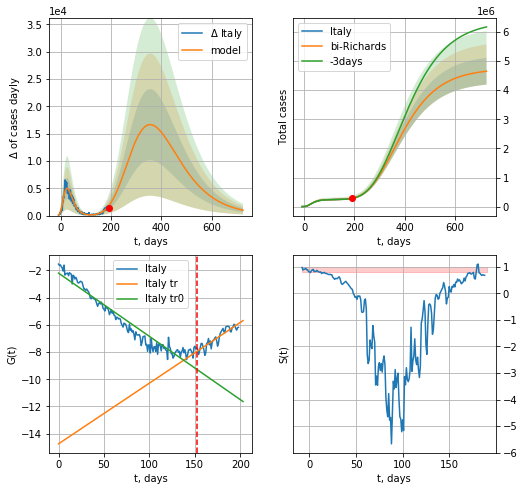

Italy data at: 2020-09-09
+3 day model MAPE: 0.000247
model: bi-Richards
coeffs: [4.50715672e+06 1.44347771e-01 1.03544366e+02 7.20287616e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.098755
forecast at the end of period: +535 days
	 deltaDaycases: 988
	 total cases: 4652318 ± 459439
	 total death: 587803 ± 174145
bi-Richards approximation splitting point: 152
trend coefficient of determination: 0.934299
 intercept: -2.212198
 slope: -0.046423
trend coefficient of determination: 0.816963
 intercept: -14.740615
 slope: 0.044547


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


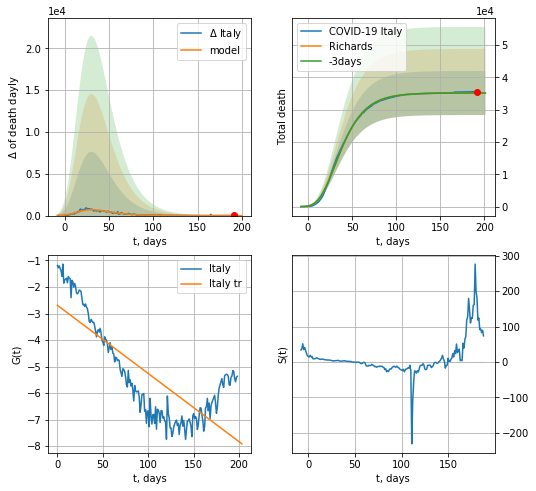

Italy data at: 2020-09-09
+3 day model MAPE: 0.000433
model: Richards
coeffs: [ 3.51310486e+04  8.29314017e+00 -6.25177246e+01  6.50352406e-03]
rational stdev: 0.193836
forecast at the end of period: +10 days
	 total death: 35127 ± 6808
trend coefficient of determination: 0.624605
 intercept: -2.690463
 slope: -0.025710


In [900]:
vL=152
x = forecastRR('Italy',dfIT[:vL],d1,24*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Italy',dfIT[:],d1,100*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRR('Italy',dfIT[:],d1,T18*7-dT,1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


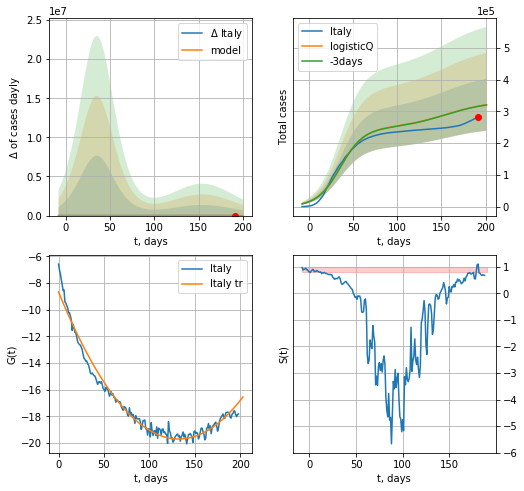

Italy data at: 2020-09-09
+3 day model MAPE: 0.002096
model: logisticQ
coeffs: [ 2.46340965e+05  1.24580822e-07  3.54647409e+01 -6.07979042e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.254611
forecast at the end of period: +10 days
	 deltaDaycases: 419
	 total cases: 320879 ± 81699
	 total death: 40541 ± 30966
trend coefficient of determination: 0.975234
 intercept_: -8.680649446988895
 coeffs_: [ 0.         -0.16681035  0.00063081]


In [901]:
x = forecastRRR('Italy',dfIT[:],d1,7*T18-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


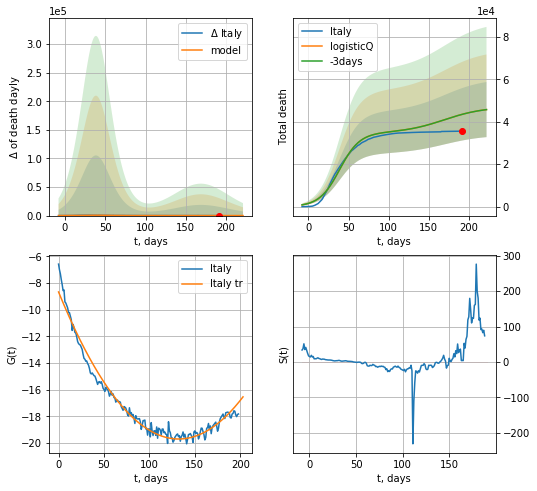

Italy data at: 2020-09-09
+3 day model MAPE: 0.000308
model: logisticQ
coeffs: [ 3.47395895e+04  1.63693412e-07  3.88177851e+01 -4.86320787e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.283952
forecast at the end of period: +31 days
	 total death: 45719 ± 12981
trend coefficient of determination: 0.975234
 intercept_: -8.680649446988895
 coeffs_: [ 0.         -0.16681035  0.00063081]


In [902]:
x = forecastRRR('Italy',dfIT[:],d1,7*28-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

In [903]:
dT

165

FR
           date     cases  active    death
203 2020-09-05  317706.0  199535  30724.0
204 2020-09-06  324777.0  206606  30724.0
205 2020-09-07  328980.0  210418  30726.0
206 2020-09-08  335524.0  216534  30764.0
207 2020-09-09  344101.0  224783  30794.0


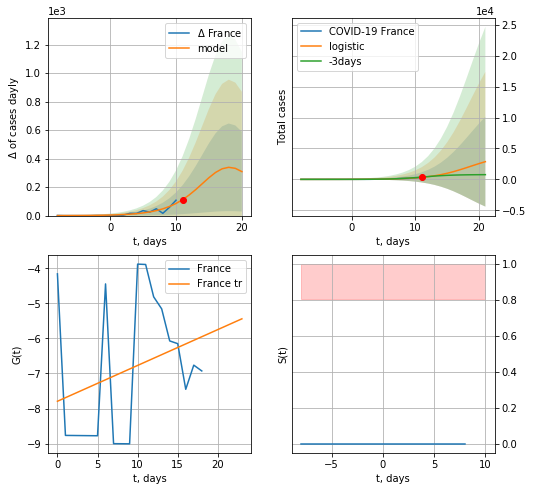

France data at: 2020-09-09
+3 day model MAPE: 0.04053351776025477
model: logistic
coeffs:  [4.17382756e+03 3.25568782e-01 1.85948993e+01]
rational stdev:  2.5390566064289986
forecast at the end of period: +10 days
	 deltaDaycases:  308
	 total cases:  2864 ± 7273
	 total death:  256 ± 1949
trend coefficient of determination: 0.083417
 intercept: -7.793073
 slope: 0.102246


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


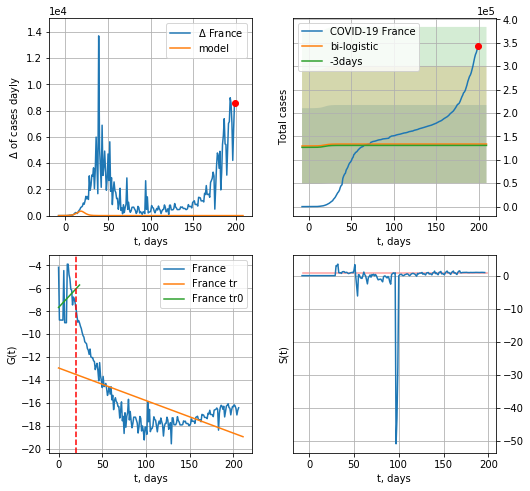

France data at: 2020-09-09
+3 day model MAPE: 0.02267740894718963
model: bi-logistic
coeffs:  [ 1.29490911e+05 -1.85995580e+01  2.10633996e+02] [4.17382756e+03 3.25568782e-01 1.85948993e+01]
rational stdev:  0.6238841821835676
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  133664 ± 83391
	 total death:  11961 ± 22386
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.062178
 intercept: -7.670498
 slope: 0.081817
trend coefficient of determination: 0.392716
 intercept: -12.958509
 slope: -0.028481


In [904]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
vL=20
try:
    x = forecast('France',dfFR[:vL],d1,T18*7-dT,1.0)
    xx = forecast2('France',dfFR,d1,T18*7-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.5],vL=vL)
except:
    print ("Exception occurs")

In [905]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

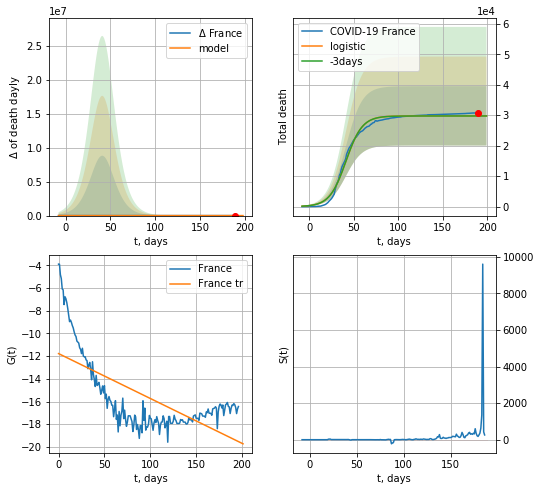

France data at: 2020-09-09
+3 day model MAPE: 0.0009368496515070741
model: logistic
coeffs:  [2.97716824e+04 1.09205884e-01 4.12474437e+01]
rational stdev:  0.3269457334947577
forecast at the end of period: +10 days
	 total death:  29771 ± 9733
trend coefficient of determination: 0.463055
 intercept: -11.772704
 slope: -0.039586


In [906]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*T18-dT,1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


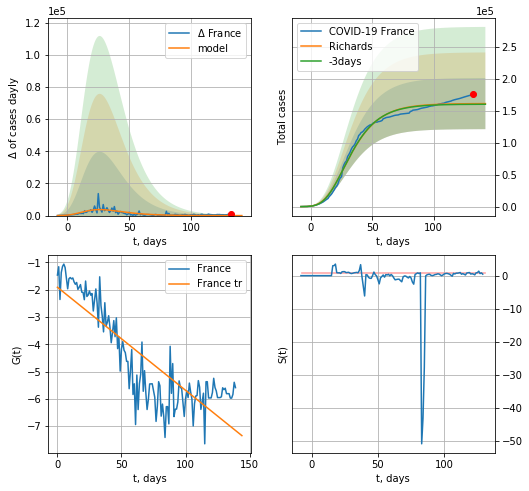

France data at: 2020-09-09
+3 day model MAPE: 0.006316
model: Richards
coeffs: [ 1.60997599e+05  1.46350142e+01 -5.95952768e+01  4.31594545e-03]
rational stdev: 0.248135
forecast at the end of period: +10 days
	 deltaDaycases: 7
	 total cases: 160887 ± 39921
	 total death: 14398 ± 10717
trend coefficient of determination: 0.728995
 intercept: -1.912518
 slope: -0.037751


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


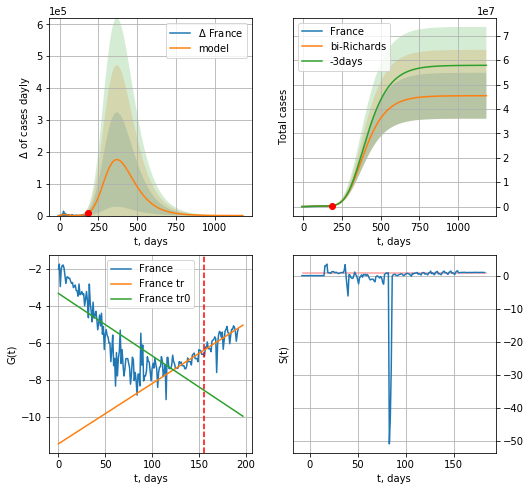

France data at: 2020-09-09
+3 day model MAPE: 0.000582
model: bi-Richards
coeffs: [4.52627190e+07 9.17817852e-02 1.81080219e+02 1.21868805e-01]
rational stdev: 0.206893
forecast at the end of period: +997 days
	 deltaDaycases: 57
	 total cases: 45418615 ± 9396803
	 total death: 4064564 ± 2522792
bi-Richards approximation splitting point: 155
trend coefficient of determination: 0.642036
 intercept: -3.329895
 slope: -0.033615
trend coefficient of determination: 0.451258
 intercept: -11.441582
 slope: 0.032479


In [907]:
vL = 86+14+40+29
x = forecastRR('France',dfFR[14:vL-14],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('France',dfFR[14:],d1,166*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-14)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


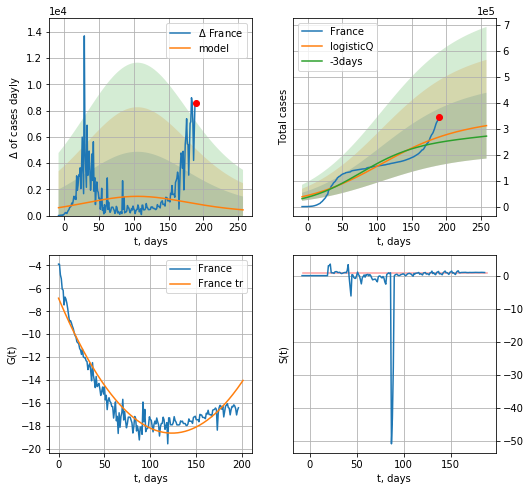

France data at: 2020-09-09
+3 day model MAPE: 0.084930
model: logisticQ
coeffs: [ 3.14811513e+05  2.28905107e-08  1.04353242e+02 -7.92315631e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.406446
forecast at the end of period: +69 days
	 deltaDaycases: 438
	 total cases: 312420 ± 126982
	 total death: 27958 ± 34090
trend coefficient of determination: 0.917287
 intercept_: -6.862607008326908
 coeffs_: [ 0.         -0.1906665   0.00077082]


In [908]:
x = forecastRRR('France',dfFR[10:],d1,34*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


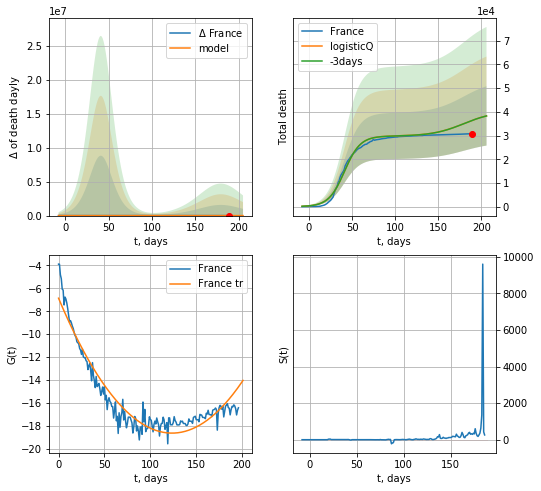

France data at: 2020-09-09
+3 day model MAPE: 0.000345
model: logisticQ
coeffs: [ 2.97717025e+04  2.47426355e-07  4.12482732e+01 -4.41182572e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.326989
forecast at the end of period: +17 days
	 total death: 38295 ± 12522
trend coefficient of determination: 0.917287
 intercept_: -6.862607008326908
 coeffs_: [ 0.         -0.1906665   0.00077082]


In [909]:
x = forecastRRR('France',dfFR[10:],d1,26*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1.])

In [910]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [911]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

GR
           date   cases  active   death
194 2020-09-05  251056   15447  9401.0
195 2020-09-06  251724   15323  9401.0
196 2020-09-07  253625   17220  9405.0
197 2020-09-08  254957   14948  9409.0
198 2020-09-09  256349   15039  9410.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:86: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


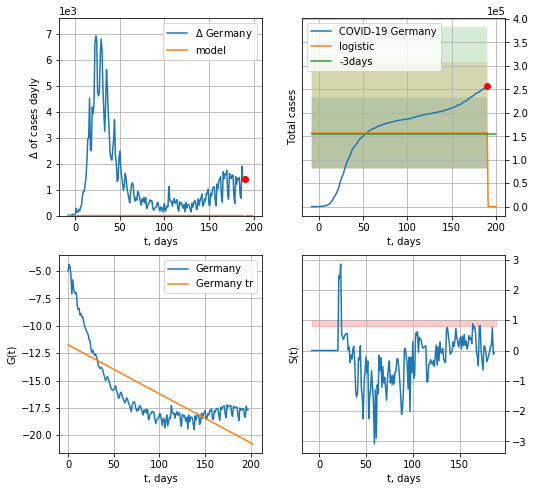

Germany data at: 2020-09-09
+3 day model MAPE: 0.9954920105329291
model: logistic
coeffs:  [ 1.56756412e+05 -5.11227243e+01  1.90894234e+02]
rational stdev:  0.4811311847193149
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.554029
 intercept: -11.738904
 slope: -0.044794


In [912]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[:],d1,7*T18-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


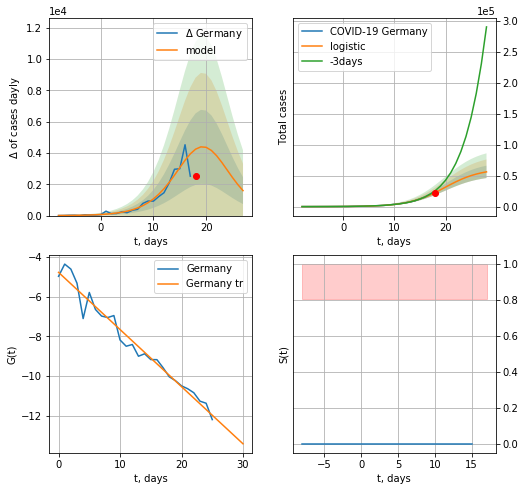

Germany data at: 2020-09-09
+3 day model MAPE: 0.1832688253569737
model: logistic
coeffs:  [6.15503848e+04 2.86340373e-01 1.98405530e+01]
rational stdev:  0.17812668621711658
forecast at the end of period: +10 days
	 deltaDaycases:  1593
	 total cases:  56124 ± 9997
	 total death:  2060 ± 1100
trend coefficient of determination: 0.966755
 intercept: -4.774386
 slope: -0.288157


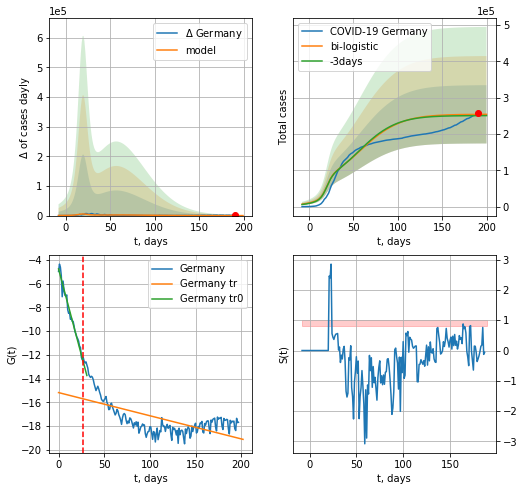

Germany data at: 2020-09-09
+3 day model MAPE: 0.013932403439296937
model: bi-logistic
coeffs:  [1.54178535e+05 5.10945499e-02 5.33971910e+01] [6.15503848e+04 2.86340373e-01 1.98405530e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.3157404445142186
forecast at the end of period: +10 days
	 deltaDaycases:  10
	 total cases:  254077 ± 80222
	 total death:  9326 ± 8833
bi-logistic approximation splitting point: 27
trend0 coefficient of determination: 0.970316
 intercept: -4.764587
 slope: -0.289333
trend coefficient of determination: 0.412416
 intercept: -15.172746
 slope: -0.019485


In [913]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,T18*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*T18-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

GR
           date   cases  active   death
194 2020-09-05  251056   15447  9401.0
195 2020-09-06  251724   15323  9401.0
196 2020-09-07  253625   17220  9405.0
197 2020-09-08  254957   14948  9409.0
198 2020-09-09  256349   15039  9410.0


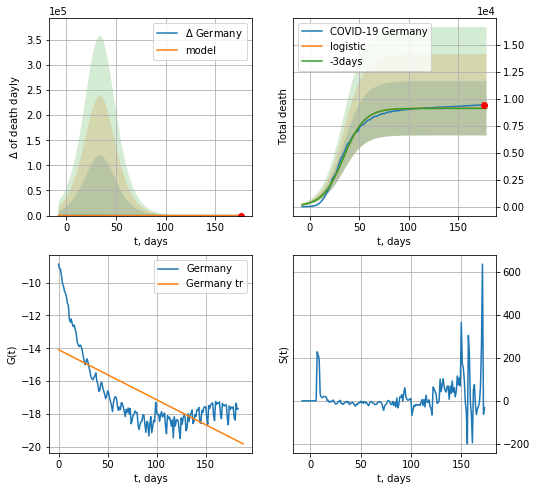

Germany data at: 2020-09-09
+3 day model MAPE: 0.001049879369021281
model: logistic
coeffs:  [9.10289366e+03 9.40096735e-02 3.41062647e+01]
rational stdev:  0.2757812787125049
forecast at the end of period: +3 days
	 total death:  9102 ± 2510
trend coefficient of determination: 0.496690
 intercept: -14.083776
 slope: -0.030448


In [914]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[14:],d1,24*7-dT,1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


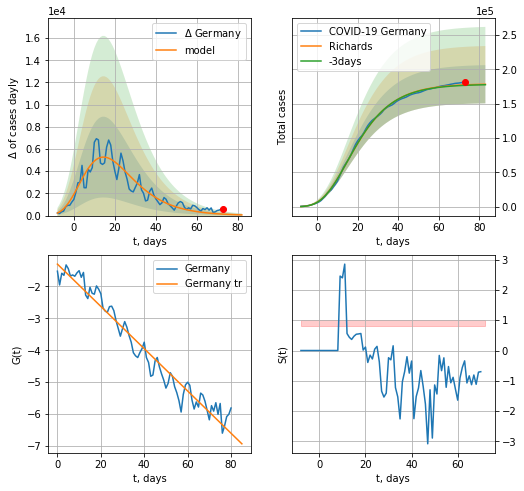

Germany data at: 2020-09-09
+3 day model MAPE: 0.003910
model: Richards
coeffs: [ 1.79110642e+05  9.15687169e+00 -4.39392677e+01  8.78226811e-03]
rational stdev: 0.155919
forecast at the end of period: +10 days
	 deltaDaycases: 62
	 total cases: 178360 ± 27809
	 total death: 6547 ± 3062
trend coefficient of determination: 0.956451
 intercept: -1.304276
 slope: -0.066178


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


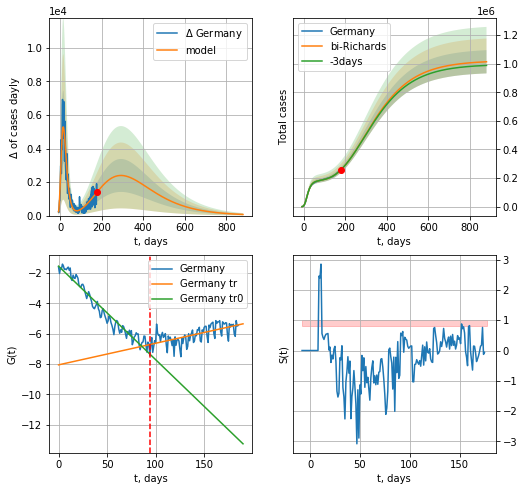

Germany data at: 2020-09-09
+3 day model MAPE: 0.000727
model: bi-Richards
coeffs: [ 8.42916379e+05  4.05830607e-01 -2.14063333e+02  1.92081541e-02]
rational stdev: 0.080186
forecast at the end of period: +703 days
	 deltaDaycases: 66
	 total cases: 1013461 ± 81265
	 total death: 37201 ± 8949
bi-Richards approximation splitting point: 94
trend coefficient of determination: 0.950650
 intercept: -1.546208
 slope: -0.061606
trend coefficient of determination: 0.410259
 intercept: -8.049456
 slope: 0.014231


In [917]:
vL = 94+12
x = forecastRR('Germany',dfGR[12:vL-12],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Germany',dfGR[12:],d1,124*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


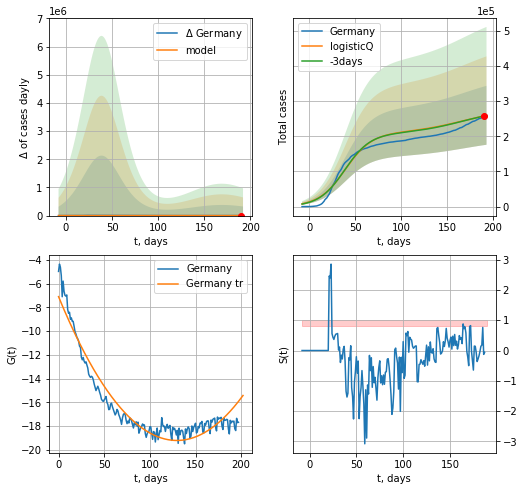

Germany data at: 2020-09-09
+3 day model MAPE: 0.002186
model: logisticQ
coeffs: [ 2.08486307e+05  4.26087132e-08  3.89425108e+01 -1.62751227e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.322602
forecast at the end of period: +3 days
	 deltaDaycases: 552
	 total cases: 259613 ± 83752
	 total death: 9529 ± 9222
trend coefficient of determination: 0.929511
 intercept_: -7.09692322408681
 coeffs_: [ 0.         -0.18689582  0.00072133]


In [918]:
x = forecastRRR('Germany',dfGR[:],d1,24*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.0,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


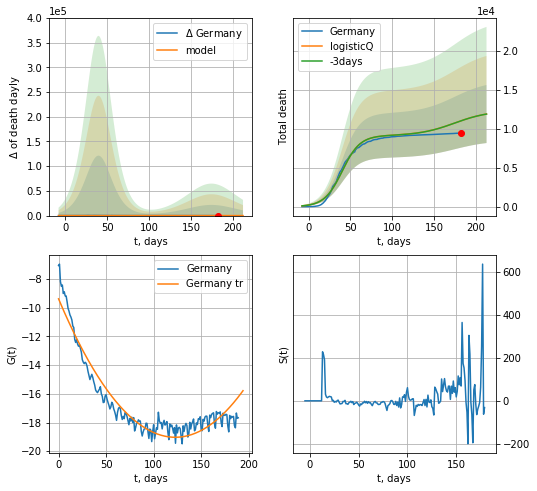

Germany data at: 2020-09-09
+3 day model MAPE: 0.000417
model: logisticQ
coeffs: [ 9.10191200e+03  2.14939354e-07  4.01066788e+01 -4.38253998e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.313547
forecast at the end of period: +31 days
	 total death: 11872 ± 3722
trend coefficient of determination: 0.920291
 intercept_: -9.374733516793082
 coeffs_: [ 0.         -0.15727143  0.00064051]


In [919]:
x = forecastRRR('Germany',dfGR[8:],d1,28*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.0,1])

US
           date    cases   active     death
188 2020-09-05  6431160  2531340  192820.0
189 2020-09-06  6460421  2541069  193253.0
190 2020-09-07  6485575  2533412  193534.0
191 2020-09-08  6514376  2523166  194037.0
192 2020-09-09  6549475  2508141  195239.0


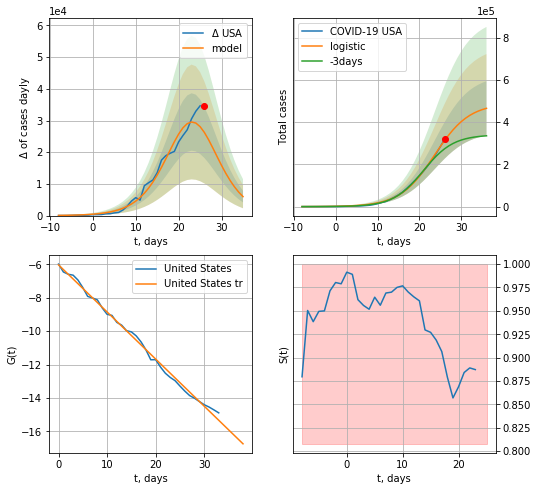

USA data at: 2020-09-09
+3 day model MAPE: 0.17962965905806133
model: logistic
coeffs:  [4.89025787e+05 2.41973856e-01 2.36121759e+01]
rational stdev:  0.27607026078318453
forecast at the end of period: +10 days
	 deltaDaycases:  5983
	 total cases:  465778 ± 128587
	 total death:  13884 ± 11498
trend coefficient of determination: 0.995387
 intercept: -6.036925
 slope: -0.281840


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


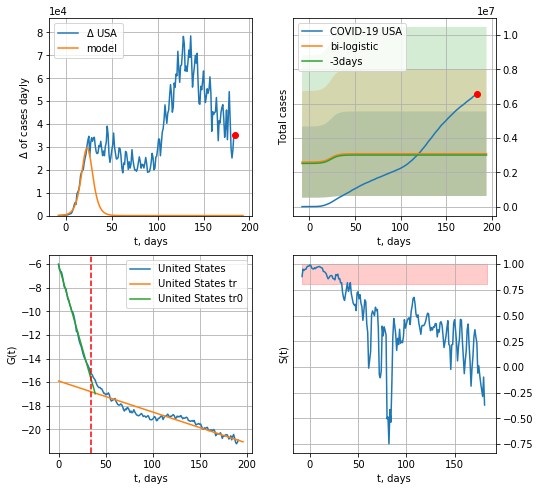

USA data at: 2020-09-09
+3 day model MAPE: 0.025971743965136847
model: bi-logistic
coeffs:  [ 2.07442766e+06 -2.43056447e+01  5.85700455e+02] [4.89025787e+05 2.41973856e-01 2.36121759e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.7988674195819664
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  3082060 ± 2462157
	 total death:  91875 ± 220187
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.995488
 intercept: -6.051468
 slope: -0.280518
trend coefficient of determination: 0.882327
 intercept: -15.907315
 slope: -0.026335


In [920]:
vL=35
dfUS = read_df(pd.DataFrame(),"US")
x = forecast('USA',dfUS[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,T18*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=vL)

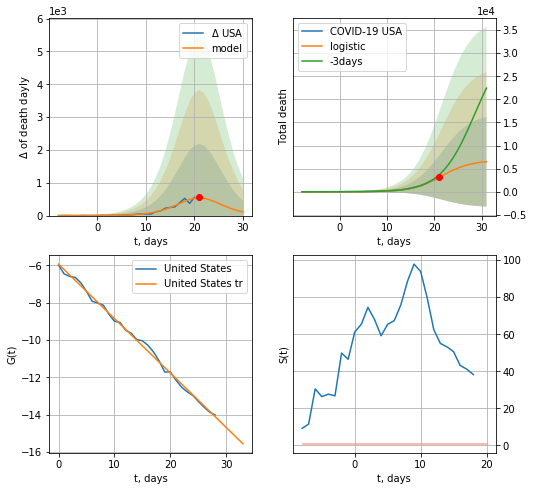

USA data at: 2020-09-09
+3 day model MAPE: 0.21421329662103625
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +10 days
	 total death:  6512 ± 9721
trend coefficient of determination: 0.996549
 intercept: -5.938291
 slope: -0.291586


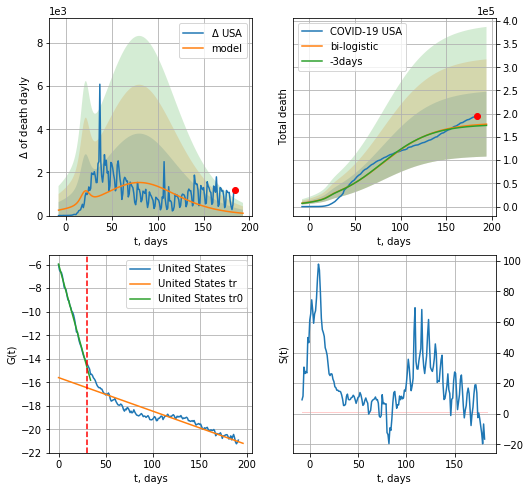

USA data at: 2020-09-09
+3 day model MAPE: 0.014271368999708054
model: bi-logistic
coeffs:  [1.73698357e+05 3.53290934e-02 8.03457563e+01] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.39333308679766965
forecast at the end of period: +10 days
	 deltaDaydeath:  108
	 total death:  177454 ± 69798
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996707
 intercept: -5.949158
 slope: -0.290421
trend coefficient of determination: 0.858899
 intercept: -15.604784
 slope: -0.028522


In [921]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*T18-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*T18-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


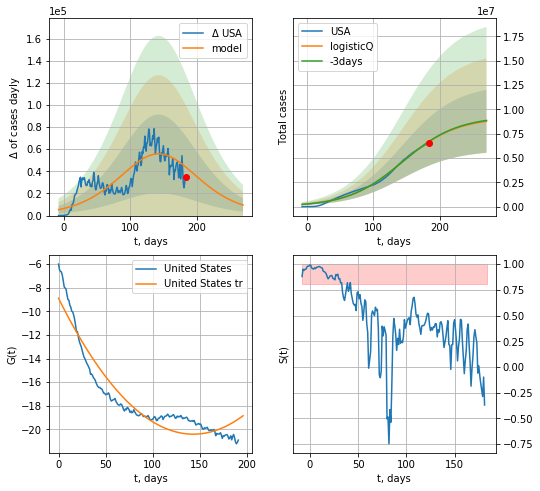

USA data at: 2020-09-09
+3 day model MAPE: 0.004184
model: logisticQ
coeffs: [ 9.10180779e+06  2.69980303e-07  1.43101854e+02 -9.05316305e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.369157
forecast at the end of period: +87 days
	 deltaDaycases: 9525
	 total cases: 8764092 ± 3235327
	 total death: 261256 ± 289333
trend coefficient of determination: 0.899377
 intercept_: -8.89270290792491
 coeffs_: [ 0.         -0.16091502  0.00056157]


In [922]:
x = forecastRRR('USA',dfUS[:],d1,7*36-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


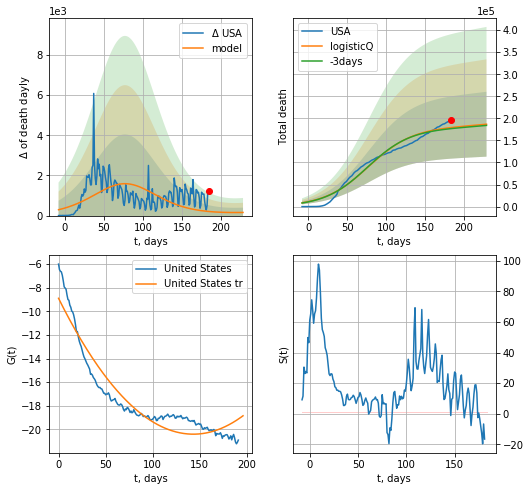

USA data at: 2020-09-09
+3 day model MAPE: 0.013668
model: logisticQ
coeffs: [ 1.79406321e+05  4.38331368e-08  7.72588199e+01 -8.03100713e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.393660
forecast at the end of period: +45 days
	 total death: 186760 ± 73520
trend coefficient of determination: 0.899377
 intercept_: -8.89270290792491
 coeffs_: [ 0.         -0.16091502  0.00056157]


In [923]:
x = forecastRRR('USA',dfUS[:],d1,7*30-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


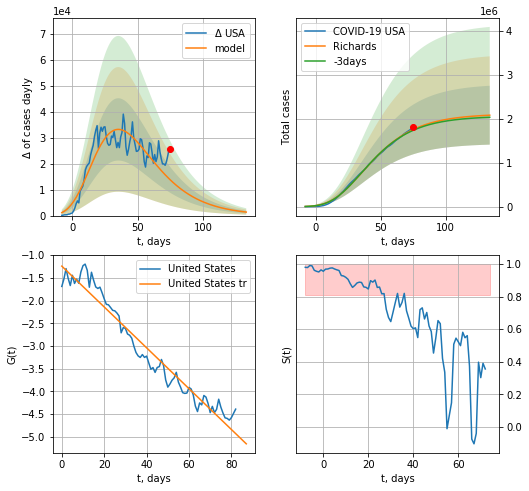

USA data at: 2020-09-09
+3 day model MAPE: 0.011172
model: Richards
coeffs: [ 2.11547275e+06  4.55740072e+00 -7.32299429e+01  9.40207859e-03]
rational stdev: 0.321873
forecast at the end of period: +59 days
	 deltaDaycases: 1350
	 total cases: 2084385 ± 670907
	 total death: 62135 ± 59998
trend coefficient of determination: 0.952323
 intercept: -1.242017
 slope: -0.044961


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


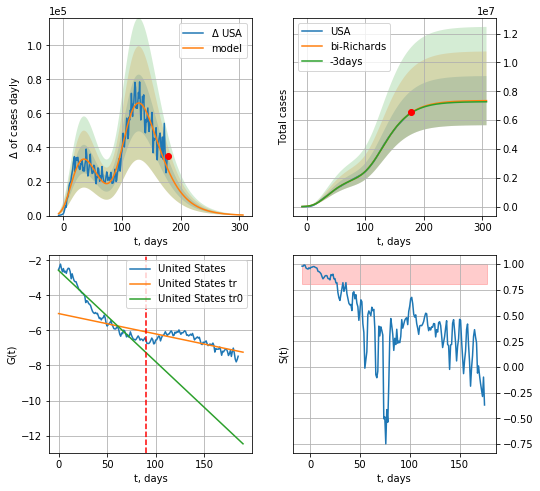

USA data at: 2020-09-09
+3 day model MAPE: 0.003178
model: bi-Richards
coeffs: [5.24266431e+06 2.50738687e-01 7.55947413e+01 1.42900561e-01]
rational stdev: 0.231964
forecast at the end of period: +129 days
	 deltaDaycases: 335
	 total cases: 7348931 ± 1704687
	 total death: 219070 ± 152449
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.937687
 intercept: -2.575951
 slope: -0.052059
trend coefficient of determination: 0.523528
 intercept: -5.038423
 slope: -0.011594


In [924]:
iL = 6
vL = 90+iL
x = forecastRR('USA',dfUS[iL:vL-iL],d1,7*32-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('USA',dfUS[iL:],d1,7*42-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [925]:
#x = forecastQR('USA',dfUS[20:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

GB
           date   cases  active    death
192 2020-09-05  344164       0  41549.0
193 2020-09-06  347152       0  41551.0
194 2020-09-07  350100       0  41554.0
195 2020-09-08  352560       0  41586.0
196 2020-09-09  355219       0  41594.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


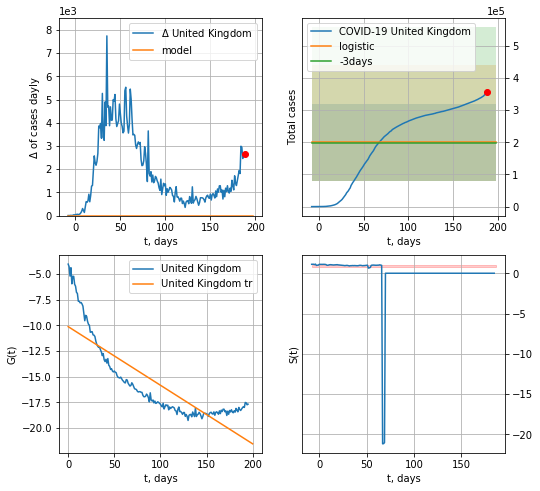

United Kingdom data at: 2020-09-09
+3 day model MAPE: 0.011915878568698265
model: logistic
coeffs:  [ 2.00186807e+05 -1.07235482e+01  2.72819888e+02]
rational stdev:  0.5972010052485187
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  200186 ± 119551
	 total death:  23440 ± 41995
trend coefficient of determination: 0.717105
 intercept: -10.121780
 slope: -0.057084


In [926]:
try:
    dfGB = read_df(pd.DataFrame(),"GB")
    x = forecast('United Kingdom',dfGB[:],d1,7*T18-dT,1.)
    #x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
    #xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


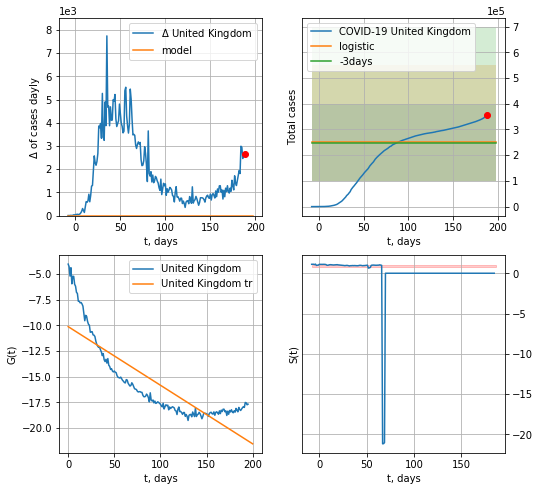

United Kingdom data at: 2020-09-09
+3 day model MAPE: 0.011915878568698295
model: logistic
coeffs:  [ 2.00186807e+05 -1.07235482e+01  2.72819888e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.5972010052485187
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  250233 ± 149439
	 total death:  29300 ± 52493
trend coefficient of determination: 0.717105
 intercept: -10.121780
 slope: -0.057084


In [927]:
x = forecast('United Kingdom',dfGB[:],d1,T18*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: divide by zero encountered in true_divide


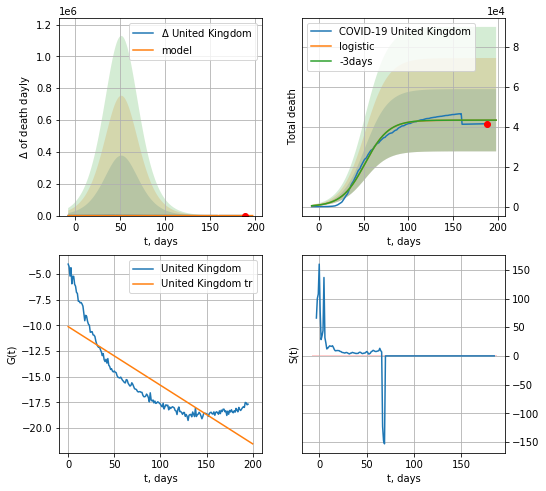

United Kingdom data at: 2020-09-09
+3 day model MAPE: 0.001482558609430459
model: logistic
coeffs:  [4.33349686e+04 7.67935740e-02 5.16012212e+01]
rational stdev:  0.36028439789847294
forecast at the end of period: +10 days
	 total death:  43334 ± 15612
trend coefficient of determination: 0.717105
 intercept: -10.121780
 slope: -0.057084


In [928]:
x = forecast('United Kingdom',dfGB[:],d1,T18*7-dT,1.,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


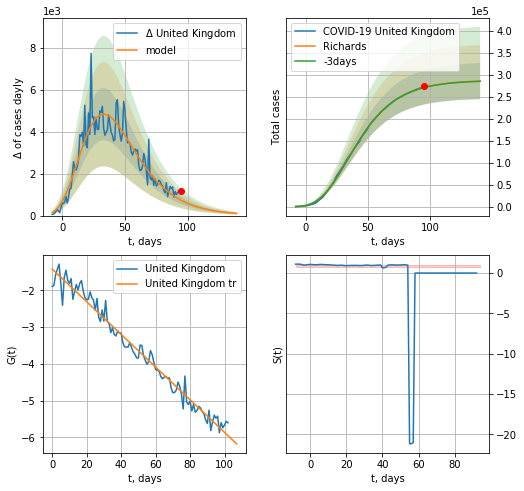

United Kingdom data at: 2020-09-09
+3 day model MAPE: 0.001530
model: Richards
coeffs: [ 2.88040344e+05  3.82469918e+00 -6.26359665e+01  1.20178265e-02]
rational stdev: 0.143621
forecast at the end of period: +45 days
	 deltaDaycases: 100
	 total cases: 285887 ± 41059
	 total death: 33475 ± 14423
trend coefficient of determination: 0.974342
 intercept: -1.421044
 slope: -0.044452


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


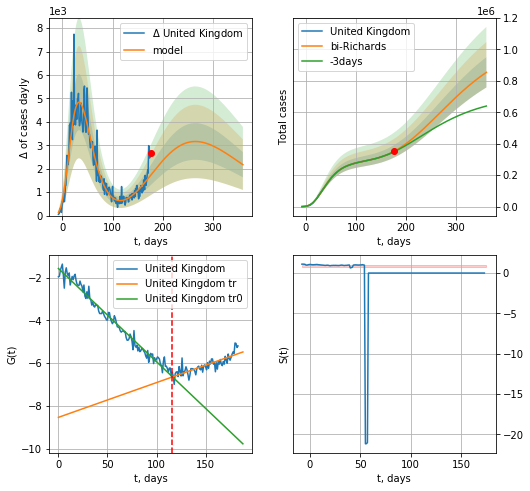

United Kingdom data at: 2020-09-09
+3 day model MAPE: 0.007267
model: bi-Richards
coeffs: [ 8.09875792e+05  4.49157888e-01 -8.17415424e+01  2.39243012e-02]
rational stdev: 0.112763
forecast at the end of period: +185 days
	 deltaDaycases: 2173
	 total cases: 854567 ± 96363
	 total death: 100064 ± 33850
bi-Richards approximation splitting point: 116
trend coefficient of determination: 0.977054
 intercept: -1.573155
 slope: -0.043652
trend coefficient of determination: 0.675774
 intercept: -8.541438
 slope: 0.016278


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide


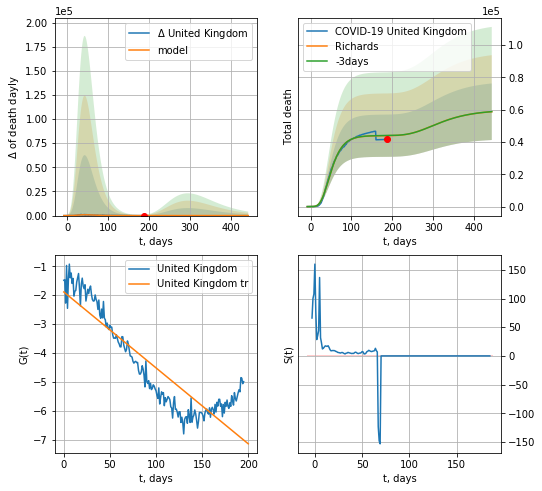

United Kingdom data at: 2020-09-09
+3 day model MAPE: 0.002104
model: Richards
coeffs: [ 4.38696975e+04  7.59605907e+00 -5.14527531e+01  6.90873046e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.298064
forecast at the end of period: +255 days
	 total death: 58686 ± 17492
trend coefficient of determination: 0.803390
 intercept: -1.887572
 slope: -0.026205


In [929]:
vL = 116+12
x = forecastRR('United Kingdom',dfGB[12:vL-12],d1,30*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('United Kingdom',dfGB[12:],d1,50*7-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)
x = forecastRR('United Kingdom',dfGB[:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


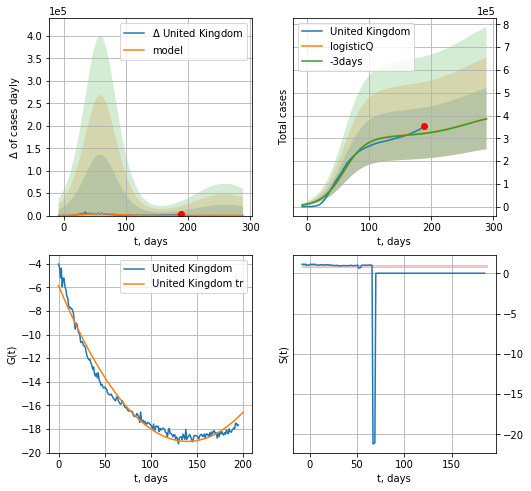

United Kingdom data at: 2020-09-09
+3 day model MAPE: 0.006980
model: logisticQ
coeffs: [ 3.09776174e+05  7.27252493e-08  5.94239388e+01 -7.66130124e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.347379
forecast at the end of period: +101 days
	 deltaDaycases: 651
	 total cases: 386426 ± 134236
	 total death: 45248 ± 47154
trend coefficient of determination: 0.976078
 intercept_: -5.8478571302208735
 coeffs_: [ 0.         -0.18926745  0.00067787]


In [930]:
x = forecastRRR('United Kingdom',dfGB[:],d1,38*7-dT,1.,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


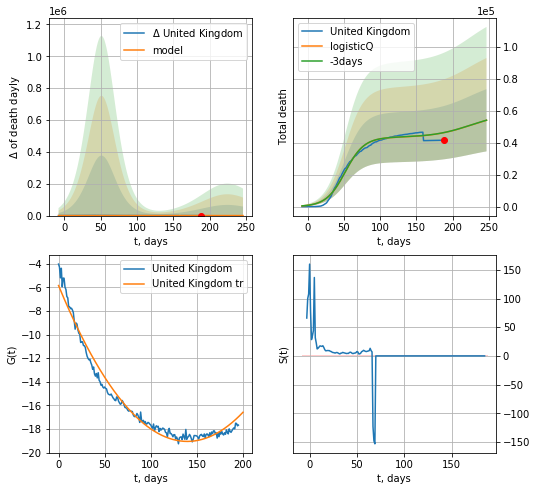

United Kingdom data at: 2020-09-09
+3 day model MAPE: 0.001170
model: logisticQ
coeffs: [ 4.33348731e+04  1.67415637e-07  5.16024872e+01 -4.58501393e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.360308
forecast at the end of period: +59 days
	 total death: 54096 ± 19491
trend coefficient of determination: 0.976078
 intercept_: -5.8478571302208735
 coeffs_: [ 0.         -0.18926745  0.00067787]


In [931]:
x = forecastRRR('United Kingdom',dfGB[:],d1,32*7-dT,1.,addpred=True,xcoef=koreaCoeffs,cases='death')

In [932]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [933]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [934]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [935]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [936]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

DK
           date    cases  active  death
191 2020-09-05  17736.0    1438  627.0
192 2020-09-06  17883.0    1496  627.0
193 2020-09-07  18113.0    1652  628.0
194 2020-09-08  18356.0    1821  628.0
195 2020-09-09  18607.0    1989  628.0


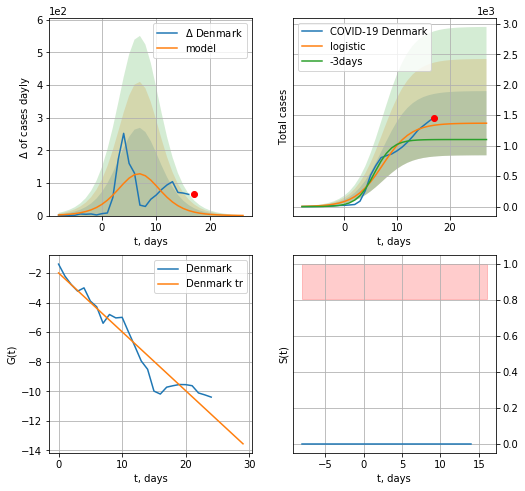

Denmark data at: 2020-09-09
+3 day model MAPE: 0.22309164797181072
model: logistic
coeffs:  [1.36966074e+03 3.75718857e-01 7.30059730e+00]
rational stdev:  0.3847660616131427
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  1368 ± 526
	 total death:  46 ± 53
trend coefficient of determination: 0.928037
 intercept: -1.984791
 slope: -0.399221


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


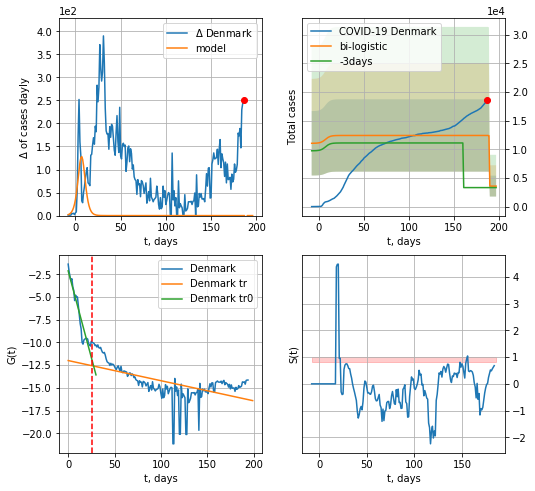

Denmark data at: 2020-09-09
+3 day model MAPE: 2.7418085717934146
model: bi-logistic
coeffs:  [8830.45975707  -18.92162319  189.28806739] [1.36966074e+03 3.75718857e-01 7.30059730e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.5086127044446425
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  3577 ± 1819
	 total death:  120 ± 183
bi-logistic approximation splitting point: 26
trend0 coefficient of determination: 0.914728
 intercept: -2.128126
 slope: -0.381304
trend coefficient of determination: 0.317000
 intercept: -11.993723
 slope: -0.022138


In [937]:
dfDK = read_df(pd.DataFrame(),"DK")
vL = 26
try:
    x = forecast('Denmark',dfDK[:vL],d1,7*T18-dT,1.0)
    xx = forecast2('Denmark',dfDK[:],d1,T18*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
except:
    print("Exception occurs")

In [938]:
d12f(4)

'2020-09-06'

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


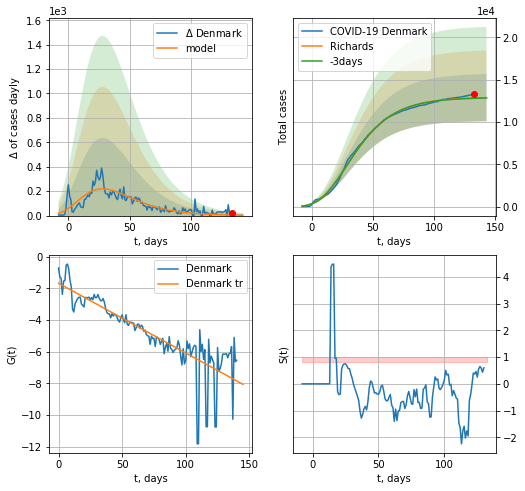

Denmark data at: 2020-09-09
+3 day model MAPE: 0.003205
model: Richards
coeffs: [ 1.29346492e+04  5.54024476e+00 -7.51621135e+01  8.35187087e-03]
rational stdev: 0.216347
forecast at the end of period: +10 days
	 deltaDaycases: 3
	 total cases: 12870 ± 2784
	 total death: 434 ± 281
trend coefficient of determination: 0.712007
 intercept: -1.674251
 slope: -0.044008


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


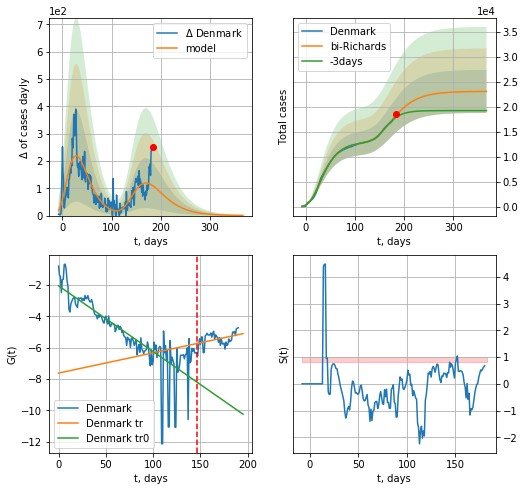

Denmark data at: 2020-09-09
+3 day model MAPE: 0.022898
model: bi-Richards
coeffs: [1.01867688e+04 7.56017601e-01 7.24042944e+01 4.26679394e-02]
rational stdev: 0.186622
forecast at the end of period: +185 days
	 deltaDaycases: 0
	 total cases: 23104 ± 4311
	 total death: 779 ± 436
bi-Richards approximation splitting point: 146
trend coefficient of determination: 0.691387
 intercept: -2.040890
 slope: -0.042035
trend coefficient of determination: 0.154558
 intercept: -7.615314
 slope: 0.012913


In [940]:
vL = 150#125+4
x = forecastRR('Denmark',dfDK[4:vL-4],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Denmark',dfDK[4:],d1,50*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


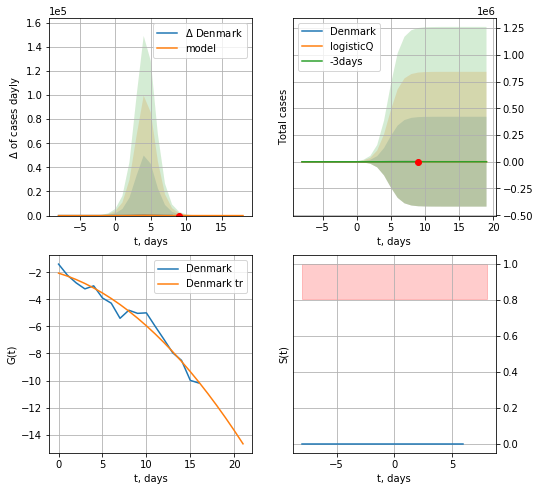

Denmark data at: 2020-09-09
+3 day model MAPE: 2.879608
model: logisticQ
coeffs: [ 8.62480486e+02  2.49394711e-04  4.73670535e+00 -4.50101209e+03]
rational stdev: 487.273007
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 862 ± 420263
	 total death: 29 ± 42392
trend coefficient of determination: 0.965266
 intercept_: -2.0557034713075613
 coeffs_: [ 0.         -0.1970759  -0.01925246]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


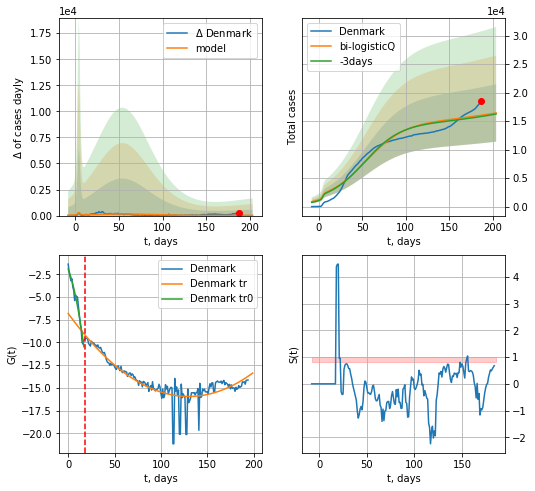

Denmark data at: 2020-09-09
+3 day model MAPE: 0.013421
model: bi-logisticQ
coeffs: [ 1.39633423e+04  3.20329235e-08  5.40919577e+01 -1.39125630e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.306256
forecast at the end of period: +17 days
	 deltaDaycases: 25
	 total cases: 16435 ± 5033
	 total death: 554 ± 508
bi-logisticQ approximation splitting point: 18
trend coefficient of determination: 0.963211
 intercept_: -1.9308894789691964
 coeffs_: [ 0.         -0.26605777 -0.01390014]
trend coefficient of determination: 0.758829
 intercept_: -6.812284857740619
 coeffs_: [ 0.         -0.14049566  0.00054034]


In [941]:
x = forecastRRR('Denmark',dfDK[:18],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[0.35,0.5,4.5,1.])
x = forecast2RRR('Denmark',dfDK[:],d1,26*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=18)

NG
           date    cases  active  death
192 2020-09-05  11296.0    1684  264.0
193 2020-09-06  11388.0    1776  264.0
194 2020-09-07  11521.0    1909  264.0
195 2020-09-08  11623.0    2011  264.0
196 2020-09-09  11746.0    2134  264.0


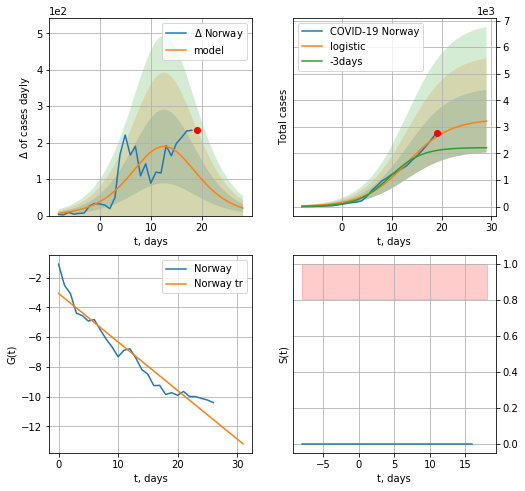

Norway data at: 2020-09-09
+3 day model MAPE: 0.28148190042351234
model: logistic
coeffs:  [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.36743919108062534
forecast at the end of period: +10 days
	 deltaDaycases:  20
	 total cases:  3216 ± 1181
	 total death:  72 ± 79
trend coefficient of determination: 0.927855
 intercept: -3.067798
 slope: -0.326083


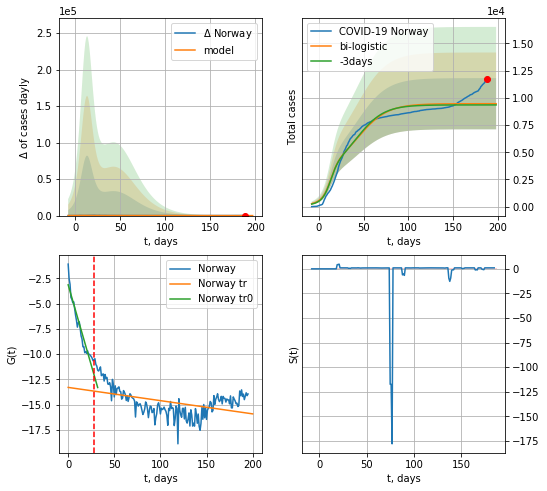

Norway data at: 2020-09-09
+3 day model MAPE: 0.011972444640002172
model: bi-logistic
coeffs:  [6.16440475e+03 6.13958789e-02 4.38219605e+01] [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.24877074508107072
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  9461 ± 2353
	 total death:  212 ± 158
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.199443
 intercept: -13.281194
 slope: -0.013080


In [942]:
dfNG = read_df(pd.DataFrame(),"NG")
vL=28
x = forecast('Norway',dfNG[:vL],d1,7*T18-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,T18*7-dT,x,1.0,vL=vL)
#xx = np.concatenate((x, xx), axis=0)

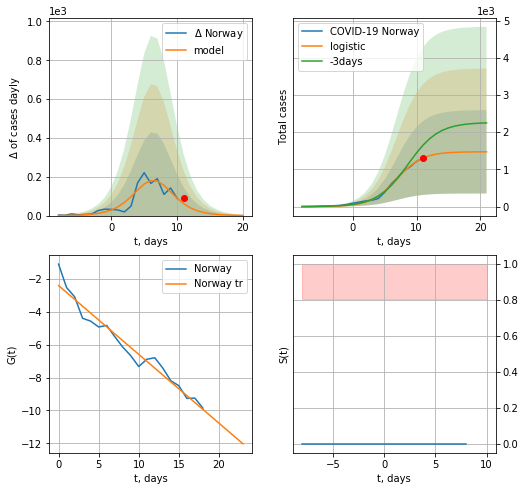

Norway data at: 2020-09-09
+3 day model MAPE: 0.24765534865647335
model: logistic
coeffs:  [1.47478892e+03 4.95866797e-01 6.87524750e+00]
rational stdev:  0.7596156046192828
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  1473 ± 1119
	 total death:  33 ± 75
trend coefficient of determination: 0.956890
 intercept: -2.403448
 slope: -0.418410


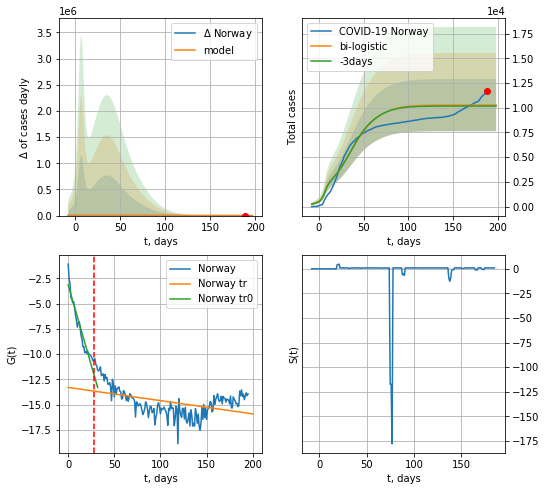

Norway data at: 2020-09-09
+3 day model MAPE: 0.009035837139221055
model: bi-logistic
coeffs:  [7.81704609e+03 7.86057070e-02 3.48567287e+01] [1.47478892e+03 4.95866797e-01 6.87524750e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.2568214097317521
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  10268 ± 2637
	 total death:  230 ± 177
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.199443
 intercept: -13.281194
 slope: -0.013080


In [943]:
vL = 28#len(dfNG)-13-dT
x = forecast('Norway',dfNG[:-12-dT],d1,7*T18-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,T18*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


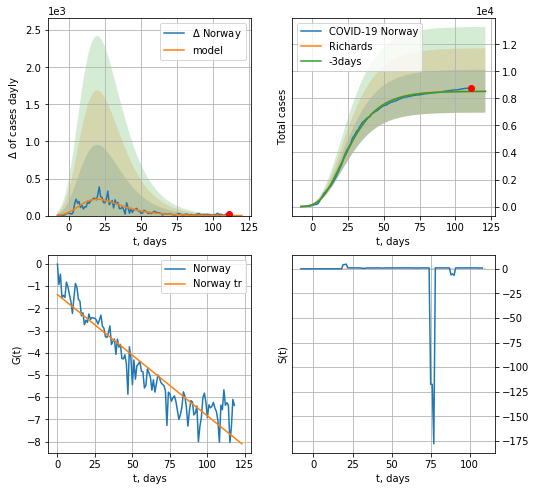

Norway data at: 2020-09-09
+3 day model MAPE: 0.002349
model: Richards
coeffs: [ 8.53893504e+03  9.40298407e+00 -4.93140335e+01  7.49676920e-03]
rational stdev: 0.185681
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 8531 ± 1584
	 total death: 191 ± 106
trend coefficient of determination: 0.886133
 intercept: -1.376205
 slope: -0.054692


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


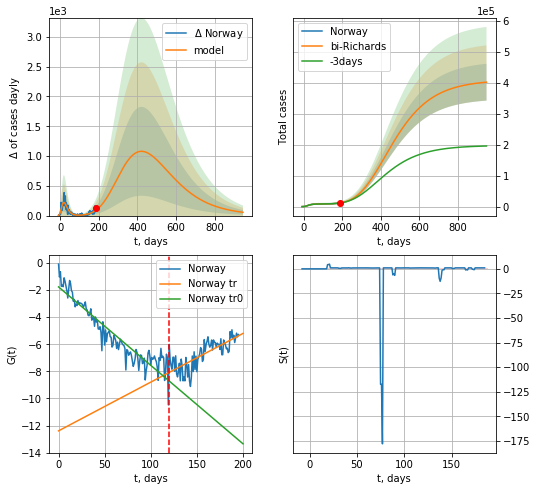

Norway data at: 2020-09-09
+3 day model MAPE: 0.006678
model: bi-Richards
coeffs: [4.00606184e+05 9.88162813e-02 8.40597334e+01 7.69586750e-02]
rational stdev: 0.148063
forecast at the end of period: +759 days
	 deltaDaycases: 55
	 total cases: 401865 ± 59501
	 total death: 9032 ± 4011
bi-Richards approximation splitting point: 120
trend coefficient of determination: 0.883084
 intercept: -1.767369
 slope: -0.057916
trend coefficient of determination: 0.566707
 intercept: -12.393575
 slope: 0.035972


In [945]:
vL = 120#96+22
x = forecastRR('Norway',dfNG[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Norway',dfNG[:],d1,132*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


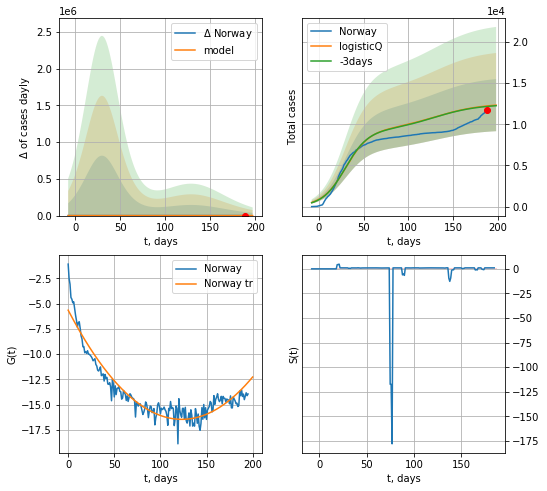

Norway data at: 2020-09-09
+3 day model MAPE: 0.005143
model: logisticQ
coeffs: [ 9.26879890e+03  6.20600898e-08  2.98644235e+01 -1.23313830e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.256943
forecast at the end of period: +10 days
	 deltaDaycases: 8
	 total cases: 12327 ± 3167
	 total death: 277 ± 213
trend coefficient of determination: 0.905855
 intercept_: -5.651573774083753
 coeffs_: [ 0.         -0.17504755  0.00071012]


In [946]:
x = forecastRRR('Norway',dfNG[:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


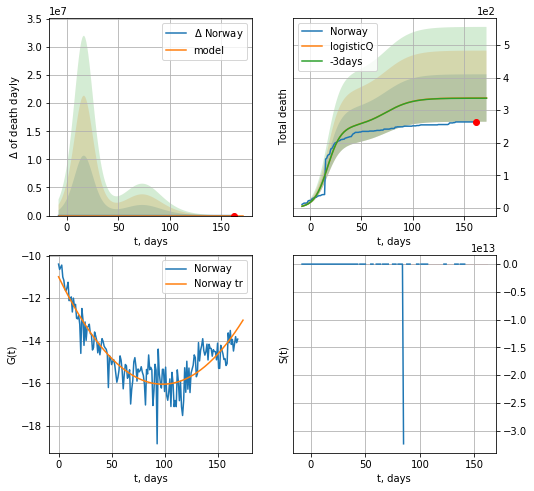

Norway data at: 2020-09-09
+3 day model MAPE: 0.001607
model: logisticQ
coeffs: [ 2.49184969e+02  2.93750693e-07  1.69406168e+01 -5.23337848e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.215512
forecast at the end of period: +10 days
	 total death: 337 ± 72
trend coefficient of determination: 0.805167
 intercept_: -10.996090602500946
 coeffs_: [ 0.         -0.10296424  0.00052433]


In [947]:
x = forecastRRR('Norway',dfNG[26:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

SW
           date  cases  active   death
193 2020-09-05  85175       0  5835.0
194 2020-09-06  85366       0  5835.0
195 2020-09-07  85558       0  5837.0
196 2020-09-08  85707       0  5838.0
197 2020-09-09  85880       0  5842.0


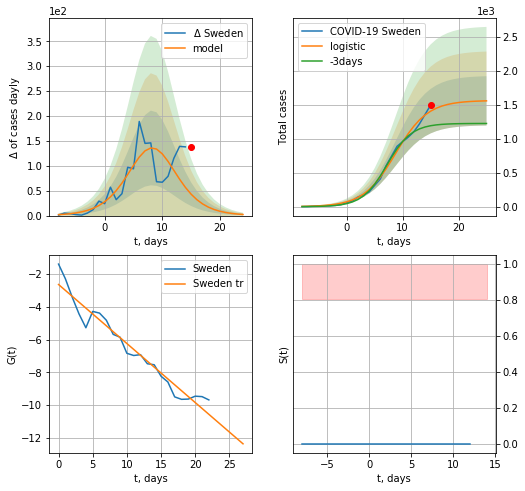

Sweden data at: 2020-09-09
+3 day model MAPE: 0.20348254679733155
model: logistic
coeffs:  [1.56232986e+03 3.49134536e-01 8.72829156e+00]
rational stdev:  0.2329336409619122
forecast at the end of period: +10 days
	 deltaDaycases:  2
	 total cases:  1557 ± 362
	 total death:  105 ± 73
trend coefficient of determination: 0.947679
 intercept: -2.633085
 slope: -0.360867


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


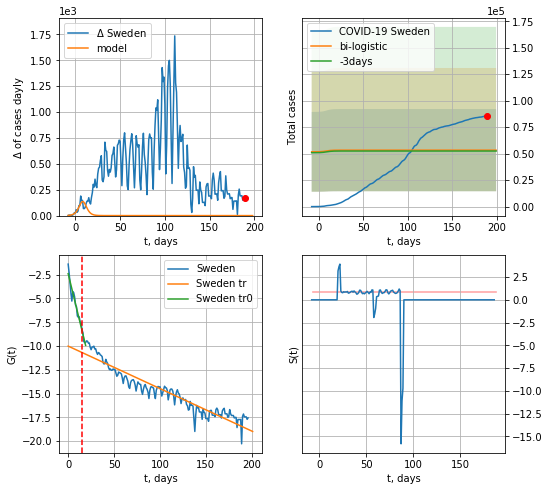

Sweden data at: 2020-09-09
+3 day model MAPE: 0.01567205518452315
model: bi-logistic
coeffs:  [ 4.13881910e+04 -1.54282086e+01  3.80983714e+02] [1.56232986e+03 3.49134536e-01 8.72829156e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.7277375353150519
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  53297 ± 38786
	 total death:  3625 ± 7914
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.906612
 intercept: -2.393320
 slope: -0.396924
trend coefficient of determination: 0.900779
 intercept: -10.012436
 slope: -0.044673


In [948]:
vL = 15#len(dfSW)-12-dT
dfSW = read_df(pd.DataFrame(),"SW")
try:
    x = forecast('Sweden',dfSW[:-9-dT],d1,7*T18-dT,1.0)
    xx = forecast2('Sweden',dfSW[:],d1,7*T18-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)
except:
    print ("Exception occurs")

SW
           date  cases  active   death
193 2020-09-05  85175       0  5835.0
194 2020-09-06  85366       0  5835.0
195 2020-09-07  85558       0  5837.0
196 2020-09-08  85707       0  5838.0
197 2020-09-09  85880       0  5842.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


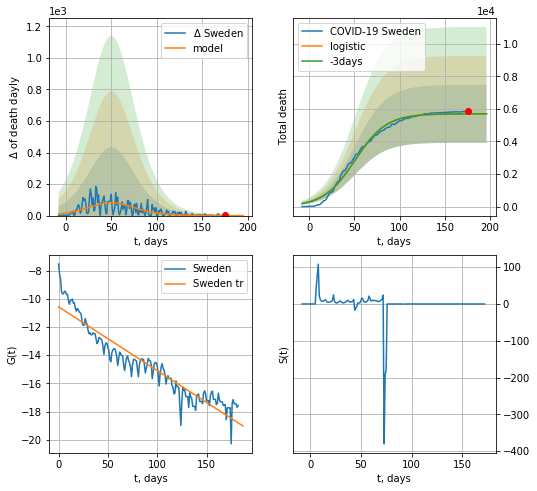

Sweden data at: 2020-09-09
+3 day model MAPE: 0.0012892590970906724
model: logistic
coeffs:  [5.70547341e+03 5.78389814e-02 5.05704009e+01]
rational stdev:  0.3116105296058732
forecast at the end of period: +21 days
	 total death:  5704 ± 1777
trend coefficient of determination: 0.897100
 intercept: -10.570742
 slope: -0.045225


In [949]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


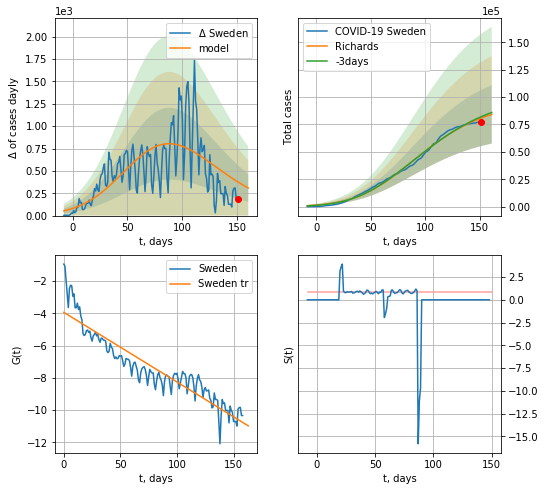

Sweden data at: 2020-09-09
+3 day model MAPE: 0.015048
model: Richards
coeffs: [9.67246034e+04 6.99759012e-02 5.25862336e+01 3.83189345e-01]
rational stdev: 0.316495
forecast at the end of period: +10 days
	 deltaDaycases: 308
	 total cases: 84186 ± 26644
	 total death: 5726 ± 5436
trend coefficient of determination: 0.860612
 intercept: -3.945277
 slope: -0.043120


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


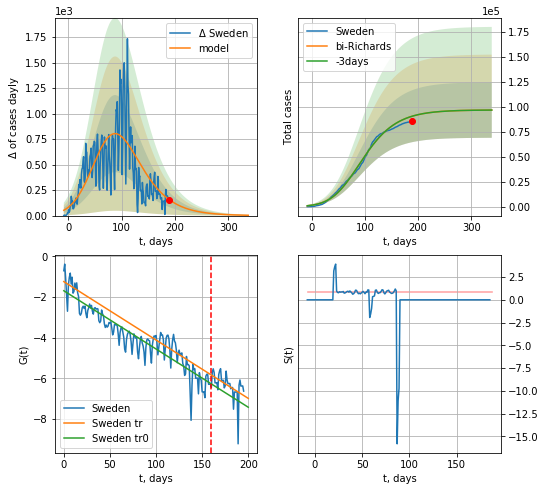

Sweden data at: 2020-09-09
+3 day model MAPE: 0.000000
model: bi-Richards
coeffs: [8.97017995e+02 9.57864462e-02 1.35831684e+01 2.45191895e-02]
rational stdev: 0.287144
forecast at the end of period: +150 days
	 deltaDaycases: 3
	 total cases: 96604 ± 27739
	 total death: 6571 ± 5660
bi-Richards approximation splitting point: 160
trend coefficient of determination: 0.848180
 intercept: -1.694612
 slope: -0.028654
trend coefficient of determination: 0.227078
 intercept: -1.244876
 slope: -0.028724


In [950]:
iL = 0
vL = 160+iL
x = forecastRR('Sweden',dfSW[iL:vL-iL],d1,25*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Sweden',dfSW[iL:-1],d1,45*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


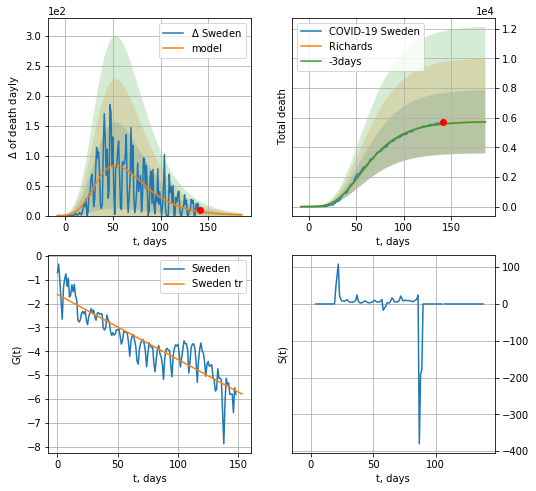

Sweden data at: 2020-09-09
+3 day model MAPE: 0.002445
model: Richards
coeffs: [ 5.75133549e+03  5.79293366e+00 -7.21072797e+01  6.85063513e-03]
rational stdev: 0.372383
forecast at the end of period: +45 days
	 total death: 5721 ± 2130
trend coefficient of determination: 0.814804
 intercept: -1.618399
 slope: -0.027247


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:209: RuntimeWarning: invalid value encountered in true_divide


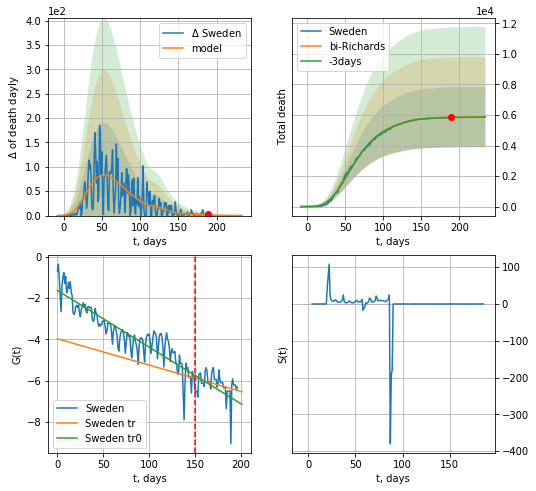

Sweden data at: 2020-09-09
+3 day model MAPE: 0.000065
model: bi-Richards
coeffs: [1.11286536e+02 1.15244322e+01 8.41102731e+01 9.69412010e-03]
rational stdev: 0.335997
forecast at the end of period: +45 days
	 total death: 5858 ± 1968
bi-Richards approximation splitting point: 150
trend coefficient of determination: 0.819088
 intercept: -1.632896
 slope: -0.027429
trend coefficient of determination: 0.090020
 intercept: -3.971481
 slope: -0.012749


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


In [951]:
vL = 150
x = forecastRR('Sweden',dfSW[:vL],d1,30*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death')
xx = forecast2RR('Sweden',dfSW[:],d1,30*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death',vL=vL)
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


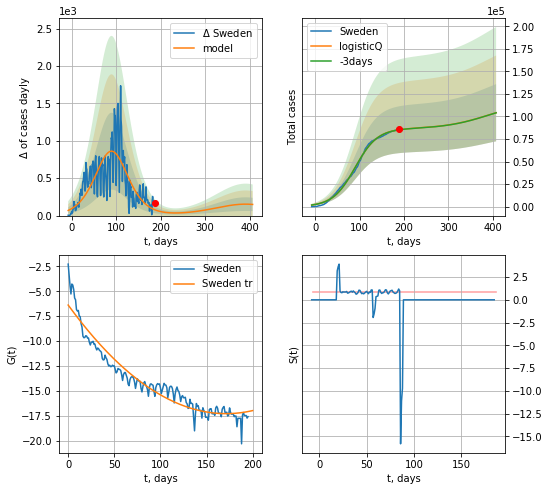

Sweden data at: 2020-09-09
+3 day model MAPE: 0.001379
model: logisticQ
coeffs: [ 8.63450402e+04  4.84794768e-07  8.98306110e+01 -8.20348690e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.304606
forecast at the end of period: +220 days
	 deltaDaycases: 149
	 total cases: 104132 ± 31719
	 total death: 7083 ± 6472
trend coefficient of determination: 0.927373
 intercept_: -6.384626181520558
 coeffs_: [ 0.         -0.12711166  0.00037109]


In [952]:
x = forecastRRR('Sweden',dfSW[1:],d1,55*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


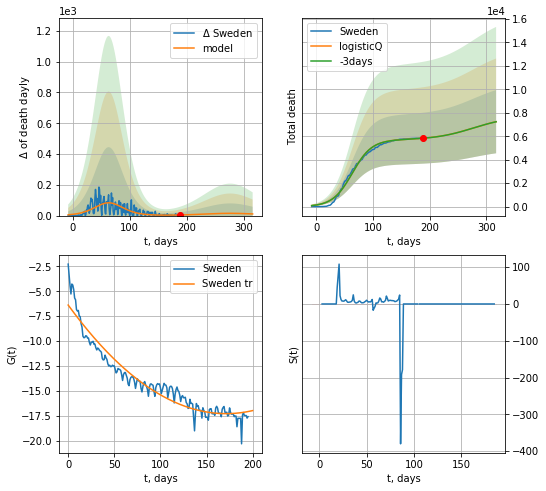

Sweden data at: 2020-09-09
+3 day model MAPE: 0.001281
model: logisticQ
coeffs: [ 5.70092517e+03  1.19437671e-07  6.35524062e+01 -4.87968282e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.372108
forecast at the end of period: +129 days
	 total death: 7242 ± 2695
trend coefficient of determination: 0.927373
 intercept_: -6.384626181520558
 coeffs_: [ 0.         -0.12711166  0.00037109]


In [953]:
x = forecastRRR('Sweden',dfSW[1:],d1,42*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')

CN
           date    cases  active   death
227 2020-09-05  85122.0     186  4634.0
228 2020-09-06  85134.0     180  4634.0
229 2020-09-07  85144.0     175  4634.0
230 2020-09-08  85146.0     165  4634.0
231 2020-09-09  85153.0     161  4634.0


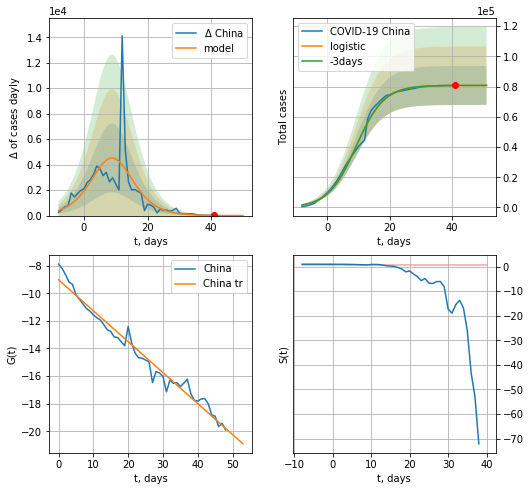

China data at: 2020-09-09
+3 day model MAPE: 0.00012785692963974442
model: logistic
coeffs:  [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.159713160092933
forecast at the end of period: +10 days
	 deltaDaycases:  1
	 total cases:  80803 ± 12905
	 total death:  4397 ± 2106
trend coefficient of determination: 0.972183
 intercept: -9.021396
 slope: -0.224243


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


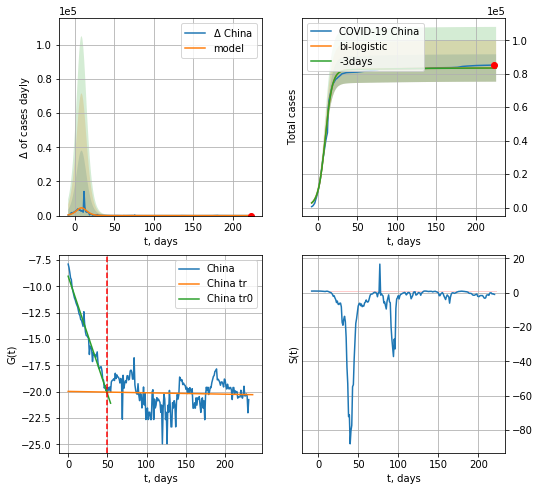

China data at: 2020-09-09
+3 day model MAPE: 0.000449242969884662
model: bi-logistic
coeffs:  [2.69463362e+03 1.63581317e-02 1.05196809e+01] [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.0980850431426498
forecast at the end of period: +3 days
	 deltaDaycases:  1
	 total cases:  83427 ± 8183
	 total death:  4540 ± 1335
bi-logistic approximation splitting point: 50
trend0 coefficient of determination: 0.973282
 intercept: -9.036652
 slope: -0.223289
trend coefficient of determination: 0.002692
 intercept: -19.977557
 slope: -0.001315


In [954]:
dfCN = read_df(pd.DataFrame(),"CN")
try:
    x = forecast('China',dfCN[:50],d1,7*T18-dT,1.0)
    #xx = forecast('China',dfCN[21:-32],d1,17)
    #xx = np.concatenate((x, xx), axis=0)
    xx = forecast2('China',dfCN[:],d1,24*7-dT,x,1.0,vL=50)
except:
    print ("Exception occurs")

In [955]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

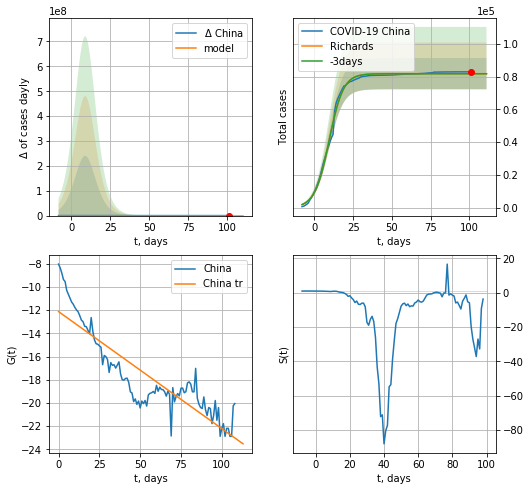

China data at: 2020-09-09
+3 day model MAPE: 0.000627
model: Richards
coeffs: [8.17736184e+04 2.15574455e-01 9.59539709e+00 1.02116174e+00]
rational stdev: 0.116457
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 81773 ± 9523
	 total death: 4450 ± 1554
trend coefficient of determination: 0.785239
 intercept: -12.125055
 slope: -0.100960


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


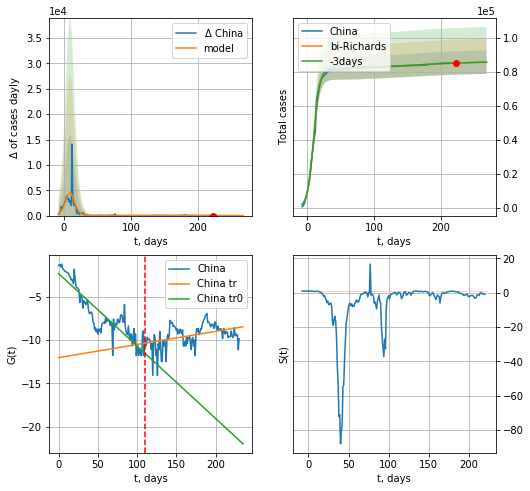

China data at: 2020-09-09
+3 day model MAPE: 0.000210
model: bi-Richards
coeffs: [ 4.38383418e+03  3.81049764e-01 -7.02054233e+01  3.98828032e-02]
rational stdev: 0.080750
forecast at the end of period: +45 days
	 deltaDaycases: 8
	 total cases: 85560 ± 6908
	 total death: 4656 ± 1127
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.820787
 intercept: -2.350973
 slope: -0.083343
trend coefficient of determination: 0.180425
 intercept: -12.029361
 slope: 0.015134


In [956]:
vL = 110
x = forecastRR('China',dfCN[:vL],d1,T18*7-dT,1.0)
xx = forecast2RR('China',dfCN[:],d1,30*7-dT,x,1.0,vL=vL)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

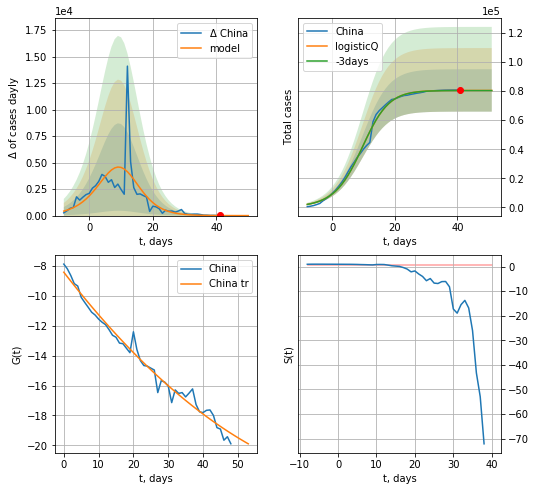

China data at: 2020-09-09
+3 day model MAPE: 0.001323
model: logisticQ
coeffs: [ 8.04175259e+04  1.07650464e-03  9.35257489e+00 -2.02425637e+02]
rational stdev: 0.181019
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 80416 ± 14556
	 total death: 4376 ± 2376
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


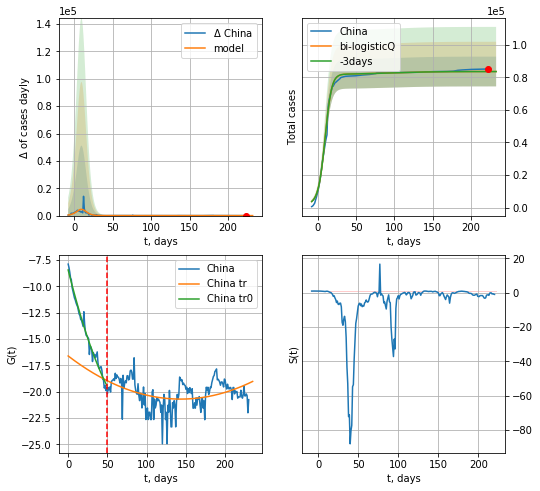

China data at: 2020-09-09
+3 day model MAPE: 0.000587
model: bi-logisticQ
coeffs: [ 3.19014539e+03  1.48401191e-04  2.48213120e+01 -6.11292676e-02]
rational stdev: 0.109304
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 83605 ± 9138
	 total death: 4549 ± 1491
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.138161
 intercept_: -16.61106176099425
 coeffs_: [ 0.         -0.05719038  0.00019956]


In [957]:
x = forecastRRR('China',dfCN[:50],d1,7*T18-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,T18*7-dT,x,1.0,vL=50)

In [958]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
           date  cases  active  death
203 2020-09-05  21177  4697.0  334.0
204 2020-09-06  21296  4663.0  336.0
205 2020-09-07  21432  4455.0  341.0
206 2020-09-08  21588  4221.0  344.0
207 2020-09-09  21743  4037.0  346.0


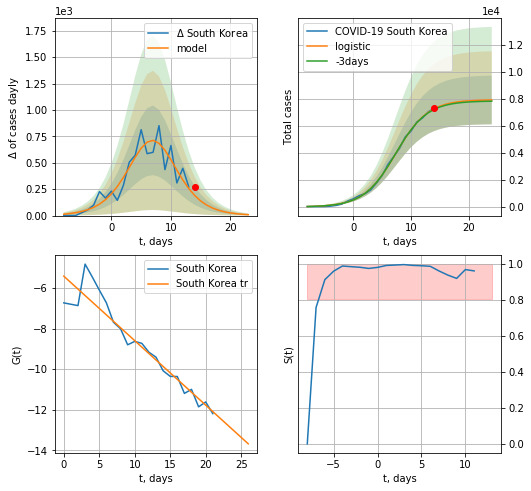

South Korea data at: 2020-09-09
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +10 days
	 deltaDaycases:  8
	 total cases:  7921 ± 1802
	 total death:  126 ± 86
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


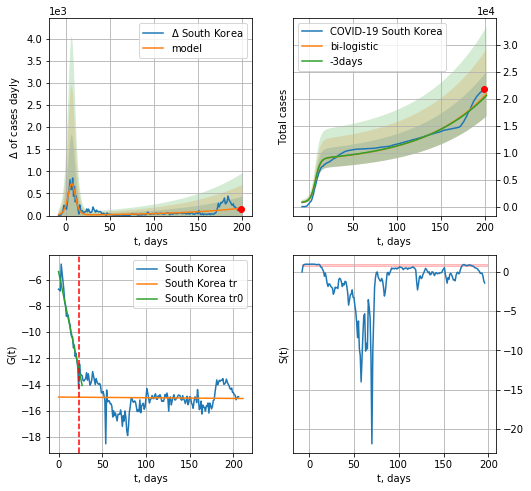

South Korea data at: 2020-09-09
+3 day model MAPE: 0.013314505096338832
model: bi-logistic
coeffs:  [2.79587694e+07 1.34133225e-02 7.74358791e+02] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.1983233259017531
forecast at the end of period: +3 days
	 deltaDaycases:  172
	 total cases:  20887 ± 4142
	 total death:  332 ± 197
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.000851
 intercept: -14.947606
 slope: -0.000528


In [959]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,7*T18-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,24*7-dT,x,1.0,vL=23)

In [960]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

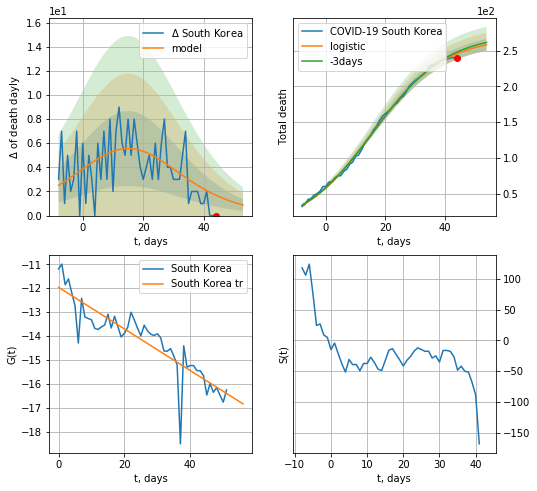

South Korea data at: 2020-09-09
model: logistic
coeffs:  [2.68513907e+02 8.28168907e-02 1.55065021e+01]
rational stdev:  0.032418936831668854
forecast at the end of period: +10 days
	 total death:  257 ± 8
trend coefficient of determination: 0.782213
 intercept: -11.965009
 slope: -0.087016


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:251: RuntimeWarning: divide by zero encountered in true_divide


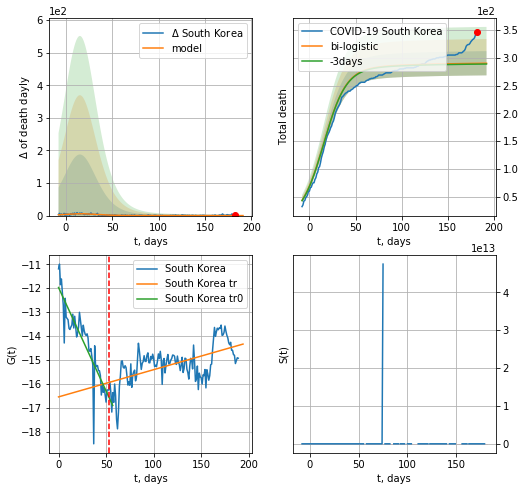

South Korea data at: 2020-09-09
+3 day model MAPE: 0.004782128447202657
model: bi-logistic
coeffs:  [2.29504385e+01 1.59514842e-02 1.00800854e+01] [2.68513907e+02 8.28168907e-02 1.55065021e+01]
rational stdev:  0.07517067271495795
forecast at the end of period: +10 days
	 deltaDaydeath:  0
	 total death:  290 ± 21
bi-logistic approximation splitting point: 53
trend0 coefficient of determination: 0.789613
 intercept: -11.973248
 slope: -0.086531
trend coefficient of determination: 0.339777
 intercept: -16.546986
 slope: 0.011383


In [961]:
x = forecast('South Korea',dfKR[17:70],d1,T18*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[17:],d1,T18*7-dT,x,1.0,vL=70-17,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


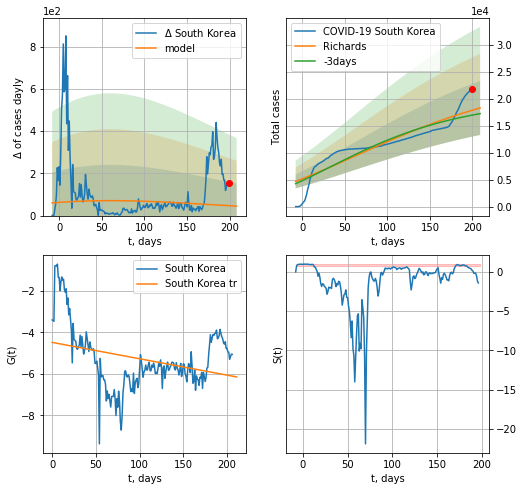

South Korea data at: 2020-09-09
+3 day model MAPE: 0.053425
model: Richards
coeffs: [ 2.51554307e+04  6.51281134e-01 -5.15827520e+02  1.18217414e-02]
rational stdev: 0.273266
forecast at the end of period: +10 days
	 deltaDaycases: 44
	 total cases: 18297 ± 5000
	 total death: 291 ± 238
trend coefficient of determination: 0.098506
 intercept: -4.487410
 slope: -0.007872


In [962]:
x = forecastRR('South Korea',dfKR[:],d1,T18*7-dT,1.0)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


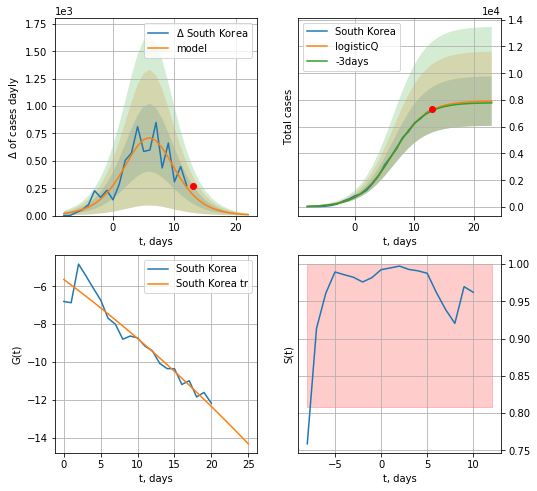

South Korea data at: 2020-09-09
+3 day model MAPE: 0.011158
model: logisticQ
coeffs: [ 7.93644740e+03  5.70893336e-05  6.37140939e+00 -6.30084107e+03]
rational stdev: 0.233522
forecast at the end of period: +10 days
	 deltaDaycases: 8
	 total cases: 7916 ± 1848
	 total death: 125 ± 87
trend coefficient of determination: 0.923340
 intercept_: -5.639271391154587
 coeffs_: [ 0.         -0.28882126 -0.00235709]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


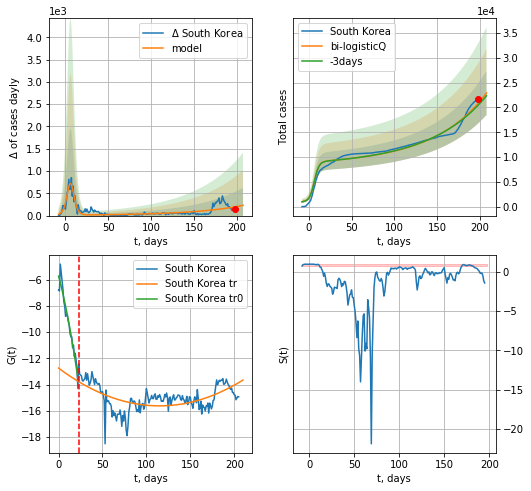

South Korea data at: 2020-09-09
+3 day model MAPE: 0.018158
model: bi-logisticQ
coeffs: [ 2.18187040e+07  1.33812853e-05  5.66496383e+02 -1.31011828e+03]
rational stdev: 0.193606
forecast at the end of period: +10 days
	 deltaDaycases: 230
	 total cases: 22923 ± 4438
	 total death: 364 ± 211
bi-logisticQ approximation splitting point: 23
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]
trend coefficient of determination: 0.318482
 intercept_: -12.74470886263558
 coeffs_: [ 0.         -0.05002287  0.00021761]


In [963]:
vL=23
x = forecastRRR('South Korea',dfKR[1:vL],d1,T18*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[1:],d1,T18*7-dT,x,1.0,vL=vL)

In [964]:
#x = forecastRR('South Korea',dfKR[68:],d1,10*7-dT,1.0)

In [965]:
#vL=25
#x = forecastQR('South Korea',dfKR[1:vL],d1,16*7-dT,1.0)
#xx=forecast2QR('South Korea',dfKR[1:],d1,16*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


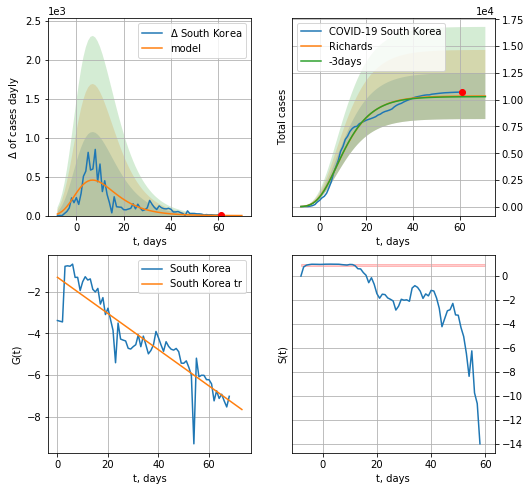

South Korea data at: 2020-09-09
+3 day model MAPE: 0.005852
model: Richards
coeffs: [ 1.03487698e+04  3.01458128e+01 -3.85788003e+01  3.98965943e-03]
rational stdev: 0.208027
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 10343 ± 2151
	 total death: 164 ± 102
trend coefficient of determination: 0.811927
 intercept: -1.308874
 slope: -0.086829


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


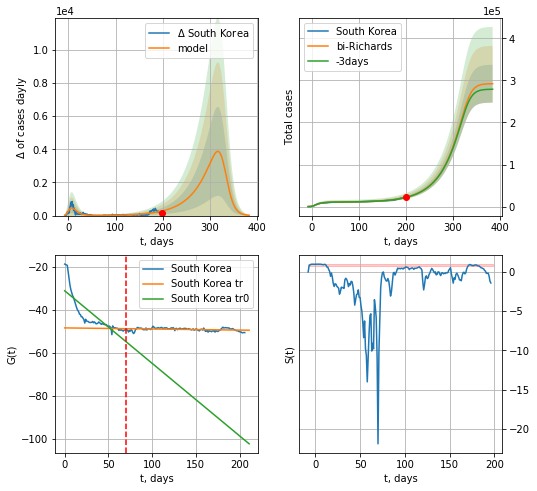

South Korea data at: 2020-09-09
+3 day model MAPE: 0.002995
model: bi-Richards
coeffs: [2.81846466e+05 2.43939445e-02 3.30727990e+02 4.56600340e+00]
rational stdev: 0.154064
forecast at the end of period: +185 days
	 deltaDaycases: 19
	 total cases: 292031 ± 44991
	 total death: 4647 ± 2147
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.673263
 intercept: -31.120334
 slope: -0.336909
trend coefficient of determination: 0.085587
 intercept: -48.373584
 slope: -0.005080


In [966]:
iL = 0
vL = 70+iL
x = forecastRR('South Korea',dfKR[iL:vL-iL],d1,T18*7-dT,1.0)
xx=forecast2RR('South Korea',dfKR[iL:],d1,50*7-dT,x,1.0,vL=vL-iL)
#xx = np.concatenate((x, xx), axis=0)
#print (xx)
#xxx=forecast3RR('South Korea',dfKR[1:],d1,12*7-dT,xx,1.0,vL=[vL,vL1],zoom=1e3)

In [967]:
a = np.array([ 7.90607495e+03,  3.14377481e-03, -1.32150046e+02,  5.22462480e+00, 7.59593205e-01])
b = np.array([ 2.91876181e+03,  1.43325056e-01, -3.99886263e+01, -3.39427361e+02, 1.77367535e-03])
QRkoreaCoeffs=b/a
QRkoreaCoeffs,RkoreaCoeffs,koreaCoeffs

(array([ 3.69179628e-01,  4.55901153e+01,  3.02600169e-01, -6.49668395e+01,
         2.33503320e-03]),
 [0.36242246, 2.56241634, 1.84890887, 0.13324732],
 [0.35416971, 0.02606324, 4.35859408, 19.30413219])

In [968]:
#x = forecastQR('South Korea',dfKR[:],d1,16*7-dT,1.0)

SG
           date    cases  active  death
226 2020-09-05  57022.0     728   27.0
227 2020-09-06  57044.0     684   27.0
228 2020-09-07  57091.0     656   27.0
229 2020-09-08  57166.0     678   27.0
230 2020-09-09  57166.0     647   27.0


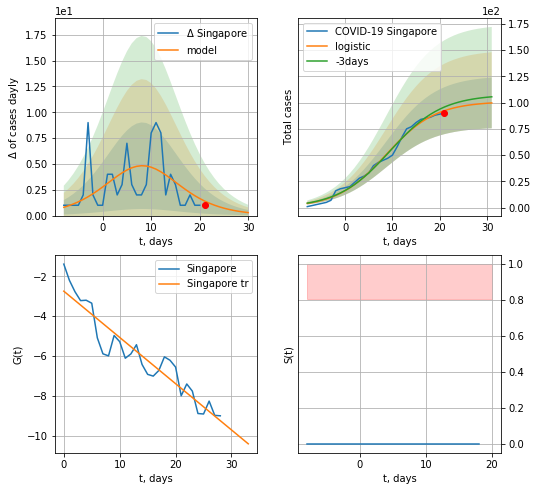

Singapore data at: 2020-09-09
+3 day model MAPE: 0.03963437966370839
model: logistic
coeffs:  [101.02990869   0.19128696   8.67555654]
rational stdev:  0.24212715882466435
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  99 ± 24
	 total death:  0 ± 0
trend coefficient of determination: 0.887345
 intercept: -2.744831
 slope: -0.232145


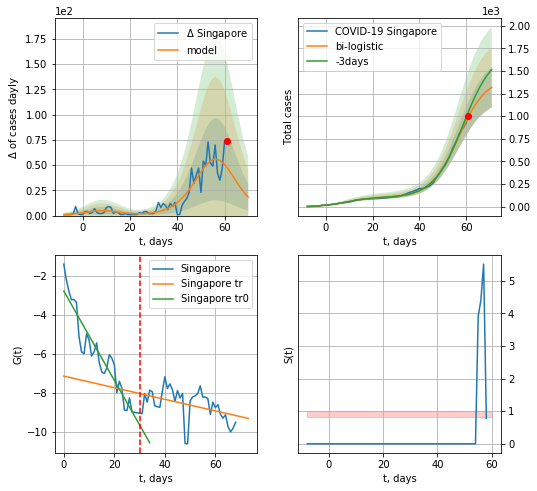

Singapore data at: 2020-09-09
+3 day model MAPE: 0.06119827726371909
model: bi-logistic
coeffs:  [1.32695355e+03 1.68329223e-01 5.66911530e+01] [101.02990869   0.19128696   8.67555654]
rational stdev:  0.16894112356490856
forecast at the end of period: +10 days
	 deltaDaycases:  18
	 total cases:  1318 ± 222
	 total death:  0 ± 0
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend coefficient of determination: 0.177815
 intercept: -7.138791
 slope: -0.029776
Exception occurs


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:485: RuntimeWarning: divide by zero encountered in log


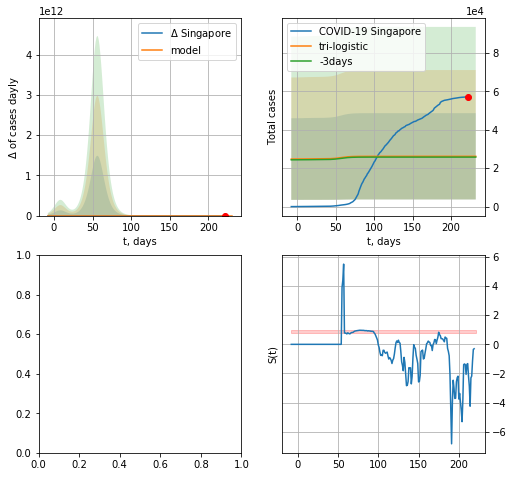

In [969]:
vL = 30
vL1 = 70
try:
    dfSG = read_df(pd.DataFrame(),"SG")
    x = forecast('Singapore',dfSG[:vL],d1,7*T18-dT,1.0)
    xx = forecast2('Singapore',dfSG[:vL1],d1,T18*7-dT,x,1.0,vL=vL)
    xx = np.concatenate((x, xx), axis=0)
    xxx = forecast3("Singapore",dfSG,d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])
except:
    print ("Exception occurs")

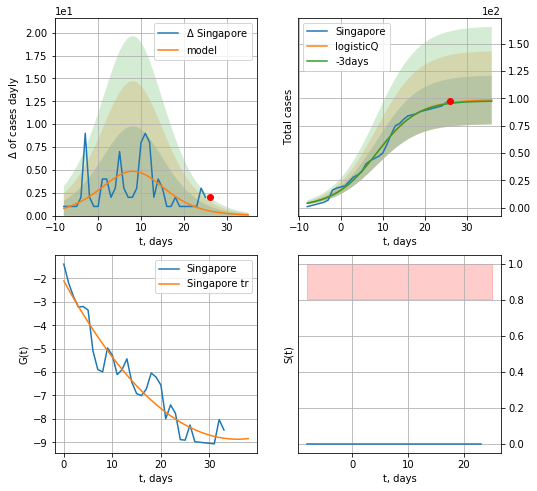

Singapore data at: 2020-09-09
+3 day model MAPE: 0.007575
model: logisticQ
coeffs: [ 9.88556613e+01  2.70689941e-04  8.43151450e+00 -7.17657610e+02]
rational stdev: 0.226599
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 98 ± 22
	 total death: 0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:571: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

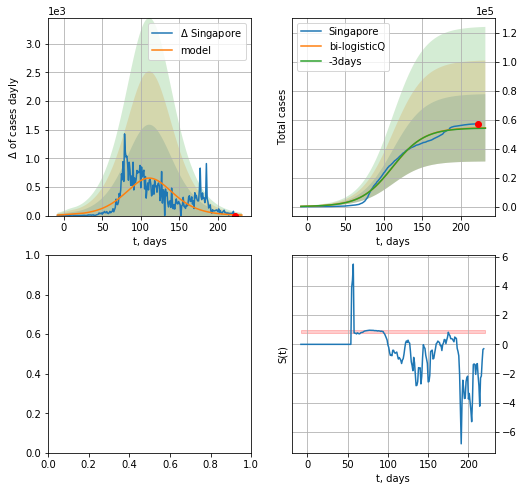

In [970]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,7*T18-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d1,T18*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

In [555]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


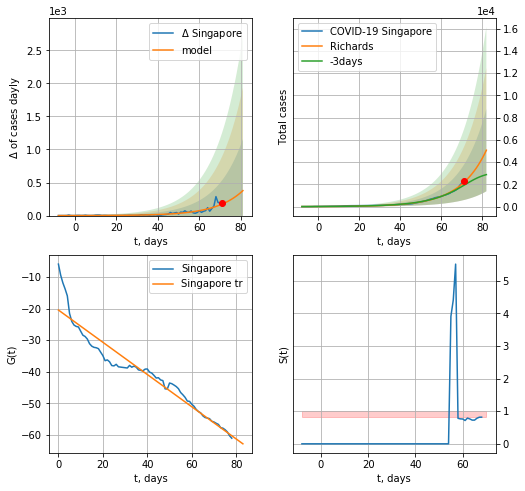

Singapore data at: 2020-09-08
+3 day model MAPE: 0.158856
model: Richards
coeffs: [1.92302023e+04 7.72500001e-02 9.92482833e+01 7.56752958e+00]
rational stdev: 0.728321
forecast at the end of period: +11 days
	 deltaDaycases: 377
	 total cases: 5073 ± 3695
	 total death: 2 ± 4
trend coefficient of determination: 0.919778
 intercept: -20.482187
 slope: -0.510333


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


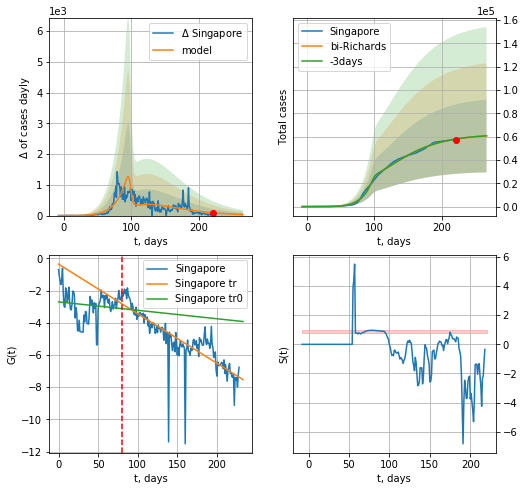

Singapore data at: 2020-09-08
+3 day model MAPE: 0.001683
model: bi-Richards
coeffs: [ 4.28673752e+04  1.98971128e+00 -6.86146481e+01  1.16324118e-02]
rational stdev: 0.514246
forecast at the end of period: +46 days
	 deltaDaycases: 35
	 total cases: 60566 ± 31146
	 total death: 28 ± 43
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.016629
 intercept: -2.698123
 slope: -0.005245
trend coefficient of determination: 0.665444
 intercept: -0.354134
 slope: -0.030787


In [556]:
iL = 0
vL = 80+iL
x = forecastRR('Singapore',dfSG[iL:vL+iL],d1,T18*7-dT,1.0)
x = forecast2RR('Singapore',dfSG[iL:],d1,30*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)
#x = forecastQR('Singapore',dfSG[60:],d1,16*7-dT,1.0)

ES
           date   cases  active  death
177 2020-09-05  2516.0     282   64.0
178 2020-09-06  2532.0     292   64.0
179 2020-09-07  2532.5     292   64.0
180 2020-09-08  2585.0     308   64.0
181 2020-09-09  2600.0     313   64.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


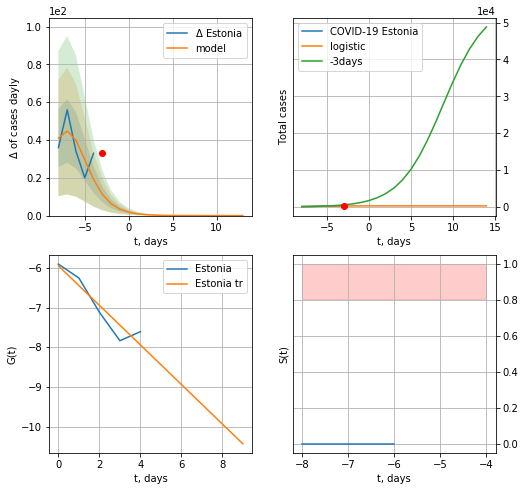

Estonia data at: 2020-09-09
+3 day model MAPE: 0.6707560325989319
model: logistic
coeffs:  [277.64023437   0.65084323  -6.57074778]
rational stdev:  0.028784635369283593
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  277 ± 7
	 total death:  6 ± 0
trend coefficient of determination: 0.881874
 intercept: -5.949047
 slope: -0.498463


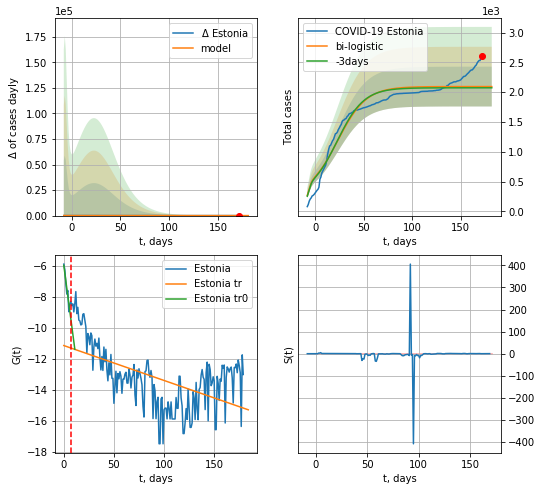

Estonia data at: 2020-09-09
+3 day model MAPE: 0.010003207567385165
model: bi-logistic
coeffs:  [1.81725751e+03 6.85364748e-02 2.33413310e+01] [277.64023437   0.65084323  -6.57074778]
rational stdev:  0.15940045368817513
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  2094 ± 333
	 total death:  51 ± 24
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.894917
 intercept: -5.986038
 slope: -0.491580
trend coefficient of determination: 0.303203
 intercept: -11.153479
 slope: -0.022500


In [1209]:
shift = 1.0
try:
    dfES = read_df(pd.DataFrame(),"ES")
    x = forecast('Estonia',dfES[1:7],d1,17,1.)
    xx = forecast2('Estonia',dfES[1:],d1,T18*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.5],vL=7)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


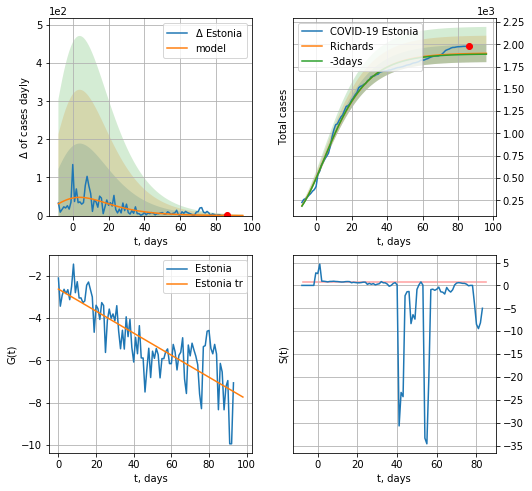

Estonia data at: 2020-09-09
+3 day model MAPE: 0.004828
model: Richards
coeffs: [ 1.90234229e+03  8.05122761e+00 -6.49439772e+01  8.53882183e-03]
rational stdev: 0.052085
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 1898 ± 98
	 total death: 47 ± 7
trend coefficient of determination: 0.683583
 intercept: -2.627136
 slope: -0.052184


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


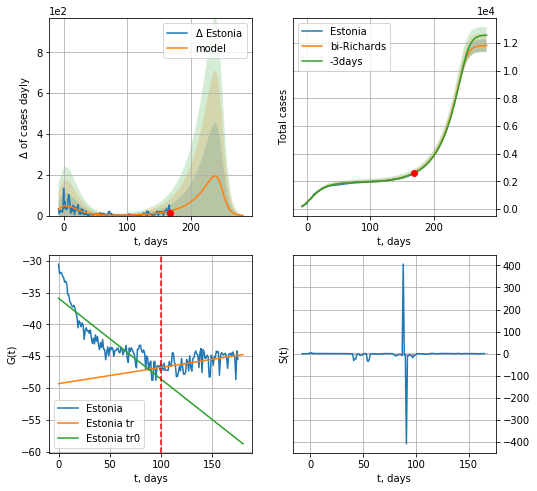

Estonia data at: 2020-09-09
+3 day model MAPE: 0.002038
model: bi-Richards
coeffs: [9.92338618e+03 3.34323084e-02 2.48039001e+02 5.12382057e+00]
rational stdev: 0.037996
forecast at the end of period: +115 days
	 deltaDaycases: 0
	 total cases: 11820 ± 449
	 total death: 292 ± 33
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.774565
 intercept: -35.883887
 slope: -0.127222
trend coefficient of determination: 0.181583
 intercept: -49.311149
 slope: 0.025417


In [1210]:
iL = 5
vL=100+iL
x = forecastRR('Estonia',dfES[iL:vL-iL],d1,7*25-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
xx = forecast2RR('Estonia',dfES[iL:],d1,7*40-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


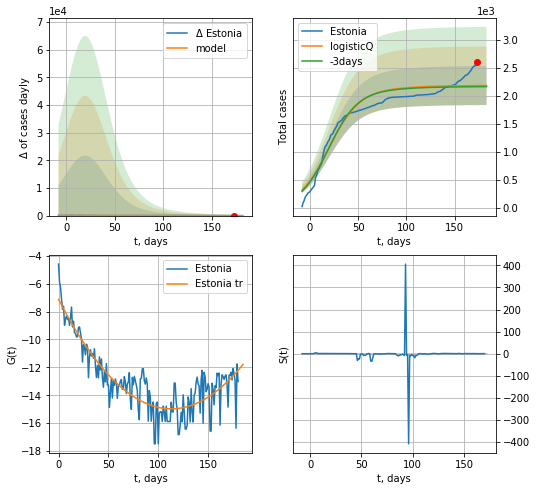

Estonia data at: 2020-09-09
+3 day model MAPE: 0.009201
model: logisticQ
coeffs: [ 2.09688227e+03  3.67663903e-08  1.97991787e+01 -1.73601544e+06]
S.Korea scenario coeffs: [0.04375, 0.5, 4.0, 1]
rational stdev: 0.160093
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 2185 ± 349
	 total death: 54 ± 25
trend coefficient of determination: 0.785196
 intercept_: -7.125240918913163
 coeffs_: [ 0.         -0.13899322  0.00061498]


In [1211]:
x = forecastRRR('Estonia',dfES[:],d1,7*T18-dT,1.,addpred=True,xcoef=[0.35/8,.5,4.,1])

LV
           date   cases  active  death
182 2020-09-05  1428.0     206   35.0
183 2020-09-06  1429.0     207   35.0
184 2020-09-07  1432.0     210   35.0
185 2020-09-08  1443.0     174   35.0
186 2020-09-09  1448.0     165   35.0


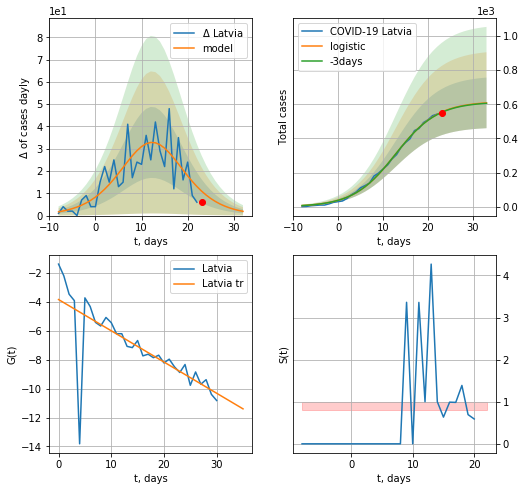

Latvia data at: 2020-09-09
+3 day model MAPE: 0.003263338184172393
model: logistic
coeffs:  [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.24373797630646024
forecast at the end of period: +10 days
	 deltaDaycases:  1
	 total cases:  607 ± 148
	 total death:  14 ± 10
trend coefficient of determination: 0.538666
 intercept: -3.837099
 slope: -0.216023


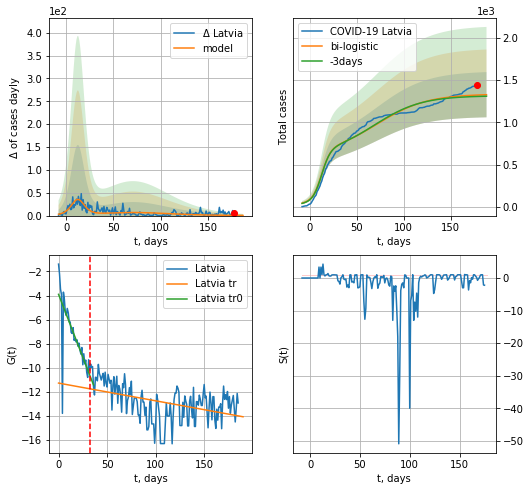

Latvia data at: 2020-09-09
+3 day model MAPE: 0.012806963405341529
model: bi-logistic
coeffs:  [7.20866853e+02 3.75192248e-02 7.11025952e+01] [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.20183026793053666
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  1328 ± 268
	 total death:  32 ± 19
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.543521
 intercept: -3.904452
 slope: -0.209287
trend coefficient of determination: 0.187879
 intercept: -11.292368
 slope: -0.014757


In [1206]:
vL=32
dfLV = read_df(pd.DataFrame(),"LV")
try:
    x = forecast('Latvia',dfLV[:vL],d1,T18*7-dT,1.)
    xx=forecast2('Latvia',dfLV[:],d1,T18*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


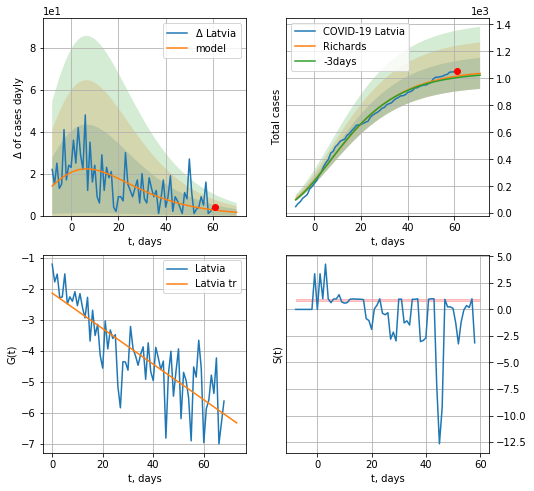

Latvia data at: 2020-09-09
+3 day model MAPE: 0.011078
model: Richards
coeffs: [ 1.06333537e+03  7.08982273e+00 -7.72639807e+01  8.06725773e-03]
rational stdev: 0.110885
forecast at the end of period: +10 days
	 deltaDaycases: 1
	 total cases: 1036 ± 114
	 total death: 25 ± 8
trend coefficient of determination: 0.685809
 intercept: -2.142789
 slope: -0.057409


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


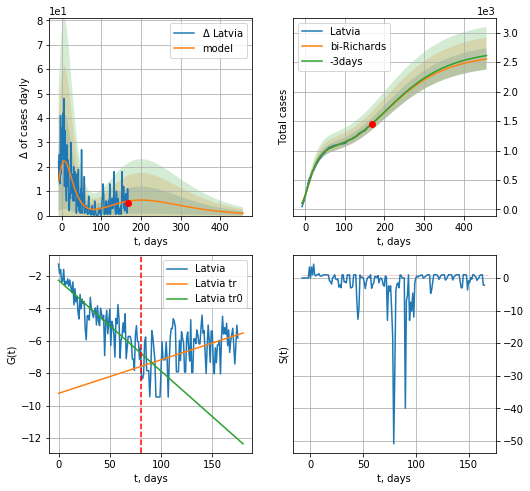

Latvia data at: 2020-09-09
+3 day model MAPE: 0.000877
model: bi-Richards
coeffs: [ 1.57942571e+03  4.91649972e-01 -1.41528359e+02  2.25600931e-02]
rational stdev: 0.070896
forecast at the end of period: +290 days
	 deltaDaycases: 0
	 total cases: 2554 ± 181
	 total death: 61 ± 12
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.732988
 intercept: -2.263352
 slope: -0.056127
trend coefficient of determination: 0.193674
 intercept: -9.249427
 slope: 0.020711


In [1207]:
iL=10
vL = 80+iL
x = forecastRR('Latvia',dfLV[iL:vL-iL],d1,7*25-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Latvia',dfLV[iL:],d1,7*65-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastQR('Latvia',dfLV[:],d1,7*16-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


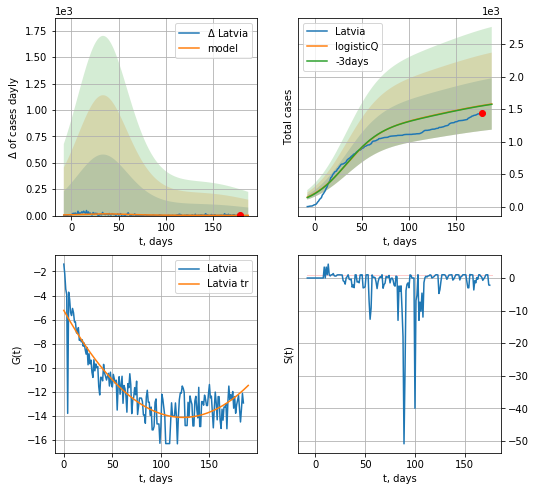

Latvia data at: 2020-09-09
+3 day model MAPE: 0.003104
model: logisticQ
coeffs: [ 1.24925600e+03  3.90818375e-08  3.33316782e+01 -1.29539784e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.250181
forecast at the end of period: +10 days
	 deltaDaycases: 2
	 total cases: 1579 ± 395
	 total death: 38 ± 28
trend coefficient of determination: 0.774080
 intercept_: -5.239193368567515
 coeffs_: [ 0.         -0.14510324  0.00059062]


In [1208]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
x = forecastRRR('Latvia',dfLV[:],d1,7*T18-dT,1.,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


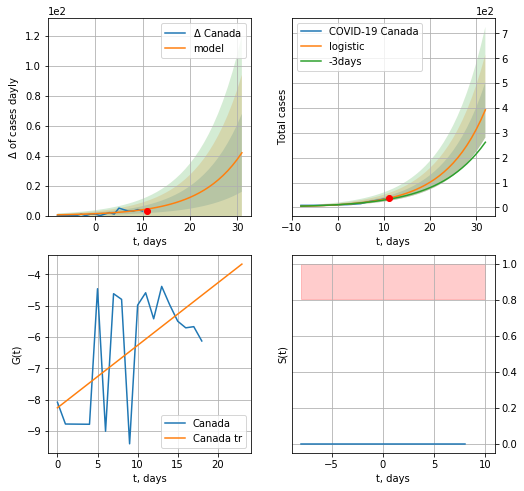

Canada data at: 2020-09-09
+3 day model MAPE: 0.14133490187696762
model: logistic
coeffs:  [1.25342997e+05 1.13222116e-01 8.29018541e+01]
rational stdev:  0.2833740936364515
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  26 ± 22
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


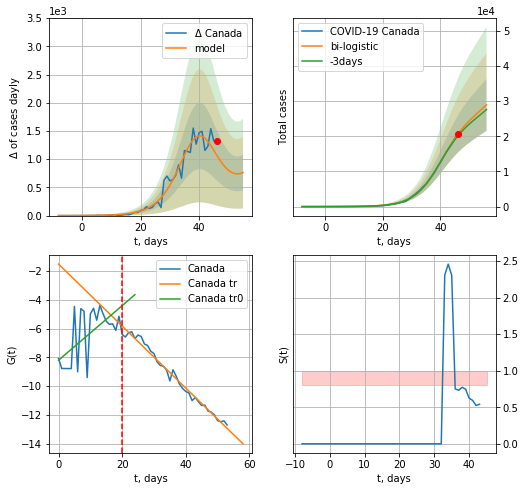

Canada data at: 2020-09-09
+3 day model MAPE: 0.029367009846107475
model: bi-logistic
coeffs:  [2.40153999e+04 2.16961374e-01 4.02658690e+01] [1.25342997e+05 1.13222116e-01 8.29018541e+01]
rational stdev:  0.2549294005106464
forecast at the end of period: +10 days
	 deltaDaycases:  762
	 total cases:  28940 ± 7377
	 total death:  1972 ± 1508
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


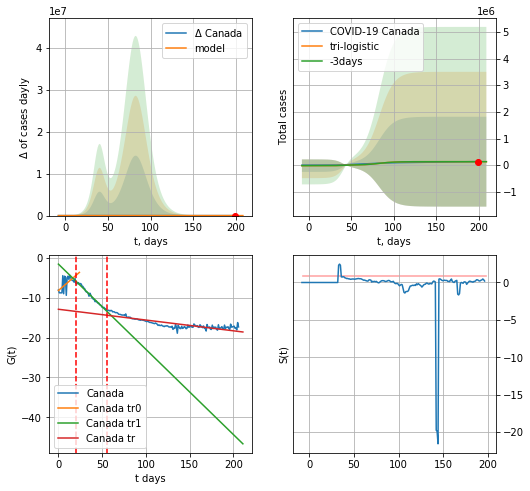

Canada data at: 2020-09-09
+3 day model MAPE: 0.00025340525046246566
model: tri-logistic
coeffs:  [-1.82334371e+04  2.09430182e+00 -3.75736083e+01] [1.25342997e+05 1.13222116e-01 8.29018541e+01 2.40153999e+04
 2.16961374e-01 4.02658690e+01]
forecast rational stdev:  12.853884870044025
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  131124 ± 1685464
	 total death:  8938 ± 344664
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.723090
 intercept: -12.892895
 slope: -0.027001


In [973]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,T18*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
           date     cases  active   death
203 2020-09-05  131495.0    6216  9143.0
204 2020-09-06  131895.0    6393  9145.0
205 2020-09-07  132142.0    6537  9146.0
206 2020-09-08  133748.0    7030  9153.0
207 2020-09-09  134294.0    6868  9155.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


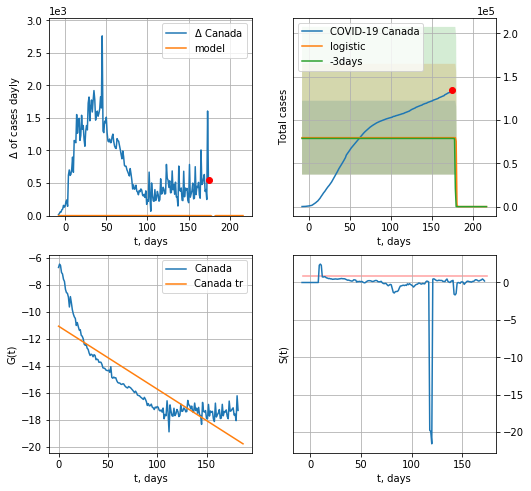

Canada data at: 2020-09-09
+3 day model MAPE: 0.011329626046142299
model: logistic
coeffs:  [ 7.95960489e+04 -6.41396802e+00  1.80443747e+02]
rational stdev:  0.535514741258
forecast at the end of period: +42 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.733825
 intercept: -11.056192
 slope: -0.046725


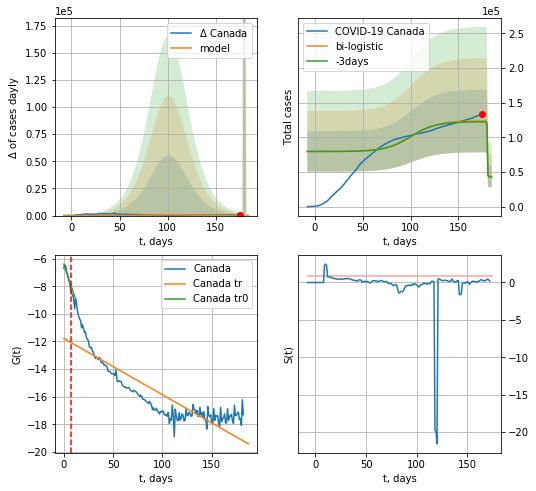

Canada data at: 2020-09-09
+3 day model MAPE: 0.0104417712664079
model: bi-logistic
coeffs:  [4.42506953e+04 7.37060962e-02 1.01564170e+02] [ 7.95960489e+04 -6.41396802e+00  1.80443747e+02]
rational stdev:  0.3657774721840463
forecast at the end of period: +10 days
	 deltaDaycases:  7
	 total cases:  44156 ± 16151
	 total death:  3010 ± 3302
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.859073
 intercept: -6.392122
 slope: -0.214001
trend coefficient of determination: 0.743397
 intercept: -11.777254
 slope: -0.040846


In [974]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,6*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,T18*7-dT,x,1.,vL=31-24,cases='cases')

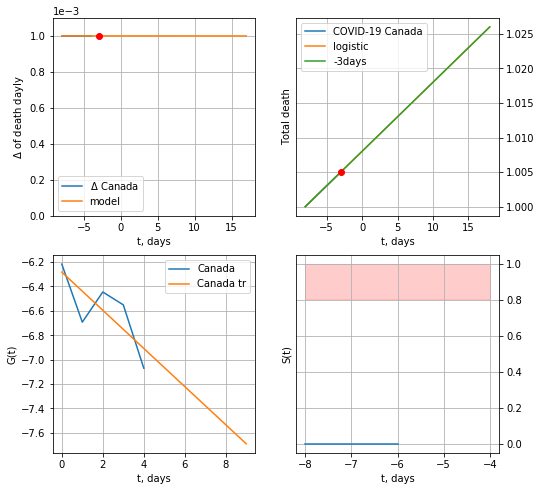

Canada data at: 2020-09-09
+3 day model MAPE: 6.189159426418585e-07
model: logistic
coeffs:  [2.01800807e+00 1.98223827e-03 1.00386171e+00]
rational stdev:  1.593569349221903e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


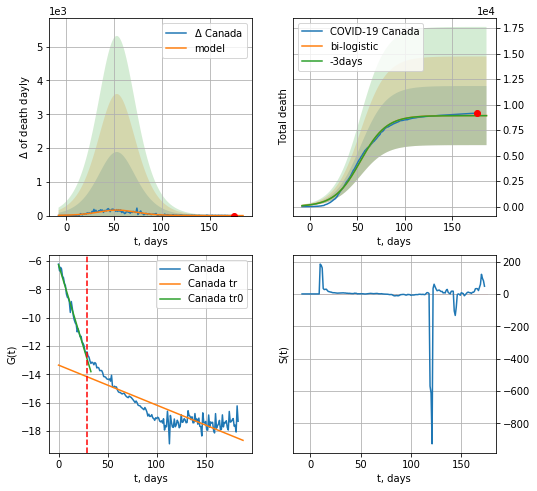

Canada data at: 2020-09-09
+3 day model MAPE: 0.0011288597844439977
model: bi-logistic
coeffs:  [8.92294943e+03 7.34859459e-02 5.34287972e+01] [2.01800807e+00 1.98223827e-03 1.00386171e+00]
rational stdev:  0.3245677766910239
forecast at the end of period: +10 days
	 deltaDaydeath:  0
	 total death:  8923 ± 2896
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.733980
 intercept: -13.348772
 slope: -0.028249


In [975]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,T18*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


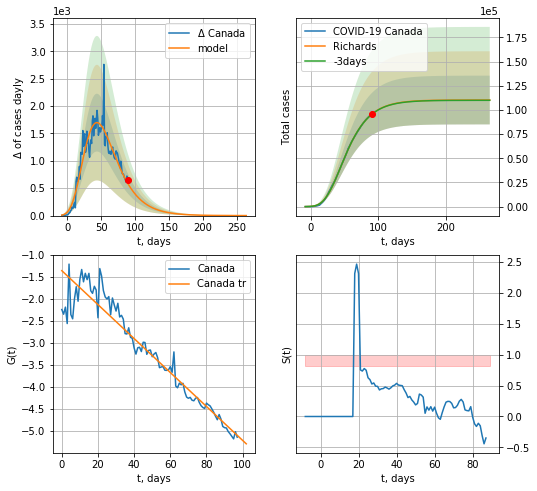

Canada data at: 2020-09-09
+3 day model MAPE: 0.001369
model: Richards
coeffs: [ 1.10207939e+05  3.57046378e+00 -6.12039169e+01  1.17938660e-02]
rational stdev: 0.228612
forecast at the end of period: +175 days
	 deltaDaycases: 0
	 total cases: 110197 ± 25192
	 total death: 7512 ± 5152
trend coefficient of determination: 0.921084
 intercept: -1.352092
 slope: -0.038614


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


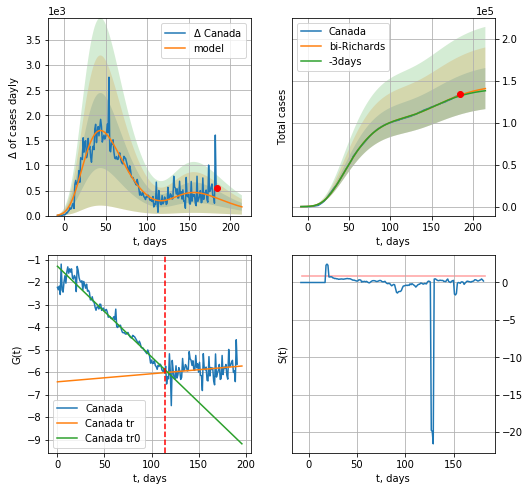

Canada data at: 2020-09-09
+3 day model MAPE: 0.006787
model: bi-Richards
coeffs: [3.61612810e+04 2.63336267e+00 2.25253960e+01 1.21577168e-02]
rational stdev: 0.174158
forecast at the end of period: +31 days
	 deltaDaycases: 174
	 total cases: 140536 ± 24475
	 total death: 9580 ± 5005
bi-Richards approximation splitting point: 114
trend coefficient of determination: 0.948893
 intercept: -1.299497
 slope: -0.040246
trend coefficient of determination: 0.033435
 intercept: -6.433298
 slope: 0.003579


In [976]:
iL = 15
vL = 114 + iL
x = forecastRR('Canada',dfCA[iL:vL-iL],d1,T18*7,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Canada',dfCA[iL:],d1,28*7-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastQR('Canada',dfCA[28:],d1,16*7,1.)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


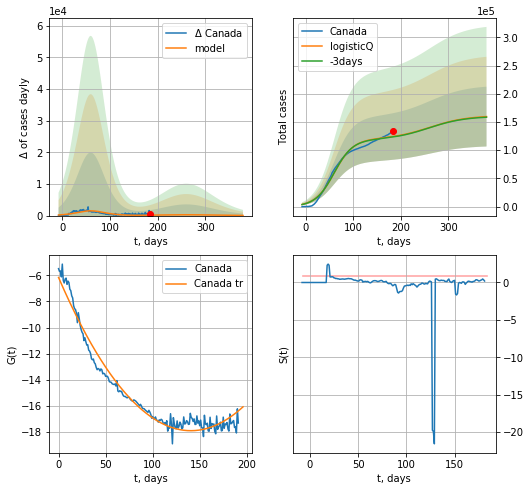

Canada data at: 2020-09-09
+3 day model MAPE: 0.007147
model: logisticQ
coeffs: [ 1.19291835e+05  6.31635308e-08  5.97527223e+01 -7.96423675e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.332037
forecast at the end of period: +196 days
	 deltaDaycases: 47
	 total cases: 159587 ± 52988
	 total death: 10879 ± 10836
trend coefficient of determination: 0.969125
 intercept_: -6.1659851177585505
 coeffs_: [ 0.         -0.16696814  0.00059395]


In [977]:
x = forecastRRR('Canada',dfCA[15:],d1,7*28,1.,addpred=True,xcoef=koreaCoeffs)

PT
           date  cases  active   death
187 2020-09-05  59943   15312  1838.0
188 2020-09-06  60258   15465  1840.0
189 2020-09-07  60507   15648  1843.0
190 2020-09-08  60895   15903  1846.0
191 2020-09-09  61541   16408  1849.0


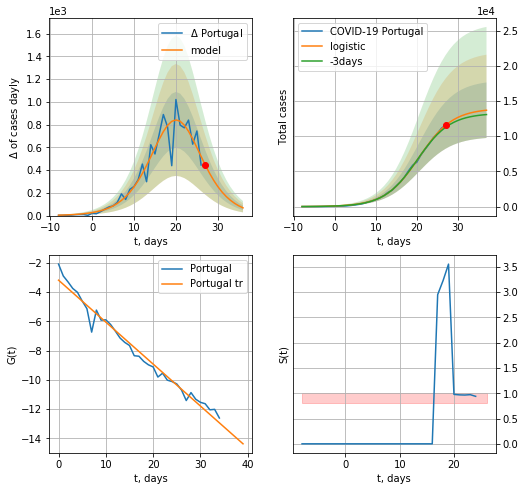

Portugal data at: 2020-09-09
+3 day model MAPE: 0.02876881186141646
model: logistic
coeffs:  [1.39435560e+04 2.41732854e-01 2.05234131e+01]
rational stdev:  0.28806592053196767
forecast at the end of period: +10 days
	 deltaDaycases:  68
	 total cases:  13688 ± 3943
	 total death:  411 ± 355
trend coefficient of determination: 0.976552
 intercept: -3.178197
 slope: -0.287215


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


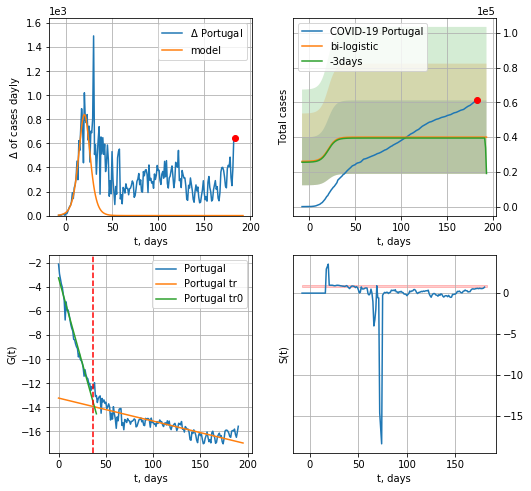

Portugal data at: 2020-09-09
+3 day model MAPE: 0.013186685372628572
model: bi-logistic
coeffs:  [ 2.08198409e+04 -7.70695045e+00  1.95336242e+02] [1.39435560e+04 2.41732854e-01 2.05234131e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.5289510735587708
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  39968 ± 21141
	 total death:  1200 ± 1904
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975262
 intercept: -3.226992
 slope: -0.282910
trend coefficient of determination: 0.714995
 intercept: -13.234807
 slope: -0.019189


In [978]:
vL = 36
dfPT = read_df(pd.DataFrame(),"PT")
x = forecast('Portugal',dfPT[:vL],d1,T18*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


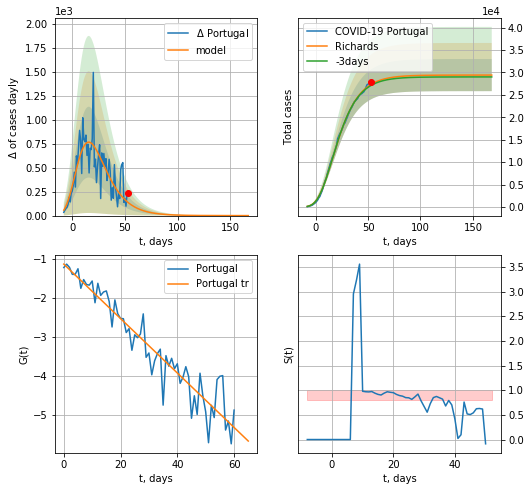

Portugal data at: 2020-09-09
+3 day model MAPE: 0.008857
model: Richards
coeffs: [ 2.94208673e+04  7.56194935e+00 -4.94130809e+01  9.41350515e-03]
rational stdev: 0.121788
forecast at the end of period: +115 days
	 deltaDaycases: 0
	 total cases: 29420 ± 3583
	 total death: 883 ± 322
trend coefficient of determination: 0.903152
 intercept: -1.140009
 slope: -0.069674


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


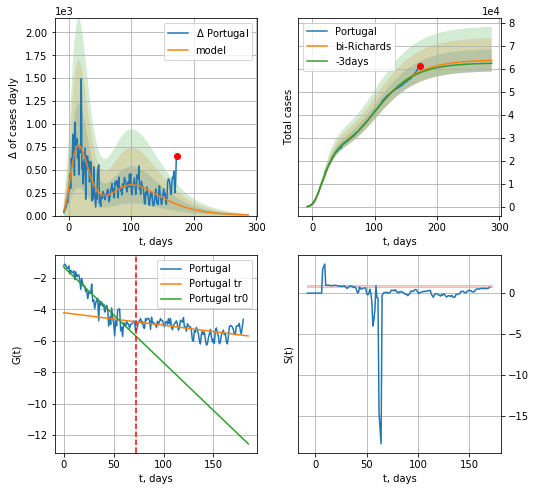

Portugal data at: 2020-09-09
+3 day model MAPE: 0.009172
model: bi-Richards
coeffs: [ 3.46258260e+04  3.24748919e+00 -8.21635247e+01  8.03225675e-03]
rational stdev: 0.076230
forecast at the end of period: +115 days
	 deltaDaycases: 7
	 total cases: 63771 ± 4861
	 total death: 1916 ± 438
bi-Richards approximation splitting point: 72
trend coefficient of determination: 0.889336
 intercept: -1.324362
 slope: -0.060692
trend coefficient of determination: 0.300623
 intercept: -4.223636
 slope: -0.007975


In [987]:
iL = 10
vL=72+iL
x = forecastRR('Portugal',dfPT[iL:vL-iL],d1,40*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Portugal',dfPT[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


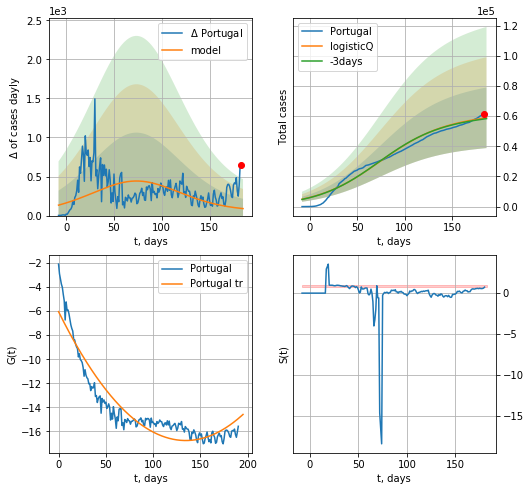

Portugal data at: 2020-09-09
+3 day model MAPE: 0.009258
model: logisticQ
coeffs: [ 5.84231715e+04  5.68563009e-08  7.34310486e+01 -5.24344125e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.341120
forecast at the end of period: +3 days
	 deltaDaycases: 89
	 total cases: 58899 ± 20091
	 total death: 1769 ± 1810
trend coefficient of determination: 0.884566
 intercept_: -6.037907049524819
 coeffs_: [ 0.         -0.15960272  0.00059335]


In [988]:
x = forecastRRR('Portugal',dfPT[:],d1,24*7-dT,1.,addpred=True,xcoef=koreaCoeffs)

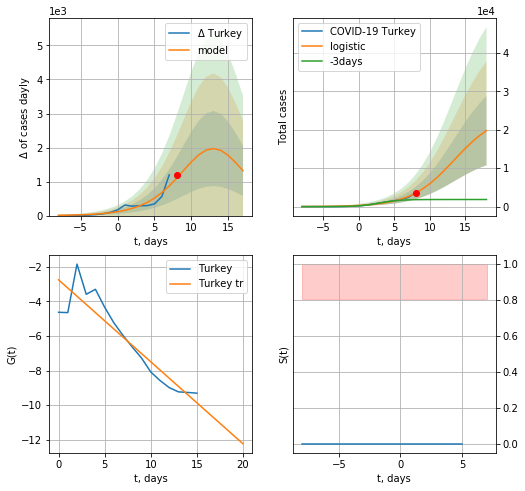

Turkey data at: 2020-09-09
+3 day model MAPE: 1.5246812178063545
model: logistic
coeffs:  [2.42671393e+04 3.25610709e-01 1.34529674e+01]
rational stdev:  0.45520285261707166
forecast at the end of period: +10 days
	 deltaDaycases:  1316
	 total cases:  19769 ± 8999
	 total death:  474 ± 647
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


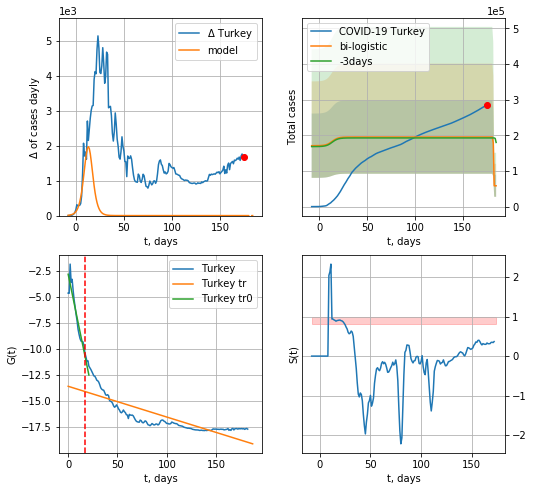

Turkey data at: 2020-09-09
+3 day model MAPE: 0.013167375941123917
model: bi-logistic
coeffs:  [ 1.36623584e+05 -4.37367989e+01  1.82045792e+02] [2.42671393e+04 3.25610709e-01 1.34529674e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.5276822413597148
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  58423 ± 30828
	 total death:  1401 ± 2217
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.662712
 intercept: -13.580454
 slope: -0.029565


In [989]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,7*T18-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,T18*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


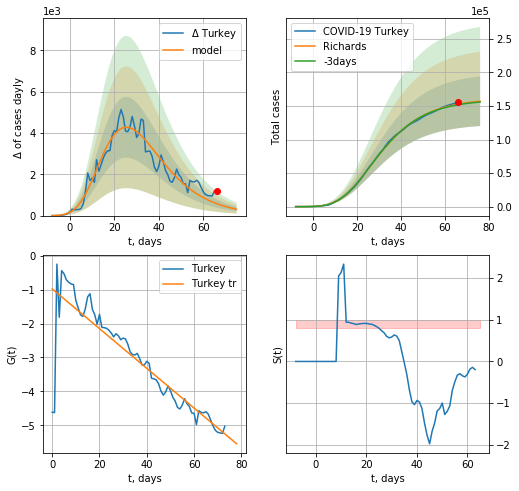

Turkey data at: 2020-09-09
+3 day model MAPE: 0.006544
model: Richards
coeffs: [ 1.61234279e+05  5.77618311e+00 -3.44308441e+01  1.25694326e-02]
rational stdev: 0.235075
forecast at the end of period: +10 days
	 deltaDaycases: 309
	 total cases: 157062 ± 36921
	 total death: 3768 ± 2657
trend coefficient of determination: 0.775259
 intercept: -0.978843
 slope: -0.058549


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


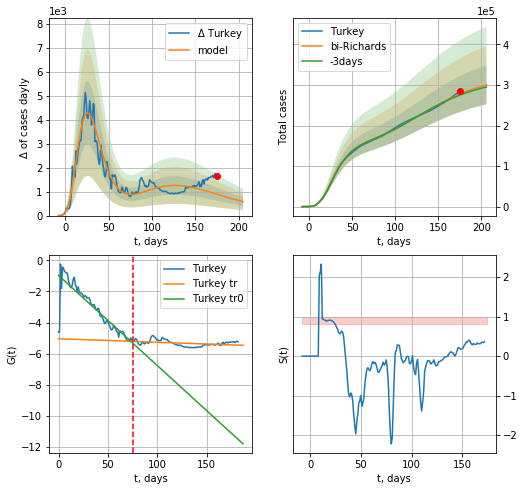

Turkey data at: 2020-09-09
+3 day model MAPE: 0.008697
model: bi-Richards
coeffs: [ 1.71088462e+05  2.12869091e+00 -1.05813655e+02  9.39235925e-03]
rational stdev: 0.158961
forecast at the end of period: +31 days
	 deltaDaycases: 583
	 total cases: 300110 ± 47705
	 total death: 7200 ± 3433
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.776986
 intercept: -0.967016
 slope: -0.057939
trend coefficient of determination: 0.140370
 intercept: -5.042753
 slope: -0.002267


In [990]:
vL = 75
x = forecastRR('Turkey',dfTR[:vL],d1,T18*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Turkey',dfTR[:],d1,28*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [991]:
#x = forecastQR('Turkey',dfTR[:],d1,16*7,1.,addpred=False,xcoef=[0.35,.5,3,1,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


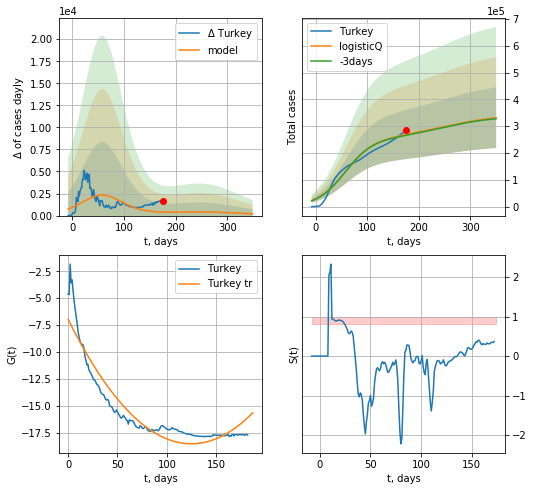

Turkey data at: 2020-09-09
+3 day model MAPE: 0.011026
model: logisticQ
coeffs: [ 2.54324203e+05  4.14218047e-08  5.77227253e+01 -8.68717341e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.340610
forecast at the end of period: +175 days
	 deltaDaycases: 202
	 total cases: 331412 ± 112882
	 total death: 7951 ± 8124
trend coefficient of determination: 0.887267
 intercept_: -6.9622280779574535
 coeffs_: [ 0.         -0.18498528  0.00074103]


In [992]:
x = forecastRRR('Turkey',dfTR[:],d1,T18*7,1.,addpred=True,xcoef=koreaCoeffs)

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [993]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0]

0.024255024255024255

In [994]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

PL
           date    cases  active   death
185 2020-09-05  70824.0   14448  2120.0
186 2020-09-06  71126.0   13889  2124.0
187 2020-09-07  71535.0   13889  2124.0
188 2020-09-08  71947.0   12665  2147.0
189 2020-09-09  72453.0   12225  2159.0


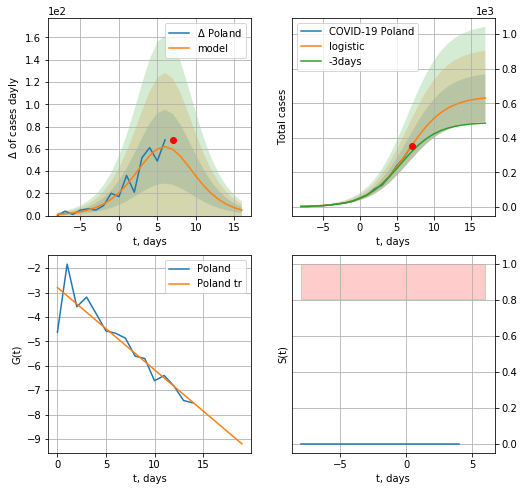

Poland data at: 2020-09-09
+3 day model MAPE: 0.14646235252259687
model: logistic
coeffs:  [6.41107575e+02 3.87606717e-01 6.46563504e+00]
rational stdev:  0.2177068805945458
forecast at the end of period: +10 days
	 deltaDaycases:  4
	 total cases:  630 ± 137
	 total death:  18 ± 11
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043


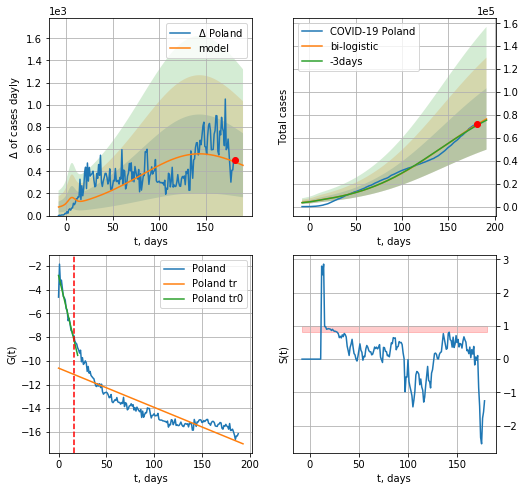

Poland data at: 2020-09-09
+3 day model MAPE: 0.010958812541163694
model: bi-logistic
coeffs:  [9.65123433e+04 2.21670363e-02 1.40066197e+02] [6.41107575e+02 3.87606717e-01 6.46563504e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3500219085487056
forecast at the end of period: +10 days
	 deltaDaycases:  453
	 total cases:  76510 ± 26780
	 total death:  2283 ± 2397
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.867285
 intercept: -2.795308
 slope: -0.337138
trend coefficient of determination: 0.773386
 intercept: -10.617530
 slope: -0.033111


In [1203]:
vL=16
vL1=38
try:
    dfPL = read_df(pd.DataFrame(),"PL")
    x =  forecast('Poland',dfPL[:vL],d1,7*T18-dT,1.)
    xx = forecast2('Poland',dfPL[:],d1,T18*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
    #xx = np.concatenate((x, xx), axis=0)
    #xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


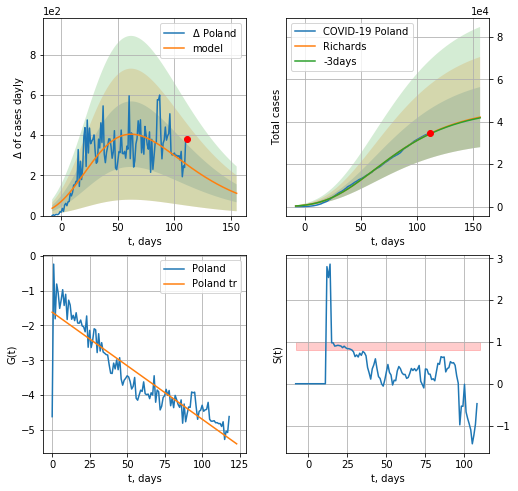

Poland data at: 2020-09-09
+3 day model MAPE: 0.004129
model: Richards
coeffs: [ 4.71367602e+04  2.41241361e+00 -1.35493652e+02  9.71752957e-03]
rational stdev: 0.335893
forecast at the end of period: +45 days
	 deltaDaycases: 110
	 total cases: 42193 ± 14172
	 total death: 1259 ± 1268
trend coefficient of determination: 0.829985
 intercept: -1.620348
 slope: -0.030685


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


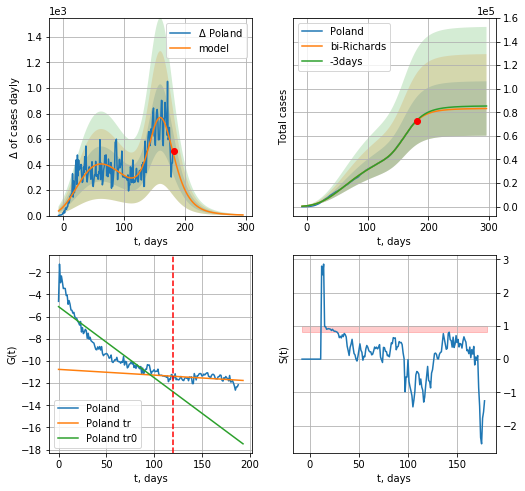

Poland data at: 2020-09-09
+3 day model MAPE: 0.005179
model: bi-Richards
coeffs: [3.62623947e+04 1.02035582e-01 1.53984868e+02 6.42340799e-01]
rational stdev: 0.277296
forecast at the end of period: +115 days
	 deltaDaycases: 4
	 total cases: 83198 ± 23070
	 total death: 2482 ± 2064
bi-Richards approximation splitting point: 120
trend coefficient of determination: 0.829811
 intercept: -5.098081
 slope: -0.064174
trend coefficient of determination: 0.101859
 intercept: -10.762806
 slope: -0.005185


In [1204]:
vL = 120
x =  forecastRR('Poland',dfPL[:vL],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx =  forecast2RR('Poland',dfPL[:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


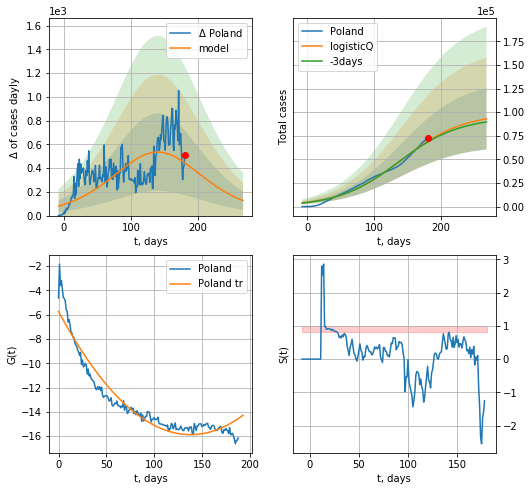

Poland data at: 2020-09-09
+3 day model MAPE: 0.013964
model: logisticQ
coeffs: [ 9.78902108e+04  9.12629924e-08  1.40126911e+02 -2.38277892e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.348772
forecast at the end of period: +87 days
	 deltaDaycases: 126
	 total cases: 92989 ± 32431
	 total death: 2774 ± 2902
trend coefficient of determination: 0.920609
 intercept_: -5.733739409947988
 coeffs_: [ 0.         -0.14690065  0.00053177]


In [1205]:
x =  forecastRRR('Poland',dfPL[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

IS
           date     cases  active   death
196 2020-09-05  129349.0   26232  1010.0
197 2020-09-06  131970.0   27099  1022.0
198 2020-09-07  135043.0   27723  1026.0
199 2020-09-08  139013.0   30366  1048.0
200 2020-09-09  142582.0   31771  1054.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


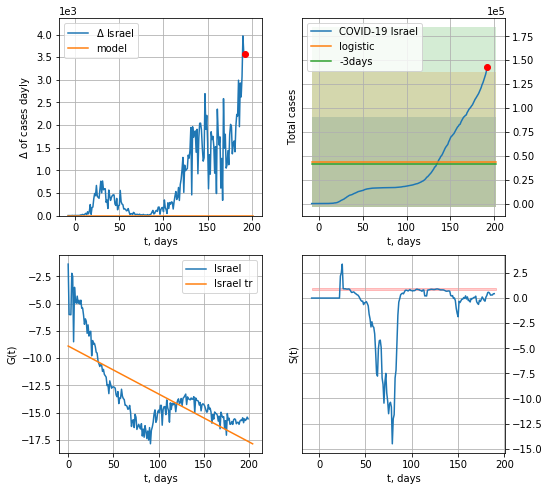

Israel data at: 2020-09-09
+3 day model MAPE: 0.04696989216803038
model: logistic
coeffs:  [ 3.50622342e+04 -1.50093258e+01  3.73670300e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  1.0725964673021153
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  43827 ± 47009
	 total death:  323 ± 1039
trend coefficient of determination: 0.529538
 intercept: -8.887779
 slope: -0.043899


In [996]:
dfIS = read_df(pd.DataFrame(),"IS")
try:
    x = forecast('Israel',dfIS[:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
except:
    print ("Exception occurs")
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


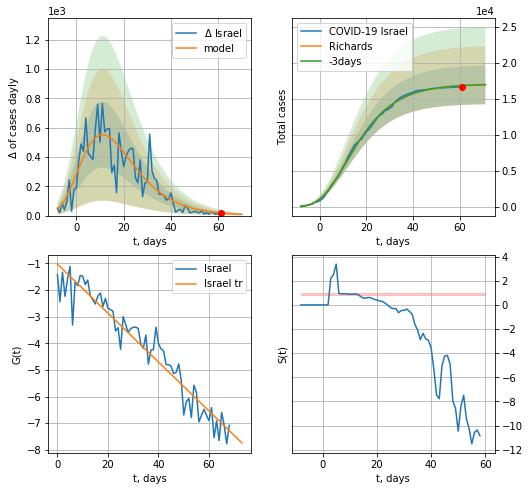

Israel data at: 2020-09-09
+3 day model MAPE: 0.001940
model: Richards
coeffs: [ 1.70515692e+04  6.43104023e+00 -3.67761649e+01  1.37703182e-02]
rational stdev: 0.158197
forecast at the end of period: +10 days
	 deltaDaycases: 8
	 total cases: 16963 ± 2683
	 total death: 125 ± 59
trend coefficient of determination: 0.925544
 intercept: -1.027515
 slope: -0.091953


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


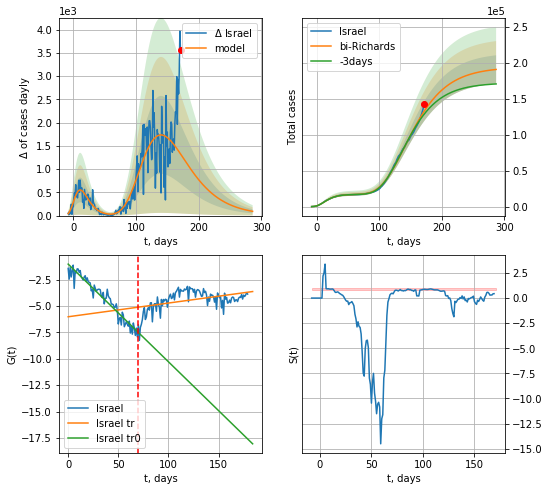

Israel data at: 2020-09-09
+3 day model MAPE: 0.033023
model: bi-Richards
coeffs: [ 1.76807985e+05  1.84677658e+00 -1.68912393e+01  1.45613895e-02]
rational stdev: 0.103356
forecast at the end of period: +115 days
	 deltaDaycases: 91
	 total cases: 190463 ± 19685
	 total death: 1407 ± 436
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.928555
 intercept: -1.018461
 slope: -0.092642
trend coefficient of determination: 0.208052
 intercept: -6.012648
 slope: 0.013003


In [997]:
x = forecastRR('Israel',dfIS[20:90],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Israel',dfIS[20:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=90-20)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


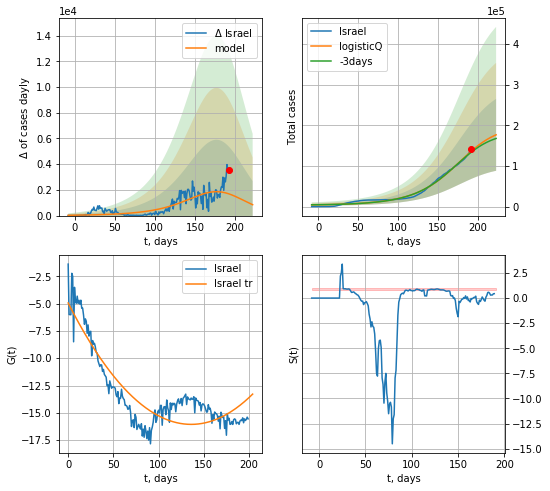

Israel data at: 2020-09-09
+3 day model MAPE: 0.020634
model: logisticQ
coeffs: [ 1.96444923e+05  8.93611117e-05  1.70907746e+02 -2.46477332e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.500904
forecast at the end of period: +31 days
	 deltaDaycases: 847
	 total cases: 176753 ± 88536
	 total death: 1306 ± 1962
trend coefficient of determination: 0.793568
 intercept_: -4.9457665070291
 coeffs_: [ 0.         -0.16335407  0.00060028]


In [998]:
x = forecastRRR('Israel',dfIS[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


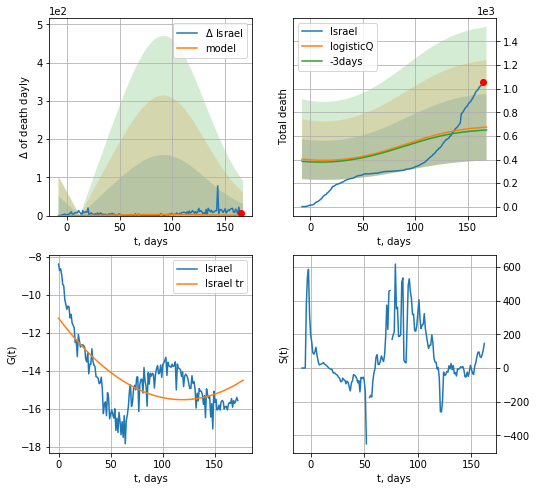

Israel data at: 2020-09-09
+3 day model MAPE: 0.036964
model: logisticQ
coeffs: [5.80413662e+02 1.64869080e-04 1.91974733e+01 4.81512280e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.419791
forecast at the end of period: +3 days
	 total death: 674 ± 283
trend coefficient of determination: 0.456734
 intercept_: -11.233602748645726
 coeffs_: [ 0.         -0.07206083  0.000303  ]


In [999]:
x = forecastRRR('Israel',dfIS[27:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

SZ
           date    cases  active   death
193 2020-09-05  43957.0    4844  2013.0
194 2020-09-06  44401.0    5288  2013.0
195 2020-09-07  44592.0    4878  2014.0
196 2020-09-08  44837.0    5119  2018.0
197 2020-09-09  45306.0    5187  2019.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


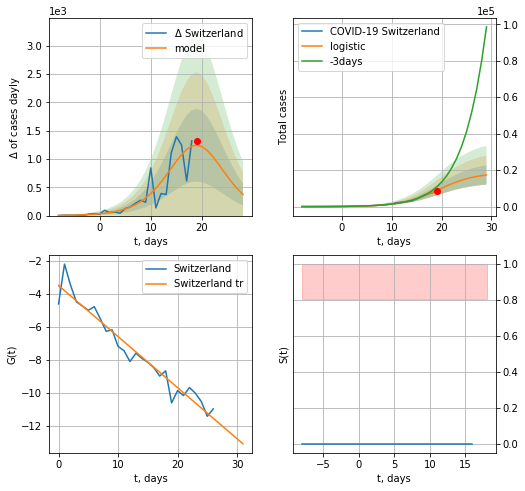

Switzerland data at: 2020-09-09
+3 day model MAPE: 0.24949882905970236
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.3060478989718857
forecast at the end of period: +10 days
	 deltaDaycases:  372
	 total cases:  17361 ± 5313
	 total death:  773 ± 709
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041


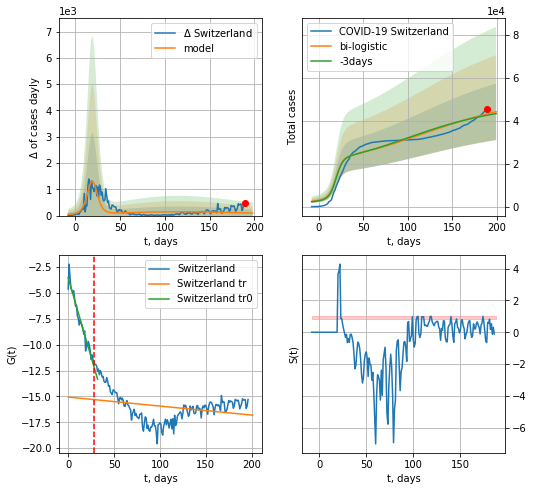

Switzerland data at: 2020-09-09
+3 day model MAPE: 0.015313246555518764
model: bi-logistic
coeffs:  [2.63504702e+04 1.99590069e-02 1.07153365e+02] [1.87061213e+04 2.66466230e-01 1.93986309e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.2981104727613012
forecast at the end of period: +10 days
	 deltaDaycases:  95
	 total cases:  44218 ± 13181
	 total death:  1970 ± 1761
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.947988
 intercept: -3.537068
 slope: -0.305765
trend coefficient of determination: 0.083533
 intercept: -15.059041
 slope: -0.008715


In [1000]:
vL= 28
try:
    dfSZ = read_df(pd.DataFrame(),"SZ")
    x = forecast('Switzerland',dfSZ[:vL],d1,7*T18-dT)
    xx = forecast2('Switzerland',dfSZ[:],d1,7*T18-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


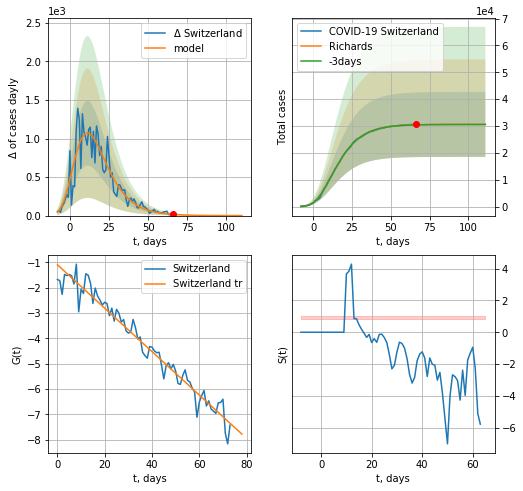

Switzerland data at: 2020-09-09
+3 day model MAPE: 0.000864
model: Richards
coeffs: [ 3.06308865e+04  7.16537801e+00 -3.34375097e+01  1.33541414e-02]
rational stdev: 0.394656
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 30628 ± 12087
	 total death: 1364 ± 1614
trend coefficient of determination: 0.958074
 intercept: -1.096880
 slope: -0.085687


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


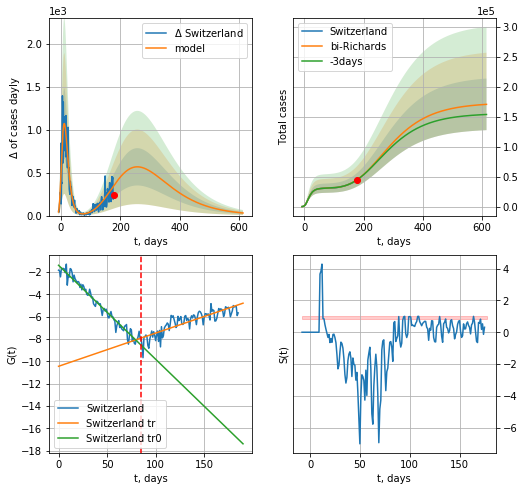

Switzerland data at: 2020-09-09
+3 day model MAPE: 0.002451
model: bi-Richards
coeffs: [ 1.42474560e+05  2.59883813e-01 -2.76034828e+01  4.25225477e-02]
rational stdev: 0.252351
forecast at the end of period: +437 days
	 deltaDaycases: 30
	 total cases: 170372 ± 42993
	 total death: 7592 ± 5747
bi-Richards approximation splitting point: 85
trend coefficient of determination: 0.963769
 intercept: -1.399385
 slope: -0.084178
trend coefficient of determination: 0.741152
 intercept: -10.449022
 slope: 0.029747


In [1002]:
iL = 10
vL = 85 + iL
x = forecastRR('Switzerland',dfSZ[iL:vL-iL],d1,7*30-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Switzerland',dfSZ[iL:-1],d1,7*86-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


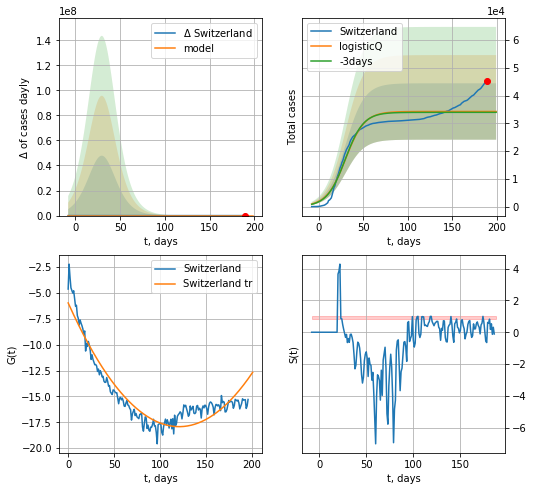

Switzerland data at: 2020-09-09
+3 day model MAPE: 0.009049
model: logisticQ
coeffs: [ 3.42707237e+04  7.73289132e-08  3.00049783e+01 -1.22344723e+06]
rational stdev: 0.296376
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 34270 ± 10157
	 total death: 1527 ± 1357
trend coefficient of determination: 0.895757
 intercept_: -5.9648699206778755
 coeffs_: [ 0.         -0.19774562  0.00081777]


In [1003]:
x = forecastRRR('Switzerland',dfSZ[:],d1,7*T18-dT,addpred=False,xcoef=koreaCoeffs)

In [1004]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
           date     cases  active   death
179 2020-09-05  133878.0   71434  2811.0
180 2020-09-06  135894.0   72585  2877.0
181 2020-09-07  138068.0   73999  2934.0
182 2020-09-08  140479.0   76505  2979.0
183 2020-09-09  143030.0   76712  3023.0


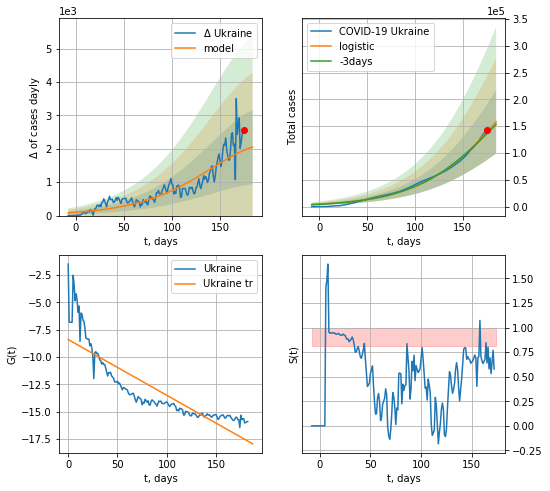

Ukraine data at: 2020-09-09
+3 day model MAPE: 0.020075532709657402
model: logistic
coeffs:  [3.81960990e+05 2.20169562e-02 2.01172231e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3733473494854449
forecast at the end of period: +10 days
	 deltaDaycases:  2050
	 total cases:  158125 ± 59035
	 total death:  3282 ± 3675
trend coefficient of determination: 0.746041
 intercept: -8.399148
 slope: -0.050982


In [1008]:
dfUR = read_df(pd.DataFrame(),"Ukr")
try:
    x=forecast('Ukraine',dfUR[:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,2.])
except:
      print("Exaption occurs") 

#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


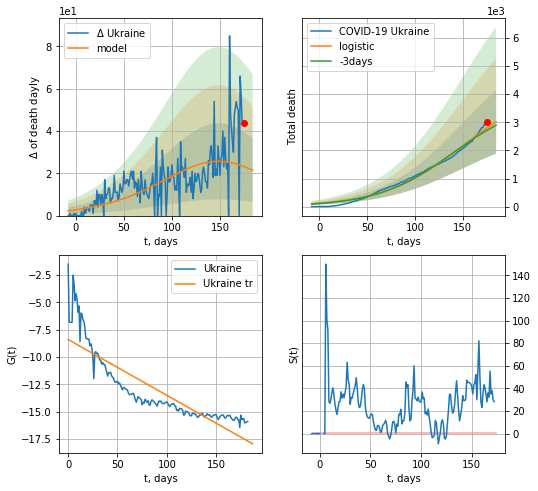

Ukraine data at: 2020-09-09
+3 day model MAPE: 0.03140452305712539
model: logistic
coeffs:  [4.27818140e+03 2.40026655e-02 1.48922633e+02]
rational stdev:  0.3744629989682448
forecast at the end of period: +10 days
	 total death:  3011 ± 1127
trend coefficient of determination: 0.746041
 intercept: -8.399148
 slope: -0.050982


In [1009]:
x=forecast('Ukraine',dfUR[:],d1,T18*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


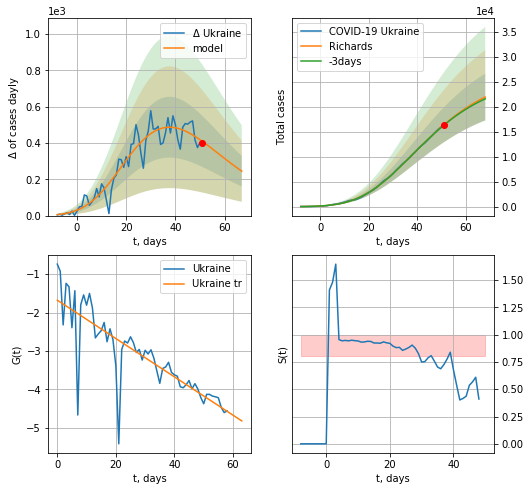

Ukraine data at: 2020-09-09
+3 day model MAPE: 0.005756
model: Richards
coeffs: [ 2.73152267e+04  5.78390591e-01 -1.00505553e+01  8.74755349e-02]
rational stdev: 0.213278
forecast at the end of period: +17 days
	 deltaDaycases: 244
	 total cases: 21959 ± 4683
	 total death: 455 ± 291
trend coefficient of determination: 0.678475
 intercept: -1.678868
 slope: -0.049847


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


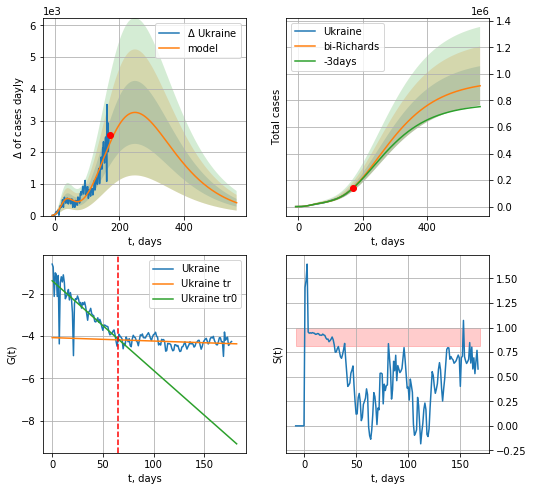

Ukraine data at: 2020-09-09
+3 day model MAPE: 0.011390
model: bi-Richards
coeffs: [ 9.25486335e+05  4.81296342e-01 -1.55564559e+02  2.00670308e-02]
rational stdev: 0.162432
forecast at the end of period: +395 days
	 deltaDaycases: 404
	 total cases: 910041 ± 147819
	 total death: 18893 ± 9206
bi-Richards approximation splitting point: 65
trend coefficient of determination: 0.671356
 intercept: -1.395225
 slope: -0.042301
trend coefficient of determination: 0.053505
 intercept: -4.079866
 slope: -0.001607


In [1010]:
vL = 70#65+5 +55
x=forecastRR('Ukraine',dfUR[5:vL-5],d1,7*26-dT,addpred=False,xcoef=RkoreaCoeffs)
xx=forecast2RR('Ukraine',dfUR[5:],d1,7*80-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


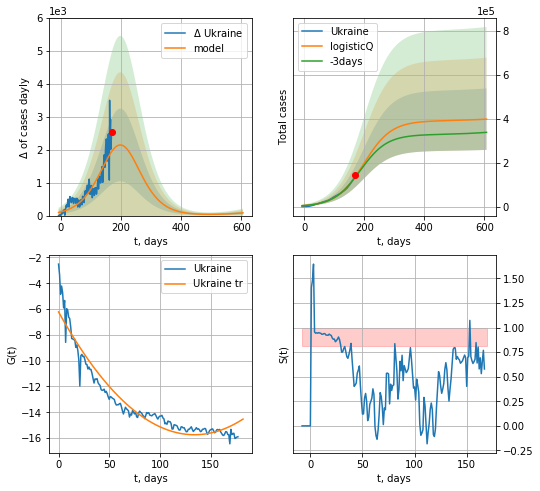

Ukraine data at: 2020-09-09
+3 day model MAPE: 0.020759
model: logisticQ
coeffs: [ 3.90945460e+05  4.76885476e-07  1.97834004e+02 -4.58171692e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.351373
forecast at the end of period: +437 days
	 deltaDaycases: 82
	 total cases: 398775 ± 140118
	 total death: 8278 ± 8725
trend coefficient of determination: 0.925886
 intercept_: -6.221106689195972
 coeffs_: [ 0.         -0.14198652  0.00052937]


In [1011]:
x=forecastRRR('Ukraine',dfUR[5:],d1,7*86-dT,addpred=True,xcoef=koreaCoeffs)

In [1012]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

IN
           date   cases  active    death
199 2020-09-05  384666   30381  22154.0
200 2020-09-06  386658   30465  22293.0
201 2020-09-07  388810   30828  22410.0
202 2020-09-08  391112   31156  22542.0
203 2020-09-09  393425   31645  22669.0


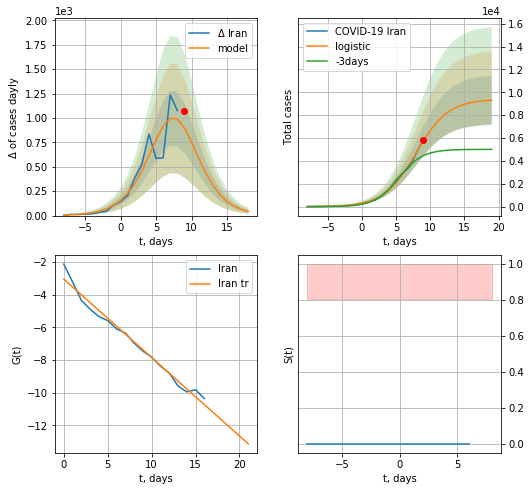

Iran data at: 2020-09-09
+3 day model MAPE: 0.4176898990261385
model: logistic
coeffs:  [9.38566043e+03 4.29600562e-01 7.92981700e+00]
rational stdev:  0.2297342183396625
forecast at the end of period: +10 days
	 deltaDaycases:  42
	 total cases:  9305 ± 2137
	 total death:  536 ± 369
trend coefficient of determination: 0.980602
 intercept: -3.037586
 slope: -0.480406


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


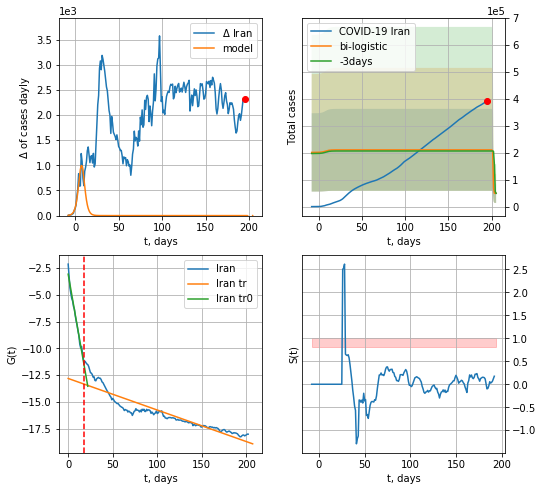

Iran data at: 2020-09-09
+3 day model MAPE: 0.019917402800183
model: bi-logistic
coeffs:  [ 1.61109361e+05 -5.57676181e+00  2.01651294e+02] [9.38566043e+03 4.29600562e-01 7.92981700e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.7225625608818992
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  49663 ± 35884
	 total death:  2861 ± 6201
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.982944
 intercept: -3.059655
 slope: -0.476268
trend coefficient of determination: 0.852228
 intercept: -12.809789
 slope: -0.029512


In [1013]:
dfIN = read_df(pd.DataFrame(),"IN")
x = forecast('Iran',dfIN[:18],d1,7*T18-dT)
xx = forecast2('Iran',dfIN[:],d1,T18*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


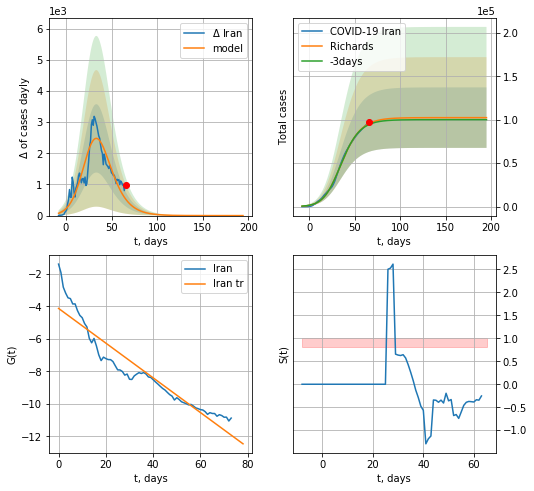

Iran data at: 2020-09-09
+3 day model MAPE: 0.012009
model: Richards
coeffs: [1.02478152e+05 1.52216307e-01 2.65523943e+01 5.45962781e-01]
rational stdev: 0.339941
forecast at the end of period: +129 days
	 deltaDaycases: 0
	 total cases: 102477 ± 34836
	 total death: 5904 ± 6021
trend coefficient of determination: 0.893485
 intercept: -4.118018
 slope: -0.106957


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


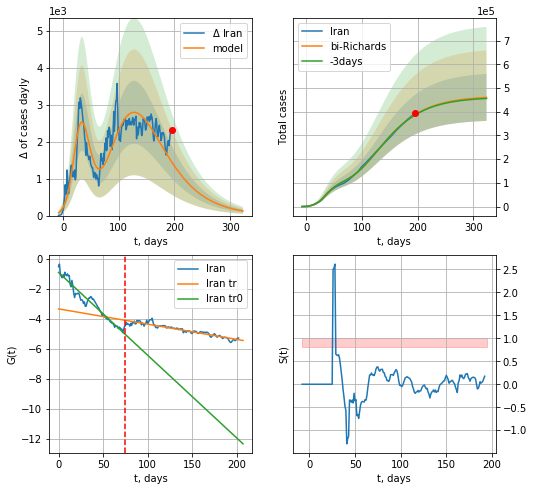

Iran data at: 2020-09-09
+3 day model MAPE: 0.003774
model: bi-Richards
coeffs: [ 3.63665495e+05  1.95739732e+00 -8.79681283e+01  1.07198502e-02]
rational stdev: 0.215180
forecast at the end of period: +129 days
	 deltaDaycases: 124
	 total cases: 460218 ± 99029
	 total death: 26517 ± 17117
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.949242
 intercept: -0.910254
 slope: -0.055069
trend coefficient of determination: 0.900276
 intercept: -3.334439
 slope: -0.010152


In [1014]:
vL = 75
x = forecastRR('Iran',dfIN[:vL],d1,42*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Iran',dfIN[:],d1,42*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


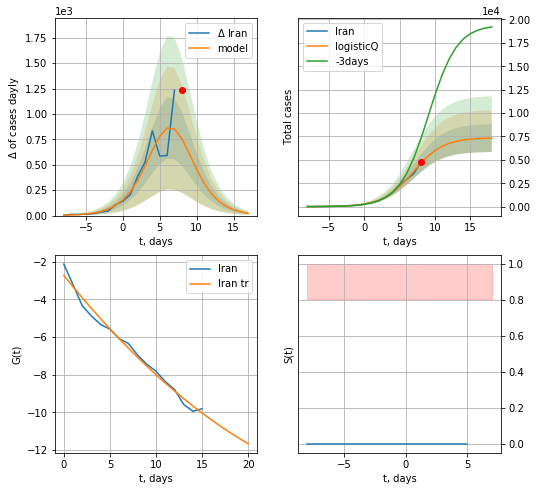

Iran data at: 2020-09-09
+3 day model MAPE: 0.437962
model: logisticQ
coeffs: [ 7.36885077e+03  7.42724103e-05 -6.37161781e+03  6.90116795e+00]
rational stdev: 0.203007
forecast at the end of period: +10 days
	 deltaDaycases: 22
	 total cases: 7331 ± 1488
	 total death: 422 ± 257
trend coefficient of determination: 0.985826
 intercept_: -2.7244557798652984
 coeffs_: [ 0.         -0.60810956  0.00802289]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


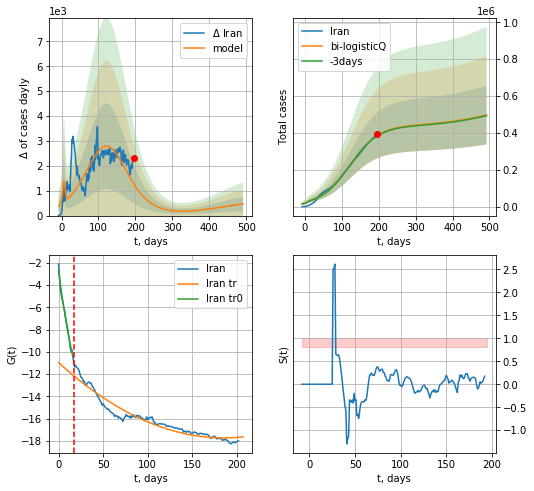

Iran data at: 2020-09-09
+3 day model MAPE: 0.005164
model: bi-logisticQ
coeffs: [ 4.31973046e+05  1.02433124e-07  1.21848086e+02 -2.51364426e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.320802
forecast at the end of period: +297 days
	 deltaDaycases: 465
	 total cases: 496841 ± 159387
	 total death: 28627 ± 27550
bi-logisticQ approximation splitting point: 17
trend coefficient of determination: 0.987745
 intercept_: -2.720144864989817
 coeffs_: [ 0.         -0.61067547  0.00823538]
trend coefficient of determination: 0.933557
 intercept_: -10.96784026601693
 coeffs_: [ 0.         -0.07284183  0.00019601]


In [1015]:
x = forecastRRR('Iran',dfIN[:17],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Iran',dfIN[:],d1,66*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=17)

RS
           date      cases  active    death
189 2020-09-05  1020310.0  166736  17820.0
190 2020-09-06  1025505.0  169542  17871.0
191 2020-09-07  1030690.0  169542  17871.0
192 2020-09-08  1035789.0  166414  18135.0
193 2020-09-09  1041007.0  165734  18263.0


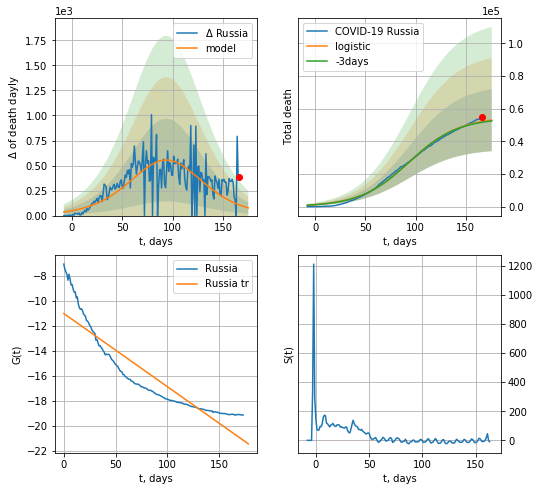

Russia data at: 2020-09-09
+3 day model MAPE: 0.008449674353587525
model: logistic
coeffs:  [5.48958166e+04 4.04207017e-02 9.40485147e+01]
rational stdev:  0.35921420535781806
forecast at the end of period: +10 days
	 total death:  52966 ± 19026
trend coefficient of determination: 0.831517
 intercept: -11.032598
 slope: -0.058589


In [1017]:
try:
    dfRS = read_df(pd.DataFrame(),"RS")
    x = forecast('Russia',dfRS[19:],d1,T18*7-dT,shift=3.,cases='death')
    #xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]
except:
    print ("Exeption occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


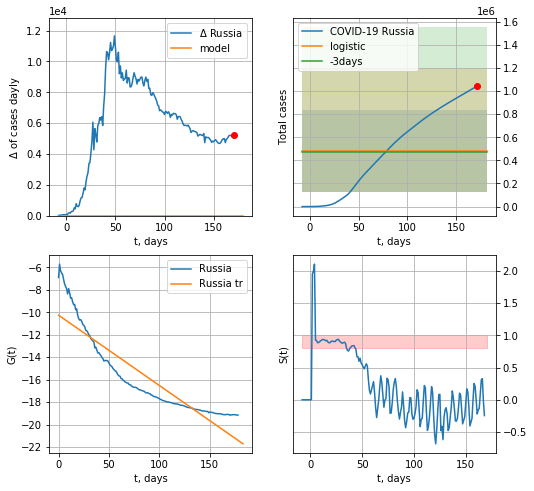

Russia data at: 2020-09-09
+3 day model MAPE: 0.01995533548167441
model: logistic
coeffs:  [ 4.80812505e+05 -1.24772880e+01  3.10851936e+02]
rational stdev:  0.7441402657327635
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  480812 ± 357791
	 total death:  8391 ± 18732
trend coefficient of determination: 0.826136
 intercept: -10.254583
 slope: -0.062642


In [1018]:
x = forecast('Russia',dfRS[14:],d1,T18*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


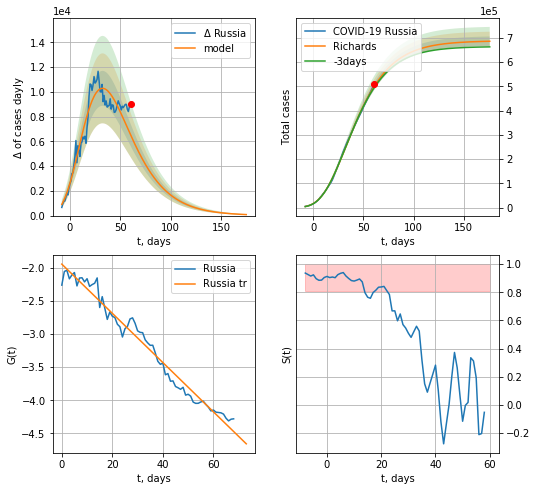

Russia data at: 2020-09-09
+3 day model MAPE: 0.010822
model: Richards
coeffs: [ 6.88418485e+05  2.24771706e+00 -6.48448453e+01  1.82243445e-02]
rational stdev: 0.028811
forecast at the end of period: +115 days
	 deltaDaycases: 81
	 total cases: 686459 ± 19777
	 total death: 11981 ± 1035
trend coefficient of determination: 0.974032
 intercept: -1.941717
 slope: -0.037219


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


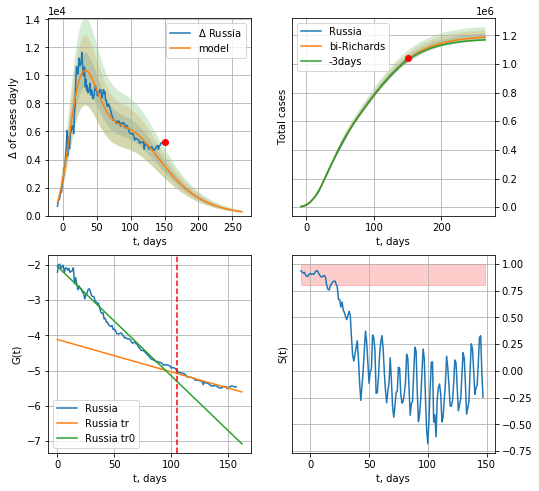

Russia data at: 2020-09-09
+3 day model MAPE: 0.004089
model: bi-Richards
coeffs: [ 5.09014949e+05  2.15916021e+00 -6.56276406e+01  1.16293120e-02]
rational stdev: 0.020063
forecast at the end of period: +115 days
	 deltaDaycases: 272
	 total cases: 1186641 ± 23807
	 total death: 20711 ± 1246
bi-Richards approximation splitting point: 105
trend coefficient of determination: 0.971884
 intercept: -2.041146
 slope: -0.031124
trend coefficient of determination: 0.887609
 intercept: -4.118208
 slope: -0.009200


In [1019]:
vL = 105 + 35
x = forecastRR('Russia',dfRS[35:vL-35],d1,40*7-dT,addpred=False,xcoef=RkoreaCoeffs)#,addpred=True,xcoef=[0.25,1.,1.5,1]
xx = forecast2RR('Russia',dfRS[35:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-35)
#x = forecastQR('Russia',dfRS[20:],d1,30*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


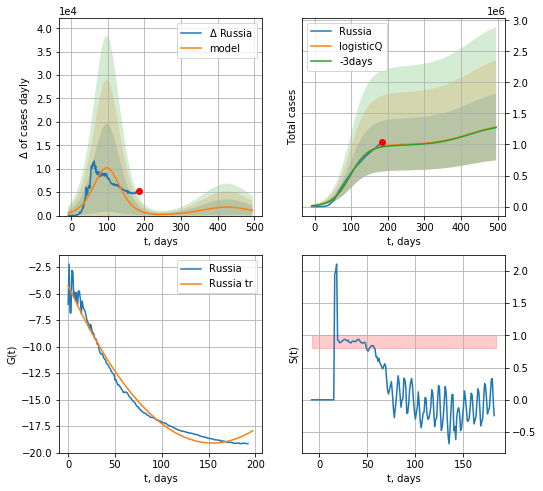

Russia data at: 2020-09-09
+3 day model MAPE: 0.009895
model: logisticQ
coeffs: [ 9.95882421e+05  7.69737160e-08  9.74174262e+01 -5.31925868e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.418470
forecast at the end of period: +311 days
	 deltaDaycases: 1110
	 total cases: 1282703 ± 536772
	 total death: 22387 ± 28104
trend coefficient of determination: 0.979774
 intercept_: -4.223180645291807
 coeffs_: [ 0.         -0.19320539  0.00062745]


In [1020]:
x = forecastRRR('Russia',dfRS[:],d1,68*7-dT,addpred=True,xcoef=koreaCoeffs)

JP
           date    cases  active   death
227 2020-09-05  70876.0    8082  1349.0
228 2020-09-06  71419.0    7986  1357.0
229 2020-09-07  71856.0    7957  1363.0
230 2020-09-08  72234.0    7575  1377.0
231 2020-09-09  72726.0    7233  1393.0


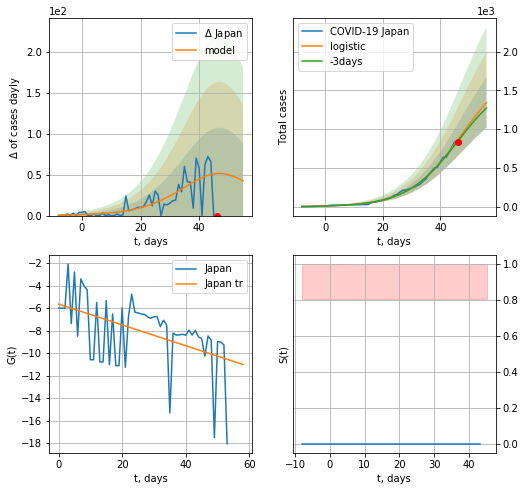

Japan data at: 2020-09-09
+3 day model MAPE: 0.024413899387998084
model: logistic
coeffs:  [1.86668600e+03 1.09971339e-01 4.74124631e+01]
rational stdev:  0.24188431732788906
forecast at the end of period: +10 days
	 deltaDaycases:  42
	 total cases:  1343 ± 325
	 total death:  25 ± 18
trend coefficient of determination: 0.226001
 intercept: -5.646499
 slope: -0.092589


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


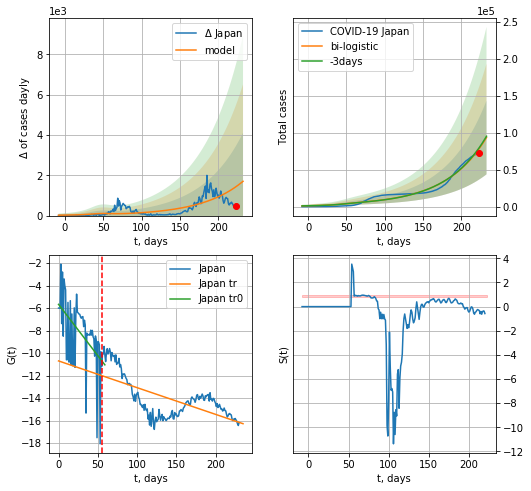

Japan data at: 2020-09-09
+3 day model MAPE: 0.015018916531956797
model: bi-logistic
coeffs:  [9.45842062e+07 1.87525985e-02 6.02960955e+02] [1.86668600e+03 1.09971339e-01 4.74124631e+01]
rational stdev:  0.533158675712034
forecast at the end of period: +10 days
	 deltaDaycases:  1702
	 total cases:  93568 ± 49887
	 total death:  1792 ± 2866
bi-logistic approximation splitting point: 55
trend0 coefficient of determination: 0.229818
 intercept: -5.672459
 slope: -0.091119
trend coefficient of determination: 0.429913
 intercept: -10.701042
 slope: -0.023746


In [1021]:
dfJP = read_df(pd.DataFrame(),"JP")
try:
    x = forecast('Japan',dfJP[:55],d1,7*T18-dT)
    xx = forecast2('Japan',dfJP[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,1.25],vL=55)
except:
    print ("Exception occurs")

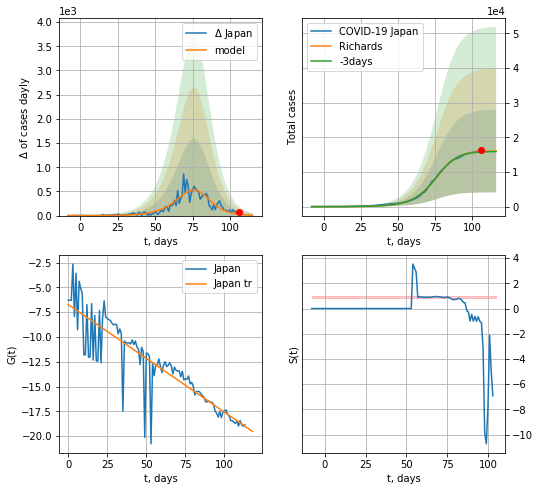

Japan data at: 2020-09-09
+3 day model MAPE: 0.009396
model: Richards
coeffs: [1.61043525e+04 1.05070375e-01 7.85362635e+01 1.40112814e+00]
rational stdev: 0.743333
forecast at the end of period: +10 days
	 deltaDaycases: 7
	 total cases: 16058 ± 11936
	 total death: 307 ± 684
trend coefficient of determination: 0.778576
 intercept: -6.726919
 slope: -0.108522


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


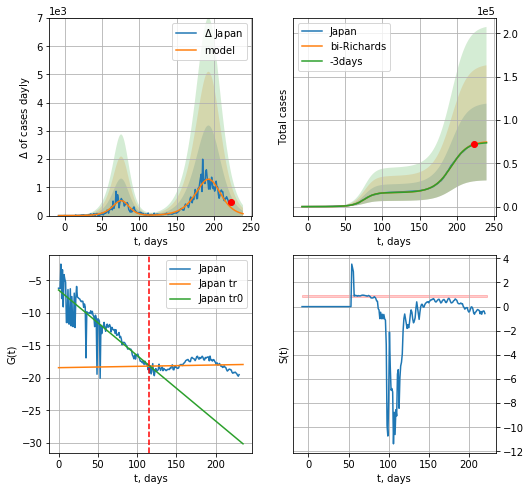

Japan data at: 2020-09-09
+3 day model MAPE: 0.008152
model: bi-Richards
coeffs: [5.90935977e+04 7.33541507e-02 1.95969102e+02 1.29440697e+00]
rational stdev: 0.594395
forecast at the end of period: +17 days
	 deltaDaycases: 67
	 total cases: 74509 ± 44288
	 total death: 1427 ± 2544
bi-Richards approximation splitting point: 115
trend coefficient of determination: 0.755983
 intercept: -6.479550
 slope: -0.100604
trend coefficient of determination: 0.007186
 intercept: -18.419868
 slope: 0.002078


In [1022]:
vL = 115
x = forecastRR('Japan',dfJP[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Japan',dfJP[:],d1,26*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


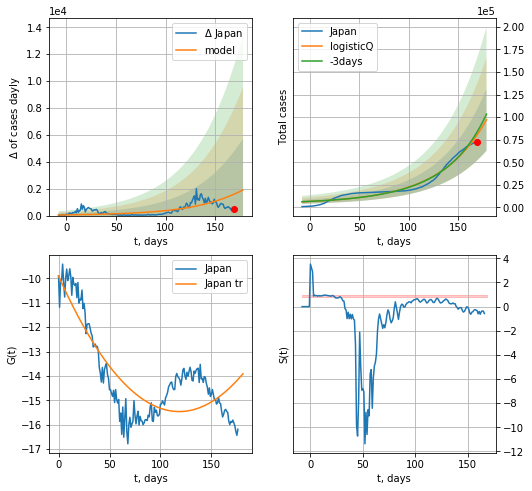

Japan data at: 2020-09-09
+3 day model MAPE: 0.039108
model: logisticQ
coeffs: [ 5.68698508e+05  4.38527175e-05  2.38608948e+02 -4.25701246e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.353191
forecast at the end of period: +10 days
	 deltaDaycases: 1906
	 total cases: 97126 ± 34304
	 total death: 1860 ± 1970
trend coefficient of determination: 0.687121
 intercept_: -9.898808431159452
 coeffs_: [ 0.         -0.0940068   0.00039695]


In [1023]:
x = forecastRRR('Japan',dfJP[54:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

NL
           date    cases  active   death
191 2020-09-05  73862.0       0  6241.0
192 2020-09-06  74787.0       0  6243.0
193 2020-09-07  75584.0       0  6243.0
194 2020-09-08  76548.0       0  6244.0
195 2020-09-09  77688.0       0  6246.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


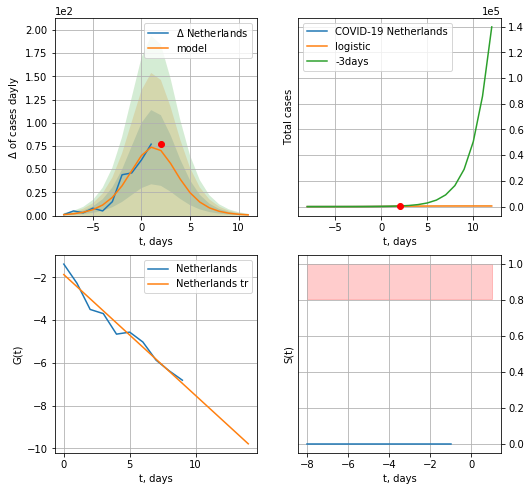

Netherlands data at: 2020-09-09
model: logistic
coeffs:  [487.7470779    0.61204075   1.72557626]
rational stdev:  0.23761281134430468
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  486 ± 115
	 total death:  39 ± 27
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


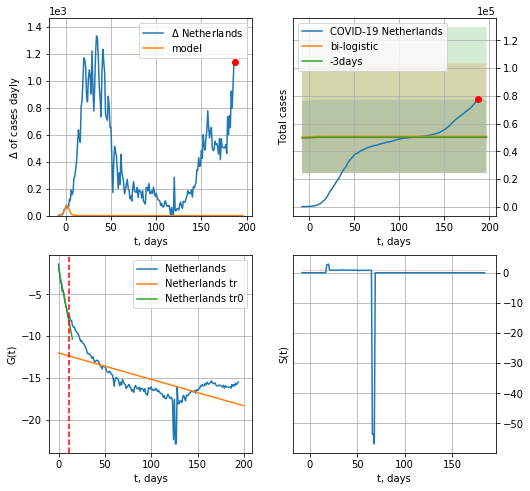

Netherlands data at: 2020-09-09
+3 day model MAPE: 0.013946349970235495
model: bi-logistic
coeffs:  [ 4.02008978e+04 -7.50429318e+00  2.09561961e+02] [487.7470779    0.61204075   1.72557626]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.5194259066228138
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  50738 ± 26355
	 total death:  4079 ± 6356
bi-logistic approximation splitting point: 11
trend0 coefficient of determination: 0.974821
 intercept: -1.878275
 slope: -0.564738
trend coefficient of determination: 0.449312
 intercept: -12.000473
 slope: -0.031564


In [1024]:
vL=11
vL1=32
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[:vL],d1,T18*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


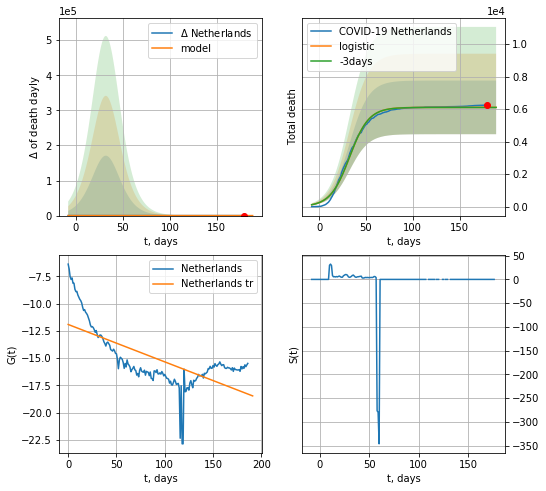

Netherlands data at: 2020-09-09
+3 day model MAPE: 0.0006513738294976776
model: logistic
coeffs:  [6.10728203e+03 9.73588358e-02 3.24844093e+01]
rational stdev:  0.2702537569112716
forecast at the end of period: +10 days
	 total death:  6107 ± 1650
trend coefficient of determination: 0.472319
 intercept: -11.913030
 slope: -0.034291


In [1025]:
x = forecast('Netherlands',dfNL[8:],d1,T18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


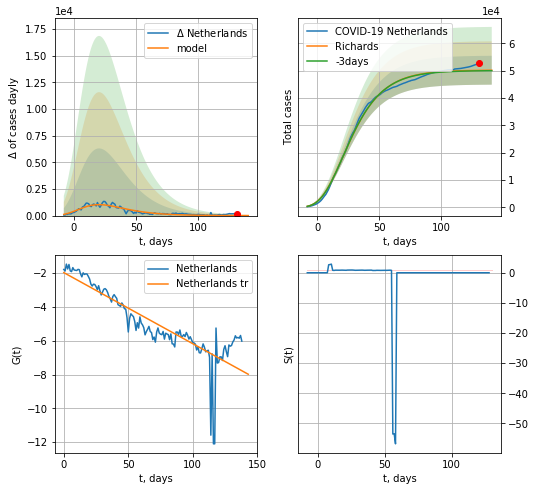

Netherlands data at: 2020-09-09
+3 day model MAPE: 0.003437
model: Richards
coeffs: [ 5.02415869e+04  8.73155449e+00 -6.99416502e+01  6.38067202e-03]
rational stdev: 0.105306
forecast at the end of period: +10 days
	 deltaDaycases: 3
	 total cases: 50179 ± 5284
	 total death: 4034 ± 1274
trend coefficient of determination: 0.744376
 intercept: -1.967578
 slope: -0.042068


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


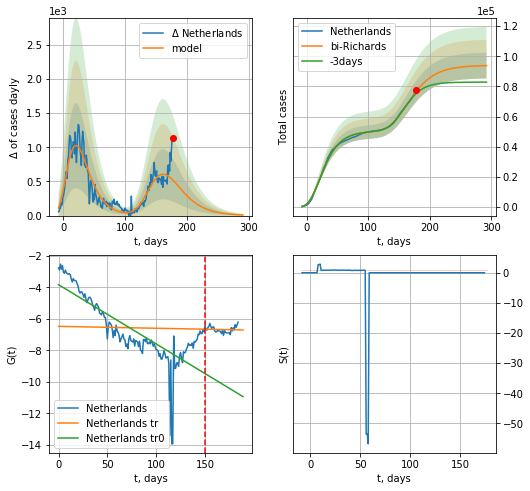

Netherlands data at: 2020-09-09
+3 day model MAPE: 0.018528
model: bi-Richards
coeffs: [4.38245289e+04 2.30798314e-01 1.19431566e+02 1.76606723e-01]
rational stdev: 0.091243
forecast at the end of period: +115 days
	 deltaDaycases: 9
	 total cases: 93848 ± 8562
	 total death: 7545 ± 2065
bi-Richards approximation splitting point: 150
trend coefficient of determination: 0.642942
 intercept: -3.830385
 slope: -0.037640
trend coefficient of determination: 0.003561
 intercept: -6.479094
 slope: -0.001203


In [1026]:
iL = 10
vL = 150+iL
x = forecastRR('Netherlands',dfNL[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Netherlands',dfNL[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [1027]:
#x = forecastQR('Netherlands',dfNL[7:],d1,16*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


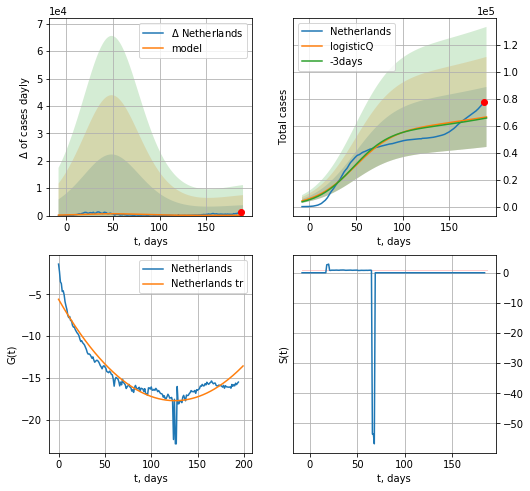

Netherlands data at: 2020-09-09
+3 day model MAPE: 0.012280
model: logisticQ
coeffs: [ 5.88564021e+04  2.65087595e-08  4.88467177e+01 -1.71710998e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.334850
forecast at the end of period: +3 days
	 deltaDaycases: 115
	 total cases: 66511 ± 22271
	 total death: 5347 ± 5371
trend coefficient of determination: 0.903893
 intercept_: -5.591120111890998
 coeffs_: [ 0.         -0.1929376   0.00076838]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


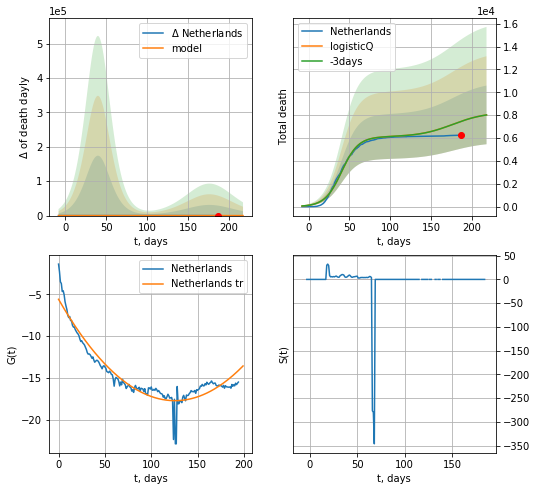

Netherlands data at: 2020-09-09
+3 day model MAPE: 0.000270
model: logisticQ
coeffs: [ 6.10661056e+03  2.91572958e-07  4.04863865e+01 -3.34679326e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.319901
forecast at the end of period: +31 days
	 total death: 8020 ± 2565
trend coefficient of determination: 0.903893
 intercept_: -5.591120111890998
 coeffs_: [ 0.         -0.1929376   0.00076838]


In [1028]:
x = forecastRRR('Netherlands',dfNL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Netherlands',dfNL[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

In [1029]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

AT
           date    cases  active  death
192 2020-09-05  29271.0    3492  736.0
193 2020-09-06  29561.0    3492  736.0
194 2020-09-07  30081.0    3515  746.0
195 2020-09-08  30583.0    4072  747.0
196 2020-09-09  31247.0    4456  748.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:86: RuntimeWarning: overflow encountered in exp


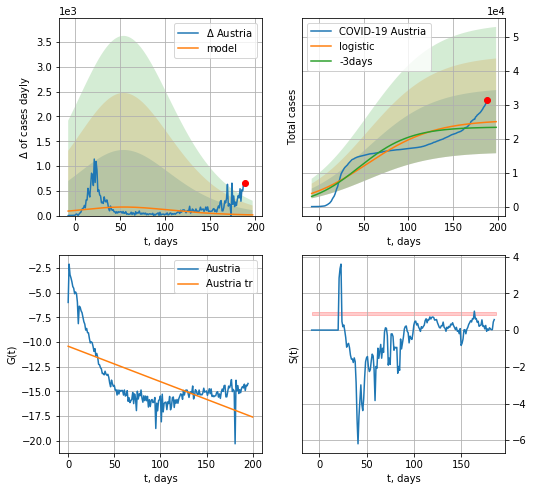

Austria data at: 2020-09-09
+3 day model MAPE: 0.06728250884410047
model: logistic
coeffs:  [2.40370982e+04 2.76758621e-02 5.23096067e+01]
scenario coeffs:  [0.0625, 1.0, 2.0]
rational stdev:  0.37178573602806253
forecast at the end of period: +10 days
	 deltaDaycases:  14
	 total cases:  25015 ± 9300
	 total death:  611 ± 681
trend coefficient of determination: 0.398481
 intercept: -10.436567
 slope: -0.035809


In [1198]:
dfAT = read_df(pd.DataFrame(),"AT")
try:
    x = forecast('Austria',dfAT[:],d1,7*T18-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
except:
    print ("Exception occurs")
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


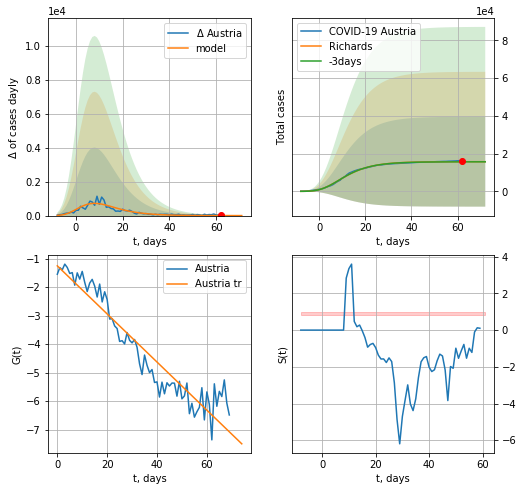

Austria data at: 2020-09-09
+3 day model MAPE: 0.004675
model: Richards
coeffs: [ 1.57373348e+04  1.44322302e+01 -2.95282735e+01  8.67503130e-03]
rational stdev: 1.514093
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 15731 ± 23819
	 total death: 384 ± 1744
trend coefficient of determination: 0.902786
 intercept: -1.255535
 slope: -0.084343


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


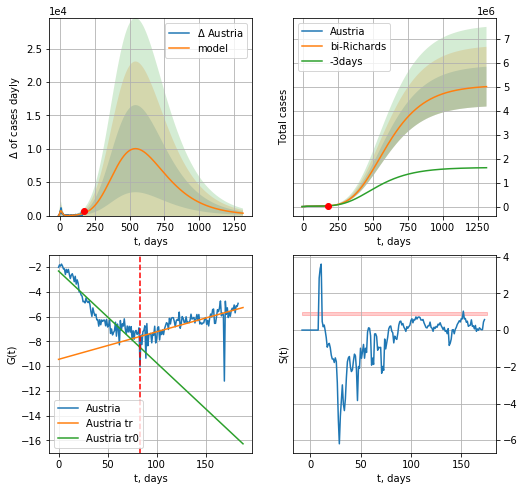

Austria data at: 2020-09-09
+3 day model MAPE: 0.013546
model: bi-Richards
coeffs: [5.04634364e+06 5.44926924e-02 1.44692341e+02 1.04193742e-01]
rational stdev: 0.165918
forecast at the end of period: +1137 days
	 deltaDaycases: 357
	 total cases: 4998802 ± 829389
	 total death: 122097 ± 60774
bi-Richards approximation splitting point: 83
trend coefficient of determination: 0.866403
 intercept: -2.315560
 slope: -0.074300
trend coefficient of determination: 0.416309
 intercept: -9.456339
 slope: 0.022279


In [1200]:
vL=83+12
x = forecastRR('Austria',dfAT[12:vL-12],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Austria',dfAT[12:],d12f(1),186*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


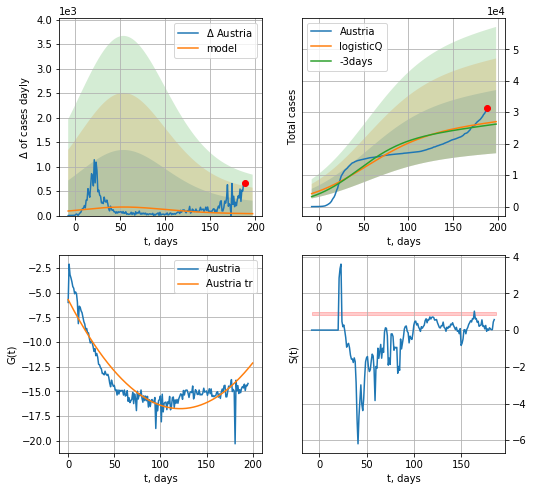

Austria data at: 2020-09-09
+3 day model MAPE: 0.029348
model: logisticQ
coeffs: [ 2.40375113e+04  1.90414585e-08  5.23143586e+01 -1.45290583e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.371792
forecast at the end of period: +10 days
	 deltaDaycases: 39
	 total cases: 26998 ± 10037
	 total death: 659 ± 735
trend coefficient of determination: 0.843574
 intercept_: -5.721448522344726
 coeffs_: [ 0.         -0.18163775  0.00074784]


In [1201]:
vL = 68
x = forecastRRR('Austria',dfAT[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR('Austria',dfAT[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=vL)

BG
           date    cases  active   death
188 2020-09-05  87825.0   59364  9906.0
189 2020-09-06  88367.0   59895  9907.0
190 2020-09-07  88769.0   60284  9909.0
191 2020-09-08  89141.0   60627  9912.0
192 2020-09-09  89691.0   61139  9917.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


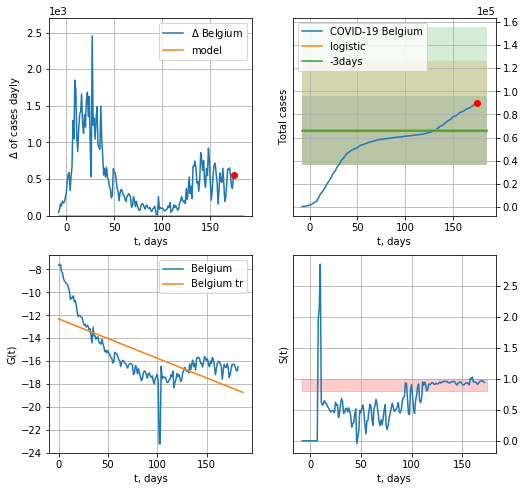

Belgium data at: 2020-09-09
+3 day model MAPE: 0.01145378934126529
model: logistic
coeffs:  [ 5.29938690e+04 -1.08457402e+01  3.26322325e+02]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.44998847106195244
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  66242 ± 29808
	 total death:  7324 ± 9887
trend coefficient of determination: 0.486964
 intercept: -12.313490
 slope: -0.034375


In [1034]:
vL=9
try:
    dfBG = read_df(pd.DataFrame(),"BG")
    x = forecast('Belgium',dfBG[vL:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,3.])
    #xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
except:
    print("Exception occurs")

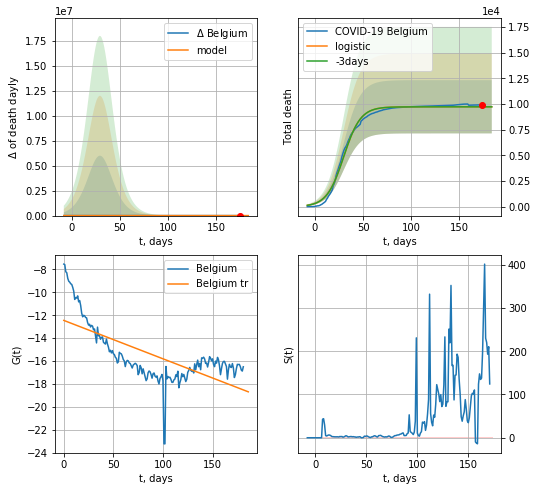

Belgium data at: 2020-09-09
+3 day model MAPE: 0.0005401850513378314
model: logistic
coeffs:  [9.72814547e+03 1.14064571e-01 2.98945424e+01]
rational stdev:  0.26659747640994114
forecast at the end of period: +10 days
	 total death:  9728 ± 2593
trend coefficient of determination: 0.479253
 intercept: -12.450389
 slope: -0.033525


In [1035]:
#dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,T18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


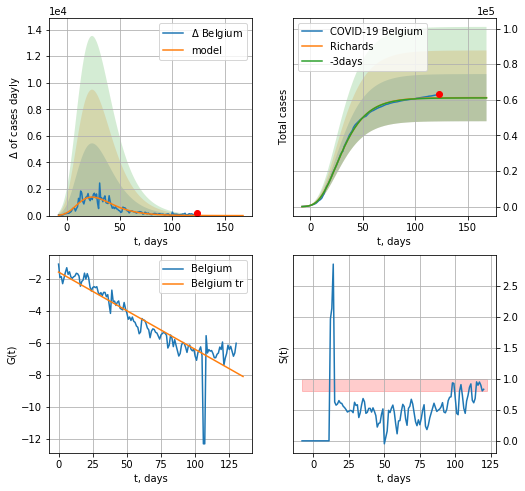

Belgium data at: 2020-09-09
+3 day model MAPE: 0.002325
model: Richards
coeffs: [ 6.11994198e+04  7.57384886e+00 -5.28924887e+01  8.21594131e-03]
rational stdev: 0.216332
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 61191 ± 13237
	 total death: 6765 ± 4390
trend coefficient of determination: 0.812352
 intercept: -1.573316
 slope: -0.048332


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


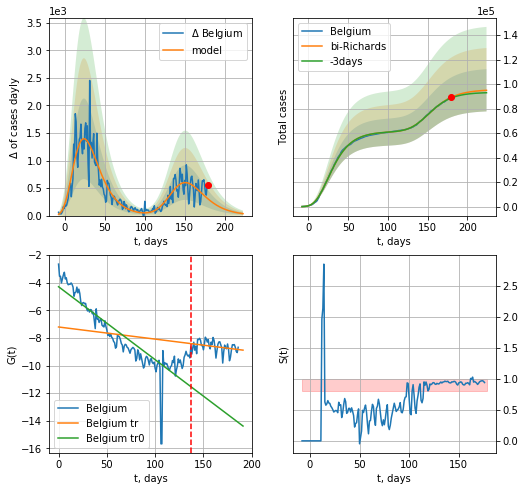

Belgium data at: 2020-09-09
+3 day model MAPE: 0.006600
model: bi-Richards
coeffs: [3.43571286e+04 1.73768608e-01 1.29954839e+02 3.14088313e-01]
rational stdev: 0.181581
forecast at the end of period: +45 days
	 deltaDaycases: 35
	 total cases: 94918 ± 17235
	 total death: 10495 ± 5717
bi-Richards approximation splitting point: 137
trend coefficient of determination: 0.793503
 intercept: -4.285661
 slope: -0.052878
trend coefficient of determination: 0.091902
 intercept: -7.204913
 slope: -0.008785


In [1036]:
iL = 5
vL = 137+ iL
x = forecastRR('Belgium',dfBG[iL:vL-iL],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Belgium',dfBG[iL:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


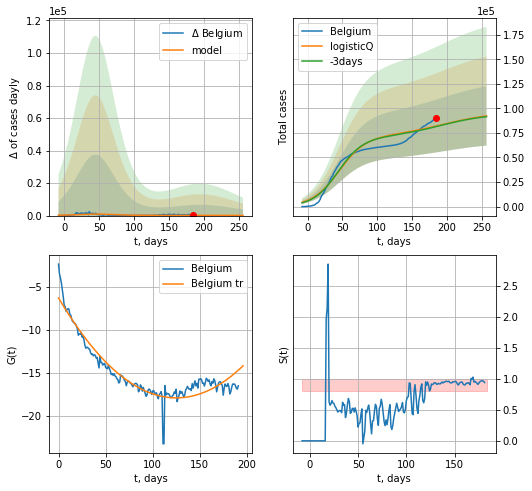

Belgium data at: 2020-09-09
+3 day model MAPE: 0.006792
model: logisticQ
coeffs: [ 7.13022496e+04  2.83985483e-08  4.49848272e+01 -1.83303720e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.327179
forecast at the end of period: +73 days
	 deltaDaycases: 93
	 total cases: 92297 ± 30197
	 total death: 10205 ± 10016
trend coefficient of determination: 0.902530
 intercept_: -6.29472821230371
 coeffs_: [ 0.         -0.18536929  0.00074055]


In [1037]:
x = forecastRRR('Belgium',dfBG[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

In [1038]:
dfBZ.tail()

,date,cases,active,death
193,2020-09-05,4123000.0,700068,126230.0
194,2020-09-06,4137606.0,693693,126686.0
195,2020-09-07,4147794.0,665229,127001.0
196,2020-09-08,4165124.0,640373,127517.0
197,2020-09-09,4199332.0,617343,128653.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


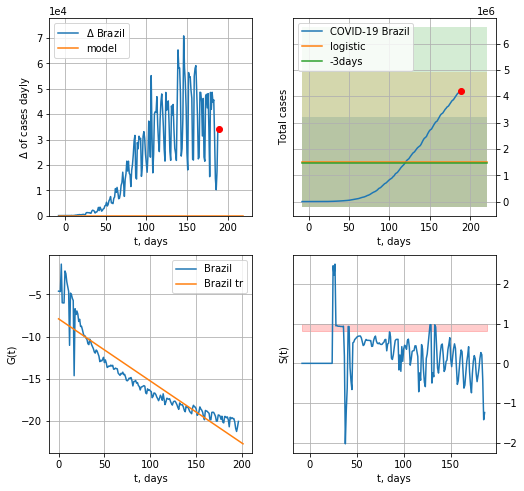

Brazil data at: 2020-09-09
+3 day model MAPE: 0.03903956848744118
model: logistic
coeffs:  [ 1.21164237e+06 -2.20244220e+01  5.30051342e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.1261529607225313
forecast at the end of period: +31 days
	 deltaDaycases:  0
	 total cases:  1514552 ± 1705618
	 total death:  46400 ± 156760
trend coefficient of determination: 0.853724
 intercept: -7.901274
 slope: -0.073690


In [1039]:
x = forecast('Brazil',dfBZ[:],d1,28*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


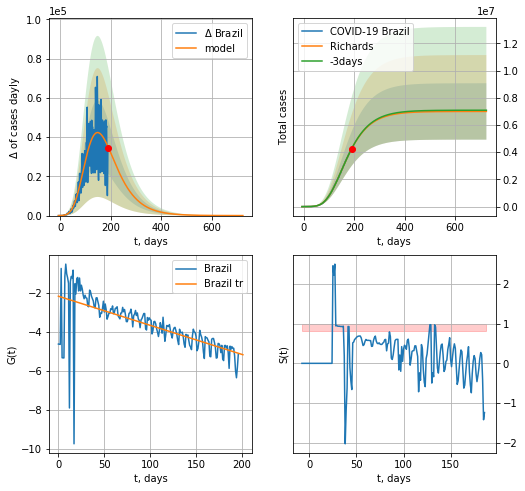

Brazil data at: 2020-09-09
+3 day model MAPE: 0.002711
model: Richards
coeffs: [ 6.99679261e+06  7.53412316e-01 -8.17463119e+01  2.20589479e-02]
rational stdev: 0.296077
forecast at the end of period: +535 days
	 deltaDaycases: 8
	 total cases: 6996307 ± 2071446
	 total death: 214342 ± 190385
trend coefficient of determination: 0.445198
 intercept: -2.162504
 slope: -0.014928


In [1040]:
x = forecastRR('Brazil',dfBZ[:],d1,100*7-dT,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Brazil',dfBZ[10:],d1,50*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


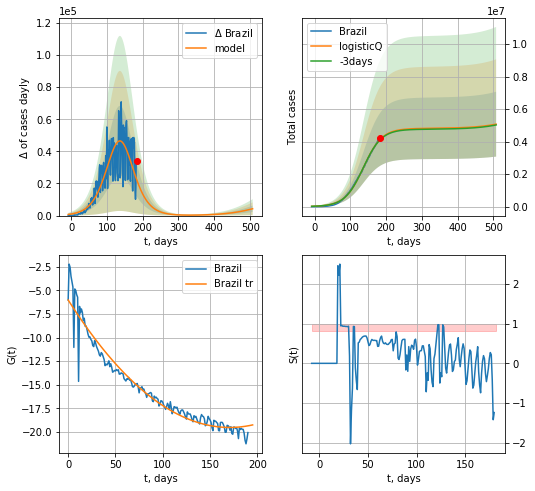

Brazil data at: 2020-09-09
+3 day model MAPE: 0.005731
model: logisticQ
coeffs: [ 4.81135576e+06  2.83906488e-07  1.36765059e+02 -1.36067534e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.393151
forecast at the end of period: +325 days
	 deltaDaycases: 4259
	 total cases: 5071750 ± 1993961
	 total death: 155380 ± 183263
trend coefficient of determination: 0.942378
 intercept_: -6.028315976872777
 coeffs_: [ 0.         -0.15794295  0.00046234]


In [1041]:
x = forecastRRR('Brazil',dfBZ[6:],d1,70*7-dT,addpred=True,xcoef=koreaCoeffs)

In [1042]:
#x = forecastRRR('Brazil',dfBZ[5:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

AS
           date    cases  active  death
203 2020-09-05  26278.0    3195  753.0
204 2020-09-06  26322.0    2958  762.0
205 2020-09-07  26373.0    2999  770.0
206 2020-09-08  26465.0    2821  781.0
207 2020-09-09  26513.0    2689  788.0


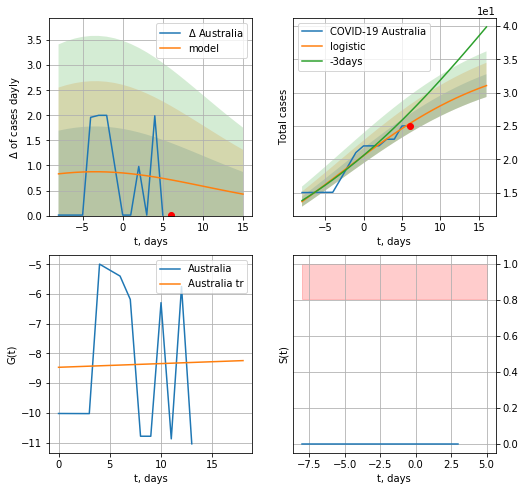

Australia data at: 2020-09-09
model: logistic
coeffs:  [35.98148465  0.0972901  -2.93370788]
rational stdev:  0.05518162900834631
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  31 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


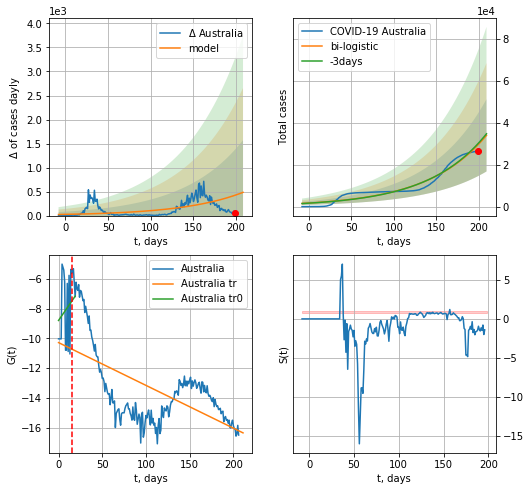

Australia data at: 2020-09-09
+3 day model MAPE: 0.01868679382766728
model: bi-logistic
coeffs:  [2.16973573e+07 1.43415471e-02 6.59157538e+02] [35.98148465  0.0972901  -2.93370788]
rational stdev:  0.5066136137055993
forecast at the end of period: +10 days
	 deltaDaycases:  483
	 total cases:  34072 ± 17261
	 total death:  1012 ± 1538
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.022779
 intercept: -8.785888
 slope: 0.086030
trend coefficient of determination: 0.362161
 intercept: -10.276507
 slope: -0.028797


In [1043]:
dfAS = read_df(pd.DataFrame(),"AS")
try:
    x = forecast('Australia',dfAS[:15],d1,T18*7-dT,pMAPE=False)
    xx = forecast2('Australia',dfAS[:],d1,T18*7-dT,x,vL=15,addpred=False,xcoef=[0.25/4,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


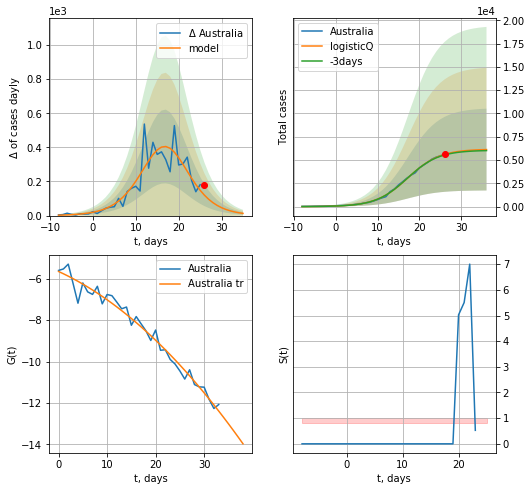

Australia data at: 2020-09-09
+3 day model MAPE: 0.012936
model: logisticQ
coeffs: [ 6.16826027e+03  4.63150668e-05  1.72354354e+01 -5.67232010e+03]
rational stdev: 0.716727
forecast at the end of period: +10 days
	 deltaDaycases: 12
	 total cases: 6125 ± 4390
	 total death: 182 ± 391
trend coefficient of determination: 0.975101
 intercept_: -5.657250296853678
 coeffs_: [ 0.         -0.10702975 -0.00294069]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


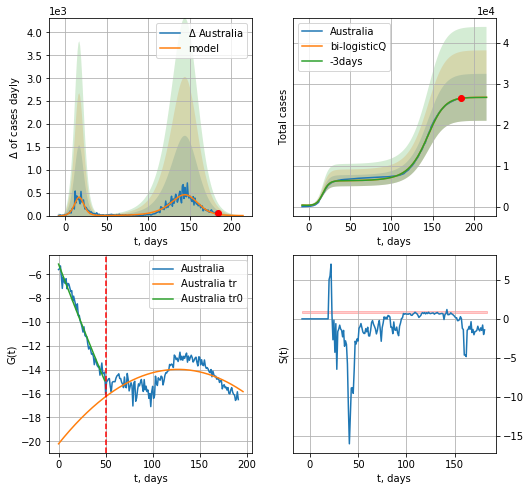

Australia data at: 2020-09-09
+3 day model MAPE: 0.000612
model: bi-logisticQ
coeffs: [ 2.05053332e+04  4.09793468e-04  1.42195989e+02 -7.28417869e+01]
rational stdev: 0.214478
forecast at the end of period: +31 days
	 deltaDaycases: 0
	 total cases: 26669 ± 5720
	 total death: 792 ± 509
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.978786
 intercept_: -5.1508340728883
 coeffs_: [ 0.00000000e+00 -2.09278795e-01  2.06303704e-04]
trend coefficient of determination: 0.315671
 intercept_: -20.205846805620855
 coeffs_: [ 0.          0.0984091  -0.00038823]


In [1044]:
#axcoef = [koreaCoeffs[0],koreaCoeffs[1],koreaCoeffs[2],koreaCoeffs[3]]
vL = 50
x = forecastRRR('Australia',dfAS[15:vL],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Australia',dfAS[15:],d1,28*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


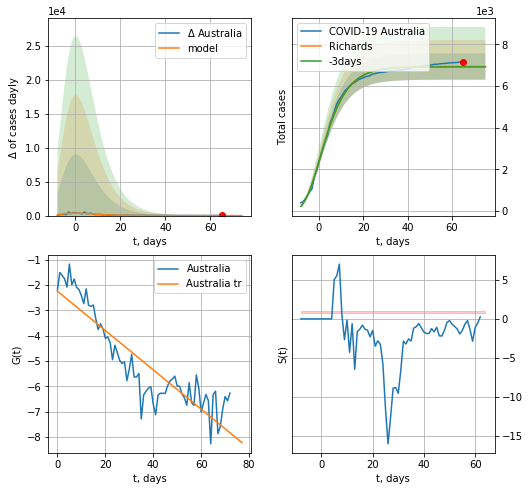

Australia data at: 2020-09-09
+3 day model MAPE: 0.002782
model: Richards
coeffs: [ 6.93376739e+03  1.41182137e+01 -3.14466269e+01  1.01384170e-02]
rational stdev: 0.091309
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 6933 ± 633
	 total death: 206 ± 56
trend coefficient of determination: 0.809708
 intercept: -2.241214
 slope: -0.077557


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


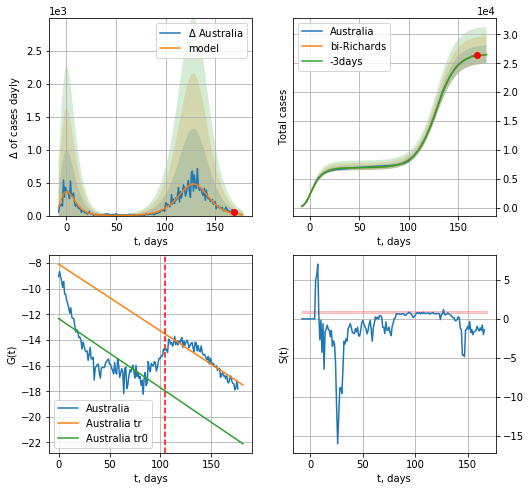

Australia data at: 2020-09-09
+3 day model MAPE: 0.002353
model: bi-Richards
coeffs: [1.97241331e+04 8.96064795e-02 1.29584366e+02 1.12967642e+00]
rational stdev: 0.059549
forecast at the end of period: +10 days
	 deltaDaycases: 12
	 total cases: 26541 ± 1580
	 total death: 788 ± 140
bi-Richards approximation splitting point: 104
trend coefficient of determination: 0.544999
 intercept: -12.326891
 slope: -0.054013
trend coefficient of determination: 0.834213
 intercept: -8.080725
 slope: -0.052147


In [1045]:
iL = 20+10
vL = 104+iL
x = forecastRR('Australia',dfAS[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Australia',dfAS[iL:],d1,25*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

ML
           date   cases  active  death
191 2020-09-05  9397.0     154  128.0
192 2020-09-06  9397.5     154  128.0
193 2020-09-07  9459.0     207  128.0
194 2020-09-08  9559.0     295  128.0
195 2020-09-09  9583.0     312  128.0


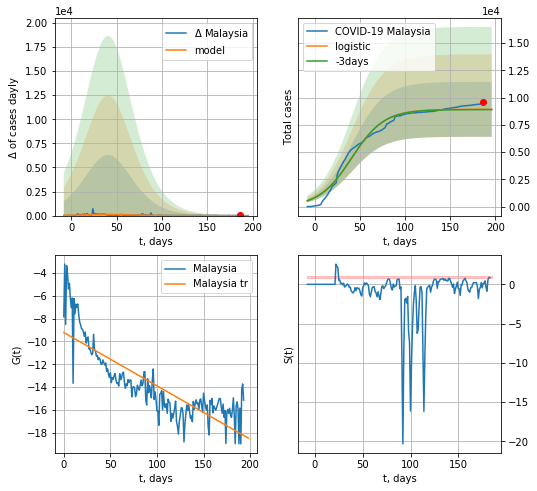

Malaysia data at: 2020-09-09
+3 day model MAPE: 0.0030097691851909717
model: logistic
coeffs:  [8.92864306e+03 5.55258052e-02 4.11299878e+01]
rational stdev:  0.28213611549718903
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  8926 ± 2518
	 total death:  119 ± 100
trend coefficient of determination: 0.693408
 intercept: -9.212579
 slope: -0.046822


In [1046]:
try:
    dfML = read_df(pd.DataFrame(),"ML")
    x = forecast('Malaysia',dfML[1:],d1,T18*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print ("Exception occurs")

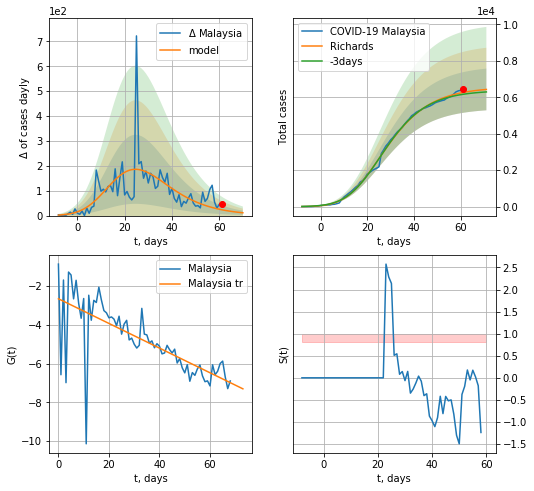

Malaysia data at: 2020-09-09
+3 day model MAPE: 0.016662
model: Richards
coeffs: [6.55737988e+03 3.88576721e-01 7.38244597e+00 2.20016068e-01]
rational stdev: 0.177893
forecast at the end of period: +10 days
	 deltaDaycases: 11
	 total cases: 6429 ± 1143
	 total death: 85 ± 45
trend coefficient of determination: 0.508700
 intercept: -2.652908
 slope: -0.063638


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


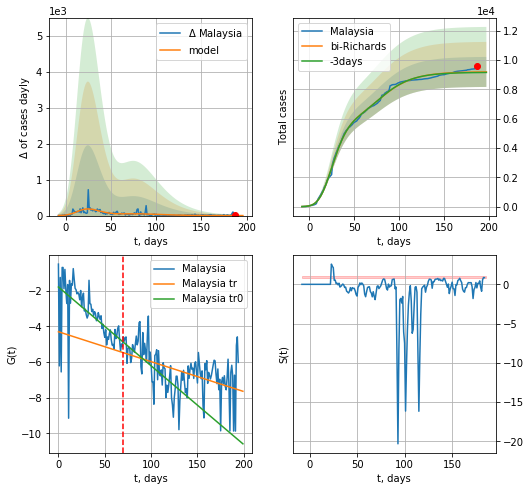

Malaysia data at: 2020-09-09
+3 day model MAPE: 0.003780
model: bi-Richards
coeffs: [ 2.64359673e+03  1.20132428e+01 -3.69493875e+01  3.91589485e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.111422
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 9189 ± 1023
	 total death: 122 ± 40
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.324094
 intercept: -1.800023
 slope: -0.044171
trend coefficient of determination: 0.229185
 intercept: -4.308354
 slope: -0.016761


In [1047]:
vL = 70
x = forecastRR('Malaysia',dfML[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Malaysia',dfML[:],d12f(1),T18*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


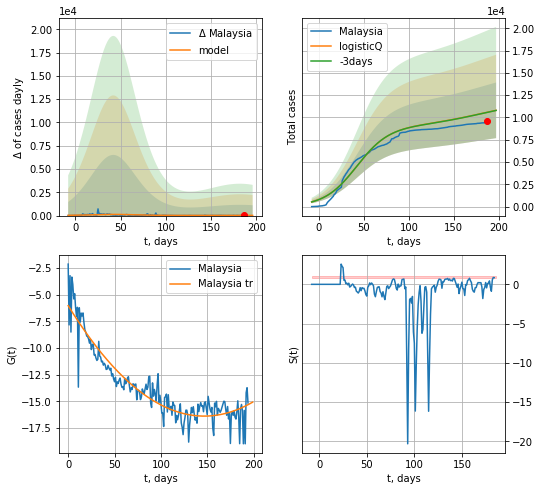

Malaysia data at: 2020-09-09
+3 day model MAPE: 0.001210
model: logisticQ
coeffs: [ 8.92632403e+03  7.25719339e-08  4.21280377e+01 -7.67201456e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.288699
forecast at the end of period: +10 days
	 deltaDaycases: 21
	 total cases: 10798 ± 3117
	 total death: 144 ± 124
trend coefficient of determination: 0.865943
 intercept_: -6.020111528768776
 coeffs_: [ 0.         -0.14126171  0.0004811 ]


In [1048]:
x = forecastRRR('Malaysia',dfML[:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs)

ZL
           date   cases  active  death
190 2020-09-05  1772.0     116   24.0
191 2020-09-06  1776.0     118   24.0
192 2020-09-07  1782.0     123   24.0
193 2020-09-08  1788.0     125   24.0
194 2020-09-09  1792.0     120   24.0


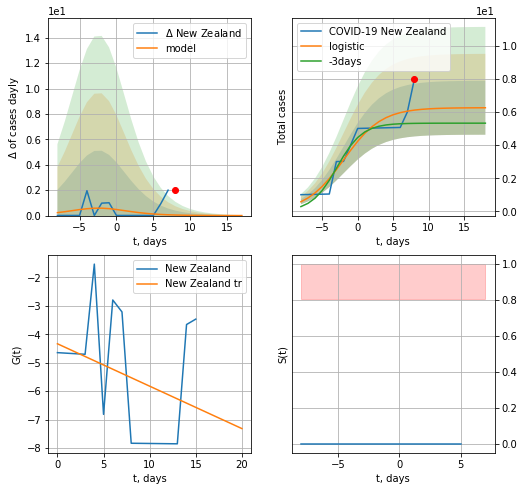

New Zealand data at: 2020-09-09
model: logistic
coeffs:  [ 6.26235964  0.37662733 -1.95315912]
rational stdev:  0.26005250706023997
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156


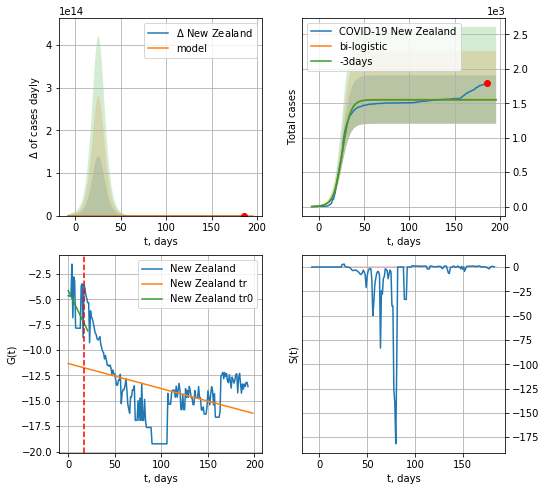

New Zealand data at: 2020-09-09
+3 day model MAPE: 0.0032624740219496405
model: bi-logistic
coeffs:  [1.54806624e+03 2.14680582e-01 2.57394262e+01] [ 6.26235964  0.37662733 -1.95315912]
rational stdev:  0.225980693063815
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  1554 ± 351
	 total death:  20 ± 13
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.175036
 intercept: -4.131936
 slope: -0.189301
trend coefficient of determination: 0.149657
 intercept: -11.324184
 slope: -0.024719


In [1049]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
try:
    x = forecast('New Zealand',dfZL[:vL],d1,T18*7-dT,pMAPE=False)
    xx = forecast2('New Zealand',dfZL[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#
except:
    print ("Exception occurs")

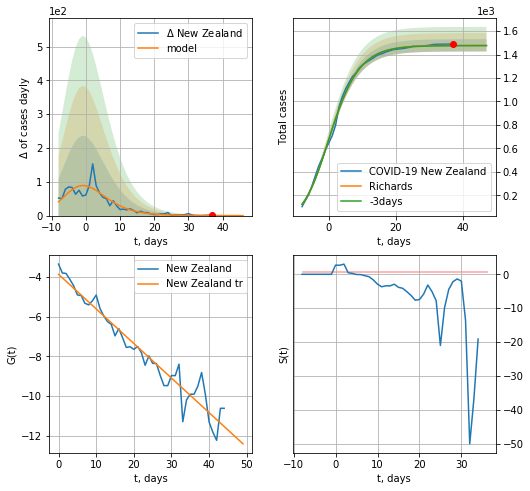

New Zealand data at: 2020-09-09
+3 day model MAPE: 0.001934
model: Richards
coeffs: [ 1.47843037e+03  4.42667510e-01 -4.31586094e+00  4.51659797e-01]
rational stdev: 0.035414
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 1478 ± 52
	 total death: 19 ± 2
trend coefficient of determination: 0.938751
 intercept: -3.882685
 slope: -0.173595


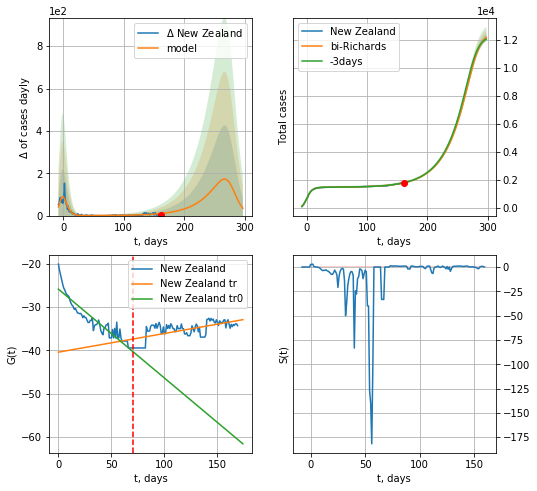

New Zealand data at: 2020-09-09
+3 day model MAPE: 0.002744
model: bi-Richards
coeffs: [1.10107901e+04 3.00722831e-02 2.78859298e+02 3.76213315e+00]
rational stdev: 0.020406
forecast at the end of period: +136 days
	 deltaDaycases: 34
	 total cases: 12175 ± 248
	 total death: 163 ± 9
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.864557
 intercept: -25.856517
 slope: -0.205402
trend coefficient of determination: 0.405747
 intercept: -40.414548
 slope: 0.043142


In [1050]:
iL = 24
vL = 70+iL
x = forecastRR('New Zealand',dfZL[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('New Zealand',dfZL[iL:],d1,43*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


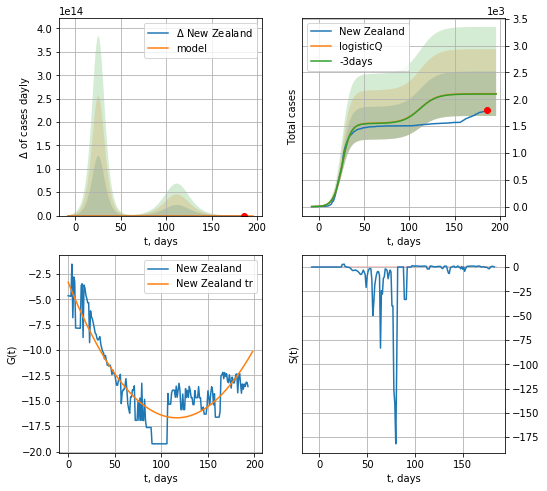

New Zealand data at: 2020-09-09
+3 day model MAPE: 0.003254
model: logisticQ
coeffs: [ 1.55448377e+03  8.45279044e-07  2.56914069e+01 -2.51609702e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.196984
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 2104 ± 414
	 total death: 28 ± 16
trend coefficient of determination: 0.798382
 intercept_: -3.3195572480458093
 coeffs_: [ 0.         -0.22926731  0.00098399]


In [1051]:
x = forecastRRR('New Zealand',dfZL[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

BR
           date    cases  active  death
190 2020-09-05  72663.0     115  705.0
191 2020-09-06  72859.0     284  711.0
192 2020-09-07  73031.0     432  716.0
193 2020-09-08  73208.0     571  721.0
194 2020-09-09  73402.0     677  726.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


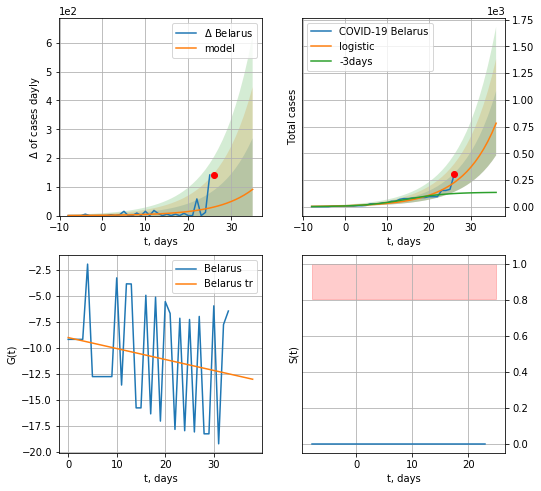

Belarus data at: 2020-09-09
+3 day model MAPE: 1.0426305188408567
model: logistic
coeffs:  [1.42197385e+06 1.24002039e-01 9.65328876e+01]
rational stdev:  0.3845289039536378
forecast at the end of period: +10 days
	 deltaDaycases:  91
	 total cases:  781 ± 300
	 total death:  7 ± 8
trend coefficient of determination: 0.039182
 intercept: -9.040329
 slope: -0.105417


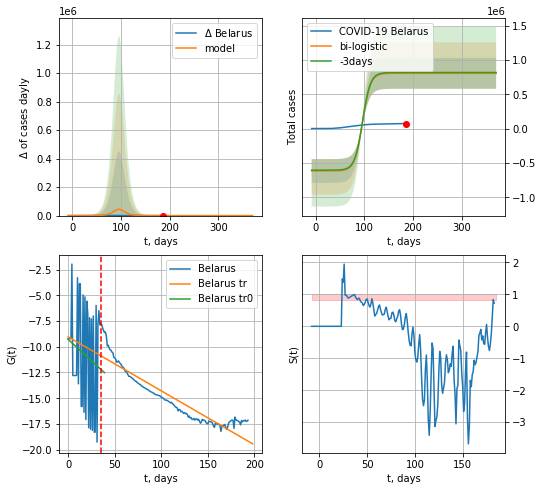

Belarus data at: 2020-09-09
+3 day model MAPE: 0.01400389366740185
model: bi-logistic
coeffs:  [-6.17539486e+05  1.42498906e+01 -3.22421903e+02] [1.42197385e+06 1.24002039e-01 9.65328876e+01]
rational stdev:  0.2799929593967994
forecast at the end of period: +185 days
	 deltaDaycases:  0
	 total cases:  804434 ± 225235
	 total death:  7956 ± 6682
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.026128
 intercept: -9.289300
 slope: -0.082783
trend coefficient of determination: 0.859198
 intercept: -9.035554
 slope: -0.052486


In [1052]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:35],d1,7*T18-dT)
xx = forecast2('Belarus',dfBR[:],d1,50*7-dT,x,addpred=False,xcoef=[0.25,1.,1.8],vL=35)

BR
           date    cases  active  death
190 2020-09-05  72663.0     115  705.0
191 2020-09-06  72859.0     284  711.0
192 2020-09-07  73031.0     432  716.0
193 2020-09-08  73208.0     571  721.0
194 2020-09-09  73402.0     677  726.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


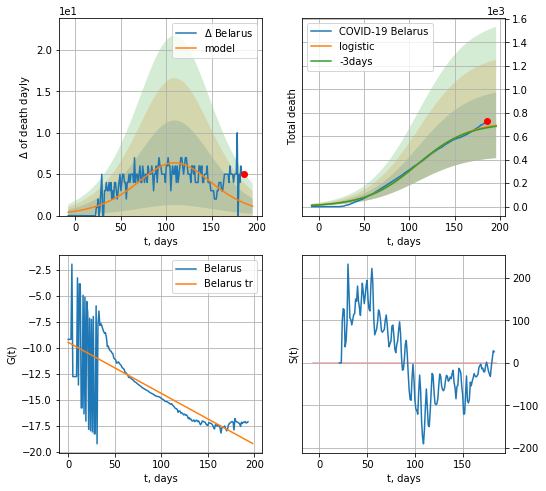

Belarus data at: 2020-09-09
+3 day model MAPE: 0.011326535063683542
model: logistic
coeffs:  [7.26814603e+02 3.51246093e-02 1.09636813e+02]
rational stdev:  0.4033857087994823
forecast at the end of period: +10 days
	 total death:  693 ± 279
trend coefficient of determination: 0.577195
 intercept: -9.496386
 slope: -0.049148


In [1053]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:],d1,T18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


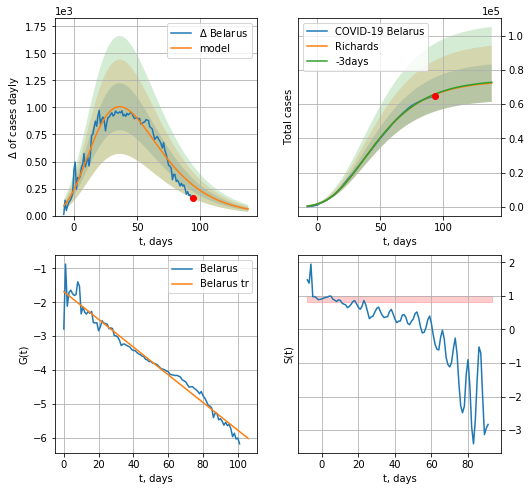

Belarus data at: 2020-09-09
+3 day model MAPE: 0.003895
model: Richards
coeffs: [ 7.39400828e+04  2.08941690e+00 -7.10697110e+01  1.78759875e-02]
rational stdev: 0.151367
forecast at the end of period: +45 days
	 deltaDaycases: 60
	 total cases: 72339 ± 10949
	 total death: 715 ± 324
trend coefficient of determination: 0.968921
 intercept: -1.685593
 slope: -0.040947


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


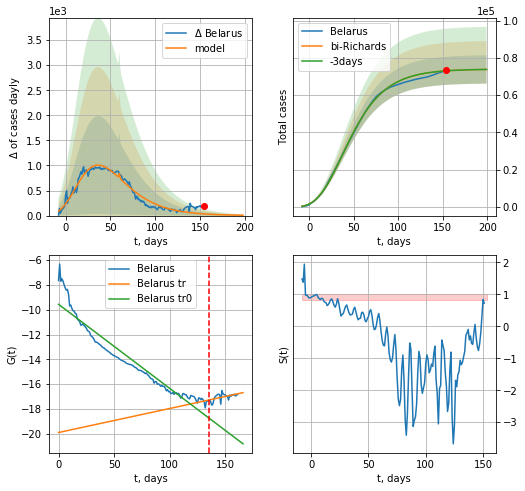

Belarus data at: 2020-09-09
+3 day model MAPE: 0.000000
model: bi-Richards
coeffs: [-126.90295512   -3.64871923   60.58098419    0.97217383]
rational stdev: 0.103109
forecast at the end of period: +45 days
	 deltaDaycases: 6
	 total cases: 73768 ± 7606
	 total death: 729 ± 225
bi-Richards approximation splitting point: 135
trend coefficient of determination: 0.920261
 intercept: -9.565954
 slope: -0.067706
trend coefficient of determination: 0.281814
 intercept: -19.894523
 slope: 0.019355


In [1054]:
iL=32
vL = 135+iL
x = forecastRR('Belarus',dfBR[iL:vL-iL],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Belarus',dfBR[iL:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastRRR('Belarus',dfBR[iL:],d1,30*7-dT,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


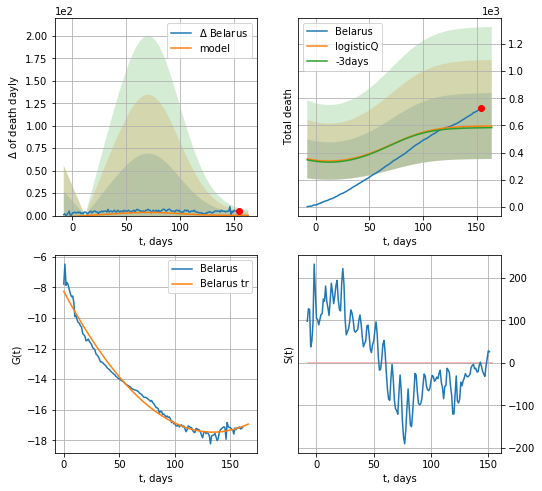

Belarus data at: 2020-09-09
+3 day model MAPE: 0.020871
model: logisticQ
coeffs: [5.03909091e+02 3.07909816e-04 2.23070543e+01 1.29919060e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.408665
forecast at the end of period: +10 days
	 total death: 596 ± 243
trend coefficient of determination: 0.982578
 intercept_: -8.269988458767086
 coeffs_: [ 0.         -0.13722663  0.00051219]


In [1055]:
x = forecastRRR('Belarus',dfBR[32:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

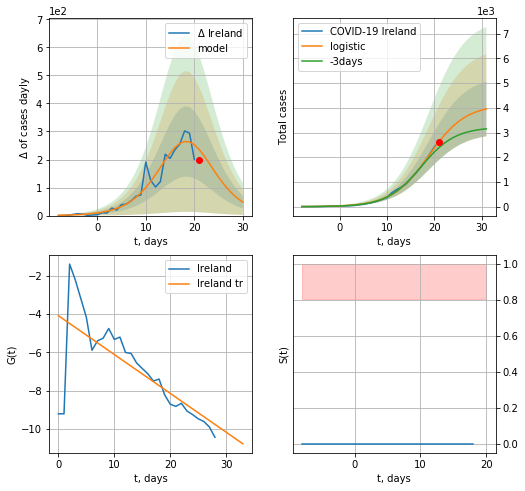

Ireland data at: 2020-09-09
+3 day model MAPE: 0.12282208937722881
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +10 days
	 deltaDaycases:  47
	 total cases:  3954 ± 1106
	 total death:  233 ± 195
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


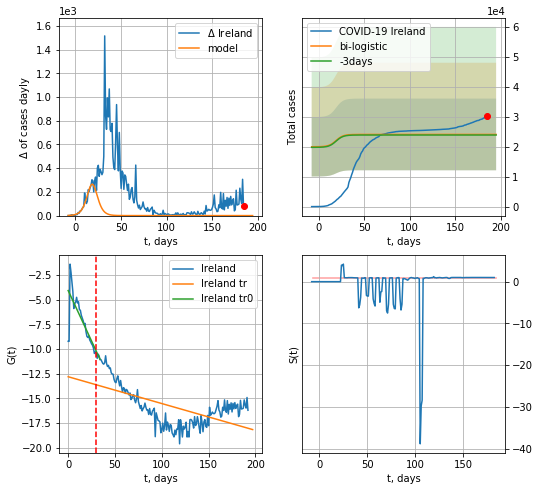

Ireland data at: 2020-09-09
+3 day model MAPE: 0.008118289792373536
model: bi-logistic
coeffs:  [ 1.59884968e+04 -1.21892588e+01  3.04128761e+02] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.49654288987673756
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  24112 ± 11973
	 total death:  1423 ± 2119
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.363456
 intercept: -12.797228
 slope: -0.027179


In [1056]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,T18*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


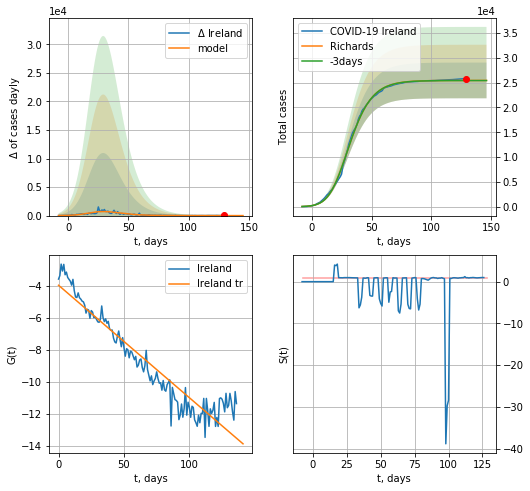

Ireland data at: 2020-09-09
+3 day model MAPE: 0.000894
model: Richards
coeffs: [2.54407353e+04 2.28847737e-01 1.92916171e+01 3.96517588e-01]
rational stdev: 0.141278
forecast at the end of period: +17 days
	 deltaDaycases: 0
	 total cases: 25440 ± 3594
	 total death: 1502 ± 636
trend coefficient of determination: 0.901596
 intercept: -3.946012
 slope: -0.070416


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


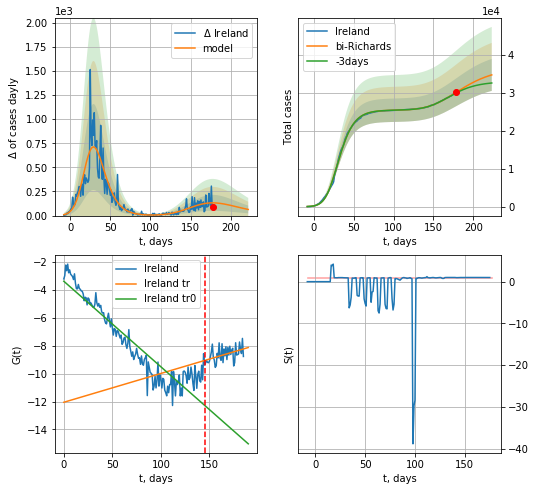

Ireland data at: 2020-09-09
+3 day model MAPE: 0.005659
model: bi-Richards
coeffs: [1.12501156e+04 1.29896668e-01 1.42975225e+02 2.79408986e-01]
rational stdev: 0.121369
forecast at the end of period: +45 days
	 deltaDaycases: 63
	 total cases: 34736 ± 4215
	 total death: 2050 ± 746
bi-Richards approximation splitting point: 145
trend coefficient of determination: 0.868998
 intercept: -3.368002
 slope: -0.061392
trend coefficient of determination: 0.207651
 intercept: -12.052360
 slope: 0.020679


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


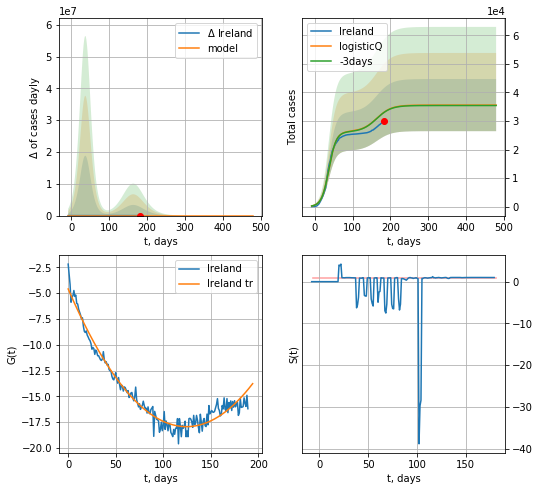

Ireland data at: 2020-09-09
+3 day model MAPE: 0.001826
model: logisticQ
coeffs: [ 2.62646801e+04  2.66192916e-07  3.75834591e+01 -3.87079720e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.256723
forecast at the end of period: +297 days
	 deltaDaycases: 0
	 total cases: 35566 ± 9130
	 total death: 2100 ± 1617
trend coefficient of determination: 0.965746
 intercept_: -4.603609474676876
 coeffs_: [ 0.         -0.21424643  0.00086078]


In [1057]:
ivL = 7
vL = 145 +ivL
x = forecastRR('Ireland',dfIR[ivL:vL-ivL],d1,26*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Ireland',dfIR[ivL:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-ivL)
x = forecastRRR('Ireland',dfIR[3:],d1,66*7-dT,addpred=True,xcoef=koreaCoeffs)

CL
           date   cases  active    death
186 2020-09-05  420434   15916  11551.0
187 2020-09-06  422510   16519  11592.0
188 2020-09-07  424274   16905  11652.0
189 2020-09-08  425541   16129  11682.0
190 2020-09-09  427027   15770  11702.0


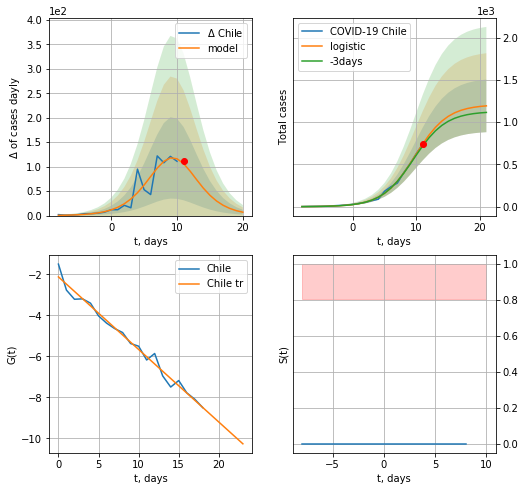

Chile data at: 2020-09-09
+3 day model MAPE: 0.03908993891192624
model: logistic
coeffs:  [1.20759839e+03 3.93191843e-01 9.80781865e+00]
rational stdev:  0.2610672451056305
forecast at the end of period: +10 days
	 deltaDaycases:  6
	 total cases:  1192 ± 311
	 total death:  32 ± 25
trend coefficient of determination: 0.982168
 intercept: -2.127319
 slope: -0.354074


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


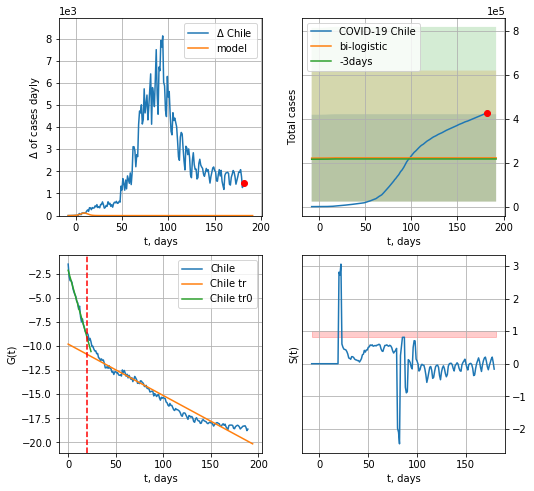

Chile data at: 2020-09-09
+3 day model MAPE: 0.022726806462760634
model: bi-logistic
coeffs:  [ 1.76823248e+05 -3.58371969e+01  8.60021839e+02] [1.20759839e+03 3.93191843e-01 9.80781865e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.8960949186697653
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  222236 ± 199145
	 total death:  6090 ± 16371
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.984051
 intercept: -2.144368
 slope: -0.351232
trend coefficient of determination: 0.941106
 intercept: -9.805031
 slope: -0.053319


In [1058]:
vL=20
dfCL = read_df(pd.DataFrame(),"CL")
x = forecast('Chile',dfCL[:vL],d1,7*T18-dT)
xx = forecast2('Chile',dfCL[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


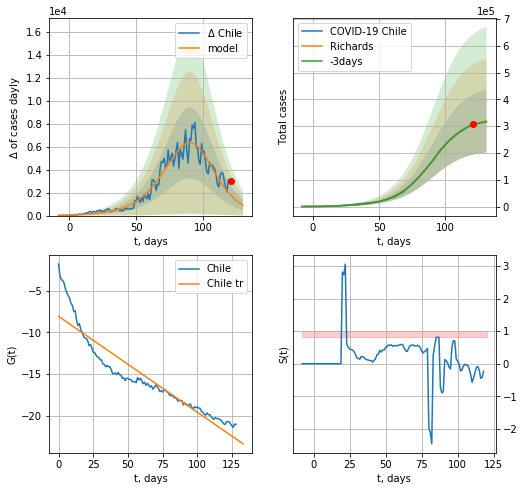

Chile data at: 2020-09-09
+3 day model MAPE: 0.006062
model: Richards
coeffs: [3.29740872e+05 6.47237974e-02 9.37490232e+01 1.29835958e+00]
rational stdev: 0.366980
forecast at the end of period: +10 days
	 deltaDaycases: 899
	 total cases: 319054 ± 117086
	 total death: 8743 ± 9625
trend coefficient of determination: 0.871763
 intercept: -8.084056
 slope: -0.114797


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: RuntimeWarning: overflow encountered in power


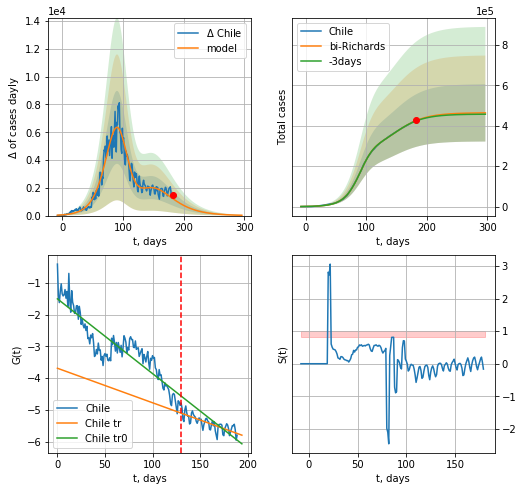

Chile data at: 2020-09-09
+3 day model MAPE: 0.003773
model: bi-Richards
coeffs: [1.34349212e+05 3.71836429e+00 3.08583561e+01 1.00645332e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.305646
forecast at the end of period: +115 days
	 deltaDaycases: 23
	 total cases: 463460 ± 141655
	 total death: 12700 ± 11645
bi-Richards approximation splitting point: 130
trend coefficient of determination: 0.819175
 intercept: -1.507165
 slope: -0.023474
trend coefficient of determination: 0.588012
 intercept: -3.687576
 slope: -0.010834


In [1059]:
vL = 130
x = forecastRR('Chile',dfCL[:vL],d1,25*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Chile',dfCL[:],d1,40*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastRRR('Chile',dfCL[:],d1,24*7-dT,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


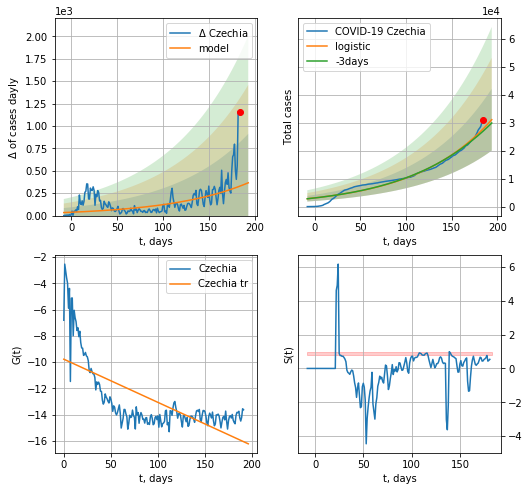

Czechia data at: 2020-09-09
+3 day model MAPE: 0.030307151844171112
model: logistic
coeffs:  [1.01431528e+07 1.18788455e-02 6.81023993e+02]
rational stdev:  0.35565832672884323
forecast at the end of period: +10 days
	 deltaDaycases:  365
	 total cases:  31068 ± 11049
	 total death:  444 ± 473
trend coefficient of determination: 0.480758
 intercept: -9.776160
 slope: -0.032896


In [1060]:
x = forecast('Czechia',dfCH[:],d1,T18*7-dT,shift=1.,addpred=False,xcoef=[0.25,1.,2.4])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


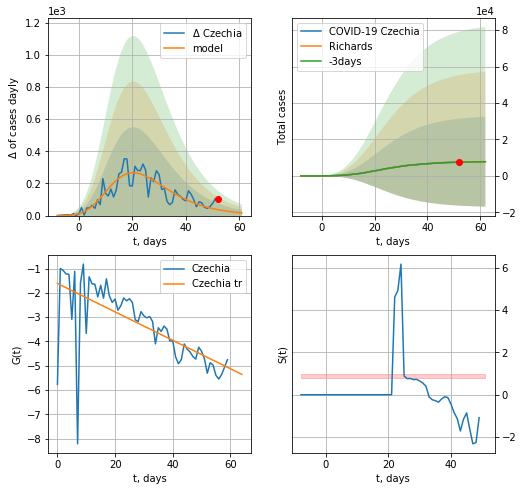

Czechia data at: 2020-09-09
+3 day model MAPE: 0.007833
model: Richards
coeffs: [ 7.98936803e+03  1.90705450e+00 -1.17115779e+01  4.87276061e-02]
rational stdev: 3.153640
forecast at the end of period: +10 days
	 deltaDaycases: 16
	 total cases: 7817 ± 24653
	 total death: 111 ± 1050
trend coefficient of determination: 0.449013
 intercept: -1.614151
 slope: -0.058413


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


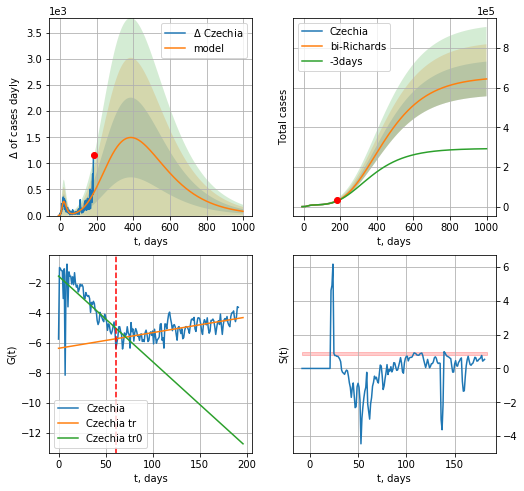

Czechia data at: 2020-09-09
+3 day model MAPE: 0.026535
model: bi-Richards
coeffs: [ 6.48269962e+05  1.95414334e-01 -1.50964215e+02  3.26045554e-02]
rational stdev: 0.135907
forecast at the end of period: +815 days
	 deltaDaycases: 81
	 total cases: 643319 ± 87431
	 total death: 9203 ± 3752
bi-Richards approximation splitting point: 61
trend coefficient of determination: 0.446316
 intercept: -1.545986
 slope: -0.057019
trend coefficient of determination: 0.444471
 intercept: -6.356807
 slope: 0.010442


In [1062]:
vL= 61
x = forecastRR('Czechia',dfCH[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Czechia',dfCH[:],d1,140*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastRRR('Czechia',dfCH[:],d1,60*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:86: RuntimeWarning: overflow encountered in exp


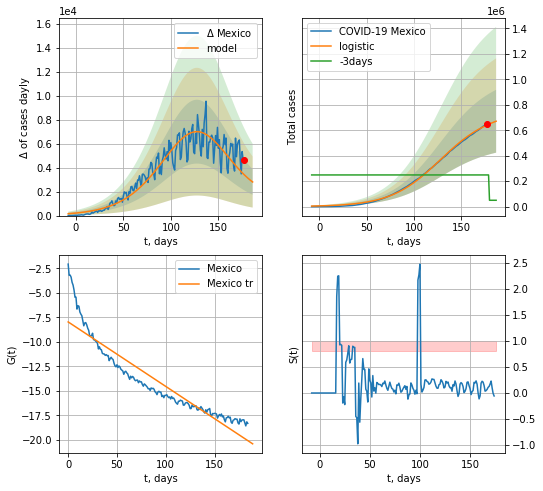

Mexico data at: 2020-09-09
+3 day model MAPE: 1.5857030957548024
model: logistic
coeffs:  [7.25382219e+05 3.83841984e-02 1.27432180e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3681383576033747
forecast at the end of period: +10 days
	 deltaDaycases:  2807
	 total cases:  670946 ± 247001
	 total death:  71596 ± 79071
trend coefficient of determination: 0.863825
 intercept: -7.974348
 slope: -0.065750


In [1063]:
x = forecast('Mexico',dfMX[:],d1,T18*7-dT,addpred=True,xcoef=[.25,1.,2.])#

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


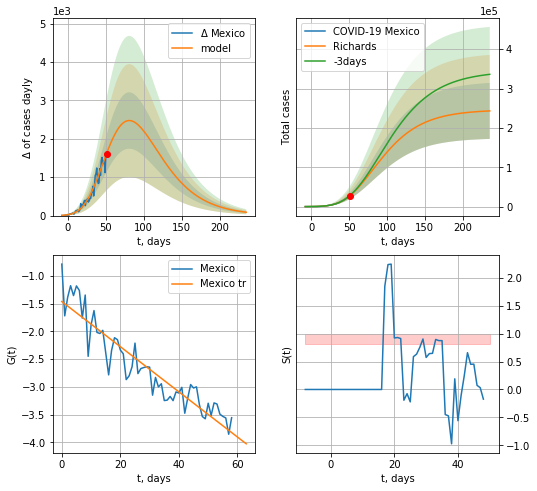

Mexico data at: 2020-09-09
+3 day model MAPE: 0.013781
model: Richards
coeffs: [ 2.46197399e+05  4.05650878e-01 -1.28761086e+01  6.97244909e-02]
rational stdev: 0.292607
forecast at the end of period: +185 days
	 deltaDaycases: 87
	 total cases: 243121 ± 71139
	 total death: 25943 ± 22773
trend coefficient of determination: 0.864363
 intercept: -1.463809
 slope: -0.040682


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


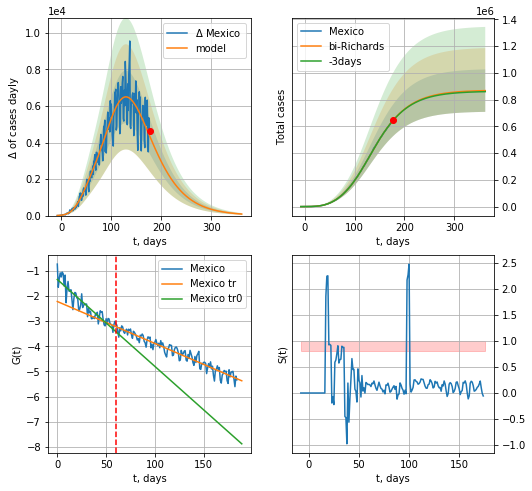

Mexico data at: 2020-09-09
+3 day model MAPE: 0.001763
model: bi-Richards
coeffs: [ 6.24777880e+05  7.85446349e-01 -1.19824644e+01  2.96541265e-02]
rational stdev: 0.183064
forecast at the end of period: +185 days
	 deltaDaycases: 83
	 total cases: 867425 ± 158794
	 total death: 92562 ± 50834
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.837362
 intercept: -1.343914
 slope: -0.034565
trend coefficient of determination: 0.921105
 intercept: -2.219842
 slope: -0.016675


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


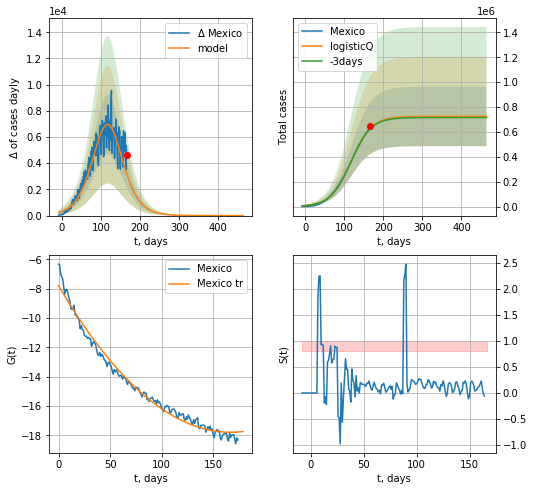

Mexico data at: 2020-09-09
+3 day model MAPE: 0.006992
model: logisticQ
coeffs: [ 7.25696599e+05  3.06726529e-07  1.17465024e+02 -1.24892108e+05]
rational stdev: 0.330132
forecast at the end of period: +297 days
	 deltaDaycases: 0
	 total cases: 725695 ± 239575
	 total death: 77438 ± 76694
trend coefficient of determination: 0.983877
 intercept_: -7.795023458717514
 coeffs_: [ 0.         -0.11977333  0.00035892]


In [1064]:
vL = 60
x = forecastRR('Mexico',dfMX[:vL],d1,50*7-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RR('Mexico',dfMX[:],d1,50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRRR('Mexico',dfMX[10:],d1,66*7-dT,addpred=False,xcoef=koreaCoeffs)#

LT
           date   cases  active  death     tests
180 2020-09-05  3083.0    1043   86.0  663899.0
181 2020-09-06  3100.0    1059   86.0  666930.0
182 2020-09-07  3131.0    1051   86.0  671297.0
183 2020-09-08  3163.0    1069   86.0  676600.0
184 2020-09-09  3199.0    1083   86.0  682097.0


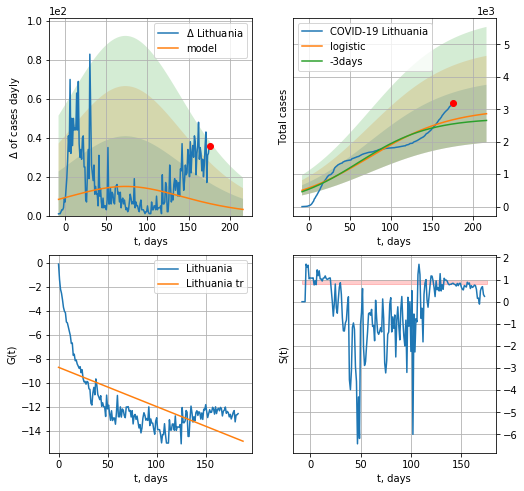

Lithuania data at: 2020-09-09
+3 day model MAPE: 0.05130130280478053
model: logistic
coeffs:  [3.03206304e+03 1.97893735e-02 7.37151133e+01]
rational stdev:  0.3114742486741348
forecast at the end of period: +41 days
	 deltaDaycases:  3
	 total cases:  2863 ± 892
	 total death:  77 ± 71
trend coefficient of determination: 0.410591
 intercept: -8.702200
 slope: -0.032727


In [1065]:
vL = 1
dfLT = read_df(pd.DataFrame(),"LT")
try:
    x = forecast('Lithuania',dfLT[:],d1,6*7-1)
except:
    print("Exception occurs")
#xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

In [1066]:
#dfLT = read_df(pd.DataFrame(),"LT")
#plt.plot(range(len(dfLT[3:])),dfLT[3:].cases/dfLT[3:].tests)

#plt.grid()#

In [1067]:
#np.diff(dfLT["cases"])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


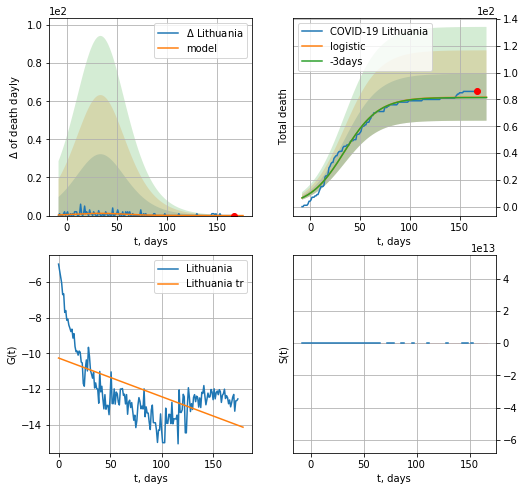

Lithuania data at: 2020-09-09
+3 day model MAPE: 0.0025461897825074247
model: logistic
coeffs:  [8.16583663e+01 5.75835762e-02 3.43175231e+01]
rational stdev:  0.21446279052701936
forecast at the end of period: +10 days
	 total death:  81 ± 17
trend coefficient of determination: 0.347195
 intercept: -10.265215
 slope: -0.021655


In [1068]:
x = forecast('Lithuania',dfLT[9:],d1,7*T18-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


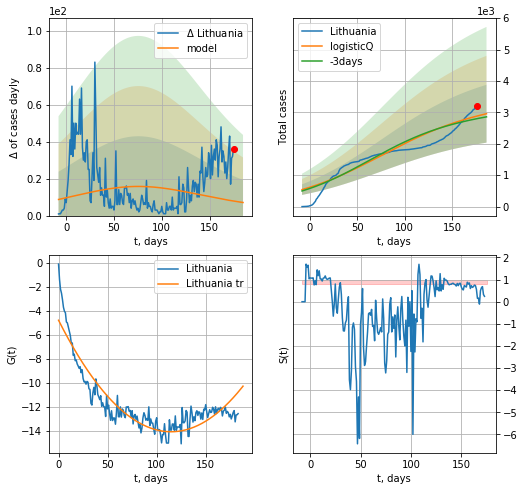

Lithuania data at: 2020-09-09
+3 day model MAPE: 0.030193
model: logisticQ
coeffs: [ 3.03186258e+03  2.71327951e-08  7.37108167e+01 -7.29098509e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.311464
forecast at the end of period: +10 days
	 deltaDaycases: 7
	 total cases: 2957 ± 921
	 total death: 80 ± 74
trend coefficient of determination: 0.842264
 intercept_: -4.781331777562404
 coeffs_: [ 0.         -0.1619868   0.00070634]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


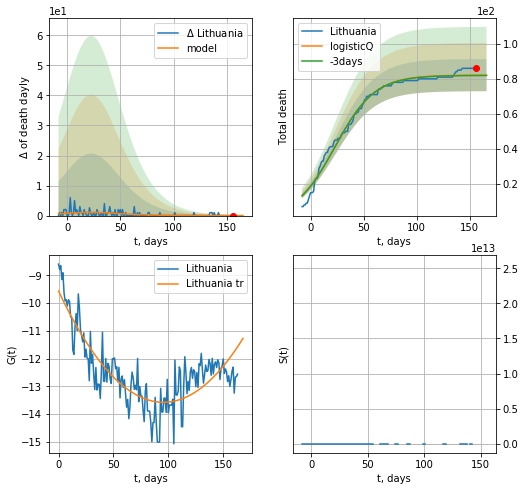

Lithuania data at: 2020-09-09
+3 day model MAPE: 0.002459
model: logisticQ
coeffs: [ 8.21629089e+01  1.71177245e-07  2.30369850e+01 -3.10373406e+05]
rational stdev: 0.111814
forecast at the end of period: +10 days
	 total death: 82 ± 9
trend coefficient of determination: 0.704939
 intercept_: -9.564265347030352
 coeffs_: [ 0.         -0.08395391  0.00043929]


In [1069]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
x = forecastRRR('Lithuania',dfLT[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Lithuania',dfLT[20:],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


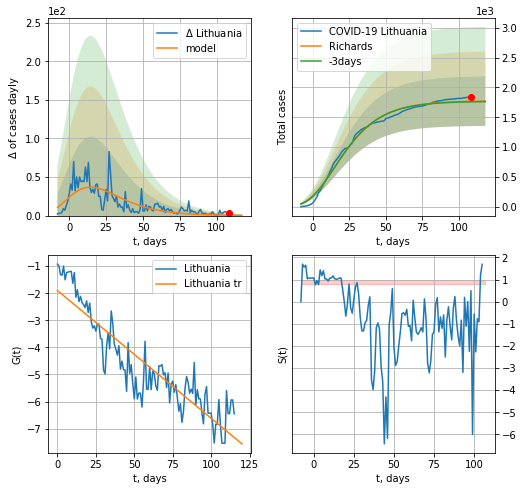

Lithuania data at: 2020-09-09
+3 day model MAPE: 0.004317
model: Richards
coeffs: [ 1.77501763e+03  1.31639926e+01 -8.14596876e+01  4.29803165e-03]
rational stdev: 0.234279
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 1769 ± 414
	 total death: 48 ± 33
trend coefficient of determination: 0.820394
 intercept: -1.897700
 slope: -0.047186


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


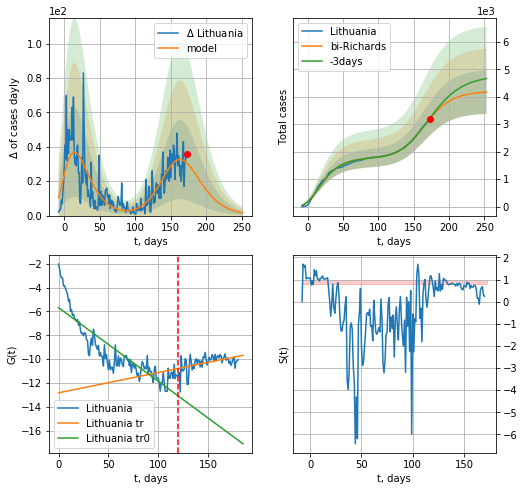

Lithuania data at: 2020-09-09
+3 day model MAPE: 0.007894
model: bi-Richards
coeffs: [2.42414725e+03 7.02407575e-02 1.56186692e+02 6.92483373e-01]
rational stdev: 0.189684
forecast at the end of period: +80 days
	 deltaDaycases: 1
	 total cases: 4167 ± 790
	 total death: 113 ± 64
bi-Richards approximation splitting point: 120
trend coefficient of determination: 0.760711
 intercept: -5.688495
 slope: -0.061765
trend coefficient of determination: 0.225708
 intercept: -12.835214
 slope: 0.017052


In [1070]:
iL = 3
vL =120+iL
x = forecastRR('Lithuania',dfLT[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RR('Lithuania',dfLT[iL:],d1,35*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)#
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

In [1071]:
#dfLT['cases'].values
#x = forecastRR('Lithuania',dfLT[130:],d1,30*7-dT,addpred=False)#

In [1072]:
#x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
           date   cases  active  death
182 2020-09-05  6896.0       0  124.0
183 2020-09-06  6950.0     700  124.0
184 2020-09-07  6960.0     580  124.0
185 2020-09-08  6974.0     594  124.0
186 2020-09-09  7023.0     607  124.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


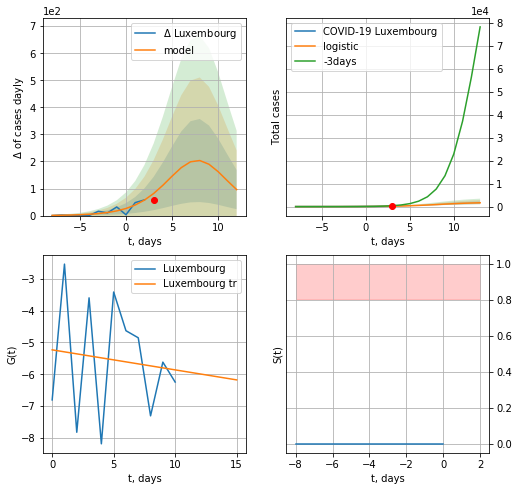

Luxembourg data at: 2020-09-09
model: logistic
coeffs:  [1.87757966e+03 4.36654344e-01 8.24919508e+00]
rational stdev:  0.35795936969501296
forecast at the end of period: +10 days
	 deltaDaycases:  96
	 total cases:  1668 ± 597
	 total death:  29 ± 31
trend coefficient of determination: 0.012091
 intercept: -5.231862
 slope: -0.063083


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


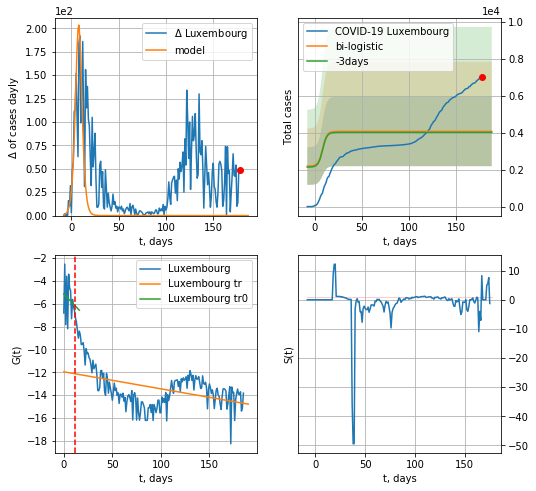

Luxembourg data at: 2020-09-09
+3 day model MAPE: 0.014400661045126455
model: bi-logistic
coeffs:  [1953.76963646  -11.37247129  302.79478971] [1.87757966e+03 4.36654344e-01 8.24919508e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.4624524851049563
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  4075 ± 1884
	 total death:  71 ± 98
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.030158
 intercept: -5.146907
 slope: -0.088569
trend coefficient of determination: 0.185056
 intercept: -11.953418
 slope: -0.014892


In [1073]:
try:
    dfLX = read_df(pd.DataFrame(),"LX")
    x = forecast("Luxembourg",dfLX[:12],d1,T18*7-dT,pMAPE=False)
    xx = forecast2("Luxembourg",dfLX[:],d1,T18*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


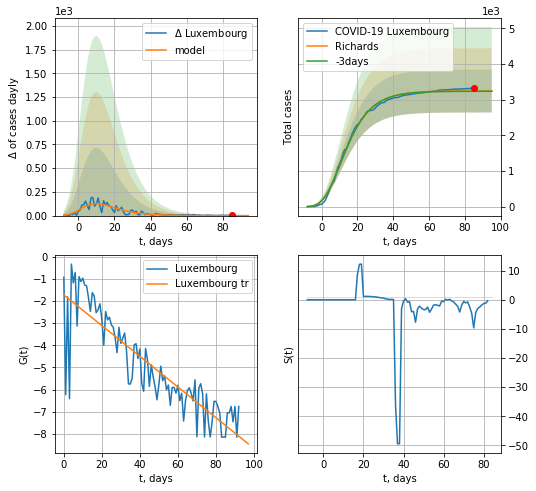

Luxembourg data at: 2020-09-09
+3 day model MAPE: 0.002007
model: Richards
coeffs: [ 3.24138545e+03  2.02715004e+01 -3.96622957e+01  5.18542030e-03]
rational stdev: 0.184858
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 3240 ± 599
	 total death: 57 ± 31
trend coefficient of determination: 0.764532
 intercept: -1.723997
 slope: -0.069294


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


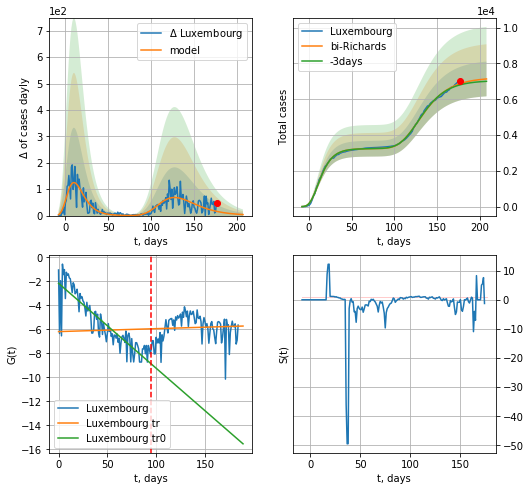

Luxembourg data at: 2020-09-09
+3 day model MAPE: 0.010208
model: bi-Richards
coeffs: [3.96826341e+03 6.41829259e-01 7.48440449e+01 7.60113244e-02]
rational stdev: 0.135882
forecast at the end of period: +31 days
	 deltaDaycases: 3
	 total cases: 7131 ± 969
	 total death: 125 ± 50
bi-Richards approximation splitting point: 95
trend coefficient of determination: 0.782422
 intercept: -2.152840
 slope: -0.070798
trend coefficient of determination: 0.003612
 intercept: -6.179586
 slope: 0.002449


In [1074]:
iL=1
vL = 105+iL-10
x = forecastRR("Luxembourg",dfLX[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Luxembourg",dfLX[iL:],d1,28*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


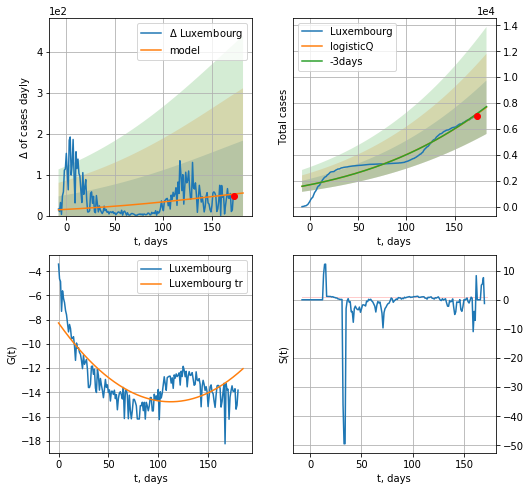

Luxembourg data at: 2020-09-09
+3 day model MAPE: 0.004504
model: logisticQ
coeffs: [ 3.03062786e+04  4.21730626e-07  2.94526115e+02 -2.27889766e+04]
rational stdev: 0.268961
forecast at the end of period: +10 days
	 deltaDaycases: 55
	 total cases: 7680 ± 2065
	 total death: 135 ± 108
trend coefficient of determination: 0.574040
 intercept_: -8.272307475930123
 coeffs_: [ 0.         -0.11595068  0.00051644]


In [1075]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)

ED
           date     cases   active    death
189 2020-09-05  108975.0   9017.0   6724.0
190 2020-09-06  109784.0   8018.0  10524.0
191 2020-09-07  110092.0   8274.0  10576.0
192 2020-09-08  110757.0   8888.0  10627.0
193 2020-09-09  112166.0  10223.0  10701.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


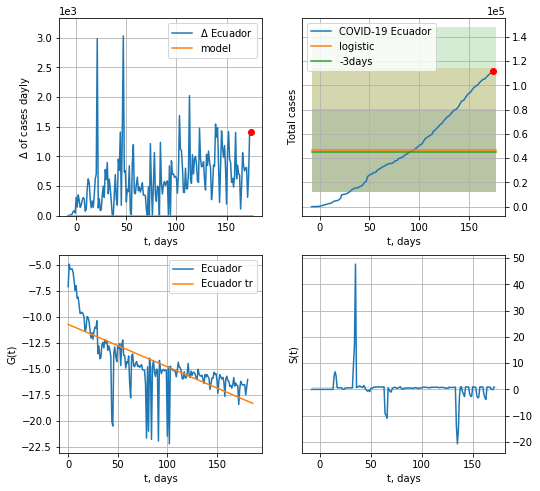

Ecuador data at: 2020-09-09
+3 day model MAPE: 0.023808185100824508
model: logistic
coeffs:  [ 4.63433760e+04 -8.76932609e+00  2.29955691e+02]
rational stdev:  0.7320913711090228
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  46343 ± 33927
	 total death:  4421 ± 9709
trend coefficient of determination: 0.496259
 intercept: -10.712324
 slope: -0.040802


In [1076]:
dfED = read_df(pd.DataFrame(),"ED")
x = forecast("Ecuador",dfED[11:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


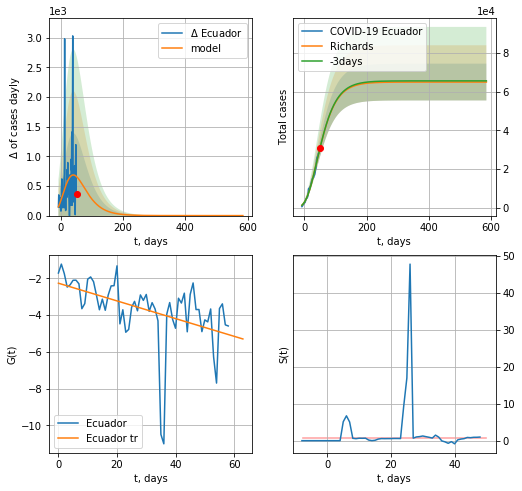

Ecuador data at: 2020-09-09
+3 day model MAPE: 0.001443
model: Richards
coeffs: [ 6.49031363e+04  1.85787235e+00 -1.03613231e+02  1.55703468e-02]
rational stdev: 0.146273
forecast at the end of period: +535 days
	 deltaDaycases: 0
	 total cases: 64903 ± 9493
	 total death: 6191 ± 2716
trend coefficient of determination: 0.218364
 intercept: -2.268609
 slope: -0.048096


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


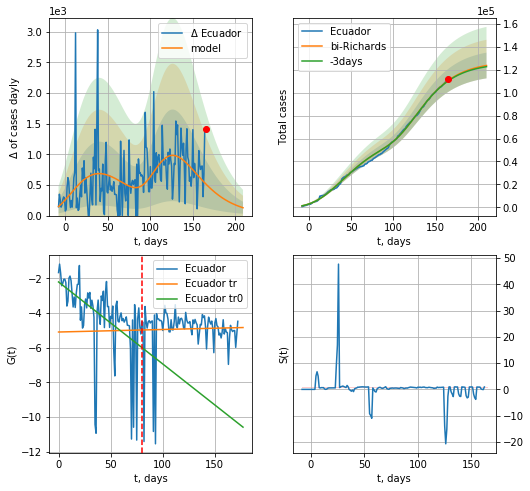

Ecuador data at: 2020-09-09
+3 day model MAPE: 0.003592
model: bi-Richards
coeffs: [6.24050534e+04 4.15710701e+00 2.39939639e+00 8.91429794e-03]
rational stdev: 0.090707
forecast at the end of period: +45 days
	 deltaDaycases: 128
	 total cases: 123720 ± 11222
	 total death: 11803 ± 3211
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.273401
 intercept: -2.212593
 slope: -0.047277
trend coefficient of determination: 0.000935
 intercept: -5.097587
 slope: 0.001455


In [1077]:
vL = 80+20
x = forecastRR("Ecuador",dfED[20:vL-20],d1,100*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Ecuador",dfED[20:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


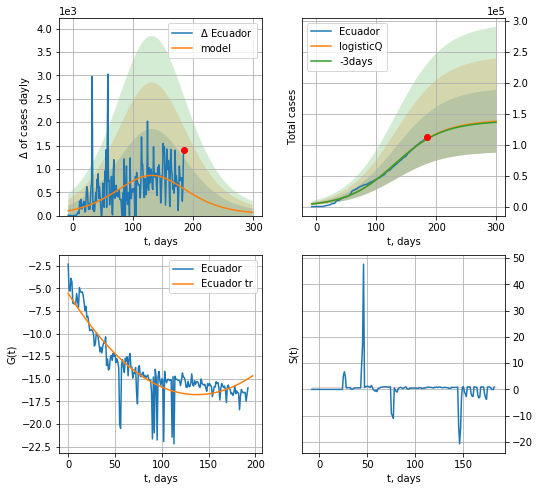

Ecuador data at: 2020-09-09
+3 day model MAPE: 0.005269
model: logisticQ
coeffs: [ 1.38396605e+05  1.06594066e-07  1.31539743e+02 -2.32766254e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.368248
forecast at the end of period: +115 days
	 deltaDaycases: 70
	 total cases: 137886 ± 50776
	 total death: 13154 ± 14531
trend coefficient of determination: 0.777416
 intercept_: -5.544472708983884
 coeffs_: [ 0.         -0.16296714  0.00059219]


In [1078]:
x = forecastRRR("Ecuador",dfED[:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

FI
           date   cases  active  death
193 2020-09-05  8291.0     605  336.0
194 2020-09-06  8327.0     641  336.0
195 2020-09-07  8327.5     641  336.0
196 2020-09-08  8337.0     651  336.0
197 2020-09-09  8430.0     593  337.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


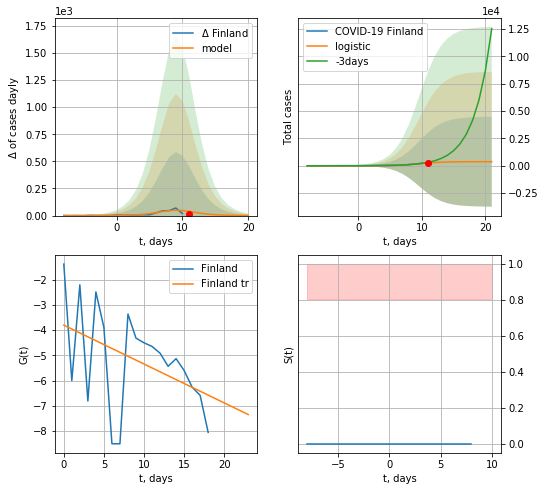

Finland data at: 2020-09-09
+3 day model MAPE: 0.3536795630191518
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  372 ± 4106
	 total death:  14 ± 463
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962


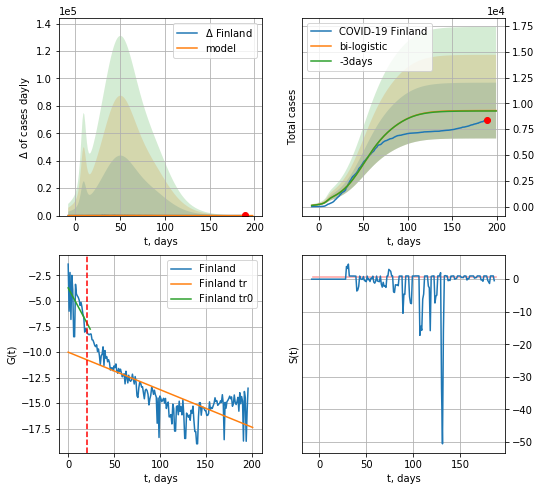

Finland data at: 2020-09-09
+3 day model MAPE: 0.00426390136594227
model: bi-logistic
coeffs:  [7.14368425e+03 7.10593639e-02 4.94620367e+01] [373.20900186   0.53490302   9.59276199]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.29042764218710204
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  9301 ± 2701
	 total death:  371 ± 323
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.234981
 intercept: -3.717136
 slope: -0.168257
trend coefficient of determination: 0.587456
 intercept: -10.015664
 slope: -0.036678


In [1079]:
try:
    dfFI = read_df(pd.DataFrame(),"FI")
    vL=20
    x = forecast("Finland",dfFI[:vL],d1,7*T18-dT)
    xx = forecast2("Finland",dfFI[:],d1,T18*7-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


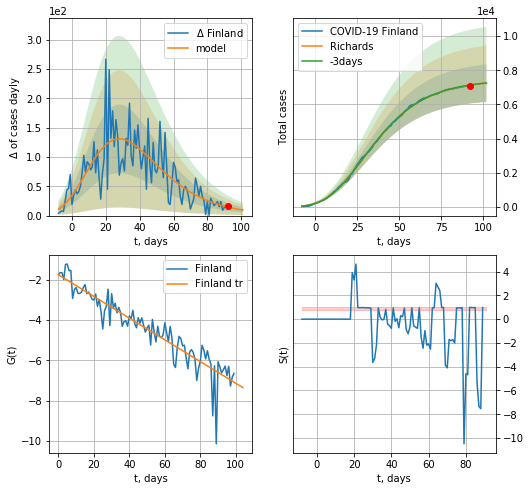

Finland data at: 2020-09-09
+3 day model MAPE: 0.001115
model: Richards
coeffs: [ 7.44184304e+03  7.14884094e-01 -2.55188087e+01  6.92679823e-02]
rational stdev: 0.151514
forecast at the end of period: +10 days
	 deltaDaycases: 9
	 total cases: 7250 ± 1098
	 total death: 289 ± 131
trend coefficient of determination: 0.862147
 intercept: -1.759889
 slope: -0.053817


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


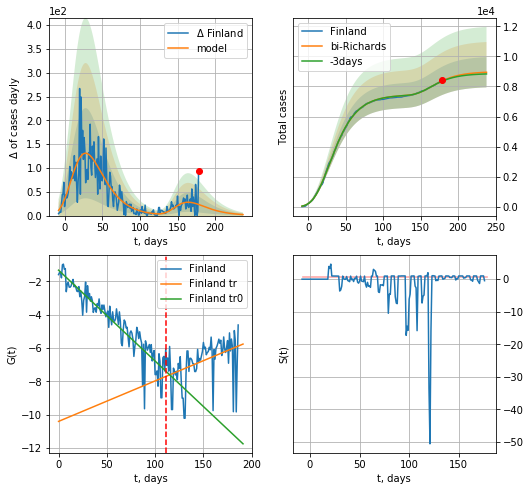

Finland data at: 2020-09-09
+3 day model MAPE: 0.002676
model: bi-Richards
coeffs: [1.54398075e+03 4.21933961e+00 7.40668970e+01 1.16223617e-02]
rational stdev: 0.112360
forecast at the end of period: +59 days
	 deltaDaycases: 2
	 total cases: 8943 ± 1004
	 total death: 357 ± 120
bi-Richards approximation splitting point: 111
trend coefficient of determination: 0.869154
 intercept: -1.324649
 slope: -0.054514
trend coefficient of determination: 0.175329
 intercept: -10.392122
 slope: 0.024273


In [1082]:
vL = 86 + 10 + 25
x = forecastRR("Finland",dfFI[10:vL-10],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Finland",dfFI[10:],d1,32*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10)

In [1084]:
#x = forecastRRR("Finland",dfFI[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

BL
           date  cases  active  death
179 2020-09-05  17050  4247.0  671.0
180 2020-09-06  17089  4256.0  676.0
181 2020-09-07  17146  4280.0  677.0
182 2020-09-08  17313  4324.0  692.0
183 2020-09-09  17435  4259.0  702.0


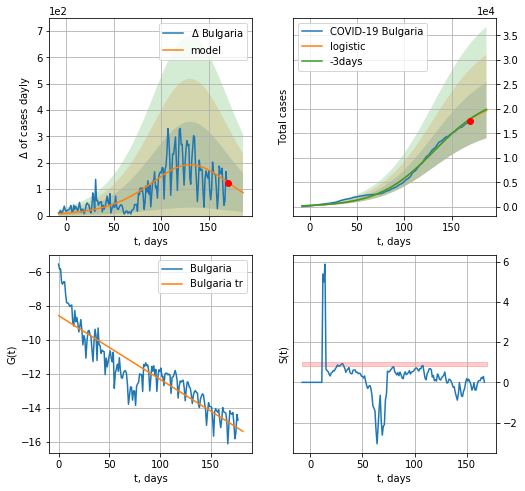

Bulgaria data at: 2020-09-09
+3 day model MAPE: 0.008396089570060288
model: logistic
coeffs:  [2.25579199e+04 3.41575508e-02 1.30838057e+02]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.2891088711593643
forecast at the end of period: +17 days
	 deltaDaycases:  87
	 total cases:  19670 ± 5686
	 total death:  791 ± 686
trend coefficient of determination: 0.808730
 intercept: -8.586659
 slope: -0.037408


In [1085]:
dfBL = read_df(pd.DataFrame(),"BL").fillna(0)
try:
    x = forecast('Bulgaria',dfBL[5:],d1,26*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


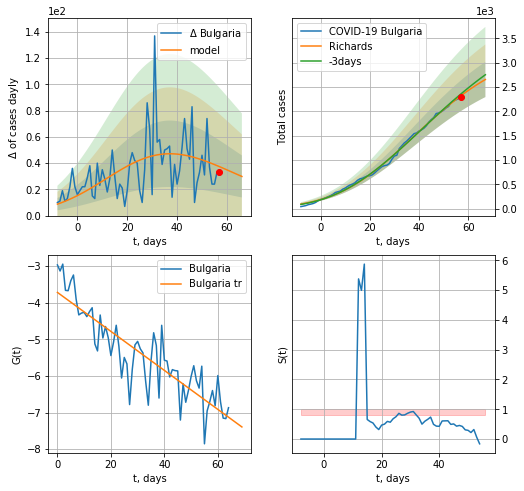

Bulgaria data at: 2020-09-09
+3 day model MAPE: 0.017233
model: Richards
coeffs: [3.47700846e+03 1.26494247e-01 1.24704401e+01 3.39632264e-01]
rational stdev: 0.135837
forecast at the end of period: +10 days
	 deltaDaycases: 29
	 total cases: 2654 ± 360
	 total death: 106 ± 43
trend coefficient of determination: 0.758376
 intercept: -3.716233
 slope: -0.053312


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


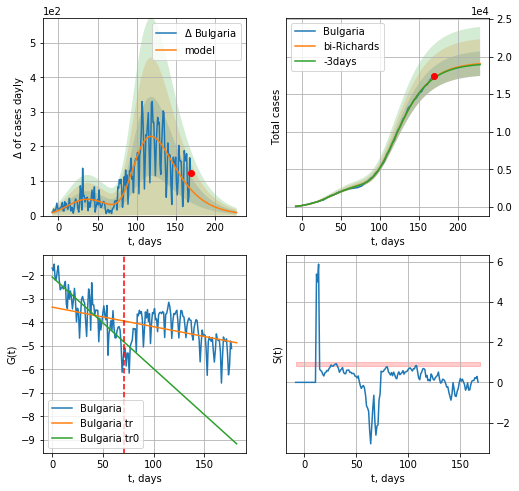

Bulgaria data at: 2020-09-09
+3 day model MAPE: 0.003544
model: bi-Richards
coeffs: [1.57993886e+04 2.50178181e+00 1.30128634e+01 1.55982296e-02]
rational stdev: 0.085568
forecast at the end of period: +59 days
	 deltaDaycases: 8
	 total cases: 19055 ± 1630
	 total death: 767 ± 196
bi-Richards approximation splitting point: 71
trend coefficient of determination: 0.675997
 intercept: -2.066481
 slope: -0.039048
trend coefficient of determination: 0.116807
 intercept: -3.350869
 slope: -0.008341


In [1086]:
vL = 71+5
x = forecastRR('Bulgaria',dfBL[5:vL-5],d1,T18*7-dT,shift=1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bulgaria',dfBL[5:],d1,32*7-dT,x,shift=1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


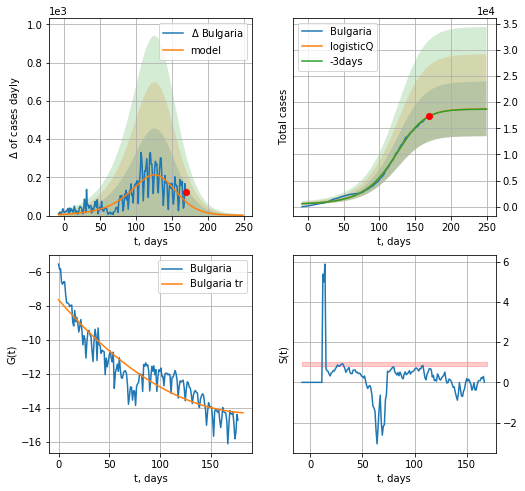

Bulgaria data at: 2020-09-09
+3 day model MAPE: 0.001653
model: logisticQ
coeffs: [ 1.86049634e+04  1.42616725e-04  1.20389468e+02 -1.94747867e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.278829
forecast at the end of period: +80 days
	 deltaDaycases: 1
	 total cases: 18707 ± 5216
	 total death: 753 ± 629
trend coefficient of determination: 0.847921
 intercept_: -7.65638718640491
 coeffs_: [ 0.         -0.06912216  0.00017918]


In [1087]:
x = forecastRRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=True,xcoef=koreaCoeffs)

TH
           date   cases  active  death
191 2020-09-05  3444.0   105.0   58.0
192 2020-09-06  3445.0   106.0   58.0
193 2020-09-07  3446.0   104.0   58.0
194 2020-09-08  3447.0   103.0   58.0
195 2020-09-09  3454.0    86.0   58.0


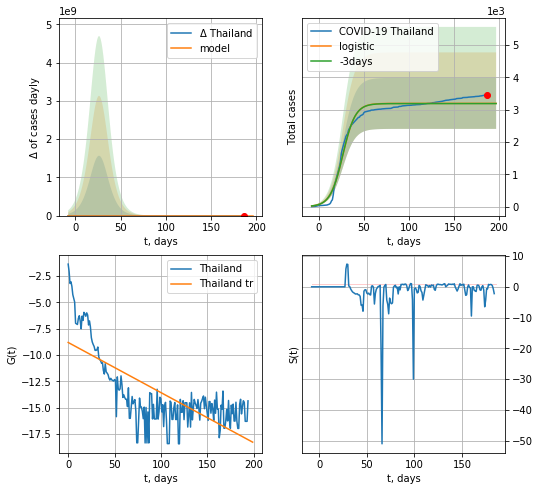

Thailand data at: 2020-09-09
+3 day model MAPE: 0.0018835607025707943
model: logistic
coeffs:  [3.19669337e+03 1.43748118e-01 2.66075024e+01]
rational stdev:  0.2468854102713707
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  3196 ± 789
	 total death:  53 ± 39
trend coefficient of determination: 0.543622
 intercept: -8.813549
 slope: -0.047484


In [1088]:
dfTH = read_df(pd.DataFrame(),"TH")
dfTH = dfTH.fillna(0)
try:
    x = forecast("Thailand",dfTH[:],d1,T18*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print("Exception occurs")
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [1089]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


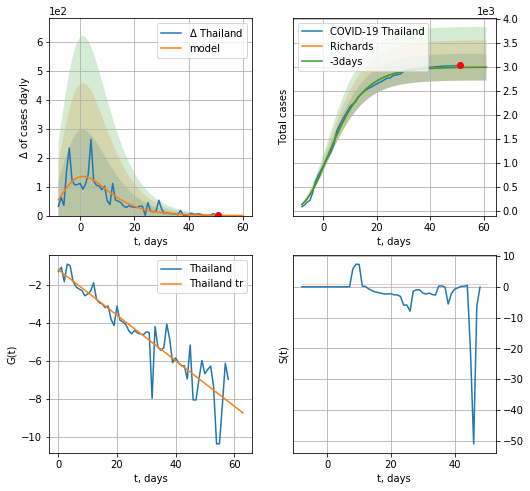

Thailand data at: 2020-09-09
+3 day model MAPE: 0.001958
model: Richards
coeffs: [ 2.99625224e+03  1.57427901e+01 -3.79340304e+01  7.81992540e-03]
rational stdev: 0.093292
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 2994 ± 279
	 total death: 50 ± 13
trend coefficient of determination: 0.845848
 intercept: -1.208254
 slope: -0.119672


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


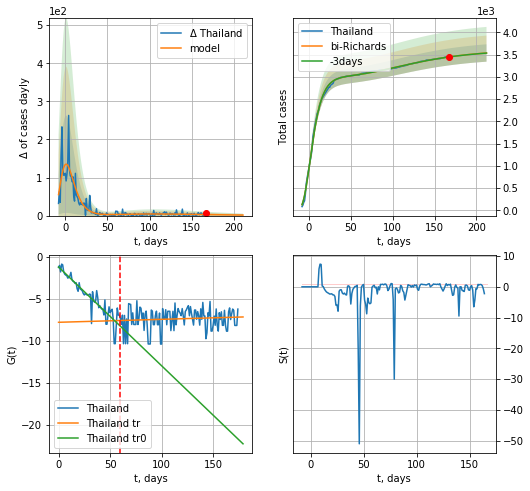

Thailand data at: 2020-09-09
+3 day model MAPE: 0.000304
model: bi-Richards
coeffs: [ 6.18144418e+02  2.87067705e+00 -1.60189196e+02  6.57906075e-03]
rational stdev: 0.055283
forecast at the end of period: +45 days
	 deltaDaycases: 1
	 total cases: 3536 ± 195
	 total death: 59 ± 9
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.843234
 intercept: -1.240830
 slope: -0.117521
trend coefficient of determination: 0.008831
 intercept: -7.823949
 slope: 0.003536


In [1090]:
vL = 80
x = forecastRR("Thailand",dfTH[20:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Thailand",dfTH[20:],d12f(1),30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


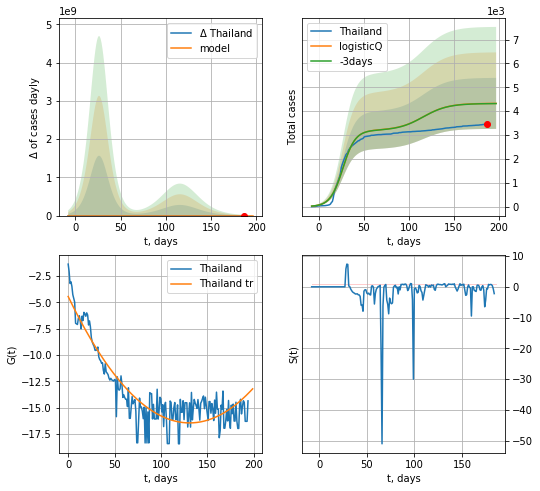

Thailand data at: 2020-09-09
+3 day model MAPE: 0.001815
model: logisticQ
coeffs: [ 3.19670188e+03  3.03427115e-07  2.66082859e+01 -4.73539385e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.246988
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 4325 ± 1068
	 total death: 72 ± 53
trend coefficient of determination: 0.841749
 intercept_: -4.455155307631461
 coeffs_: [ 0.         -0.18297898  0.00069843]


In [1091]:
x = forecastRRR("Thailand",dfTH[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


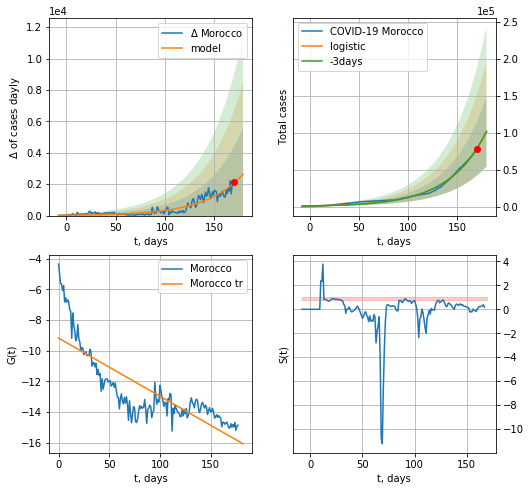

Morocco data at: 2020-09-09
+3 day model MAPE: 0.0011538718148700017
model: logistic
coeffs:  [1.32442649e+08 2.63331878e-02 4.52401503e+02]
rational stdev:  0.4640677385520798
forecast at the end of period: +10 days
	 deltaDaycases:  2635
	 total cases:  101487 ± 47097
	 total death:  1893 ± 2635
trend coefficient of determination: 0.668561
 intercept: -9.182627
 slope: -0.037817


In [1092]:
x = forecast("Morocco",dfMR[5:],d1,T18*7-dT)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


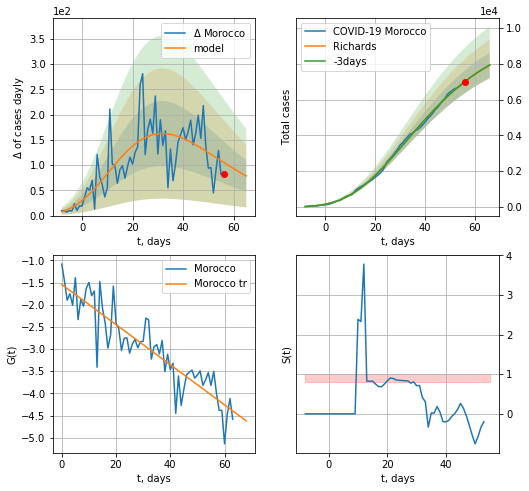

Morocco data at: 2020-09-09
+3 day model MAPE: 0.002854
model: Richards
coeffs: [ 9.80051535e+03  2.80051836e+00 -5.84633428e+01  1.62270604e-02]
rational stdev: 0.090760
forecast at the end of period: +10 days
	 deltaDaycases: 78
	 total cases: 7903 ± 717
	 total death: 147 ± 40
trend coefficient of determination: 0.815717
 intercept: -1.543258
 slope: -0.045268


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


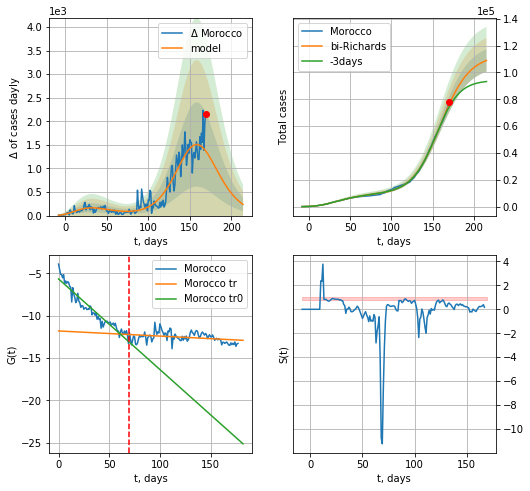

Morocco data at: 2020-09-09
+3 day model MAPE: 0.028613
model: bi-Richards
coeffs: [1.03453512e+05 6.48858493e-02 1.56069529e+02 8.59105796e-01]
rational stdev: 0.076697
forecast at the end of period: +45 days
	 deltaDaycases: 238
	 total cases: 108918 ± 8353
	 total death: 2032 ± 467
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.923288
 intercept: -5.641383
 slope: -0.107002
trend coefficient of determination: 0.104783
 intercept: -11.787180
 slope: -0.006050


In [1093]:
vL = 75 
x = forecastRR("Morocco",dfMR[5:vL-5],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Morocco",dfMR[5:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


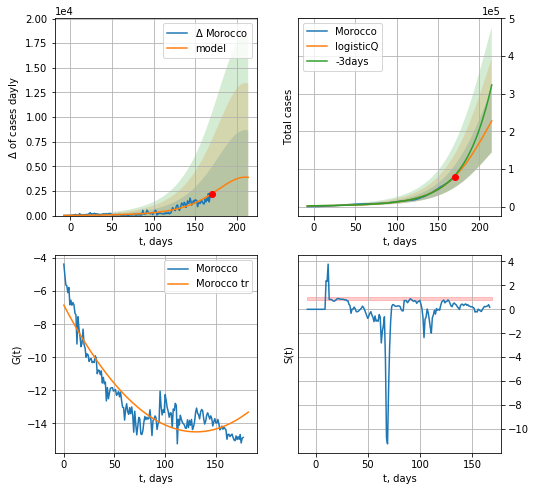

Morocco data at: 2020-09-09
+3 day model MAPE: 0.028887
model: logisticQ
coeffs: [ 3.90039073e+05  7.06530290e-05  2.06673923e+02 -3.55046595e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.366070
forecast at the end of period: +45 days
	 deltaDaycases: 3880
	 total cases: 227433 ± 83256
	 total death: 4243 ± 4659
trend coefficient of determination: 0.868882
 intercept_: -6.844121975903845
 coeffs_: [ 0.         -0.11753881  0.00045041]


In [1094]:
x = forecastRRR("Morocco",dfMR[5:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

RM
           date    cases   active   death
192 2020-09-05  93864.0  49986.0  3850.0
193 2020-09-06  95014.0  50814.0  3893.0
194 2020-09-07  95897.0  51517.0  3926.0
195 2020-09-08  97033.0  52228.0  3967.0
196 2020-09-09  98304.0  53284.0  4018.0


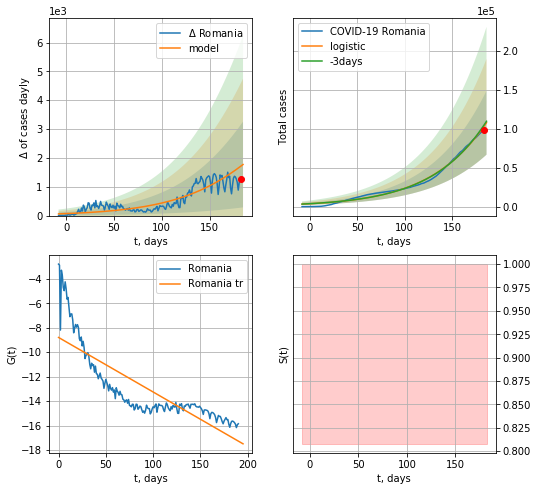

Romania data at: 2020-09-09
+3 day model MAPE: 0.015499506757852444
model: logistic
coeffs:  [8.67628753e+05 1.89535172e-02 2.89445212e+02]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.3807440178507096
forecast at the end of period: +3 days
	 deltaDaycases:  1770
	 total cases:  107533 ± 40942
	 total death:  4395 ± 5020
trend coefficient of determination: 0.675719
 intercept: -8.793557
 slope: -0.044559


In [1095]:
dfRM = read_df(pd.DataFrame(),"RM")
x = forecast("Romania",dfRM[5:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


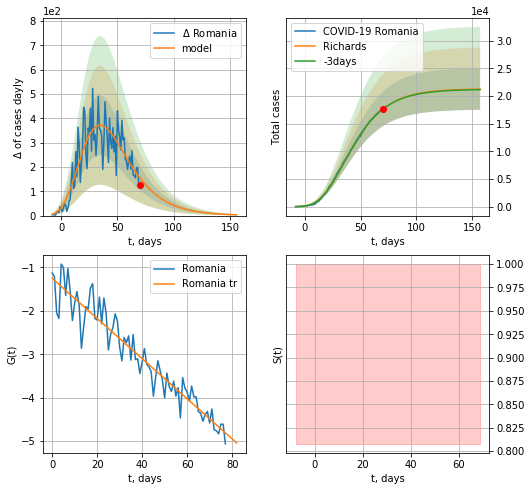

Romania data at: 2020-09-09
+3 day model MAPE: 0.002252
model: Richards
coeffs: [ 2.13019559e+04  3.77233819e+00 -5.65502366e+01  1.26521698e-02]
rational stdev: 0.176385
forecast at the end of period: +87 days
	 deltaDaycases: 3
	 total cases: 21238 ± 3746
	 total death: 868 ± 459
trend coefficient of determination: 0.908550
 intercept: -1.252366
 slope: -0.046196


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


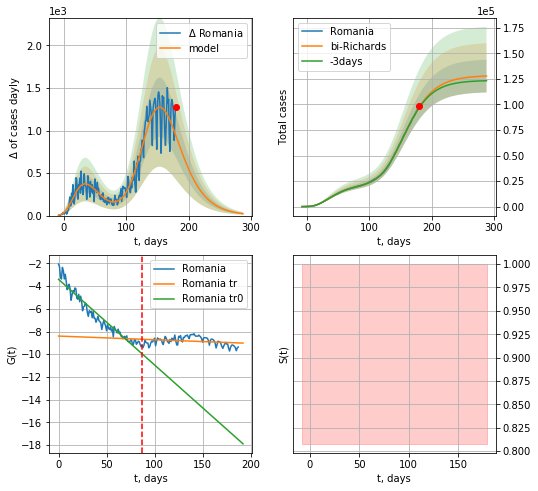

Romania data at: 2020-09-09
+3 day model MAPE: 0.006572
model: bi-Richards
coeffs: [1.07043273e+05 8.95683881e-02 1.33132988e+02 4.36402404e-01]
rational stdev: 0.125463
forecast at the end of period: +108 days
	 deltaDaycases: 22
	 total cases: 127770 ± 16030
	 total death: 5222 ± 1965
bi-Richards approximation splitting point: 87
trend coefficient of determination: 0.930941
 intercept: -3.402193
 slope: -0.075488
trend coefficient of determination: 0.066070
 intercept: -8.401039
 slope: -0.003232


In [1096]:
vL = 87+8
x = forecastRR("Romania",dfRM[8:vL-8],d1,36*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Romania",dfRM[8:],d1,39*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL = vL-8)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


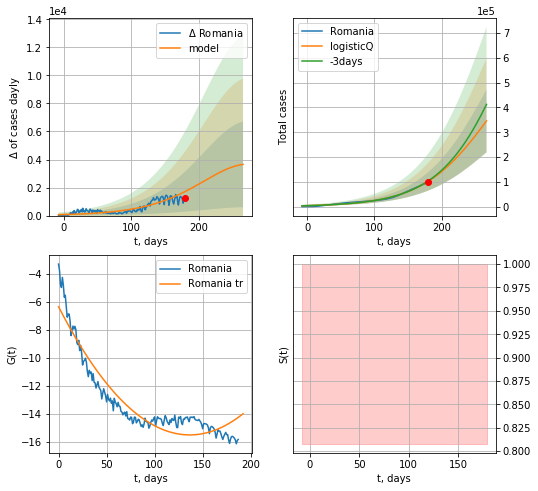

Romania data at: 2020-09-09
+3 day model MAPE: 0.016858
model: logisticQ
coeffs: [ 7.44313744e+05  2.20651779e-06  2.74184764e+02 -8.68292206e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.365630
forecast at the end of period: +87 days
	 deltaDaycases: 3650
	 total cases: 345833 ± 126447
	 total death: 14135 ± 15504
trend coefficient of determination: 0.889875
 intercept_: -6.34640257617132
 coeffs_: [ 0.         -0.13438953  0.00049208]


In [1097]:
xx = forecastRRR("Romania",dfRM[8:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

In [1098]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

EU
           date    cases  active     death
210 2020-09-05  2020087  426068  141063.0
211 2020-09-06  2034095  436761  141140.0
212 2020-09-07  2054531  445048  141316.0
213 2020-09-08  2081101  452508  141547.0
214 2020-09-09  2107705  465638  141713.0


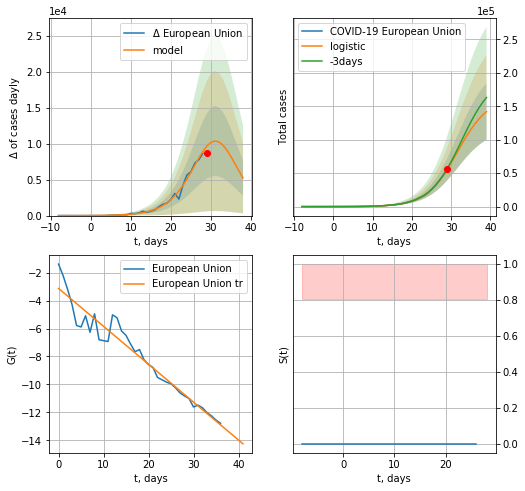

European Union data at: 2020-09-09
+3 day model MAPE: 0.026430260679971996
model: logistic
coeffs:  [1.63557146e+05 2.54069754e-01 3.15927312e+01]
rational stdev:  0.29731227366451135
forecast at the end of period: +10 days
	 deltaDaycases:  5226
	 total cases:  141940 ± 42200
	 total death:  9543 ± 8511
trend coefficient of determination: 0.939076
 intercept: -3.128192
 slope: -0.271364


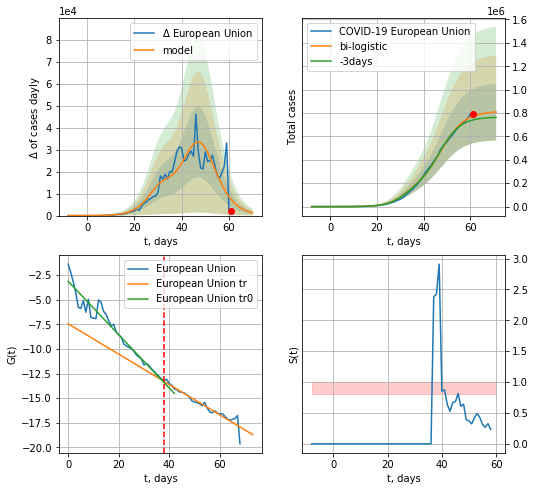

European Union data at: 2020-09-09
+3 day model MAPE: 0.04651915802684479
model: bi-logistic
coeffs:  [6.50647976e+05 2.01824362e-01 4.76677897e+01] [1.63557146e+05 2.54069754e-01 3.15927312e+01]
rational stdev:  0.30016662391822424
forecast at the end of period: +10 days
	 deltaDaycases:  1287
	 total cases:  808385 ± 242650
	 total death:  54352 ± 48943
bi-logistic approximation splitting point: 38
trend0 coefficient of determination: 0.943288
 intercept: -3.133643
 slope: -0.270910
trend coefficient of determination: 0.919558
 intercept: -7.446330
 slope: -0.154010


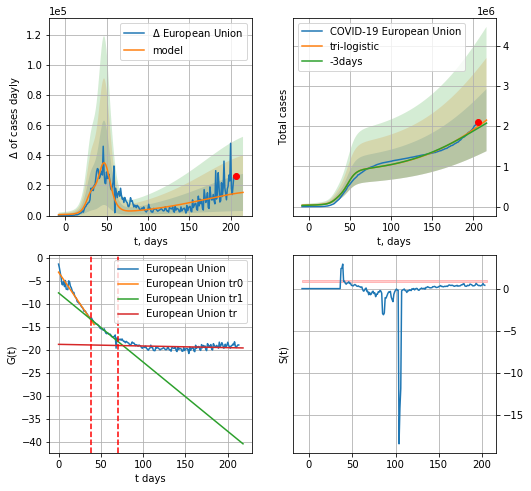

European Union data at: 2020-09-09
+3 day model MAPE: 0.025372867817987473
model: tri-logistic
coeffs:  [3.44659737e+06 1.88548718e-02 2.40143041e+02] [1.63557146e+05 2.54069754e-01 3.15927312e+01 6.50647976e+05
 2.01824362e-01 4.76677897e+01]
forecast rational stdev:  0.359179380581932
forecast at the end of period: +10 days
	 deltaDaycases:  15399
	 total cases:  2151904 ± 772919
	 total death:  144684 ± 155902
tri-logistic approximation splitting points: 38,70
trend0 coefficient of determination: 0.943288
 intercept: -3.133643
 slope: -0.270910
trend1 coefficient of determination: 0.917496
 intercept: -7.627918
 slope: -0.150227
trend coefficient of determination: 0.054316
 intercept: -18.794251
 slope: -0.003581


In [1099]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
x = forecast("European Union",dfEU[:vL],d1,T18*7-dT)
xx = forecast2("European Union",dfEU[:vL1],d1,T18*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("European Union",dfEU,d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


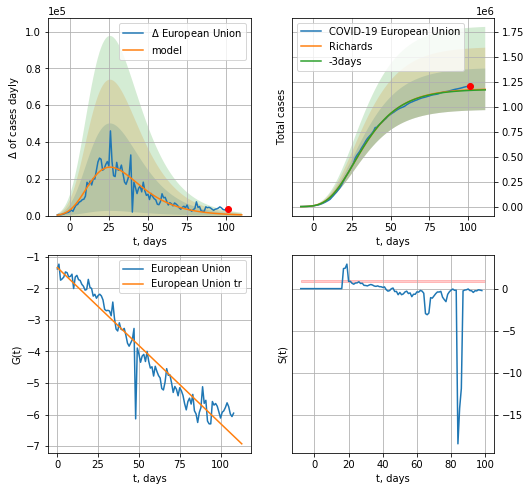

European Union data at: 2020-09-09
+3 day model MAPE: 0.004510
model: Richards
coeffs: [ 1.18204696e+06  8.96706485e+00 -5.59023207e+01  6.77910245e-03]
rational stdev: 0.177380
forecast at the end of period: +10 days
	 deltaDaycases: 426
	 total cases: 1175224 ± 208461
	 total death: 79017 ± 42048
trend coefficient of determination: 0.933679
 intercept: -1.341249
 slope: -0.049432


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


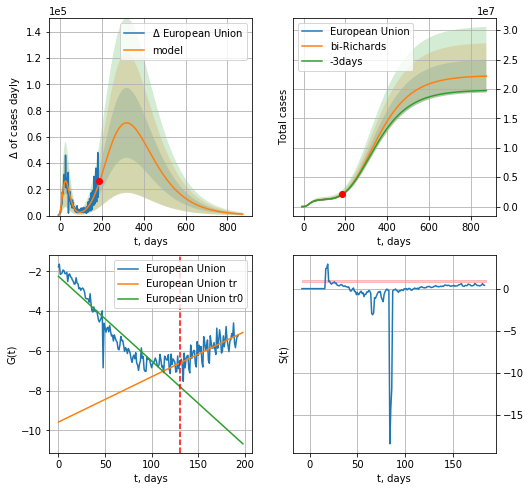

European Union data at: 2020-09-09
+3 day model MAPE: 0.003504
model: bi-Richards
coeffs: [2.11323479e+07 1.57813434e-01 1.63371797e+01 5.92648632e-02]
rational stdev: 0.125537
forecast at the end of period: +689 days
	 deltaDaycases: 1083
	 total cases: 22198752 ± 2786754
	 total death: 1492548 ± 562107
bi-Richards approximation splitting point: 130
trend coefficient of determination: 0.880908
 intercept: -2.247270
 slope: -0.042571
trend coefficient of determination: 0.495104
 intercept: -9.581522
 slope: 0.022779


In [1100]:
vL = 130+20#83+20+17
x = forecastRR("European Union",dfEU[20:vL-20],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("European Union",dfEU[20:],d1,122*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


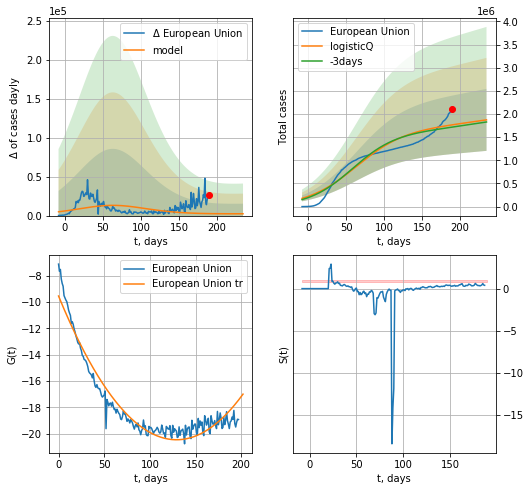

European Union data at: 2020-09-09
+3 day model MAPE: 0.028573
model: logisticQ
coeffs: [ 1.67213775e+06  2.27631600e-08  6.28389203e+01 -1.34940335e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.357152
forecast at the end of period: +45 days
	 deltaDaycases: 2349
	 total cases: 1873454 ± 669107
	 total death: 125962 ± 134962
trend coefficient of determination: 0.936672
 intercept_: -9.533624515710683
 coeffs_: [ 0.         -0.16935394  0.00065538]


In [1101]:
x = forecastRRR("European Union",dfEU[16:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

In [1102]:
#x = forecastQR("European Union",dfEU[20:],d1,16*7-dT,addpred=True,xcoef=QRkoreaCoeffs)

In [1103]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [1104]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [1105]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [1106]:
#dfIC[:]

IC
           date   cases  active  death
188 2020-09-05  2136.0      88   10.0
189 2020-09-06  2141.0      81   10.0
190 2020-09-07  2143.0      76   10.0
191 2020-09-08  2150.0      80   10.0
192 2020-09-09  2153.0      76   10.0


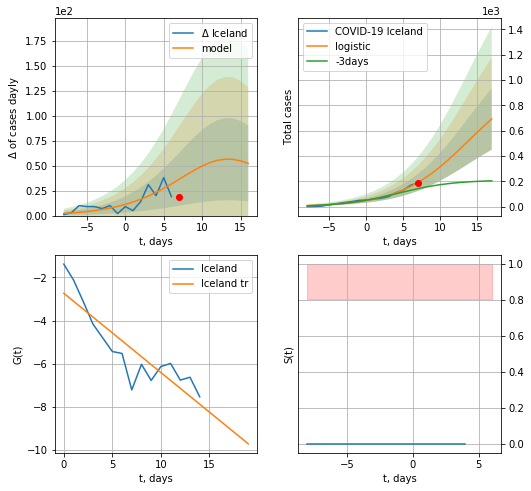

Iceland data at: 2020-09-09
+3 day model MAPE: 0.4751648041928849
model: logistic
coeffs:  [1.04285054e+03 2.17199299e-01 1.38649769e+01]
rational stdev:  0.34947878303574653
forecast at the end of period: +10 days
	 deltaDaycases:  52
	 total cases:  692 ± 241
	 total death:  3 ± 3
trend coefficient of determination: 0.782203
 intercept: -2.736046
 slope: -0.366728


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


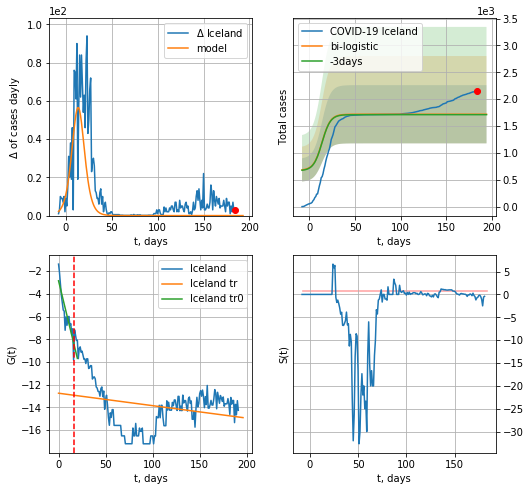

Iceland data at: 2020-09-09
+3 day model MAPE: 0.004598783001436042
model: bi-logistic
coeffs:  [636.66972713 -35.19447513 209.89190407] [1.04285054e+03 2.17199299e-01 1.38649769e+01]
scenario coeffs:  [0.0625, 1.0, 2]
rational stdev:  0.31502941549157504
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  1719 ± 541
	 total death:  7 ± 6
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.774693
 intercept: -2.854940
 slope: -0.341251
trend coefficient of determination: 0.063062
 intercept: -12.746052
 slope: -0.010955


In [1107]:
dfIC = read_df(pd.DataFrame(),"IC")
vL=16
try:
    x = forecast("Iceland",dfIC[:vL],d1,T18*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
    xx = forecast2("Iceland",dfIC[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


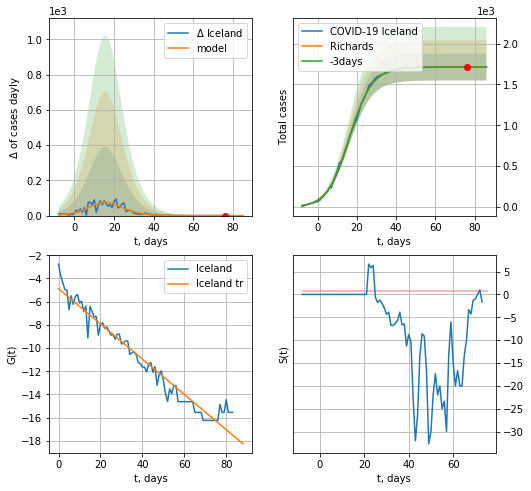

Iceland data at: 2020-09-09
+3 day model MAPE: 0.000010
model: Richards
coeffs: [1.71330052e+03 1.94502632e-01 1.51528095e+01 8.70905557e-01]
rational stdev: 0.095562
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 1713 ± 163
	 total death: 7 ± 2
trend coefficient of determination: 0.952024
 intercept: -4.875300
 slope: -0.151986


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


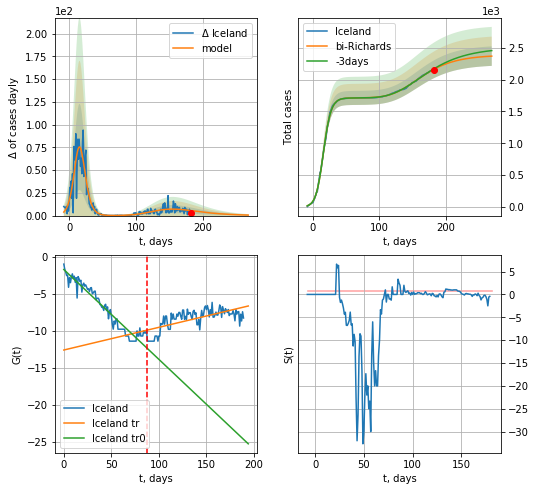

Iceland data at: 2020-09-09
+3 day model MAPE: 0.003878
model: bi-Richards
coeffs: [6.74248053e+02 1.43339207e-01 1.08104730e+02 2.22574034e-01]
rational stdev: 0.064608
forecast at the end of period: +87 days
	 deltaDaycases: 0
	 total cases: 2369 ± 153
	 total death: 11 ± 2
bi-Richards approximation splitting point: 87
trend coefficient of determination: 0.929875
 intercept: -1.736782
 slope: -0.121259
trend coefficient of determination: 0.461300
 intercept: -12.603054
 slope: 0.030629


In [1108]:
vL = 87+2
x = forecastRR("Iceland",dfIC[2:vL-2],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iceland",dfIC[2:],d1,36*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-2)
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


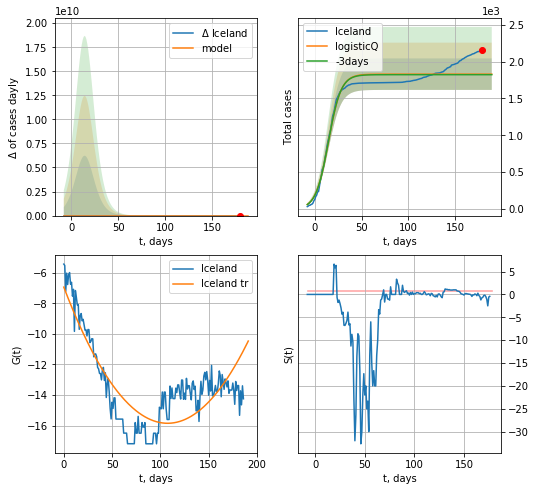

Iceland data at: 2020-09-09
+3 day model MAPE: 0.003934
model: logisticQ
coeffs: [ 1.82904669e+03  4.31753073e-07  1.46081239e+01 -3.43366446e+05]
rational stdev: 0.116766
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 1829 ± 213
	 total death: 8 ± 2
trend coefficient of determination: 0.714833
 intercept_: -6.938738690946241
 coeffs_: [ 0.         -0.16591426  0.00077189]


In [1109]:
x = forecastRRR("Iceland",dfIC[5:],d1,T18*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

PM
           date  cases   active   death
179 2020-09-05  96305  25007.0  2075.0
180 2020-09-06  97043  25296.0  2086.0
181 2020-09-07  97578  25232.0  2099.0
182 2020-09-08  98407  25549.0  2107.0
183 2020-09-09  99042  25507.0  2116.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


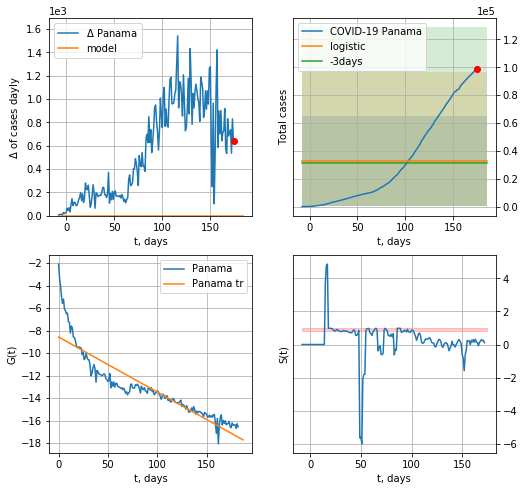

Panama data at: 2020-09-09
+3 day model MAPE: 0.03457094219423537
model: logistic
coeffs:  [ 3.26059837e+04 -2.77463022e+01  6.82507476e+02]
rational stdev:  0.9852511847990943
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  32605 ± 32125
	 total death:  696 ± 2057
trend coefficient of determination: 0.814017
 intercept: -8.573557
 slope: -0.048835


In [1110]:
dfPM = read_df(pd.DataFrame(),"PM").fillna(0)
x = forecast("Panama",dfPM[:],d1,T18*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


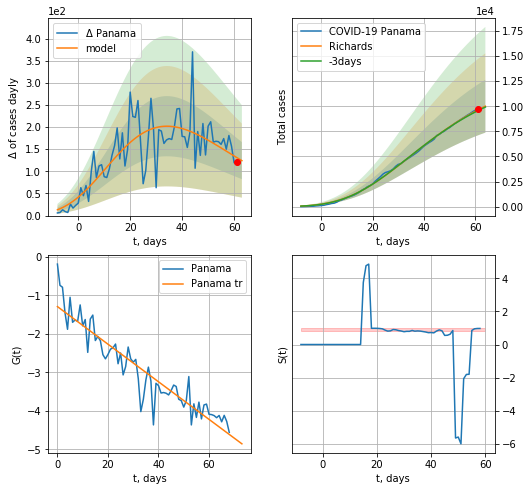

Panama data at: 2020-09-09
+3 day model MAPE: 0.008202
model: Richards
coeffs: [ 1.34884806e+04  2.34095265e+00 -6.38236986e+01  1.75426471e-02]
rational stdev: 0.263123
forecast at the end of period: +3 days
	 deltaDaycases: 124
	 total cases: 10006 ± 2633
	 total death: 213 ± 168
trend coefficient of determination: 0.871686
 intercept: -1.291509
 slope: -0.048815


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


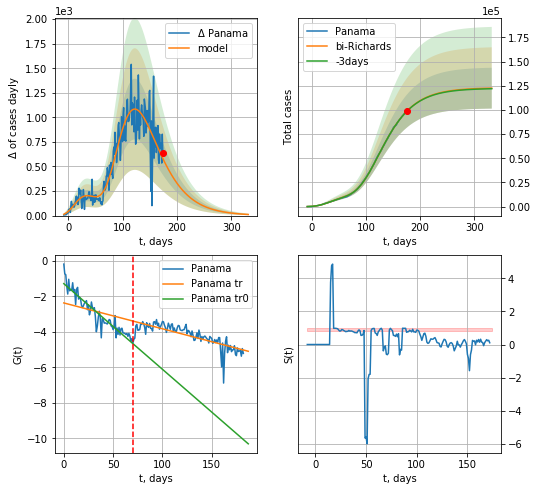

Panama data at: 2020-09-09
+3 day model MAPE: 0.001702
model: bi-Richards
coeffs: [ 1.09427233e+05  1.85228166e+00 -3.44676629e+01  1.44594972e-02]
rational stdev: 0.172374
forecast at the end of period: +157 days
	 deltaDaycases: 11
	 total cases: 122503 ± 21116
	 total death: 2617 ± 1353
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.874073
 intercept: -1.283580
 slope: -0.048270
trend coefficient of determination: 0.606781
 intercept: -2.370336
 slope: -0.014565


In [1111]:
vL = 70
x = forecastRR("Panama",dfPM[:vL],d1,24*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Panama",dfPM[:],d1,46*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


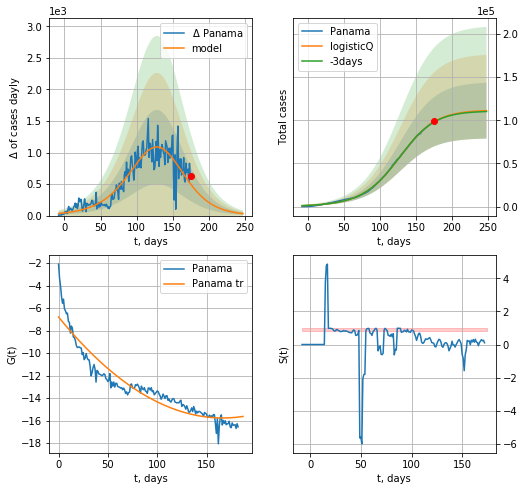

Panama data at: 2020-09-09
+3 day model MAPE: 0.003659
model: logisticQ
coeffs: [ 1.11562974e+05  3.26961176e-05  1.26103029e+02 -1.06533195e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.290778
forecast at the end of period: +73 days
	 deltaDaycases: 31
	 total cases: 111158 ± 32322
	 total death: 2374 ± 2070
trend coefficient of determination: 0.893608
 intercept_: -6.7992214608741435
 coeffs_: [ 0.         -0.10765312  0.00032318]


In [1112]:
x = forecastRRR("Panama",dfPM[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


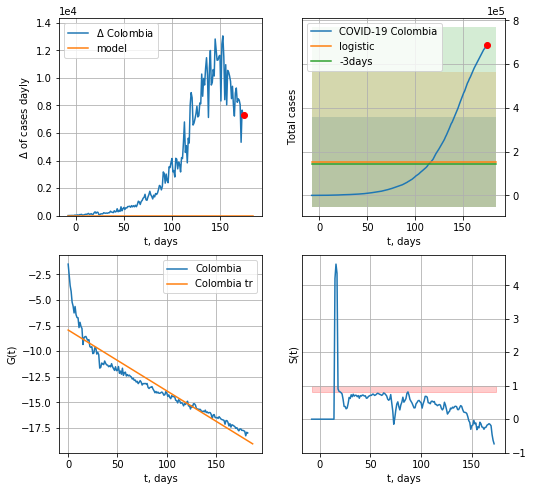

Colombia data at: 2020-09-09
+3 day model MAPE: 0.05988453814022285
model: logistic
coeffs:  [ 1.54098919e+05 -1.16518083e+01  2.86838537e+02]
rational stdev:  1.3336161326935267
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  154098 ± 205508
	 total death:  4947 ± 19792
trend coefficient of determination: 0.891368
 intercept: -7.936556
 slope: -0.059364


In [1113]:
dfCB = dfCB.fillna(0)
x = forecast("Colombia",dfCB[:],d1,T18*7-dT)

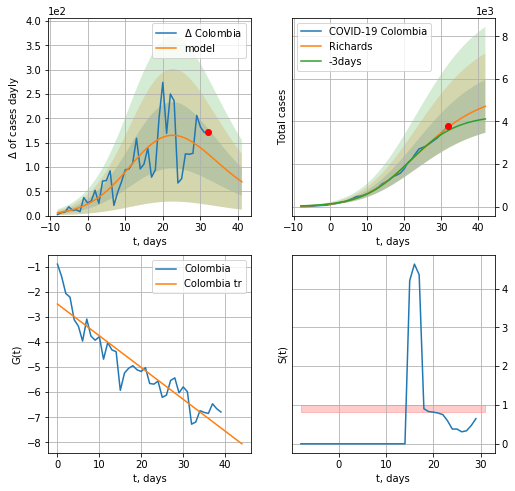

Colombia data at: 2020-09-09
+3 day model MAPE: 0.053959
model: Richards
coeffs: [5.45324012e+03 2.23852503e-01 1.50938863e+01 4.47627095e-01]
rational stdev: 0.263661
forecast at the end of period: +10 days
	 deltaDaycases: 69
	 total cases: 4713 ± 1242
	 total death: 151 ± 119
trend coefficient of determination: 0.864435
 intercept: -2.485430
 slope: -0.126591


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


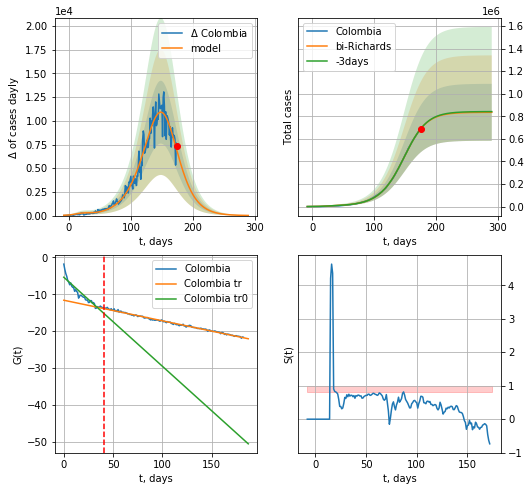

Colombia data at: 2020-09-09
+3 day model MAPE: 0.001793
model: bi-Richards
coeffs: [8.30145712e+05 4.47646468e-02 1.52930201e+02 1.27291416e+00]
rational stdev: 0.301932
forecast at the end of period: +115 days
	 deltaDaycases: 15
	 total cases: 835334 ± 252213
	 total death: 26820 ± 24293
bi-Richards approximation splitting point: 41
trend coefficient of determination: 0.886689
 intercept: -5.362334
 slope: -0.241685
trend coefficient of determination: 0.993651
 intercept: -11.600867
 slope: -0.055901


In [1114]:
vL = 41
x = forecastRR("Colombia",dfCB[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Colombia",dfCB[:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


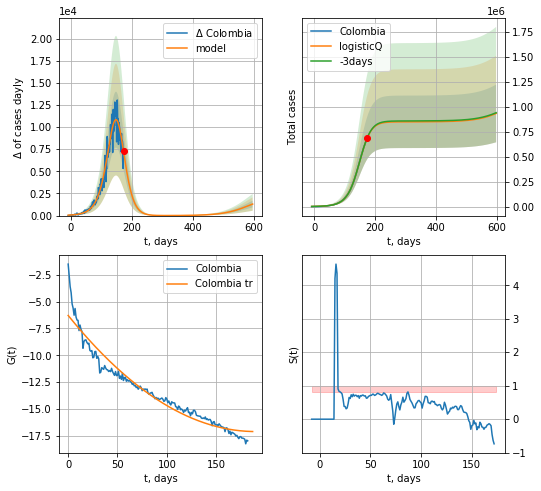

Colombia data at: 2020-09-09
+3 day model MAPE: 0.003145
model: logisticQ
coeffs: [ 8.47402506e+05  6.80683660e-05  1.47168403e+02 -6.02428149e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.309469
forecast at the end of period: +423 days
	 deltaDaycases: 1302
	 total cases: 931557 ± 288288
	 total death: 29909 ± 27767
trend coefficient of determination: 0.942207
 intercept_: -6.289233337521049
 coeffs_: [ 0.         -0.11397142  0.00030004]


In [1115]:
x = forecastRRR("Colombia",dfCB[:],d1,84*7-dT,addpred=True,xcoef=koreaCoeffs)

AR
           date    cases   active   death
185 2020-09-05  46071.0  12041.0  1549.0
186 2020-09-06  46364.0  12063.0  1556.0
187 2020-09-07  46653.0  12106.0  1562.0
188 2020-09-08  46938.0  12184.0  1571.0
189 2020-09-09  47216.0  12256.0  1581.0


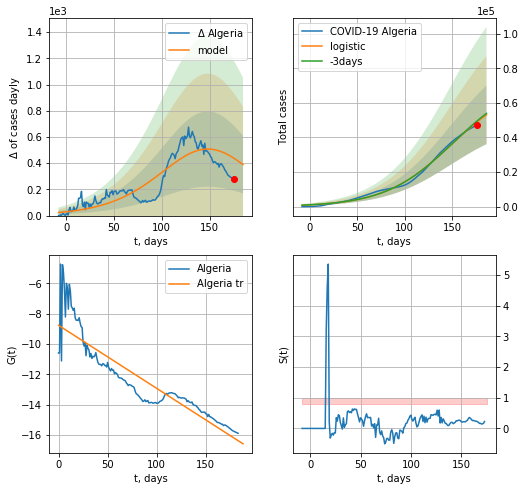

Algeria data at: 2020-09-09
+3 day model MAPE: 0.01185929025316335
model: logistic
coeffs:  [7.13381913e+04 2.84781650e-02 1.48542604e+02]
rational stdev:  0.3193165679170375
forecast at the end of period: +10 days
	 deltaDaycases:  389
	 total cases:  53073 ± 16947
	 total death:  1777 ± 1702
trend coefficient of determination: 0.813756
 intercept: -8.769286
 slope: -0.041612


In [1116]:
dfAR = read_df(pd.DataFrame(),"AR")
dfAR = dfAR.fillna(0)
x = forecast("Algeria",dfAR[5:],d1,T18*7-dT)
#dfAG

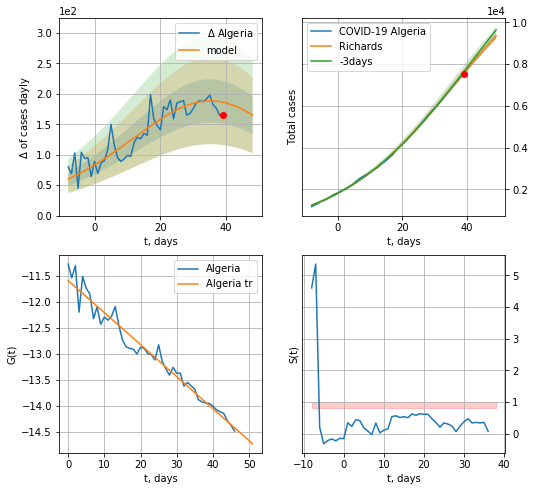

Algeria data at: 2020-09-09
+3 day model MAPE: 0.009853
model: Richards
coeffs: [1.34014715e+04 4.98947140e-02 3.86388173e+01 1.19488229e+00]
rational stdev: 0.015787
forecast at the end of period: +10 days
	 deltaDaycases: 164
	 total cases: 9341 ± 147
	 total death: 312 ± 14
trend coefficient of determination: 0.959635
 intercept: -11.589811
 slope: -0.061720


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


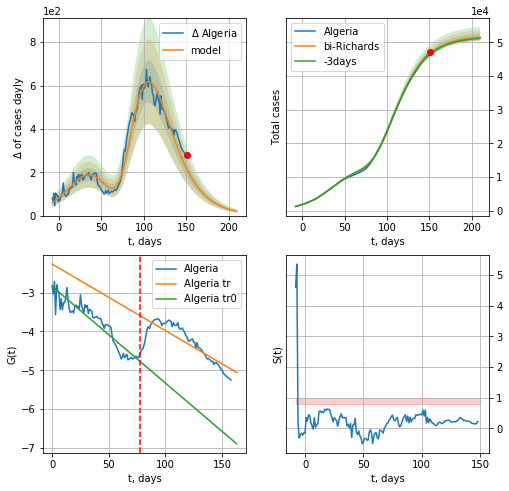

Algeria data at: 2020-09-09
+3 day model MAPE: 0.004061
model: bi-Richards
coeffs: [3.86555045e+04 3.90370217e+00 1.35360891e+00 1.09800611e-02]
rational stdev: 0.019385
forecast at the end of period: +59 days
	 deltaDaycases: 19
	 total cases: 51599 ± 1000
	 total death: 1727 ± 100
bi-Richards approximation splitting point: 78
trend coefficient of determination: 0.887934
 intercept: -2.838482
 slope: -0.024912
trend coefficient of determination: 0.682395
 intercept: -2.261804
 slope: -0.017154


In [1117]:
iL = 30
vL = 78+iL
x = forecastRR("Algeria",dfAR[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Algeria",dfAR[iL:],d1,32*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


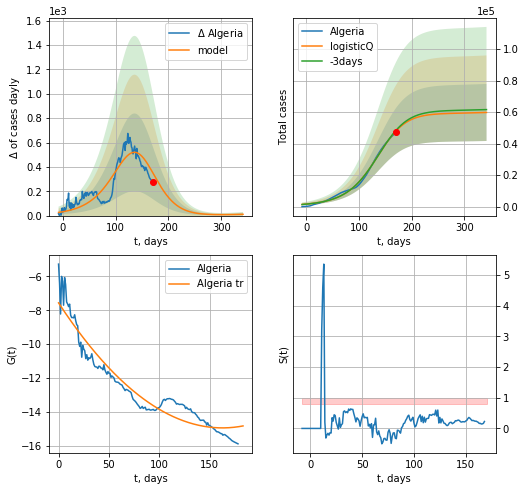

Algeria data at: 2020-09-09
+3 day model MAPE: 0.009021
model: logisticQ
coeffs: [ 5.89903545e+04  5.84865347e-05  1.30796337e+02 -4.65792146e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.302722
forecast at the end of period: +171 days
	 deltaDaycases: 10
	 total cases: 59771 ± 18094
	 total death: 2001 ± 1817
trend coefficient of determination: 0.917632
 intercept_: -7.56276534316058
 coeffs_: [ 0.         -0.09093251  0.0002796 ]


In [1118]:
x = forecastRRR("Algeria",dfAR[10:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

IE
           date   cases   active   death
180 2020-09-05  194109  47509.0  8025.0
181 2020-09-06  195543  47509.0  8025.0
182 2020-09-07  196989  48207.0  8130.0
183 2020-09-08  203342  49806.0  8336.0
184 2020-09-09  207203  51237.0  8456.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


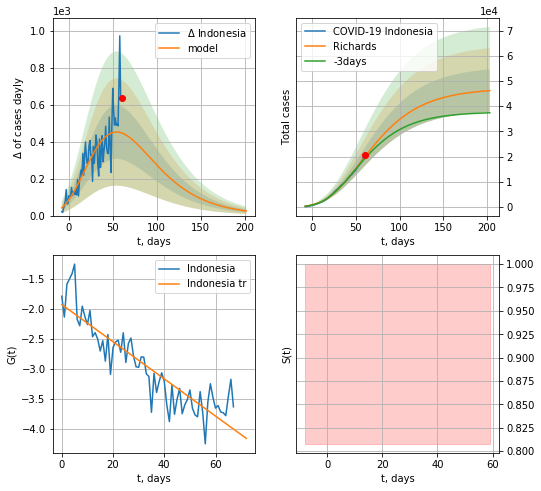

Indonesia data at: 2020-09-09
+3 day model MAPE: 0.038052
model: Richards
coeffs: [ 4.71241400e+04  1.80052285e+00 -1.05975004e+02  1.46057737e-02]
rational stdev: 0.182929
forecast at the end of period: +143 days
	 deltaDaycases: 24
	 total cases: 46179 ± 8447
	 total death: 1893 ± 1038
trend coefficient of determination: 0.798542
 intercept: -1.926266
 slope: -0.031064


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


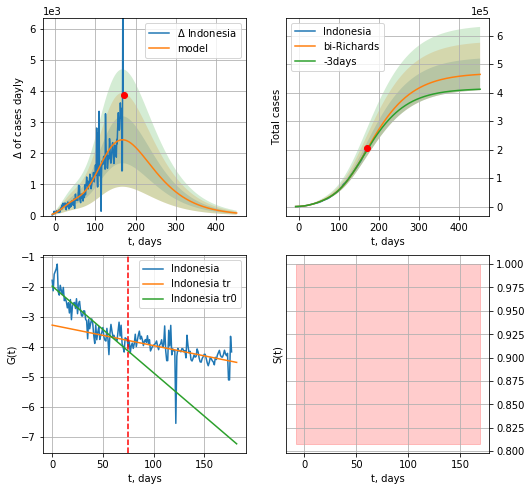

Indonesia data at: 2020-09-09
+3 day model MAPE: 0.013679
model: bi-Richards
coeffs: [ 4.22044383e+05  1.02275821e+00 -1.01343558e+02  1.50908882e-02]
rational stdev: 0.119684
forecast at the end of period: +283 days
	 deltaDaycases: 82
	 total cases: 463820 ± 55511
	 total death: 19014 ± 6827
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.797512
 intercept: -1.983107
 slope: -0.028776
trend coefficient of determination: 0.261040
 intercept: -3.278610
 slope: -0.006799


In [1202]:
dfIE = read_df(pd.DataFrame(),"IE")
try:
    #x = forecast("Indonesia",dfIE[5:],d1,T18*7-dT)
    vL = 75+6
    x = forecastRR("Indonesia",dfIE[6:vL-6],d1,44*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Indonesia",dfIE[6:],d12f(1),64*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-6)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


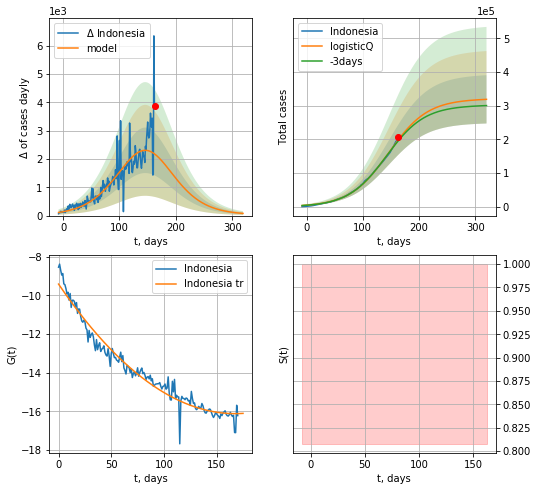

Indonesia data at: 2020-09-09
+3 day model MAPE: 0.015746
model: logisticQ
coeffs: [ 3.19804338e+05  5.00043508e-07  1.45943848e+02 -5.75445199e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.224688
forecast at the end of period: +157 days
	 deltaDaycases: 76
	 total cases: 318891 ± 71651
	 total death: 13072 ± 8811
trend coefficient of determination: 0.961772
 intercept_: -9.422439838072393
 coeffs_: [ 0.         -0.07993714  0.00023845]


In [1196]:
x = forecastRRR("Indonesia",dfIE[13:],d1,46*7-dT,addpred=True,xcoef=koreaCoeffs)

PH
           date   cases   active   death
182 2020-09-05  237365  48803.0  3875.0
183 2020-09-06  238727  49931.0  3890.0
184 2020-09-07  241987  52893.0  3916.0
185 2020-09-08  245143  55614.0  3986.0
186 2020-09-09  248947  58823.0  4066.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


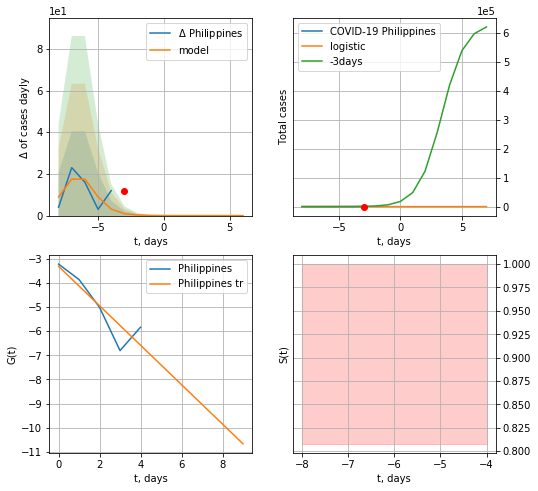

Philippines data at: 2020-09-09
+3 day model MAPE: 0.9724006926427327
model: logistic
coeffs:  [61.5169203   1.2919553  -5.99802409]
rational stdev:  0.193485507182797
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  61 ± 11
	 total death:  1 ± 0
trend coefficient of determination: 0.794507
 intercept: -3.309972
 slope: -0.817432


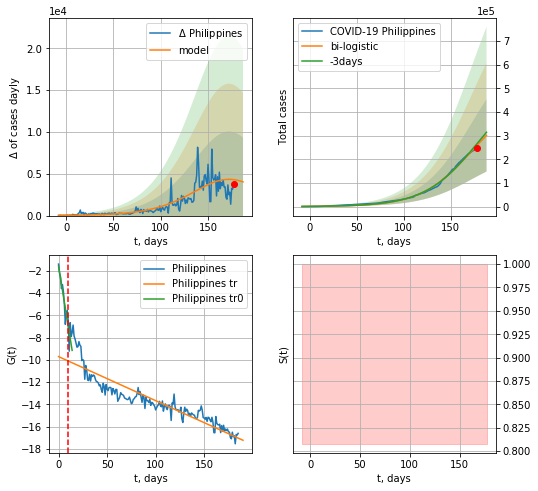

Philippines data at: 2020-09-09
+3 day model MAPE: 0.027456015569634912
model: bi-logistic
coeffs:  [4.72697796e+05 3.67311818e-02 1.72609447e+02] [61.5169203   1.2919553  -5.99802409]
rational stdev:  0.507510977854172
forecast at the end of period: +10 days
	 deltaDaycases:  4031
	 total cases:  301491 ± 153010
	 total death:  4902 ± 7463
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend coefficient of determination: 0.825346
 intercept: -9.705340
 slope: -0.039607


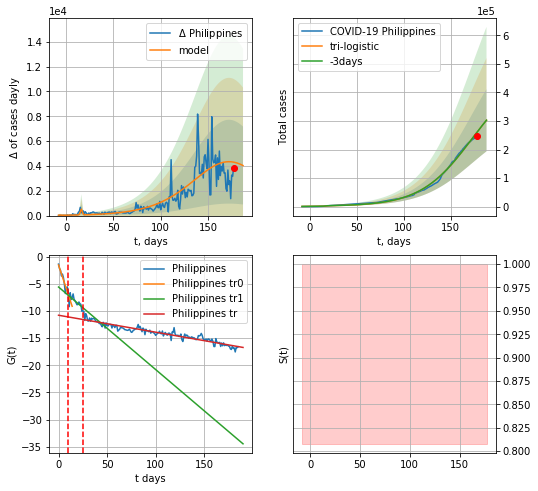

Philippines data at: 2020-09-09
+3 day model MAPE: 0.0008134231355484709
model: tri-logistic
coeffs:  [1179.51772803    1.66411714   16.60125591] [ 6.15169203e+01  1.29195530e+00 -5.99802409e+00  4.72697796e+05
  3.67311818e-02  1.72609447e+02]
forecast rational stdev:  0.3600696510114262
forecast at the end of period: +10 days
	 deltaDaycases:  4031
	 total cases:  302671 ± 108982
	 total death:  4921 ± 5315
tri-logistic approximation splitting points: 10,25
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend1 coefficient of determination: 0.474240
 intercept: -5.600607
 slope: -0.151865
trend coefficient of determination: 0.902983
 intercept: -10.794818
 slope: -0.031180


In [1192]:
vL=10
vL1=25
try:
    dfPH = read_df(pd.DataFrame(),"PH")
    x = forecast("Philippines",dfPH[4:vL],d1,T18*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
    xx = forecast2("Philippines",dfPH[:],d1,T18*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
    xx = np.concatenate((x, xx), axis=0)
    xxx = forecast3("Philippines",dfPH,d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])
except:
    print ("Exception occurs")

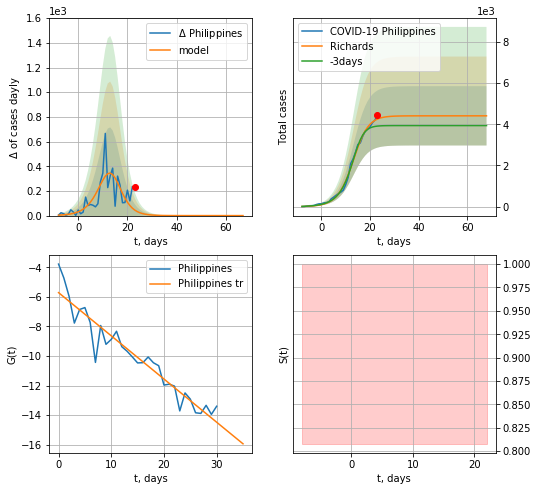

Philippines data at: 2020-09-09
+3 day model MAPE: 0.095041
model: Richards
coeffs: [4.40831989e+03 2.70678377e-01 1.39356489e+01 1.24523177e+00]
rational stdev: 0.326084
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 4408 ± 1437
	 total death: 71 ± 69
trend coefficient of determination: 0.911495
 intercept: -5.712821
 slope: -0.292234


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


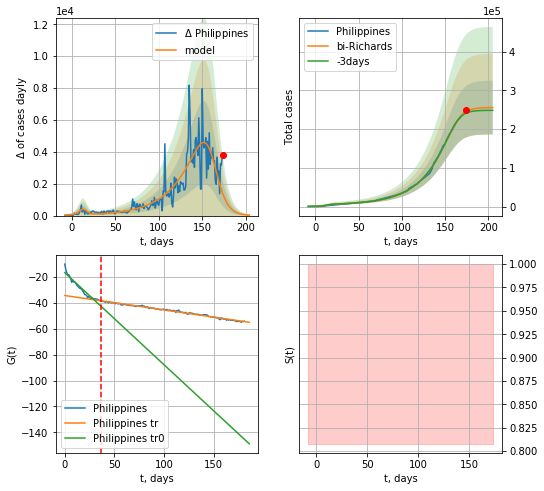

Philippines data at: 2020-09-09
+3 day model MAPE: 0.015809
model: bi-Richards
coeffs: [2.51374537e+05 3.39929395e-02 1.62376554e+02 4.03297934e+00]
rational stdev: 0.271397
forecast at the end of period: +31 days
	 deltaDaycases: 26
	 total cases: 255602 ± 69369
	 total death: 4156 ± 3383
bi-Richards approximation splitting point: 36
trend coefficient of determination: 0.930714
 intercept: -16.816544
 slope: -0.709553
trend coefficient of determination: 0.990463
 intercept: -34.440407
 slope: -0.110863


In [1193]:
vL = 36 + 4
x = forecastRR("Philippines",dfPH[4:vL-4],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Philippines",dfPH[4:],d1,28*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


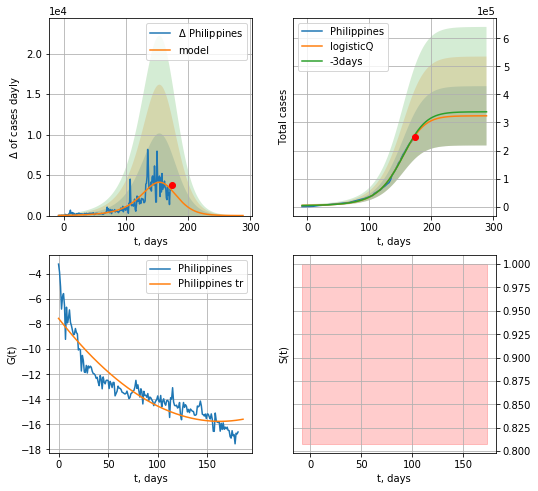

Philippines data at: 2020-09-09
+3 day model MAPE: 0.014488
model: logisticQ
coeffs: [ 3.23267683e+05  1.44329094e-04  1.50026673e+02 -1.98690948e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.326415
forecast at the end of period: +115 days
	 deltaDaycases: 7
	 total cases: 323646 ± 105643
	 total death: 5262 ± 5152
trend coefficient of determination: 0.862006
 intercept_: -7.546709345314529
 coeffs_: [ 0.         -0.100991    0.00031051]


In [1194]:
x = forecastRRR("Philippines",dfPH[4:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

GC
           date    cases  active  death
189 2020-09-05  11386.0    7302  280.0
190 2020-09-06  11524.0    7436  284.0
191 2020-09-07  11663.0    7570  289.0
192 2020-09-08  11832.0    7738  290.0
193 2020-09-09  12080.0    7983  293.0


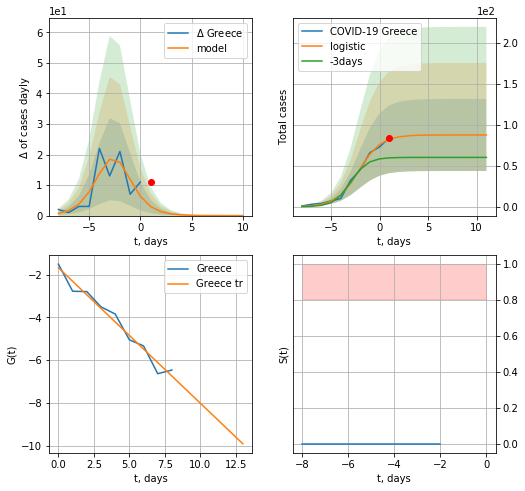

Greece data at: 2020-09-09
+3 day model MAPE: 0.4212876769828872
model: logistic
coeffs:  [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.5018417290456435
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  87 ± 43
	 total death:  2 ± 3
trend coefficient of determination: 0.966991
 intercept: -1.674249
 slope: -0.634181


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


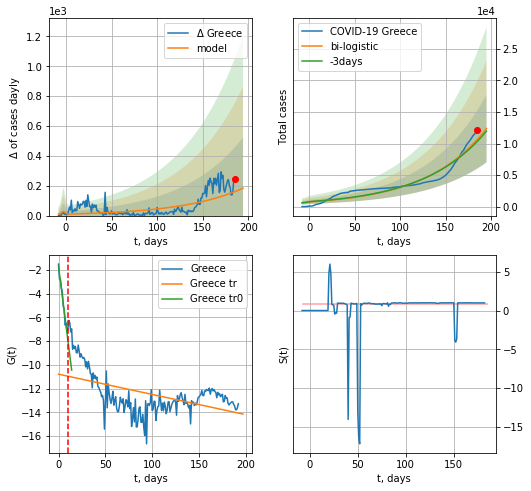

Greece data at: 2020-09-09
+3 day model MAPE: 0.03056190840505795
model: bi-logistic
coeffs:  [5.35075098e+07 1.50117440e-02 7.53054406e+02] [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.4331548543338101
forecast at the end of period: +10 days
	 deltaDaycases:  183
	 total cases:  12392 ± 5367
	 total death:  300 ± 389
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.974467
 intercept: -1.699561
 slope: -0.624689
trend coefficient of determination: 0.257191
 intercept: -10.789662
 slope: -0.017075


In [1125]:
dfGC = read_df(pd.DataFrame(),"GC")
x = forecast("Greece",dfGC[:10],d1,T18*7-dT)
xx = forecast2("Greece",dfGC[:],d1,T18*7-dT,x,addpred=False,xcoef=[.25/2,1.,2.3],vL=10)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


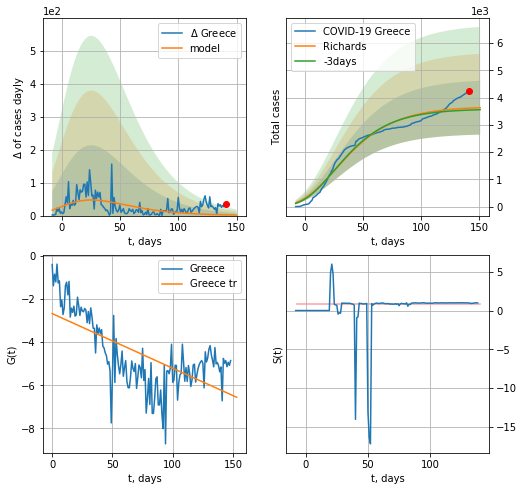

Greece data at: 2020-09-09
+3 day model MAPE: 0.019952
model: Richards
coeffs: [ 3.67300317e+03  8.86166446e+00 -1.31342745e+02  3.96579151e-03]
rational stdev: 0.271998
forecast at the end of period: +10 days
	 deltaDaycases: 1
	 total cases: 3627 ± 986
	 total death: 87 ± 70
trend coefficient of determination: 0.441158
 intercept: -2.678204
 slope: -0.025333


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


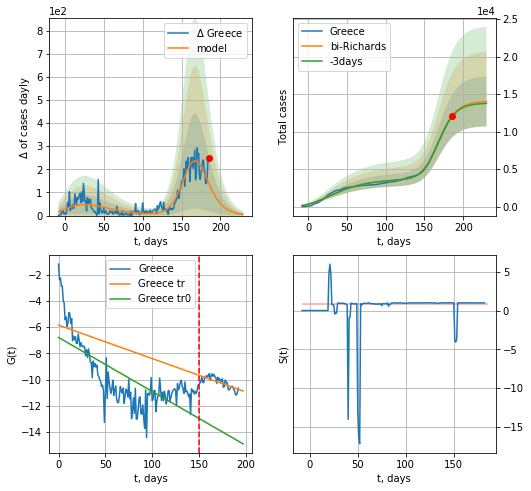

Greece data at: 2020-09-09
+3 day model MAPE: 0.004861
model: bi-Richards
coeffs: [1.04096926e+04 1.14831264e-01 1.63846375e+02 7.19581456e-01]
rational stdev: 0.236578
forecast at the end of period: +45 days
	 deltaDaycases: 5
	 total cases: 14019 ± 3316
	 total death: 340 ± 241
bi-Richards approximation splitting point: 150
trend coefficient of determination: 0.523188
 intercept: -6.785231
 slope: -0.041142
trend coefficient of determination: 0.519241
 intercept: -5.844869
 slope: -0.025487


In [1126]:
iL = 0
vL = 150+iL
x = forecastRR("Greece",dfGC[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Greece",dfGC[iL:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


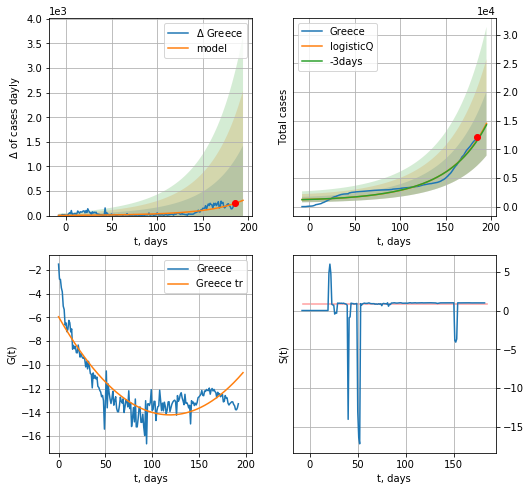

Greece data at: 2020-09-09
+3 day model MAPE: 0.013162
model: logisticQ
coeffs: [ 2.08363348e+07  4.70313171e-05  4.20160224e+02 -4.91412165e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.386736
forecast at the end of period: +10 days
	 deltaDaycases: 310
	 total cases: 14511 ± 5612
	 total death: 351 ± 407
trend coefficient of determination: 0.772236
 intercept_: -5.9444392714157255
 coeffs_: [ 0.         -0.13919985  0.00058507]


In [1127]:
x = forecastRRR("Greece",dfGC[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

HG
           date    cases  active  death
183 2020-09-05   8387.0    3805  624.0
184 2020-09-06   8963.0    4377  625.0
185 2020-09-07   9304.0    4706  626.0
186 2020-09-08   9715.0    5103  628.0
187 2020-09-09  10191.0    5571  630.0


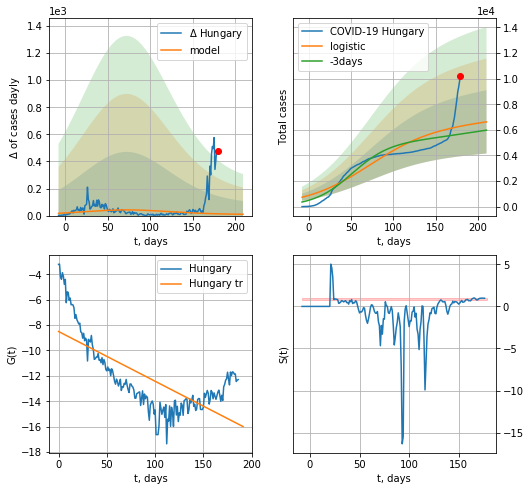

Hungary data at: 2020-09-09
+3 day model MAPE: 0.10826672061499758
model: logistic
coeffs:  [6.19216194e+03 2.62127013e-02 7.12415592e+01]
scenario coeffs:  [0.35, 0.5, 4, 1]
rational stdev:  0.373234136203957
forecast at the end of period: +31 days
	 deltaDaycases:  9
	 total cases:  6623 ± 2472
	 total death:  409 ± 457
trend coefficient of determination: 0.508595
 intercept: -8.504696
 slope: -0.039190


In [1128]:
dfHG = read_df(pd.DataFrame(),"HG")
try:
    x = forecast("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=[.35,.5,4,1])
except:
    print("Exception occurs")
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


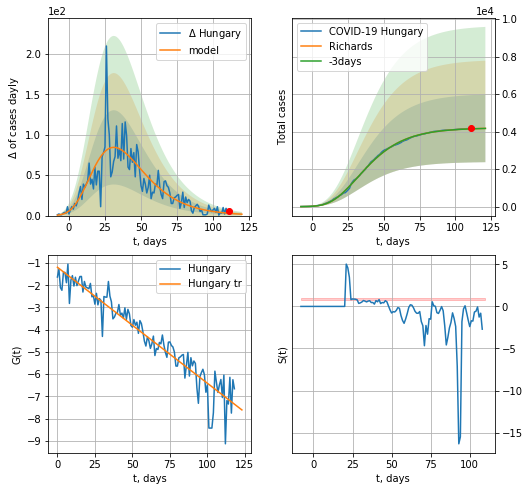

Hungary data at: 2020-09-09
+3 day model MAPE: 0.000650
model: Richards
coeffs: [ 4.20148323e+03  4.05226624e+00 -4.64835566e+01  1.35854381e-02]
rational stdev: 0.432271
forecast at the end of period: +10 days
	 deltaDaycases: 1
	 total cases: 4170 ± 1802
	 total death: 257 ± 333
trend coefficient of determination: 0.905264
 intercept: -1.190861
 slope: -0.052185


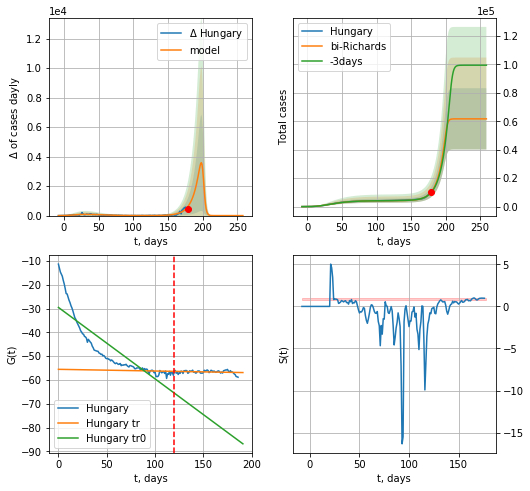

Hungary data at: 2020-09-09
+3 day model MAPE: 0.034288
model: bi-Richards
coeffs: [5.75230392e+04 1.00589766e-01 2.01490314e+02 6.04599036e+00]
rational stdev: 0.349284
forecast at the end of period: +80 days
	 deltaDaycases: 0
	 total cases: 61724 ± 21559
	 total death: 3815 ± 3997
bi-Richards approximation splitting point: 120
trend coefficient of determination: 0.760010
 intercept: -29.536318
 slope: -0.300031
trend coefficient of determination: 0.042414
 intercept: -55.543911
 slope: -0.007118


In [1130]:
vL = 120
x = forecastRR("Hungary",dfHG[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Hungary",dfHG[:],d1,35*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


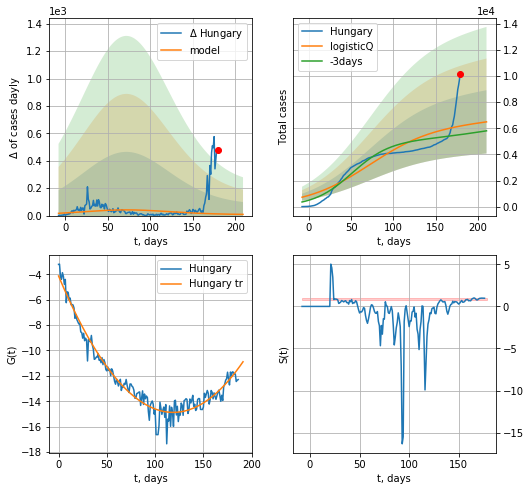

Hungary data at: 2020-09-09
+3 day model MAPE: 0.119998
model: logisticQ
coeffs: [ 6.19332151e+03  2.33867939e-08  7.12672759e+01 -1.11995004e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.373275
forecast at the end of period: +31 days
	 deltaDaycases: 8
	 total cases: 6494 ± 2424
	 total death: 401 ± 449
trend coefficient of determination: 0.957340
 intercept_: -4.132213380145123
 coeffs_: [ 0.         -0.18100044  0.00076243]


In [1131]:
x = forecastRRR("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='cases')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


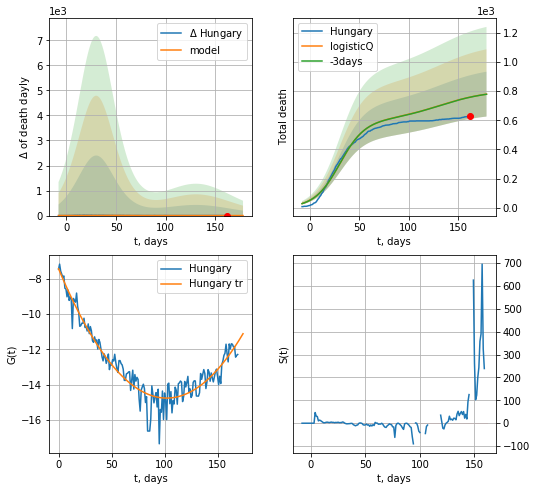

Hungary data at: 2020-09-09
+3 day model MAPE: 0.000971
model: logisticQ
coeffs: [ 5.96586982e+02  1.73508607e-07  3.02427253e+01 -4.53421178e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.197186
forecast at the end of period: +17 days
	 total death: 779 ± 153
trend coefficient of determination: 0.913993
 intercept_: -7.441460489339568
 coeffs_: [ 0.         -0.14352141  0.00070342]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: divide by zero encountered in true_divide


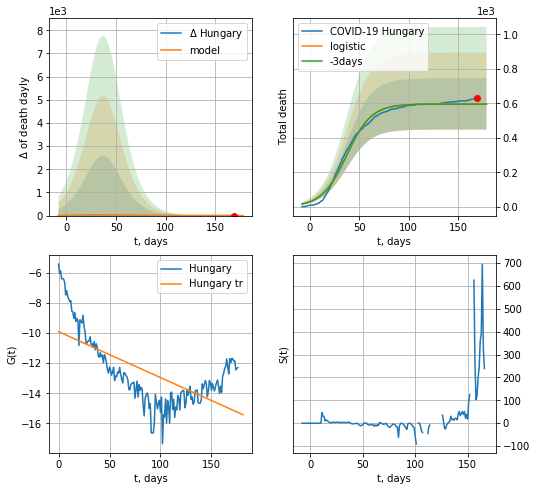

Hungary data at: 2020-09-09
+3 day model MAPE: 0.002051968688438155
model: logistic
coeffs:  [5.96216528e+02 7.95537238e-02 3.72435363e+01]
rational stdev:  0.2495483245741354
forecast at the end of period: +10 days
	 total death:  596 ± 148
trend coefficient of determination: 0.428312
 intercept: -9.908602
 slope: -0.030450


In [1132]:
x = forecastRRR("Hungary",dfHG[17:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')
x = forecast("Hungary",dfHG[10:],d1,T18*7-dT,cases='death')

MT
           date   cases  active  death
181 2020-09-05  2014.0     399   14.0
182 2020-09-06  2039.0     398   14.0
183 2020-09-07  2076.0     372   14.0
184 2020-09-08  2099.0     356   14.0
185 2020-09-09  2162.0     388   14.0


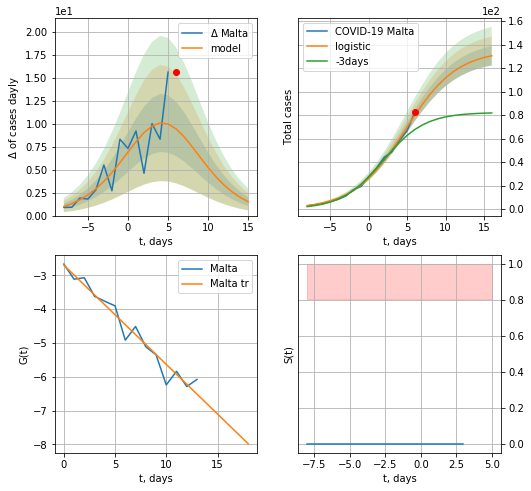

Malta data at: 2020-09-09
model: logistic
coeffs:  [135.01423457   0.29914202   4.75768623]
rational stdev:  0.06279874283082902
forecast at the end of period: +10 days
	 deltaDaycases:  1
	 total cases:  130 ± 8
	 total death:  0 ± 0
trend coefficient of determination: 0.952124
 intercept: -2.695789
 slope: -0.293811


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


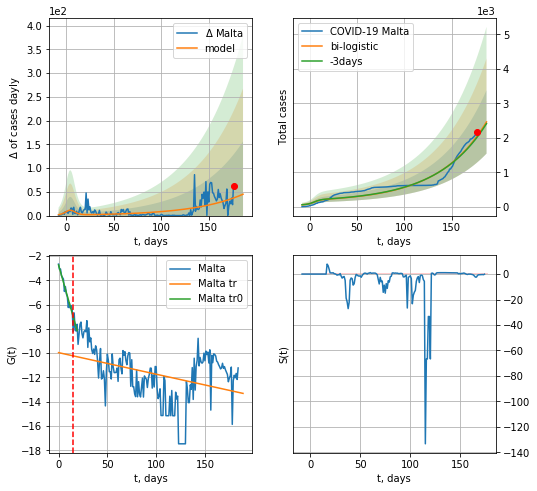

Malta data at: 2020-09-09
+3 day model MAPE: 0.0169092618974429
model: bi-logistic
coeffs:  [1.07391245e+07 1.95503516e-02 6.18609323e+02] [135.01423457   0.29914202   4.75768623]
scenario coeffs:  [0.125, 1.0, 1.8]
rational stdev:  0.37365295517879377
forecast at the end of period: +10 days
	 deltaDaycases:  44
	 total cases:  2459 ± 918
	 total death:  15 ± 16
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.953633
 intercept: -2.737437
 slope: -0.284200
trend coefficient of determination: 0.149565
 intercept: -9.953415
 slope: -0.017750


In [1133]:
try:
    dfMT = read_df(pd.DataFrame(),"MT")
    x = forecast("Malta",dfMT[:15],d1,7*T18-dT,pMAPE=False)
    xx = forecast2("Malta",dfMT[:],d1,7*T18-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


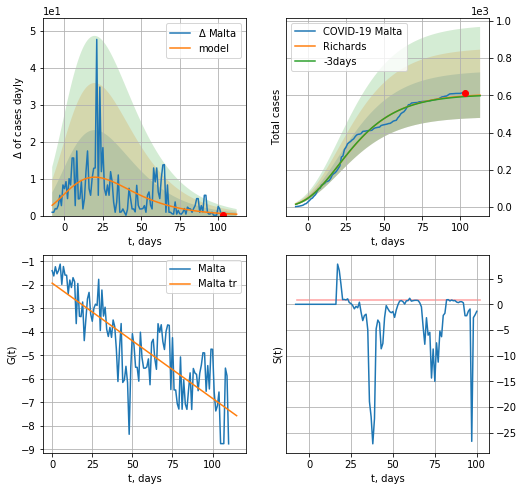

Malta data at: 2020-09-09
+3 day model MAPE: 0.004738
model: Richards
coeffs: [ 6.08571201e+02  8.24808839e+00 -9.10069288e+01  5.64853369e-03]
rational stdev: 0.203304
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 600 ± 122
	 total death: 3 ± 1
trend coefficient of determination: 0.678551
 intercept: -1.925365
 slope: -0.049026


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


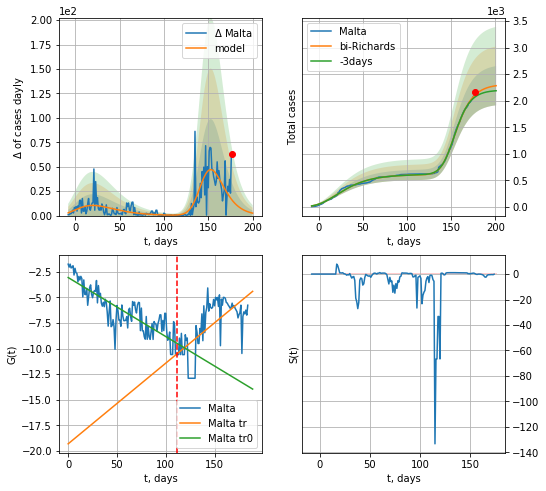

Malta data at: 2020-09-09
+3 day model MAPE: 0.019315
model: bi-Richards
coeffs: [1.70311120e+03 2.94961434e-01 1.38796060e+02 2.90237021e-01]
rational stdev: 0.161925
forecast at the end of period: +24 days
	 deltaDaycases: 2
	 total cases: 2283 ± 369
	 total death: 14 ± 6
bi-Richards approximation splitting point: 112
trend coefficient of determination: 0.723492
 intercept: -3.064010
 slope: -0.057606
trend coefficient of determination: 0.434117
 intercept: -19.296174
 slope: 0.078753


In [1134]:
vL = 112
x = forecastRR("Malta",dfMT[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Malta",dfMT[:],d1,27*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


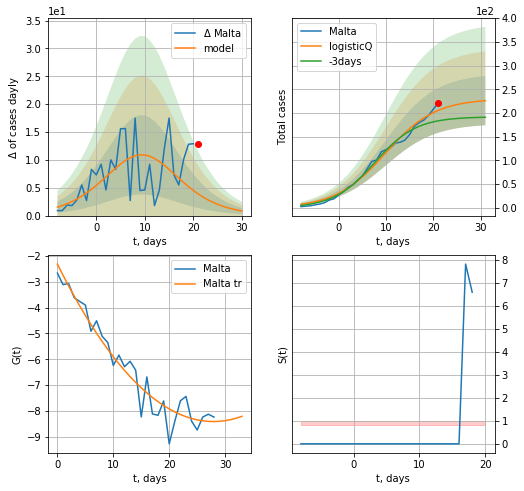

Malta data at: 2020-09-09
+3 day model MAPE: 0.130307
model: logisticQ
coeffs: [ 2.30072980e+02  3.58401181e-06  9.85050068e+00 -5.29673769e+04]
rational stdev: 0.229349
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 226 ± 51
	 total death: 1 ± 0
trend coefficient of determination: 0.934916
 intercept_: -2.3194397645380054
 coeffs_: [ 0.         -0.4365547   0.00782096]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


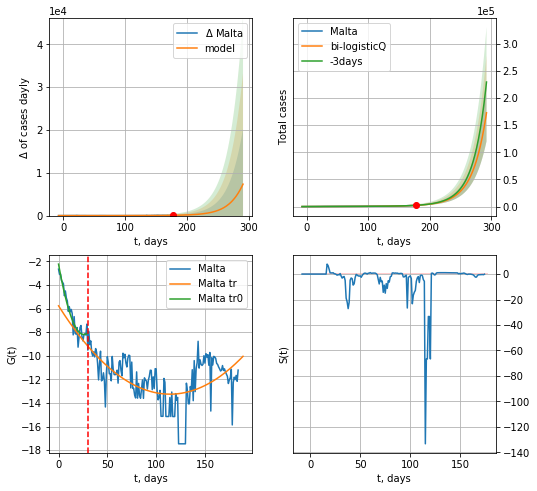

Malta data at: 2020-09-09
+3 day model MAPE: 0.028978
model: bi-logisticQ
coeffs: [ 1.74330647e+06  7.67465245e-05  3.34861179e+02 -3.79440008e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.305082
forecast at the end of period: +115 days
	 deltaDaycases: 7344
	 total cases: 172773 ± 52710
	 total death: 1118 ± 1023
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.927936
 intercept_: -2.238018849909004
 coeffs_: [ 0.         -0.46099164  0.00890422]
trend coefficient of determination: 0.291499
 intercept_: -5.770130237084552
 coeffs_: [ 0.         -0.13104077  0.00057363]


In [1135]:
x = forecastRRR("Malta",dfMT[:30],d1,T18*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1.])
xx = forecast2RRR("Malta",dfMT[:],d1,40*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=30)

SL
           date   cases  active  death
179 2020-09-05  4614.0  1775.0   37.0
180 2020-09-06  4636.0  1763.0   37.0
181 2020-09-07  4727.0  1763.0   37.0
182 2020-09-08  4888.0  1904.0   37.0
183 2020-09-09  5088.0  2028.0   37.0


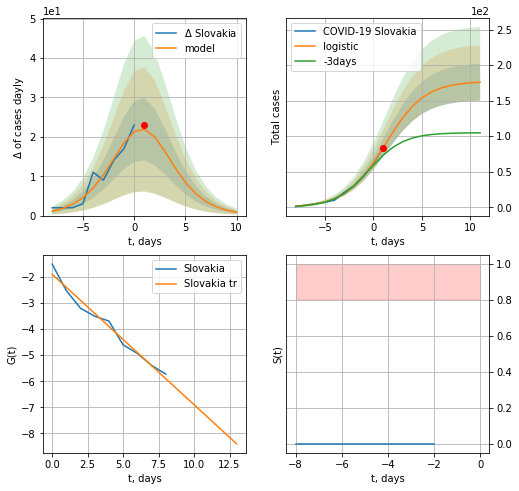

Slovakia data at: 2020-09-09
model: logistic
coeffs:  [177.28786061   0.49967231   1.23158076]
rational stdev:  0.14723855931524674
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  175 ± 25
	 total death:  1 ± 0
trend coefficient of determination: 0.974721
 intercept: -1.894823
 slope: -0.500610


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


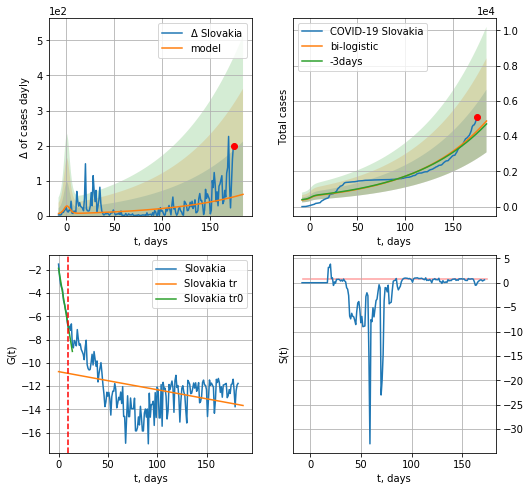

Slovakia data at: 2020-09-09
+3 day model MAPE: 0.031425410789724446
model: bi-logistic
coeffs:  [1.03868282e+07 1.30450623e-02 7.75602087e+02] [177.28786061   0.49967231   1.23158076]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.3661984640974908
forecast at the end of period: +10 days
	 deltaDaycases:  60
	 total cases:  4858 ± 1779
	 total death:  36 ± 39
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.981202
 intercept: -1.868036
 slope: -0.510655
trend coefficient of determination: 0.145614
 intercept: -10.758362
 slope: -0.015584


In [1189]:
dfSL = read_df(pd.DataFrame(),"SL")
dfSL = dfSL.fillna(0)
try:
    x = forecast("Slovakia",dfSL[:10],d1,T18*7-dT,pMAPE=False)
    xx = forecast2("Slovakia",dfSL[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)
except:
    print("Exception ocurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


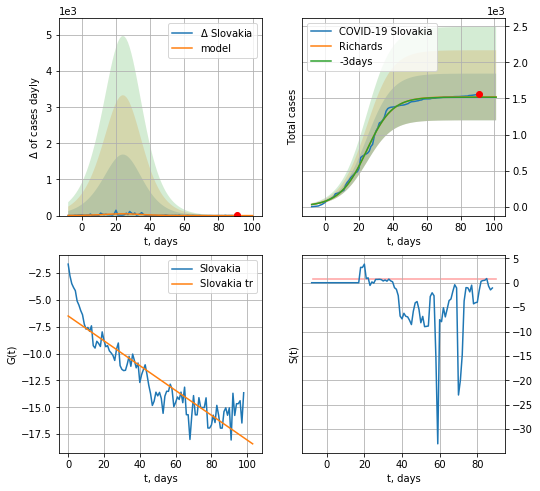

Slovakia data at: 2020-09-09
+3 day model MAPE: 0.002372
model: Richards
coeffs: [1.52109568e+03 1.16938732e-01 2.55808264e+01 1.14750291e+00]
rational stdev: 0.212800
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 1521 ± 323
	 total death: 11 ± 7
trend coefficient of determination: 0.817560
 intercept: -6.499033
 slope: -0.115624


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


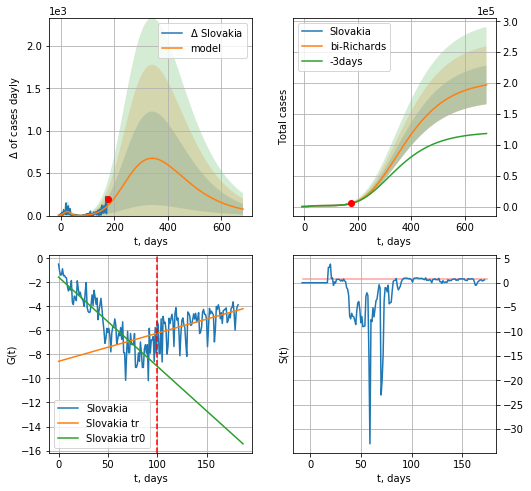

Slovakia data at: 2020-09-09
+3 day model MAPE: 0.012761
model: bi-Richards
coeffs: [2.03759319e+05 1.25151891e-01 6.49824157e+01 7.47973100e-02]
rational stdev: 0.158981
forecast at the end of period: +507 days
	 deltaDaycases: 75
	 total cases: 197017 ± 31322
	 total death: 1491 ± 711
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.803729
 intercept: -1.568006
 slope: -0.074175
trend coefficient of determination: 0.246869
 intercept: -8.576146
 slope: 0.023399


In [1190]:
vL = 100
x = forecastRR("Slovakia",dfSL[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovakia",dfSL[:],d12f(1),96*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


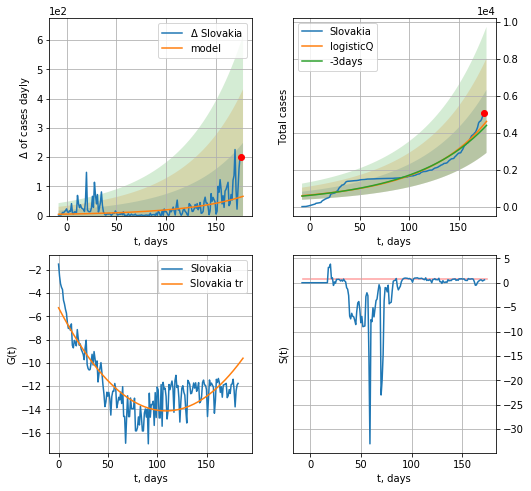

Slovakia data at: 2020-09-09
+3 day model MAPE: 0.046227
model: logisticQ
coeffs: [ 4.63273752e+06  1.80645539e-05  5.15098723e+02 -9.56701309e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.369576
forecast at the end of period: +3 days
	 deltaDaycases: 65
	 total cases: 4618 ± 1706
	 total death: 34 ± 37
trend coefficient of determination: 0.740021
 intercept_: -5.26088117904964
 coeffs_: [ 0.         -0.1628351   0.00074663]


In [1191]:
x = forecastRRR("Slovakia",dfSL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

SV
           date   cases  active  death
184 2020-09-05  3165.0   547.0  135.0
185 2020-09-06  3190.0   525.0  135.0
186 2020-09-07  3250.0   525.0  135.0
187 2020-09-08  3312.0   590.0  135.0
188 2020-09-09  3312.0   590.0  135.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


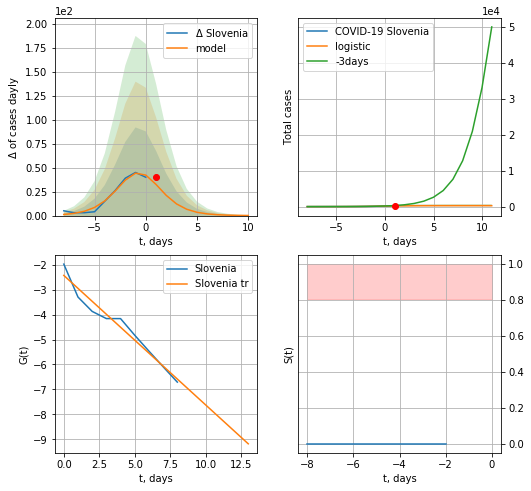

Slovenia data at: 2020-09-09
model: logistic
coeffs:  [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
rational stdev:  0.5312441686508605
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  260 ± 138
	 total death:  10 ± 15
trend coefficient of determination: 0.958485
 intercept: -2.427236
 slope: -0.519636
Exception occurs


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:485: RuntimeWarning: divide by zero encountered in log


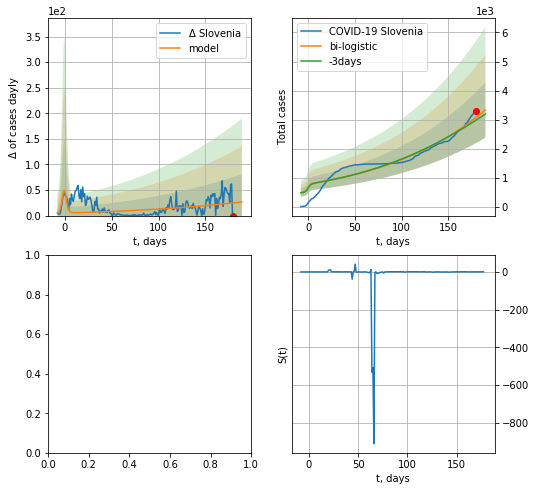

In [1137]:
dfSV = read_df(pd.DataFrame(),"SV").fillna(0)
try:
    x = forecast("Slovenia",dfSV[:10],d1,7*T18-dT,pMAPE=False)
    xx = forecast2("Slovenia",dfSV[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


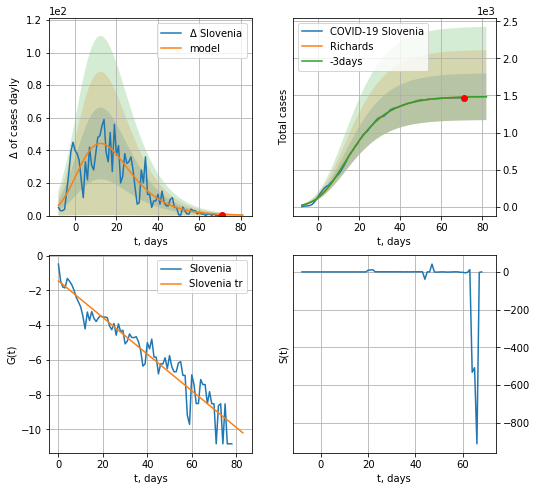

Slovenia data at: 2020-09-08
+3 day model MAPE: 0.001063
model: Richards
coeffs: [ 1.48543612e+03  5.20176508e-01 -7.42026148e+00  1.68829761e-01]
rational stdev: 0.211962
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 1482 ± 314
	 total death: 60 ± 38
trend coefficient of determination: 0.919511
 intercept: -1.449330
 slope: -0.105393


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


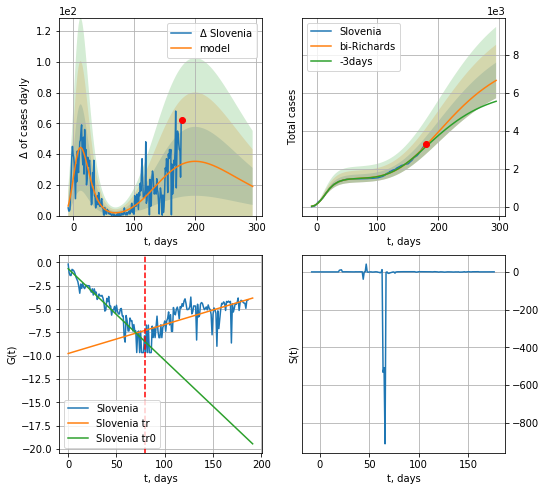

Slovenia data at: 2020-09-08
+3 day model MAPE: 0.020850
model: bi-Richards
coeffs: [ 6.63729608e+03  1.29434636e+00 -1.08381527e+02  1.12331909e-02]
rational stdev: 0.141403
forecast at the end of period: +116 days
	 deltaDaycases: 18
	 total cases: 6643 ± 939
	 total death: 270 ± 114
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.909256
 intercept: -0.694303
 slope: -0.098204
trend coefficient of determination: 0.397979
 intercept: -9.776816
 slope: 0.031086


In [720]:
vL = 80
x = forecastRR("Slovenia",dfSV[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovenia",dfSV[:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

[0.35416971, 0.02606324, 4.35859408, 19.30413219]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


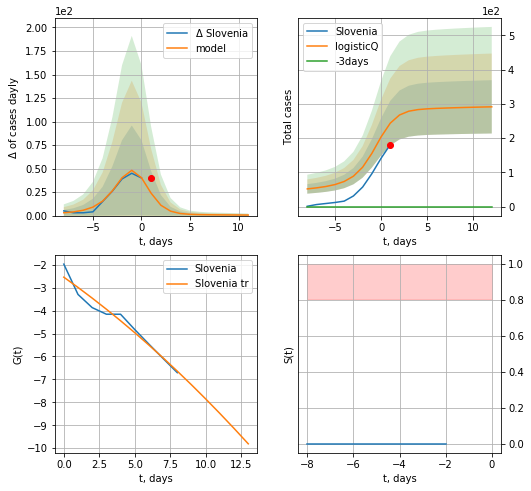

Slovenia data at: 2020-09-08
+3 day model MAPE: inf
model: logisticQ
coeffs: [ 2.17965797e+02  4.01733259e-02 -2.21208421e+01 -7.00287218e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.266979
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 291 ± 77
	 total death: 11 ± 8
trend coefficient of determination: 0.956027
 intercept_: -2.543480478113449
 coeffs_: [ 0.         -0.43771568 -0.00932819]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:234: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


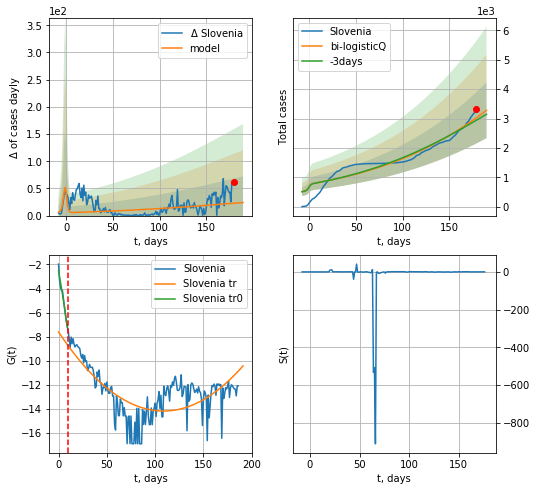

Slovenia data at: 2020-09-08
+3 day model MAPE: 0.029217
model: bi-logisticQ
coeffs: [ 1.33934130e+04  2.75022781e-07  3.09145555e+02 -3.70917552e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.288885
forecast at the end of period: +11 days
	 deltaDaycases: 24
	 total cases: 3279 ± 947
	 total death: 133 ± 115
bi-logisticQ approximation splitting point: 10
trend coefficient of determination: 0.968209
 intercept_: -2.53431844604435
 coeffs_: [ 0.         -0.45029183 -0.00732028]
trend coefficient of determination: 0.514075
 intercept_: -7.6116560219315055
 coeffs_: [ 0.         -0.12059717  0.00055429]


In [721]:
print(koreaCoeffs)
x = forecastRRR("Slovenia",dfSV[:10],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
xx = forecast2RRR("Slovenia",dfSV[:],d1,T18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=10)

SB
           date  cases  active  death
179 2020-09-05  31849   597.0  723.0
180 2020-09-06  31905   544.0  724.0
181 2020-09-07  31941   579.0  725.0
182 2020-09-08  31994   630.0  727.0
183 2020-09-09  32078   570.0  728.0


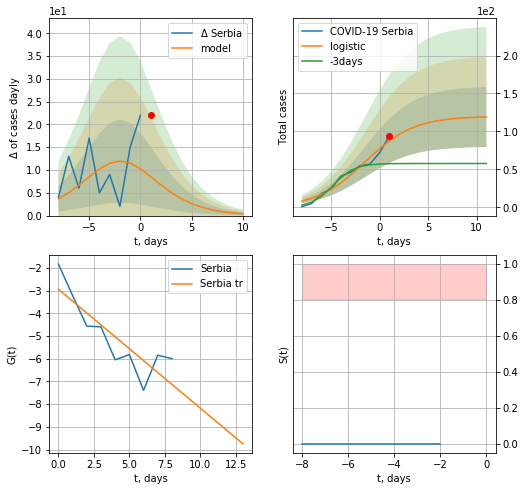

Serbia data at: 2020-09-09
model: logistic
coeffs:  [119.86808879   0.40041875  -1.48148474]
rational stdev:  0.33210329199703215
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  119 ± 39
	 total death:  2 ± 1
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


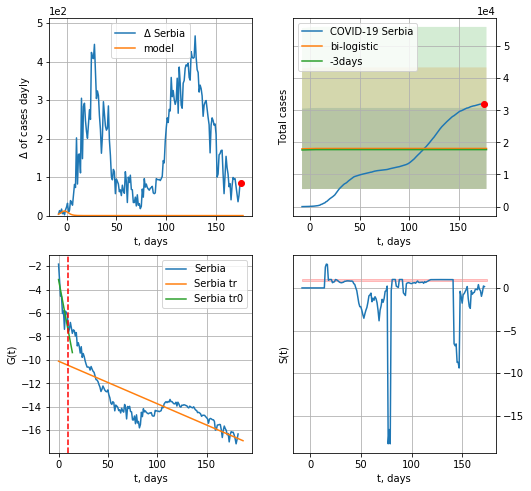

Serbia data at: 2020-09-09
+3 day model MAPE: 0.020425647402294685
model: bi-logistic
coeffs:  [14390.06497326   -60.20175509   186.5754342 ] [119.86808879   0.40041875  -1.48148474]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  0.6966219740880224
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  18107 ± 12614
	 total death:  410 ± 856
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.659847
 intercept: -10.114272
 slope: -0.036257


In [1138]:
dfSB = read_df(pd.DataFrame(),"SB")
dfSB = dfSB.fillna(0)
x = forecast("Serbia",dfSB[:10],d1,T18*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,24*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


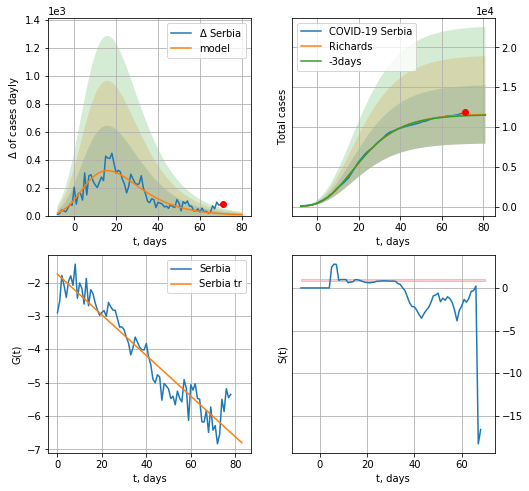

Serbia data at: 2020-09-09
+3 day model MAPE: 0.006988
model: Richards
coeffs: [ 1.16624341e+04  1.86550219e+00 -2.54632436e+01  4.09637438e-02]
rational stdev: 0.315870
forecast at the end of period: +10 days
	 deltaDaycases: 6
	 total cases: 11579 ± 3657
	 total death: 262 ± 248
trend coefficient of determination: 0.902509
 intercept: -1.751737
 slope: -0.060887


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


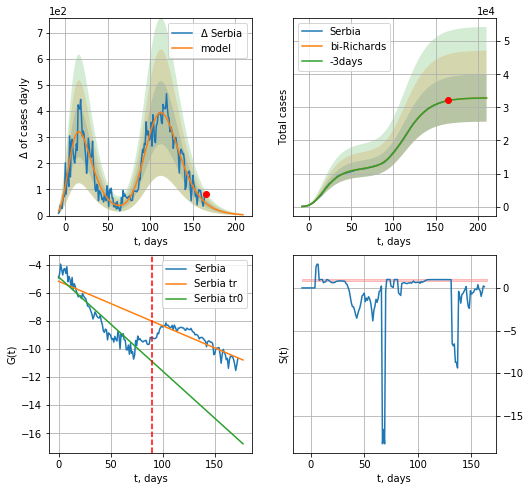

Serbia data at: 2020-09-09
+3 day model MAPE: 0.000012
model: bi-Richards
coeffs: [2.12278608e+04 1.34666601e-01 1.00180545e+02 4.57130517e-01]
rational stdev: 0.217810
forecast at the end of period: +45 days
	 deltaDaycases: 3
	 total cases: 32836 ± 7152
	 total death: 745 ± 486
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.864165
 intercept: -4.875037
 slope: -0.067068
trend coefficient of determination: 0.725092
 intercept: -5.187051
 slope: -0.031633


In [1139]:
iL=10
vL=90+iL
x = forecastRR("Serbia",dfSB[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Serbia",dfSB[iL:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


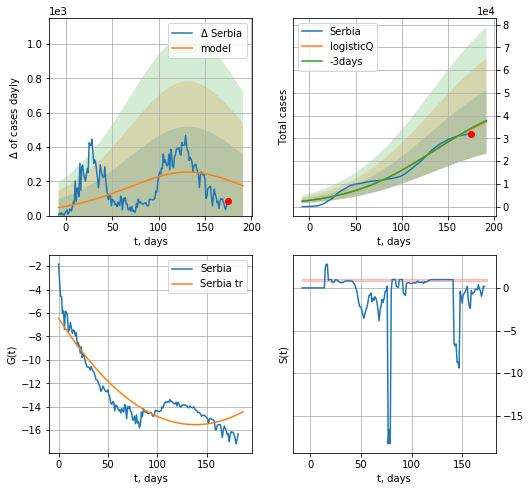

Serbia data at: 2020-09-09
+3 day model MAPE: 0.011711
model: logisticQ
coeffs: [ 4.71338428e+04  2.31902644e-07  1.31673136e+02 -9.21320464e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.374014
forecast at the end of period: +17 days
	 deltaDaycases: 174
	 total cases: 37243 ± 13929
	 total death: 845 ± 948
trend coefficient of determination: 0.827670
 intercept_: -6.442842094635949
 coeffs_: [ 0.         -0.13103467  0.00047269]


In [1140]:
x = forecastRRR("Serbia",dfSB[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CT
           date    cases  active  death
189 2020-09-05  11964.0  2758.0  198.0
190 2020-09-06  12081.0  2614.0  201.0
191 2020-09-07  12285.0  2614.0  201.0
192 2020-09-08  12626.0  2587.0  206.0
193 2020-09-09  12917.0  2567.0  208.0


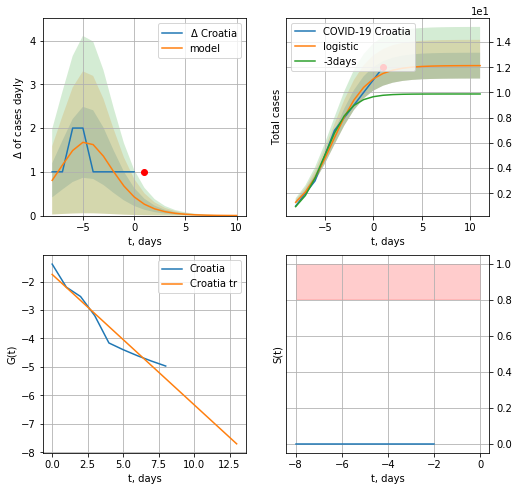

Croatia data at: 2020-09-09
model: logistic
coeffs:  [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.08430442468045289
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  12 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.936719
 intercept: -1.749041
 slope: -0.458074


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


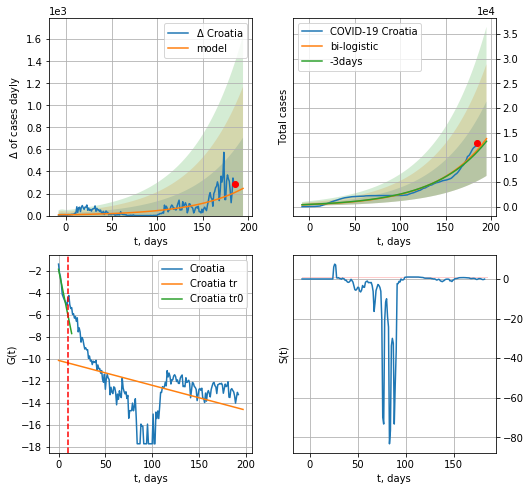

Croatia data at: 2020-09-09
+3 day model MAPE: 0.03367237055979303
model: bi-logistic
coeffs:  [5.25633004e+07 1.80658584e-02 6.51534522e+02] [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.5481464053957862
forecast at the end of period: +10 days
	 deltaDaycases:  246
	 total cases:  13772 ± 7549
	 total death:  224 ± 368
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.922384
 intercept: -1.856940
 slope: -0.417612
trend coefficient of determination: 0.189961
 intercept: -10.151142
 slope: -0.022632


In [1186]:
try:
    dfCT = read_df(pd.DataFrame(),"CT")
    dfCT = dfCT.fillna(0)
    x = forecast("Croatia",dfCT[:10],d1,T18*7-dT,pMAPE=False)
    xx = forecast2("Croatia",dfCT[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25/2,1.,2.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


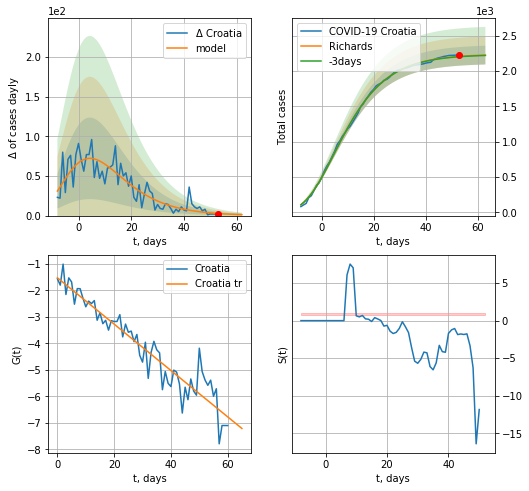

Croatia data at: 2020-09-09
+3 day model MAPE: 0.002310
model: Richards
coeffs: [ 2.23963098e+03  7.95198453e+00 -4.62549964e+01  1.10913889e-02]
rational stdev: 0.059687
forecast at the end of period: +10 days
	 deltaDaycases: 1
	 total cases: 2226 ± 132
	 total death: 36 ± 6
trend coefficient of determination: 0.897394
 intercept: -1.522030
 slope: -0.087533


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


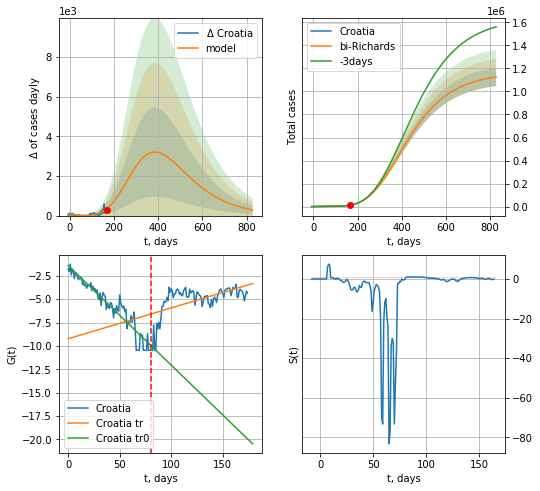

Croatia data at: 2020-09-09
+3 day model MAPE: 0.004335
model: bi-Richards
coeffs: [1.16089682e+06 1.32807605e-01 1.69806197e+01 5.82276604e-02]
rational stdev: 0.070009
forecast at the end of period: +661 days
	 deltaDaycases: 282
	 total cases: 1126112 ± 78838
	 total death: 18373 ± 3858
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.905542
 intercept: -1.409068
 slope: -0.106487
trend coefficient of determination: 0.323374
 intercept: -9.238830
 slope: 0.032984


In [1187]:
iL = 18
vL = 80+iL
x = forecastRR("Croatia",dfCT[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Croatia",dfCT[iL:],d1,118*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


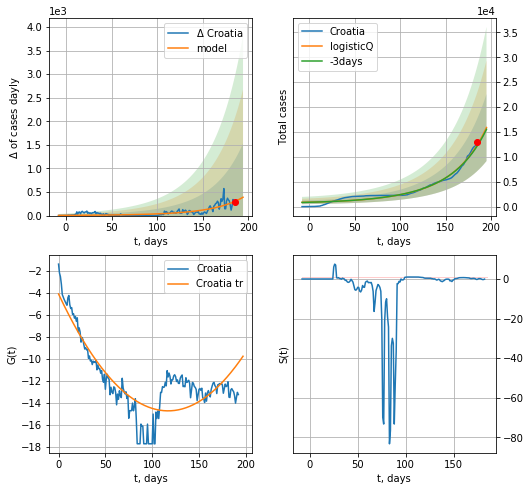

Croatia data at: 2020-09-09
+3 day model MAPE: 0.017294
model: logisticQ
coeffs: [ 1.74112734e+07  5.16776673e-05  3.94062280e+02 -4.85333216e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.424032
forecast at the end of period: +10 days
	 deltaDaycases: 389
	 total cases: 15884 ± 6735
	 total death: 259 ± 329
trend coefficient of determination: 0.727781
 intercept_: -4.104833740760627
 coeffs_: [ 0.         -0.18178865  0.00077682]


In [1188]:
x = forecastRRR("Croatia",dfCT[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

EG
           date   cases  active   death
183 2020-09-05   99712   16993  5511.0
184 2020-09-06   99863   16225  5530.0
185 2020-09-07  100041   15492  5541.0
186 2020-09-08  100228   14782  5560.0
187 2020-09-09  100403   14137  5577.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


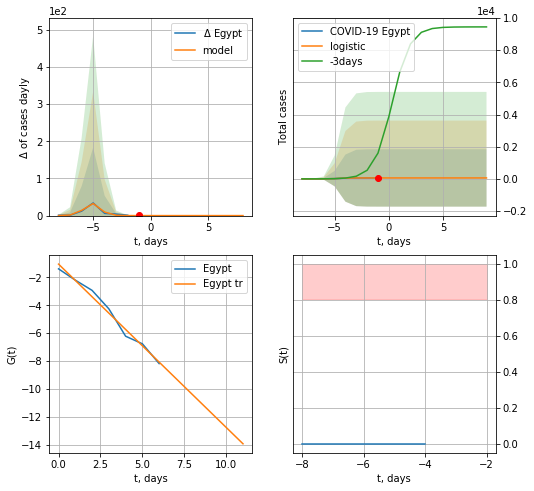

Egypt data at: 2020-09-09
+3 day model MAPE: 0.9848539099062313
model: logistic
coeffs:  [58.57021122  2.53530653 -4.60228222]
rational stdev:  30.428321363178444
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  58 ± 1782
	 total death:  3 ± 273
trend coefficient of determination: 0.982412
 intercept: -1.045837
 slope: -1.172929


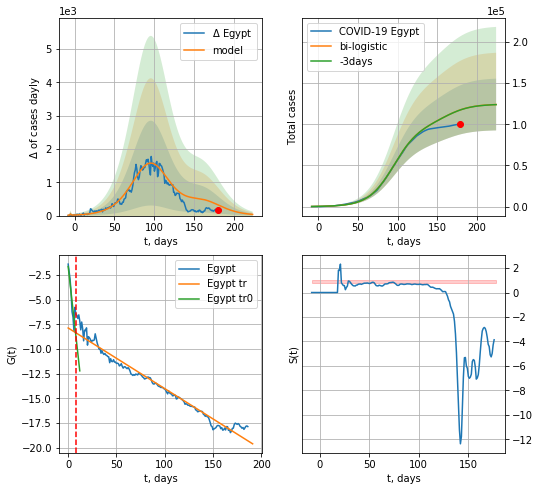

Egypt data at: 2020-09-09
+3 day model MAPE: 0.0007754538485752558
model: bi-logistic
coeffs:  [9.96525776e+04 6.22814219e-02 9.54620482e+01] [58.57021122  2.53530653 -4.60228222]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.25345046690185224
forecast at the end of period: +45 days
	 deltaDaycases:  34
	 total cases:  124068 ± 31445
	 total death:  6891 ± 5239
bi-logistic approximation splitting point: 8
trend0 coefficient of determination: 0.807637
 intercept: -1.627174
 slope: -0.882261
trend coefficient of determination: 0.968286
 intercept: -7.863904
 slope: -0.061537


In [1142]:
dfEG = read_df(pd.DataFrame(),"EG")
x = forecast("Egypt",dfEG[:8],d1,7*T18-dT)
xx = forecast2("Egypt",dfEG[:],d1,30*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


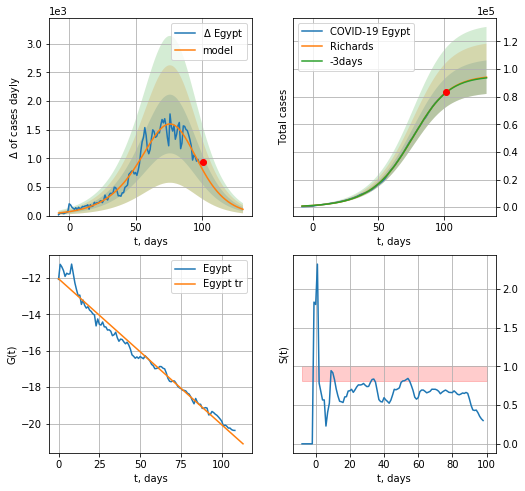

Egypt data at: 2020-09-09
+3 day model MAPE: 0.001990
model: Richards
coeffs: [9.54401202e+04 5.36014520e-02 8.09042623e+01 1.40276042e+00]
rational stdev: 0.128907
forecast at the end of period: +31 days
	 deltaDaycases: 109
	 total cases: 94006 ± 12118
	 total death: 5221 ± 2019
trend coefficient of determination: 0.980830
 intercept: -12.038020
 slope: -0.080319


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


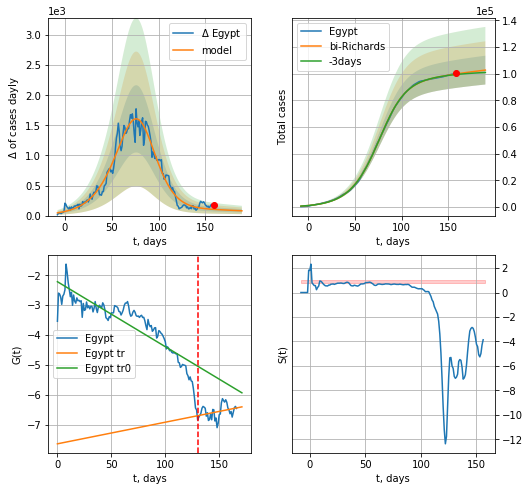

Egypt data at: 2020-09-09
+3 day model MAPE: 0.004861
model: bi-Richards
coeffs: [ 1.26813276e+04  2.20166446e+00 -8.64118682e+01  8.74786408e-03]
rational stdev: 0.105057
forecast at the end of period: +31 days
	 deltaDaycases: 79
	 total cases: 102694 ± 10788
	 total death: 5704 ± 1797
bi-Richards approximation splitting point: 130
trend coefficient of determination: 0.785633
 intercept: -2.213711
 slope: -0.021735
trend coefficient of determination: 0.111720
 intercept: -7.636955
 slope: 0.007229


In [1143]:
iL = 20
vL = 130+iL
x = forecastRR("Egypt",dfEG[iL:vL-iL],d1,28*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Egypt",dfEG[iL:],d1,28*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


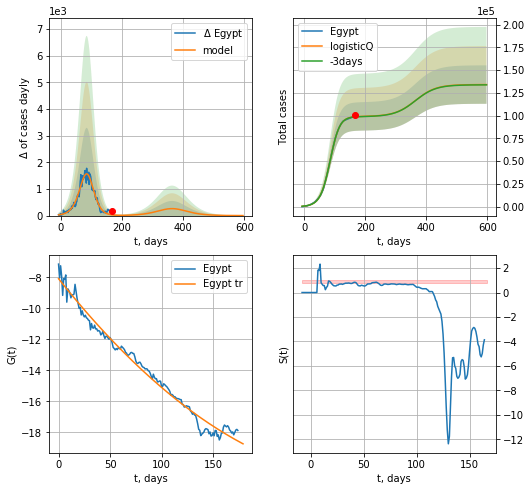

Egypt data at: 2020-09-09
+3 day model MAPE: 0.002034
model: logisticQ
coeffs: [ 9.90861569e+04  6.08269236e-05  8.34472501e+01 -9.54719975e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.157301
forecast at the end of period: +430 days
	 deltaDaycases: 0
	 total cases: 134148 ± 21101
	 total death: 7451 ± 3516
trend coefficient of determination: 0.983014
 intercept_: -8.09629391411651
 coeffs_: [ 0.         -0.08348083  0.00013451]


In [1144]:
x = forecastRRR("Egypt",dfEG[12:],d1,85*7-dT,addpred=True,xcoef=koreaCoeffs)

IQ
           date   cases   active   death
186 2020-09-05  256719  54038.0  7422.0
187 2020-09-06  260370  54298.0  7512.0
188 2020-09-07  264684  54236.0  7589.0
189 2020-09-08  269578  55597.0  7657.0
190 2020-09-09  273821  56096.0  7732.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


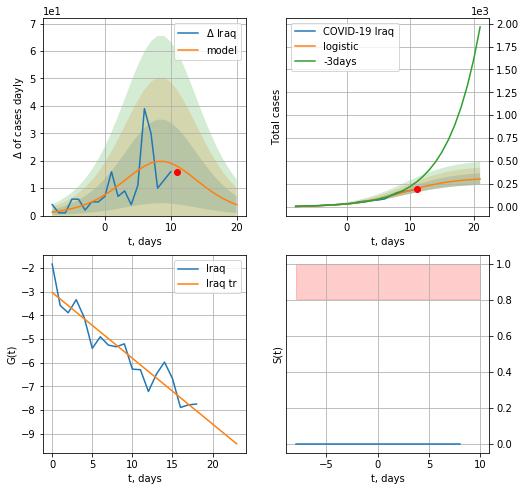

Iraq data at: 2020-09-09
+3 day model MAPE: 0.34474037669474106
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +10 days
	 deltaDaycases:  3
	 total cases:  302 ± 62
	 total death:  8 ± 4
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


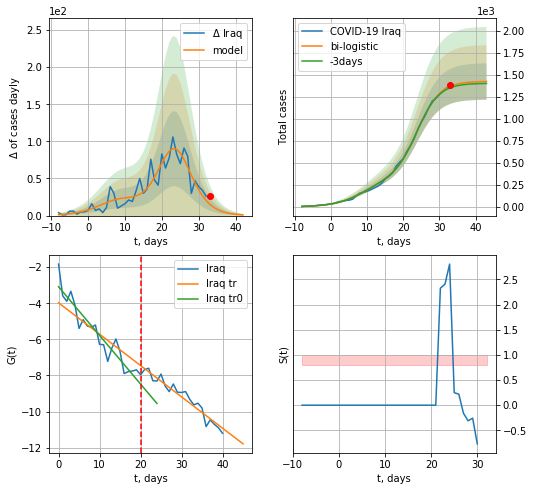

Iraq data at: 2020-09-09
+3 day model MAPE: 0.012548655608678476
model: bi-logistic
coeffs:  [1.10877596e+03 3.20225975e-01 2.39035989e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.14537179336300032
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  1423 ± 206
	 total death:  40 ± 17
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.928562
 intercept: -3.976586
 slope: -0.173518


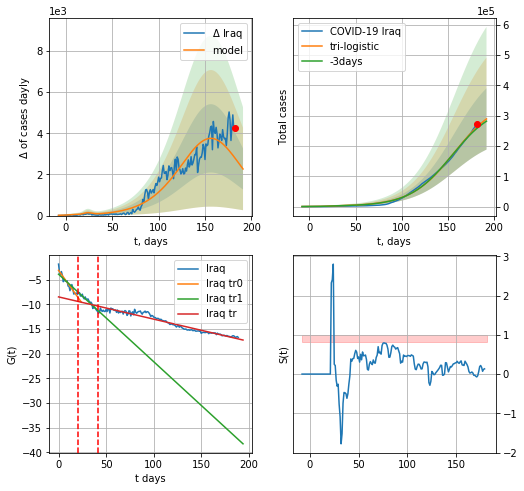

Iraq data at: 2020-09-09
+3 day model MAPE: 0.019364002387271855
model: tri-logistic
coeffs:  [3.51633352e+05 4.27048103e-02 1.56799023e+02] [3.17081296e+02 2.50431387e-01 8.98163530e+00 1.10877596e+03
 3.20225975e-01 2.39035989e+01]
forecast rational stdev:  0.34973991881303107
forecast at the end of period: +10 days
	 deltaDaycases:  2265
	 total cases:  289082 ± 101103
	 total death:  8162 ± 8563
tri-logistic approximation splitting points: 20,42
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend1 coefficient of determination: 0.937217
 intercept: -3.879636
 slope: -0.177153
trend coefficient of determination: 0.943174
 intercept: -8.475318
 slope: -0.045060


In [1145]:
vL=20
vL1=42
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIQ = dfIQ.fillna(0)
x = forecast("Iraq",dfIQ[:vL],d1,T18*7-dT)
xx = forecast2("Iraq",dfIQ[:vL1],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Iraq",dfIQ[:],d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


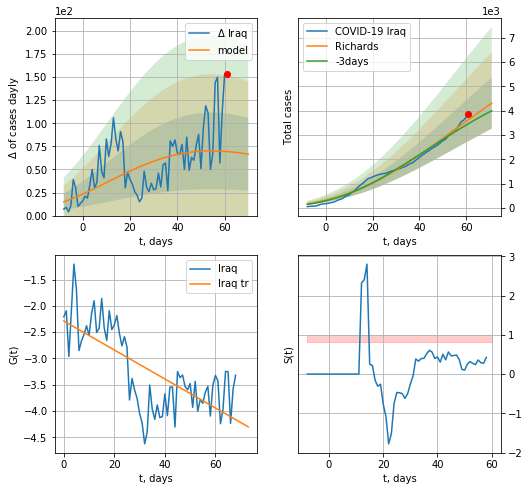

Iraq data at: 2020-09-09
+3 day model MAPE: 0.049876
model: Richards
coeffs: [ 8.66913850e+03  2.11659471e+00 -1.51652885e+02  1.04324891e-02]
rational stdev: 0.242987
forecast at the end of period: +10 days
	 deltaDaycases: 66
	 total cases: 4306 ± 1046
	 total death: 121 ± 88
trend coefficient of determination: 0.498225
 intercept: -2.287589
 slope: -0.027573


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


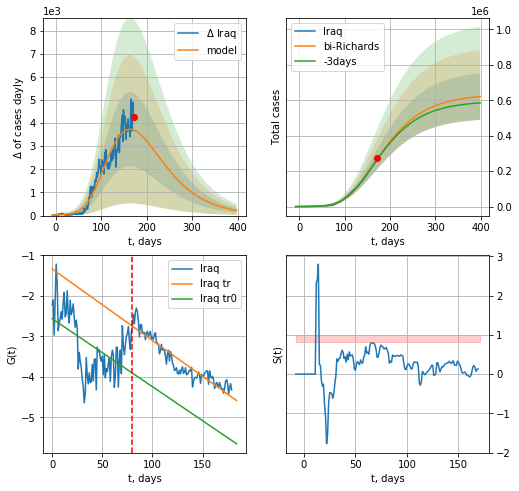

Iraq data at: 2020-09-09
+3 day model MAPE: 0.009455
model: bi-Richards
coeffs: [ 6.25532446e+05  1.28454401e+00 -1.04597598e+02  1.26540282e-02]
rational stdev: 0.211203
forecast at the end of period: +227 days
	 deltaDaycases: 220
	 total cases: 620578 ± 131068
	 total death: 17523 ± 11102
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.277738
 intercept: -2.564202
 slope: -0.016780
trend coefficient of determination: 0.876467
 intercept: -1.336729
 slope: -0.017659


In [1146]:
iL = 10
vL=80+iL#25+10
x = forecastRR("Iraq",dfIQ[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iraq",dfIQ[iL:],d1,56*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

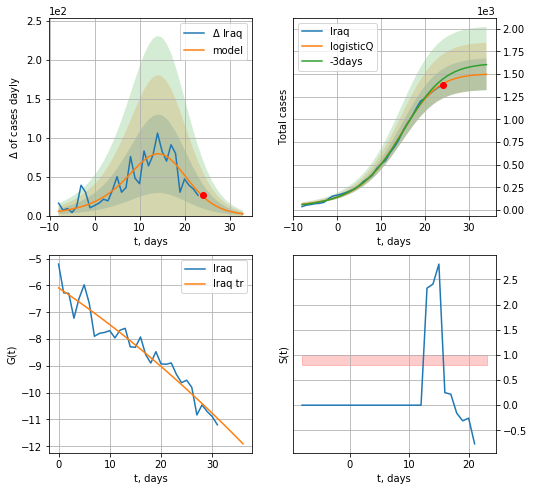

Iraq data at: 2020-09-09
+3 day model MAPE: 0.041008
model: logisticQ
coeffs: [ 1.50291917e+03  2.94853842e-03  1.34415511e+01 -5.72228370e+01]
rational stdev: 0.116469
forecast at the end of period: +10 days
	 deltaDaycases: 2
	 total cases: 1496 ± 174
	 total death: 42 ± 14
trend coefficient of determination: 0.930646
 intercept_: -6.090644942877015
 coeffs_: [ 0.         -0.12791486 -0.00093535]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


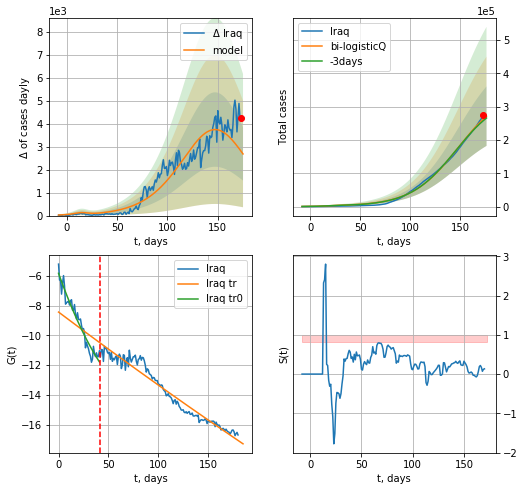

Iraq data at: 2020-09-09
+3 day model MAPE: 0.019442
model: bi-logisticQ
coeffs: [ 3.51009865e+05  3.23729370e-07  1.47731647e+02 -1.31991749e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.328668
forecast at the end of period: +3 days
	 deltaDaycases: 2689
	 total cases: 271860 ± 89351
	 total death: 7676 ± 7568
bi-logisticQ approximation splitting point: 42
trend coefficient of determination: 0.941003
 intercept_: -5.824005146615983
 coeffs_: [ 0.         -0.18682641  0.00101526]
trend coefficient of determination: 0.952350
 intercept_: -8.42866400832834
 coeffs_: [ 0.00000000e+00 -5.04292369e-02  1.38653309e-05]


In [1147]:
x = forecastRRR("Iraq",dfIQ[9:42],d1,T18*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
xx = forecast2RRR("Iraq",dfIQ[9:],d1,24*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=42)

In [1148]:
#len(dfAR)

AR
           date    cases   active   death
185 2020-09-05  46071.0  12041.0  1549.0
186 2020-09-06  46364.0  12063.0  1556.0
187 2020-09-07  46653.0  12106.0  1562.0
188 2020-09-08  46938.0  12184.0  1571.0
189 2020-09-09  47216.0  12256.0  1581.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


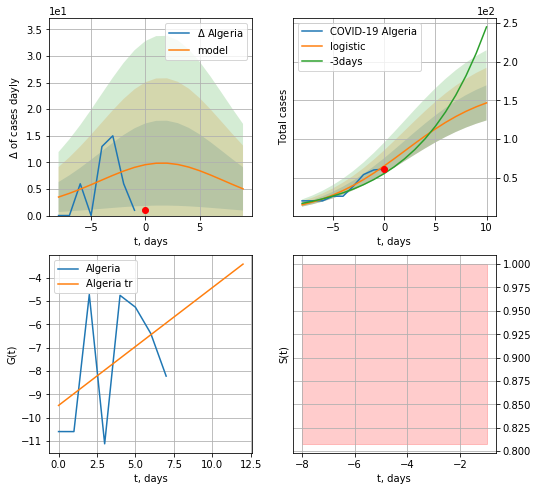

Algeria data at: 2020-09-09
+3 day model MAPE: 0.16392519582549905
model: logistic
coeffs:  [169.67149558   0.23328995   2.04236169]
rational stdev:  0.1546785167835457
forecast at the end of period: +10 days
	 deltaDaycases:  5
	 total cases:  146 ± 22
	 total death:  4 ± 1
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


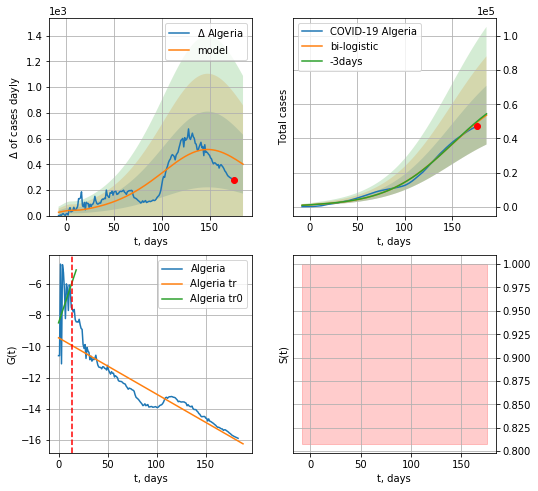

Algeria data at: 2020-09-09
+3 day model MAPE: 0.010797708311581163
model: bi-logistic
coeffs:  [7.00839745e+04 2.89856594e-02 1.47569886e+02] [169.67149558   0.23328995   2.04236169]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3212464913860778
forecast at the end of period: +10 days
	 deltaDaycases:  400
	 total cases:  53643 ± 17232
	 total death:  1796 ± 1730
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.867661
 intercept: -9.452091
 slope: -0.036162


In [1149]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,7*T18-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*T18-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


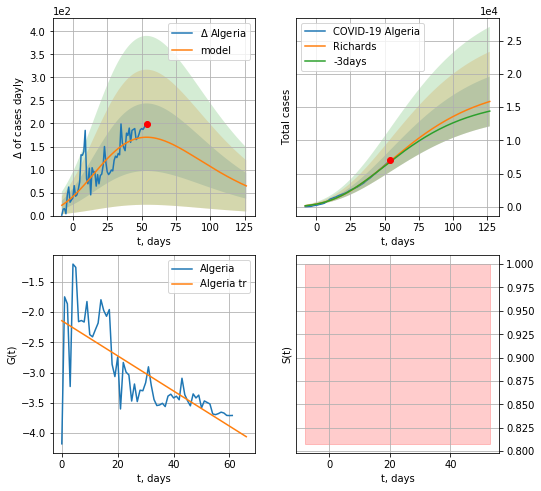

Algeria data at: 2020-09-09
+3 day model MAPE: 0.017361
model: Richards
coeffs: [ 1.86312269e+04  1.59750196e+00 -1.12063742e+02  1.56623086e-02]
rational stdev: 0.235608
forecast at the end of period: +73 days
	 deltaDaycases: 64
	 total cases: 15860 ± 3736
	 total death: 531 ± 375
trend coefficient of determination: 0.563244
 intercept: -2.140644
 slope: -0.029042


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


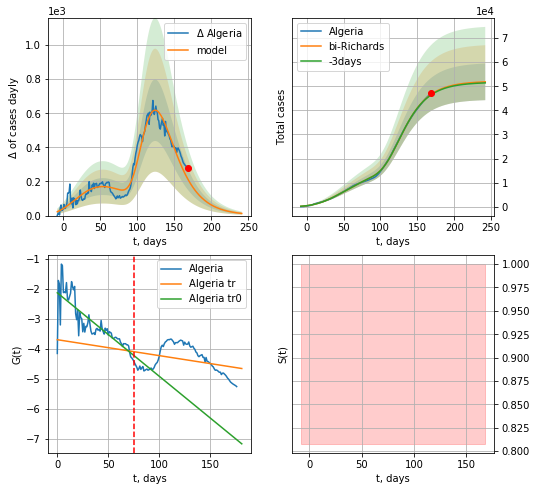

Algeria data at: 2020-09-09
+3 day model MAPE: 0.004204
model: bi-Richards
coeffs: [3.35409986e+04 3.83093585e+00 2.69410016e+01 1.17384114e-02]
rational stdev: 0.146637
forecast at the end of period: +73 days
	 deltaDaycases: 12
	 total cases: 51824 ± 7599
	 total death: 1735 ± 763
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.671913
 intercept: -2.140622
 slope: -0.027763
trend coefficient of determination: 0.116483
 intercept: -3.701138
 slope: -0.005296


In [1150]:
vL = 75+12
x = forecastRR("Algeria",dfAR[12:vL-12],d1,34*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Algeria",dfAR[12:],d1,34*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


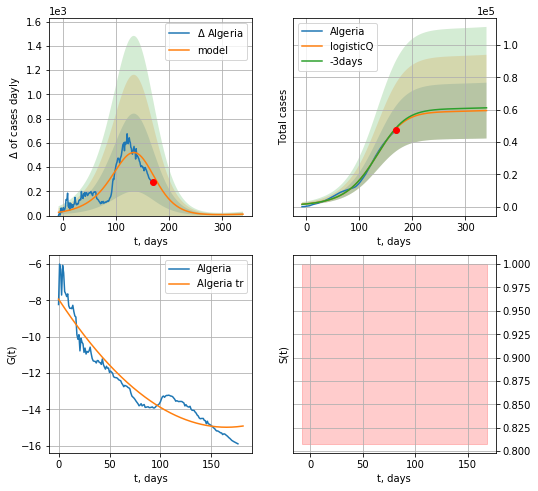

Algeria data at: 2020-09-09
+3 day model MAPE: 0.008750
model: logisticQ
coeffs: [ 5.86440472e+04  6.18866684e-05  1.28449970e+02 -4.39334797e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.290142
forecast at the end of period: +171 days
	 deltaDaycases: 11
	 total cases: 59513 ± 17267
	 total death: 1992 ± 1733
trend coefficient of determination: 0.917192
 intercept_: -7.92659864541507
 coeffs_: [ 0.         -0.08561331  0.00025964]


In [1151]:
x = forecastRRR("Algeria",dfAR[12:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

CP
           date   cases  active  death
177 2020-09-05  1507.0   249.0   21.0
178 2020-09-06  1509.0   251.0   21.0
179 2020-09-07  1510.0   251.0   22.0
180 2020-09-08  1511.0   252.0   22.0
181 2020-09-09  1514.0   255.0   22.0


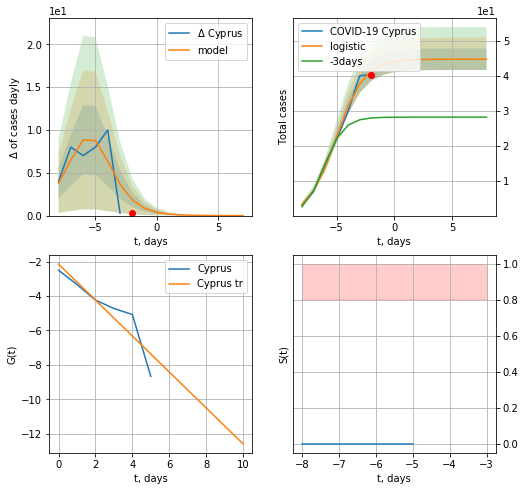

Cyprus data at: 2020-09-09
+3 day model MAPE: 0.5347775670777937
model: logistic
coeffs:  [44.71273924  0.83168064 -5.024159  ]
rational stdev:  0.06852146203610965
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  44 ± 3
	 total death:  0 ± 0
trend coefficient of determination: 0.837222
 intercept: -2.149855
 slope: -1.042802


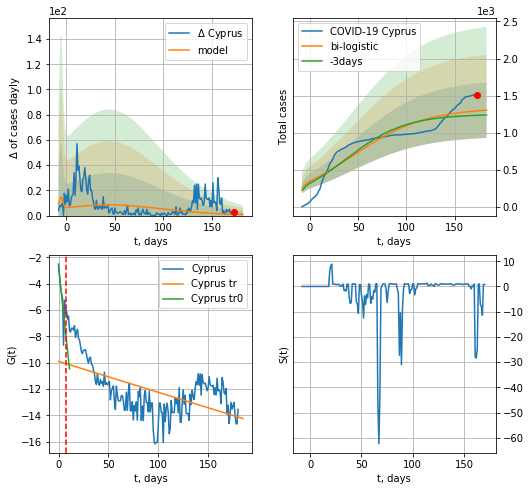

Cyprus data at: 2020-09-09
+3 day model MAPE: 0.04868370734033302
model: bi-logistic
coeffs:  [1.28995524e+03 2.65882794e-02 4.46187383e+01] [44.71273924  0.83168064 -5.024159  ]
rational stdev:  0.2873954153584519
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  1302 ± 374
	 total death:  18 ± 15
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.605369
 intercept: -2.714226
 slope: -0.704180
trend coefficient of determination: 0.328578
 intercept: -9.893344
 slope: -0.023507


In [1152]:
try:
    dfCP = read_df(pd.DataFrame(),"CP")
    dfCP = dfCP.fillna(0)
    x = forecast("Cyprus",dfCP[:7],d1,7*T18-dT)
    xx = forecast2("Cyprus",dfCP[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


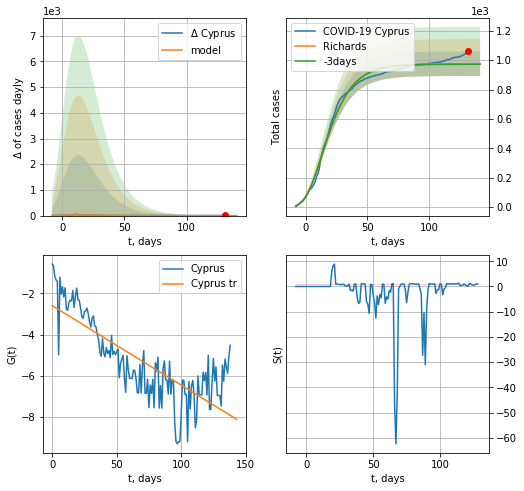

Cyprus data at: 2020-09-09
+3 day model MAPE: 0.003899
model: Richards
coeffs: [ 9.76316968e+02  1.29526584e+01 -5.80116939e+01  5.60254248e-03]
rational stdev: 0.085570
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 976 ± 83
	 total death: 14 ± 3
trend coefficient of determination: 0.611365
 intercept: -2.592811
 slope: -0.038703


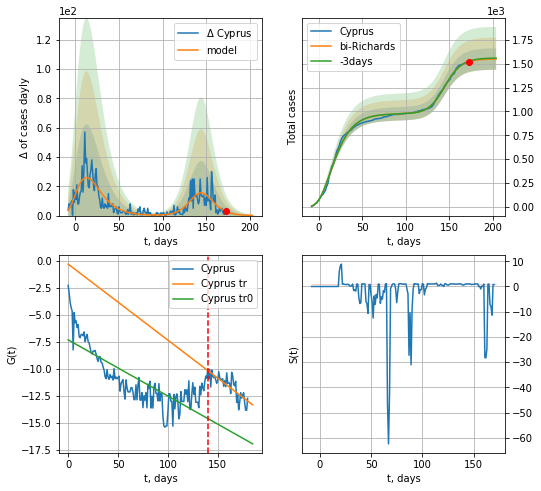

Cyprus data at: 2020-09-09
+3 day model MAPE: 0.003774
model: bi-Richards
coeffs: [5.72646873e+02 1.17910212e-01 1.43418419e+02 8.90763930e-01]
rational stdev: 0.072510
forecast at the end of period: +31 days
	 deltaDaycases: 0
	 total cases: 1547 ± 112
	 total death: 22 ± 4
bi-Richards approximation splitting point: 140
trend coefficient of determination: 0.626534
 intercept: -7.332315
 slope: -0.051992
trend coefficient of determination: 0.627169
 intercept: -0.325002
 slope: -0.070340


In [1153]:
iL = 0
vL=140+iL
x = forecastRR("Cyprus",dfCP[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
x = forecast2RR("Cyprus",dfCP[iL:],d1,28*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


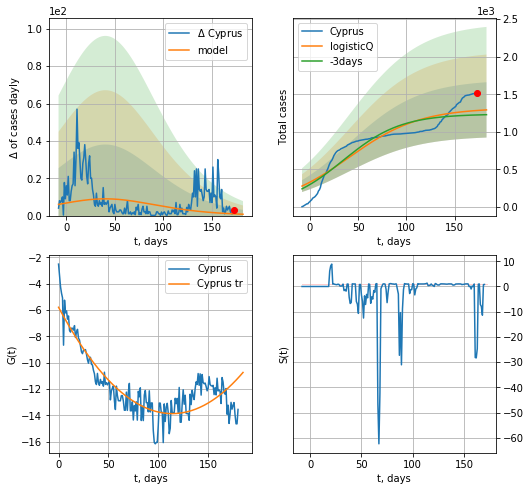

Cyprus data at: 2020-09-09
+3 day model MAPE: 0.048685
model: logisticQ
coeffs: [ 1.31828299e+03  2.22677703e-08  4.06855110e+01 -1.22294263e+06]
rational stdev: 0.285306
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 1291 ± 368
	 total death: 18 ± 15
trend coefficient of determination: 0.768246
 intercept_: -5.785202073178853
 coeffs_: [ 0.         -0.14170463  0.00062127]


In [1154]:
vL=33
x = forecastRRR("Cyprus",dfCP[:],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)
#xx = forecast2RRR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,4,1],vL=vL)

PU
           date   cases    active    death
182 2020-09-05  683702  147593.0  29687.0
183 2020-09-06  689977  145100.0  29838.0
184 2020-09-07  691575  139348.0  29976.0
185 2020-09-08  696190  136316.0  30123.0
186 2020-09-09  702776  135581.0  30236.0


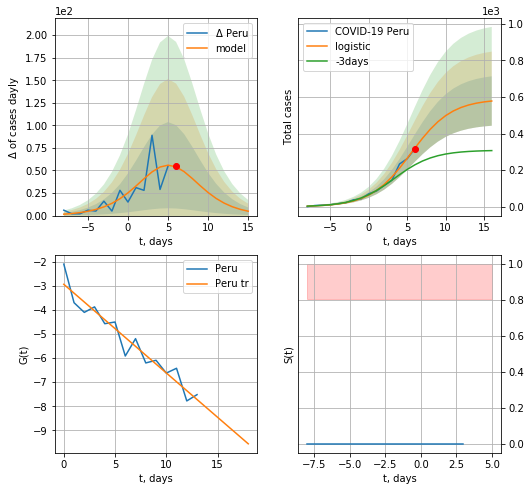

Peru data at: 2020-09-09
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +10 days
	 deltaDaycases:  4
	 total cases:  578 ± 135
	 total death:  24 ± 16
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


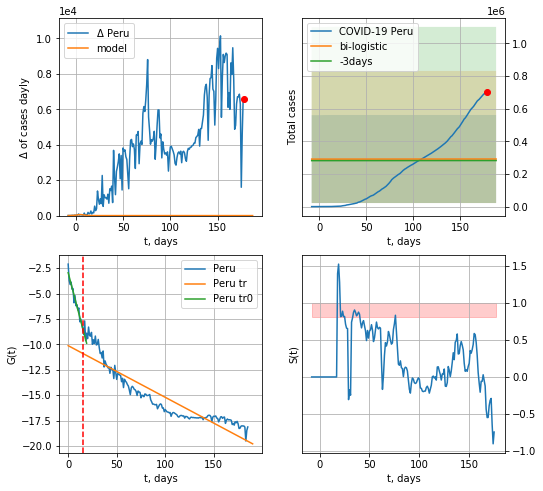

Peru data at: 2020-09-09
+3 day model MAPE: 0.033502338202214745
model: bi-logistic
coeffs:  [ 2.32688976e+05 -2.74398727e+01  6.60808187e+02] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.9251980209840137
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  291450 ± 269649
	 total death:  12539 ± 34803
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.841067
 intercept: -10.128853
 slope: -0.050866


In [1155]:
dfPU = read_df(pd.DataFrame(),"PU")
dfPU = dfPU.fillna(0)
x = forecast("Peru",dfPU[:15],d1,7*T18-dT)
xx = forecast2("Peru",dfPU[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


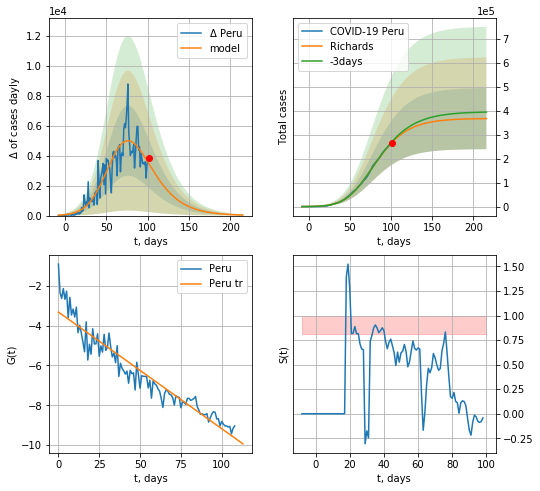

Peru data at: 2020-09-09
+3 day model MAPE: 0.011915
model: Richards
coeffs: [3.68474787e+05 1.13868989e-01 5.48653842e+01 3.85481107e-01]
rational stdev: 0.347400
forecast at the end of period: +115 days
	 deltaDaycases: 36
	 total cases: 367665 ± 127727
	 total death: 15818 ± 16485
trend coefficient of determination: 0.910589
 intercept: -3.314617
 slope: -0.058598


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


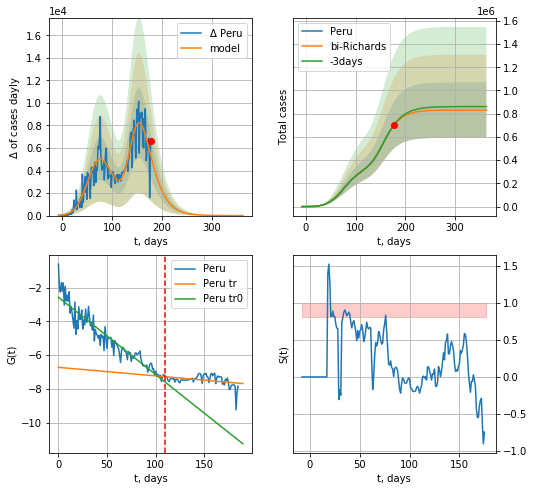

Peru data at: 2020-09-09
+3 day model MAPE: 0.005686
model: bi-Richards
coeffs: [4.63036121e+05 2.15098935e-01 1.26693330e+02 2.35011038e-01]
rational stdev: 0.287066
forecast at the end of period: +185 days
	 deltaDaycases: 0
	 total cases: 831496 ± 238694
	 total death: 35774 ± 30808
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.898310
 intercept: -2.576154
 slope: -0.045633
trend coefficient of determination: 0.126676
 intercept: -6.721519
 slope: -0.005045


In [1156]:
vL = 110
x = forecastRR("Peru",dfPU[:vL],d1,40*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Peru",dfPU[:],d1,50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR("Peru",dfPU[:],d1,36*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


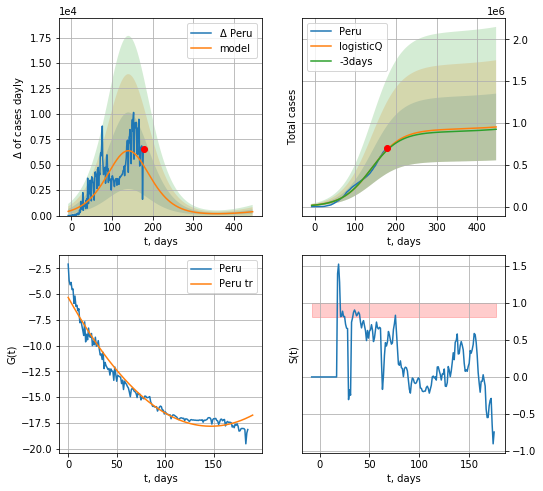

Peru data at: 2020-09-09
+3 day model MAPE: 0.011400
model: logisticQ
coeffs: [ 9.22094639e+05  1.13364459e-07  1.40444241e+02 -2.43674230e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.418749
forecast at the end of period: +269 days
	 deltaDaycases: 380
	 total cases: 951787 ± 398560
	 total death: 40949 ± 51442
trend coefficient of determination: 0.968223
 intercept_: -5.326035375426336
 coeffs_: [ 0.         -0.17003579  0.00057889]


In [1157]:
x = forecastRRR("Peru",dfPU[:].fillna(0),d1,62*7-dT,addpred=True,xcoef=koreaCoeffs)

ID
           date    cases    active    death
189 2020-09-05  4114773  863070.0  70704.0
190 2020-09-06  4208645  886505.0  71711.0
191 2020-09-07  4284103  887200.0  72843.0
192 2020-09-08  4374314  901517.0  73953.0
193 2020-09-09  4465863  918989.0  75091.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


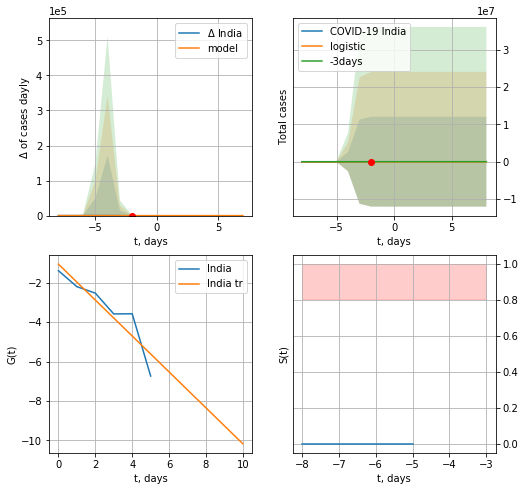

India data at: 2020-09-09
+3 day model MAPE: 0.19486002826260063
model: logistic
coeffs:  [29.4003363   4.01436821 -3.67575825]
rational stdev:  409417.6299021335
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  29 ± 12037016
	 total death:  0 ± 0
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


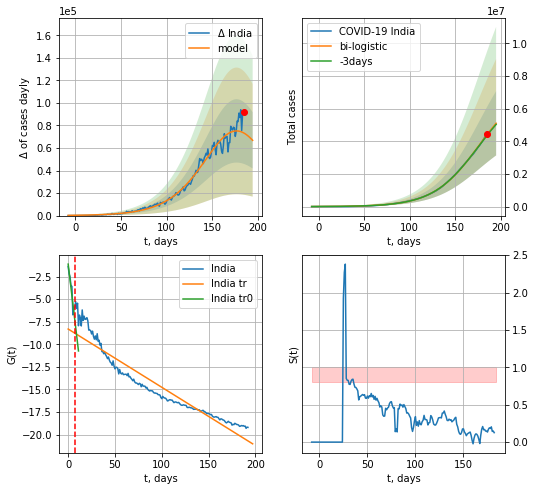

India data at: 2020-09-09
+3 day model MAPE: 0.009353838953321016
model: bi-logistic
coeffs:  [7.55306422e+06 3.96539511e-02 1.76644592e+02] [29.4003363   4.01436821 -3.67575825]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.38541485326414365
forecast at the end of period: +10 days
	 deltaDaycases:  66775
	 total cases:  5107631 ± 1968557
	 total death:  85881 ± 99299
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.906542
 intercept: -8.306769
 slope: -0.064543


In [1158]:
dfID = read_df(pd.DataFrame(),"ID")
dfID = dfID.fillna(0)
x = forecast("India",dfID[:7],d1,7*T18-dT)
xx = forecast2("India",dfID[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


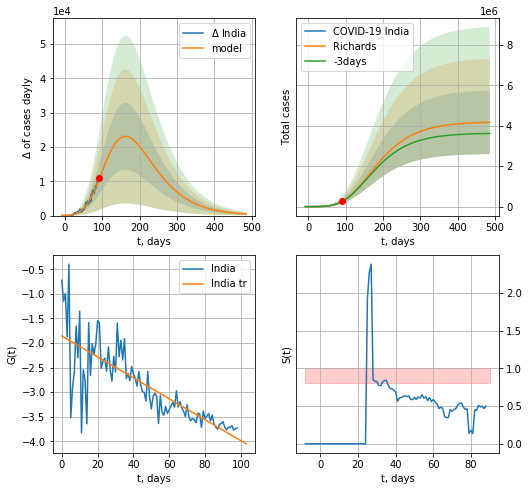

India data at: 2020-09-09
+3 day model MAPE: 0.006994
model: Richards
coeffs: [ 4.19766377e+06  3.32044249e-01 -3.85411502e+01  4.61089241e-02]
rational stdev: 0.377105
forecast at the end of period: +395 days
	 deltaDaycases: 453
	 total cases: 4168160 ± 1571833
	 total death: 70085 ± 79288
trend coefficient of determination: 0.633758
 intercept: -1.855387
 slope: -0.021306


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


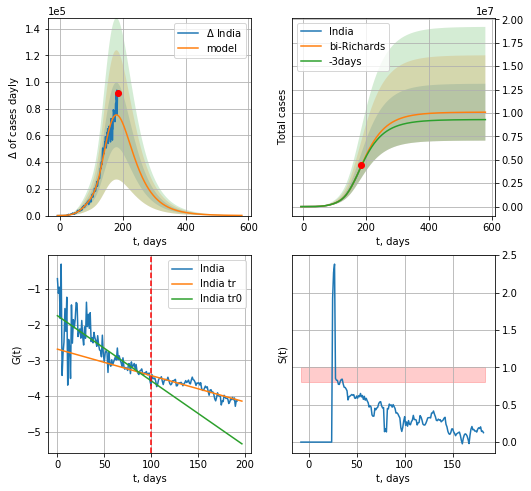

India data at: 2020-09-09
+3 day model MAPE: 0.011454
model: bi-Richards
coeffs: [5.89559940e+06 1.49911727e+00 1.64046154e+01 1.64739932e-02]
rational stdev: 0.301185
forecast at the end of period: +395 days
	 deltaDaycases: 116
	 total cases: 10085924 ± 3037729
	 total death: 169589 ± 153232
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.570936
 intercept: -1.745525
 slope: -0.018266
trend coefficient of determination: 0.765190
 intercept: -2.684844
 slope: -0.007409


In [1159]:
vL = 100
x = forecastRR("India",dfID[:vL],d1,80*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("India",dfID[:],d1,80*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


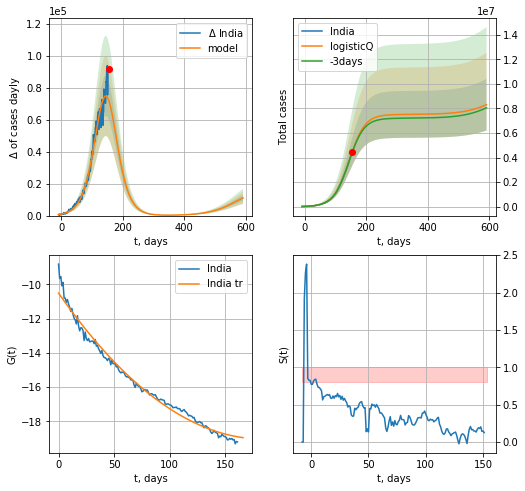

India data at: 2020-09-09
+3 day model MAPE: 0.009660
model: logisticQ
coeffs: [ 7.51290359e+06  1.98091653e-06  1.45373305e+02 -1.99697531e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.253979
forecast at the end of period: +437 days
	 deltaDaycases: 11082
	 total cases: 8309854 ± 2110530
	 total death: 139725 ± 106461
trend coefficient of determination: 0.985036
 intercept_: -10.519383899117178
 coeffs_: [ 0.        -0.0925849  0.0002518]


In [1160]:
x = forecastRRR("India",dfID[31:].fillna(0),d1,86*7-dT,addpred=True,xcoef=koreaCoeffs)

AG
           date     cases    active    death
185 2020-09-05  471806.0  121686.0   9739.0
186 2020-09-06  478792.0  119801.0   9859.0
187 2020-09-07  488007.0  120490.0  10129.0
188 2020-09-08  500034.0  123039.0  10405.0
189 2020-09-09  512293.0  119145.0  10658.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


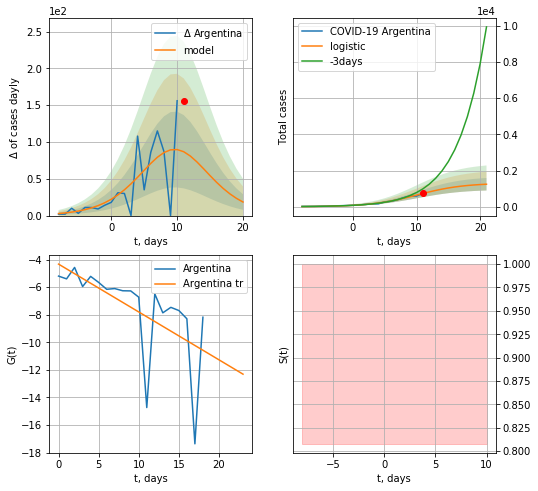

Argentina data at: 2020-09-09
+3 day model MAPE: 0.34277903234874524
model: logistic
coeffs:  [1.30607345e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.27772613105407934
forecast at the end of period: +10 days
	 deltaDaycases:  18
	 total cases:  1244 ± 345
	 total death:  25 ± 20
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


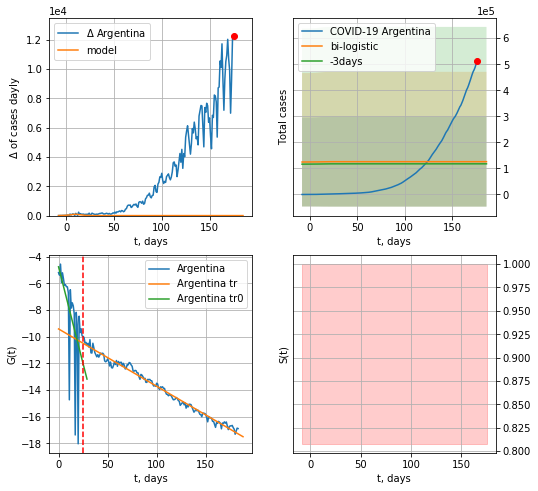

Argentina data at: 2020-09-09
+3 day model MAPE: 0.06988231570455532
model: bi-logistic
coeffs:  [ 9.96783479e+04 -8.48018994e+00  2.11538466e+02] [1.30607345e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.3699212858826302
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  125904 ± 172478
	 total death:  2619 ± 10763
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.985614
 intercept: -9.420168
 slope: -0.042934


In [1161]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,7*T18-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,T18*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

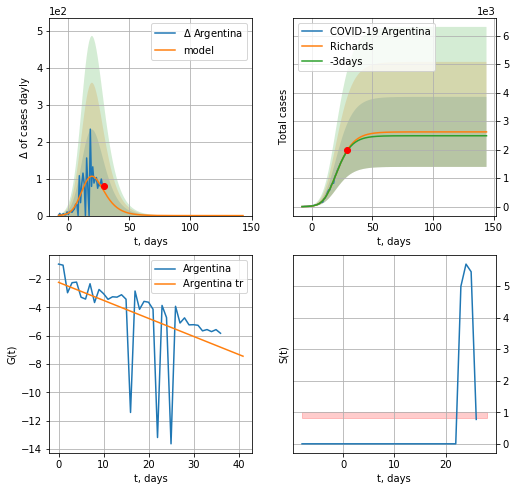

Argentina data at: 2020-09-09
+3 day model MAPE: 0.013138
model: Richards
coeffs: [2.62031767e+03 3.73237042e-01 1.15845098e+01 3.46306086e-01]
rational stdev: 0.468281
forecast at the end of period: +115 days
	 deltaDaycases: 0
	 total cases: 2620 ± 1227
	 total death: 54 ± 75
trend coefficient of determination: 0.244505
 intercept: -2.222432
 slope: -0.127357


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


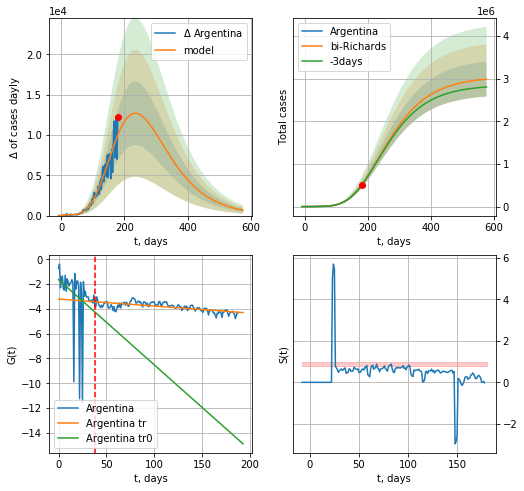

Argentina data at: 2020-09-09
+3 day model MAPE: 0.004464
model: bi-Richards
coeffs: [ 3.04202154e+06  2.72310833e-01 -3.77153317e+01  4.25285878e-02]
rational stdev: 0.136470
forecast at the end of period: +395 days
	 deltaDaycases: 668
	 total cases: 2986644 ± 407588
	 total death: 62135 ± 25438
bi-Richards approximation splitting point: 38
trend coefficient of determination: 0.093052
 intercept: -1.634916
 slope: -0.068707
trend coefficient of determination: 0.489647
 intercept: -3.200183
 slope: -0.005639


In [1162]:
vL = 38
x = forecastRR('Argentina',dfAG[:vL].fillna(0),d1,40*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Argentina',dfAG[:].fillna(0),d1,80*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


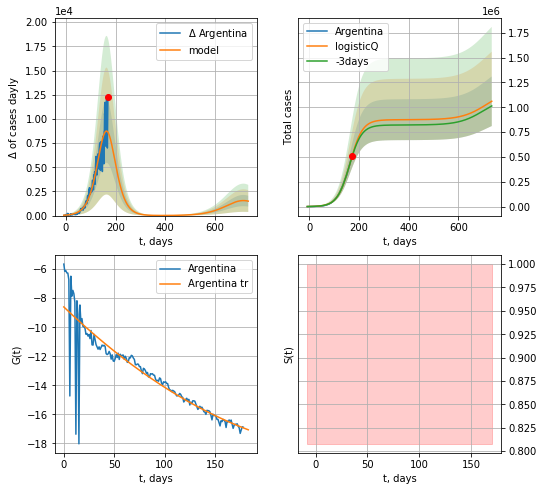

Argentina data at: 2020-09-09
+3 day model MAPE: 0.014640
model: logisticQ
coeffs: [ 8.74708472e+05  8.88204856e-07  1.63758371e+02 -4.48392327e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.235191
forecast at the end of period: +563 days
	 deltaDaycases: 1493
	 total cases: 1060624 ± 249449
	 total death: 22065 ± 15568
trend coefficient of determination: 0.814400
 intercept_: -8.600840324995461
 coeffs_: [ 0.         -0.0662774   0.00010962]


In [1163]:
x = forecastRRR('Argentina',dfAG[10:],d1,104*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


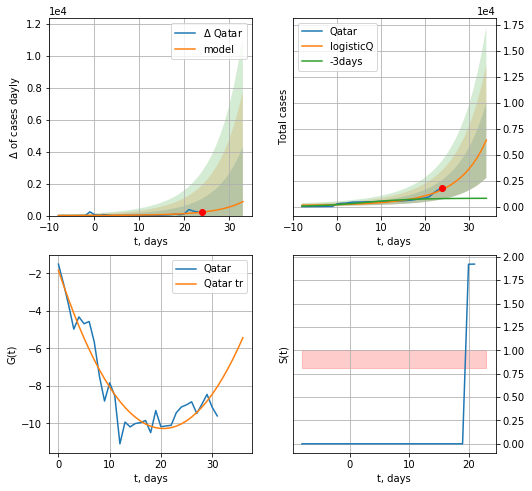

Qatar data at: 2020-09-09
+3 day model MAPE: 1.403665
model: logisticQ
coeffs: [ 4.67644951e+06  1.32940327e-03  6.79780107e+01 -1.11960184e+02]
rational stdev: 0.567221
forecast at the end of period: +10 days
	 deltaDaycases: 876
	 total cases: 6397 ± 3628
	 total death: 10 ± 17
trend coefficient of determination: 0.904406
 intercept_: -1.8341916285683908
 coeffs_: [ 0.         -0.82373816  0.02011068]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:333: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


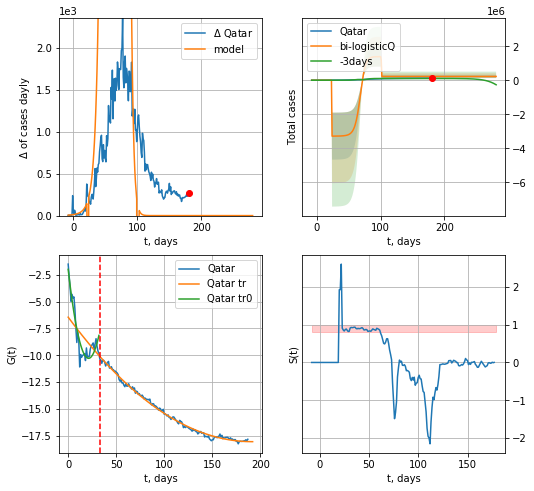

Qatar data at: 2020-09-09
+3 day model MAPE: 1.166599
model: bi-logisticQ
coeffs: [-3.28855428e+06  1.32582262e+00  2.32061618e+01 -9.38124932e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.420200
forecast at the end of period: +101 days
	 deltaDaycases: 0
	 total cases: 223188 ± 93784
	 total death: 378 ± 476
bi-logisticQ approximation splitting point: 33
trend coefficient of determination: 0.887233
 intercept_: -1.9921673153050232
 coeffs_: [ 0.         -0.78114612  0.01840466]
trend coefficient of determination: 0.994403
 intercept_: -6.44477567604026
 coeffs_: [ 0.         -0.12145384  0.00031796]


In [1164]:
vL=33
x = forecastRRR('Qatar',dfQR[:vL].fillna(0),d1,7*T18-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])
xx = forecast2RRR('Qatar',dfQR[:].fillna(0),d1,38*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


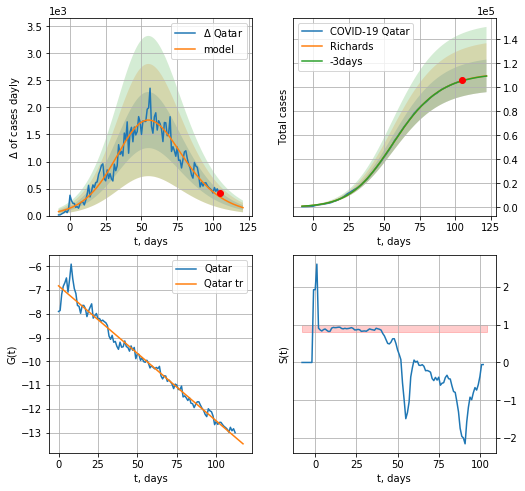

Qatar data at: 2020-09-09
+3 day model MAPE: 0.001030
model: Richards
coeffs: [1.12154830e+05 8.68119557e-02 4.75209038e+01 6.46089025e-01]
rational stdev: 0.124216
forecast at the end of period: +17 days
	 deltaDaycases: 147
	 total cases: 109543 ± 13607
	 total death: 185 ± 68
trend coefficient of determination: 0.977502
 intercept: -6.819454
 slope: -0.056860


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


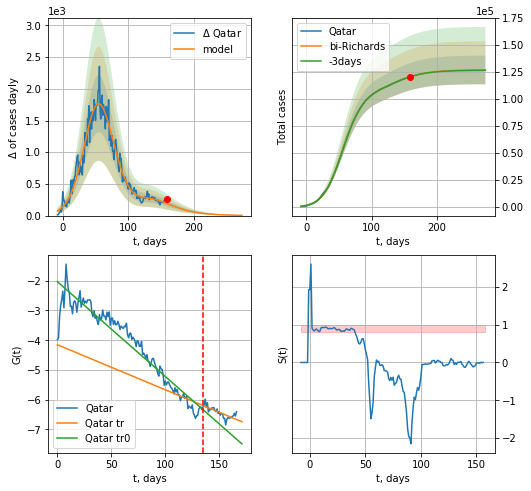

Qatar data at: 2020-09-09
+3 day model MAPE: 0.000448
model: bi-Richards
coeffs: [1.50023846e+04 1.50972586e+00 4.41198220e+01 2.49991872e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.104334
forecast at the end of period: +115 days
	 deltaDaycases: 3
	 total cases: 127054 ± 13256
	 total death: 215 ± 67
bi-Richards approximation splitting point: 135
trend coefficient of determination: 0.912684
 intercept: -2.031396
 slope: -0.031895
trend coefficient of determination: 0.589280
 intercept: -4.153097
 slope: -0.015138


In [1165]:
iL = 21
vL = 135 + iL
x = forecastRR('Qatar',dfQR[iL:vL-iL].fillna(0),d1,26*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Qatar',dfQR[iL:].fillna(0),d1,40*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-iL)

In [1166]:
#x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

UAE
           date    cases  active  death
203 2020-09-05  73471.0    9431  388.0
204 2020-09-06  73984.0    7501  388.0
205 2020-09-07  74454.0    7531  390.0
206 2020-09-08  75098.0    7764  391.0
207 2020-09-09  75981.0    8229  393.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


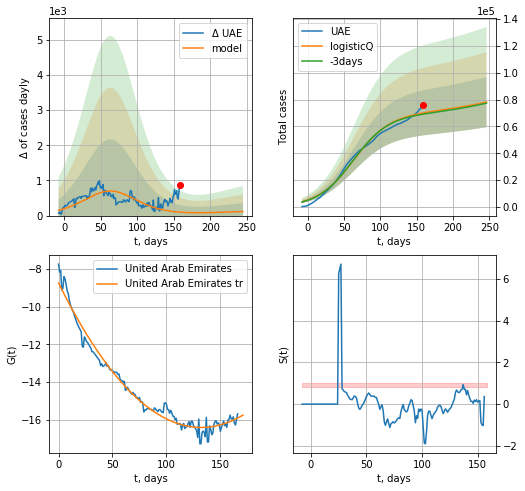

UAE data at: 2020-09-09
+3 day model MAPE: 0.012728
model: logisticQ
coeffs: [ 6.93869968e+04  9.10842603e-08  6.31435214e+01 -4.38098285e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.238970
forecast at the end of period: +87 days
	 deltaDaycases: 114
	 total cases: 78123 ± 18669
	 total death: 404 ± 289
trend coefficient of determination: 0.976846
 intercept_: -8.739353796531287
 coeffs_: [ 0.         -0.11602876  0.00043862]


In [1167]:
try:
    dfUAE = read_df(pd.DataFrame(),"UAE")
    x = forecastRRR('UAE',dfUAE[40:],d1,36*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


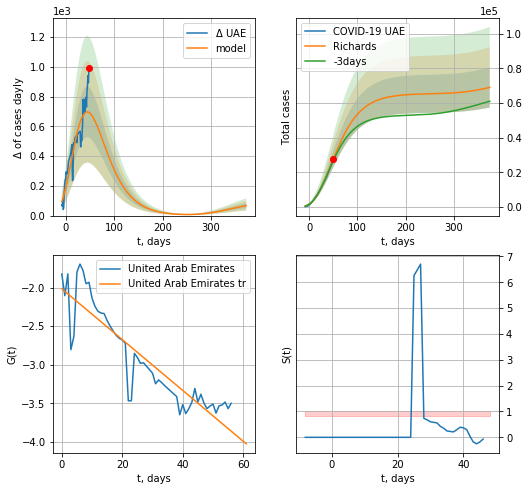

UAE data at: 2020-09-09
+3 day model MAPE: 0.033064
model: Richards
coeffs: [ 6.54730205e+04  1.80418558e+00 -9.61766575e+01  1.61791633e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.168241
forecast at the end of period: +325 days
	 deltaDaycases: 67
	 total cases: 69045 ± 11616
	 total death: 357 ± 180
trend coefficient of determination: 0.815296
 intercept: -2.016406
 slope: -0.032930


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


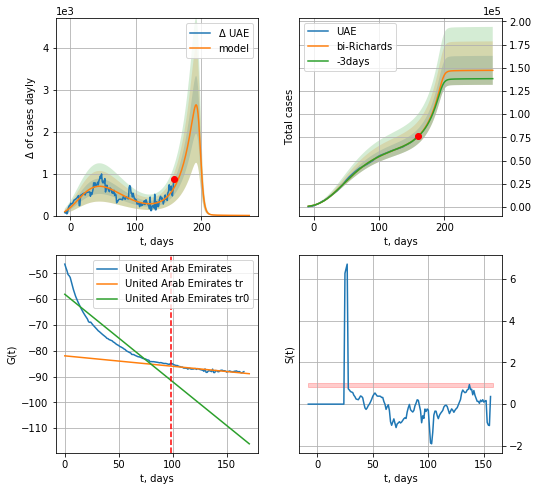

UAE data at: 2020-09-09
+3 day model MAPE: 0.004046
model: bi-Richards
coeffs: [8.18920647e+04 4.83361364e-02 1.98109791e+02 7.44470029e+00]
rational stdev: 0.106022
forecast at the end of period: +115 days
	 deltaDaycases: 2
	 total cases: 147283 ± 15615
	 total death: 761 ± 242
bi-Richards approximation splitting point: 98
trend coefficient of determination: 0.866996
 intercept: -58.112024
 slope: -0.338916
trend coefficient of determination: 0.764426
 intercept: -81.972787
 slope: -0.040493


In [1168]:
iL = 40
vL = 98 + iL
x = forecastRR('UAE',dfUAE[iL:vL-iL],d1,70*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('UAE',dfUAE[iL:],d1,40*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastQR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [1169]:
#plt.plot(range(len(dfUAE[45:])-1),np.log(np.log(np.log(np.diff(dfUAE[45:].cases)))))

SA
           date     cases  active   death
186 2020-09-05  319932.0   20041  4049.0
187 2020-09-06  320688.0   19870  4081.0
188 2020-09-07  321456.0   19726  4107.0
189 2020-09-08  322237.0   19854  4137.0
190 2020-09-09  323012.0   19881  4165.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


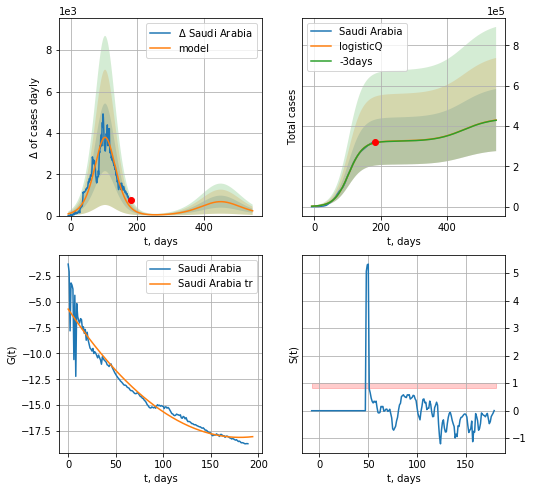

Saudi Arabia data at: 2020-09-09
+3 day model MAPE: 0.002591
model: logisticQ
coeffs: [ 3.25099225e+05  3.78814685e-07  1.03723535e+02 -1.22838895e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.358826
forecast at the end of period: +367 days
	 deltaDaycases: 231
	 total cases: 429452 ± 154098
	 total death: 5537 ± 5960
trend coefficient of determination: 0.947443
 intercept_: -5.727769544182042
 coeffs_: [ 0.         -0.13711988  0.0003797 ]


In [1170]:
dfSA = read_df(pd.DataFrame(),"SA")
x = forecastRRR('Saudi Arabia',dfSA[:],d1,76*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


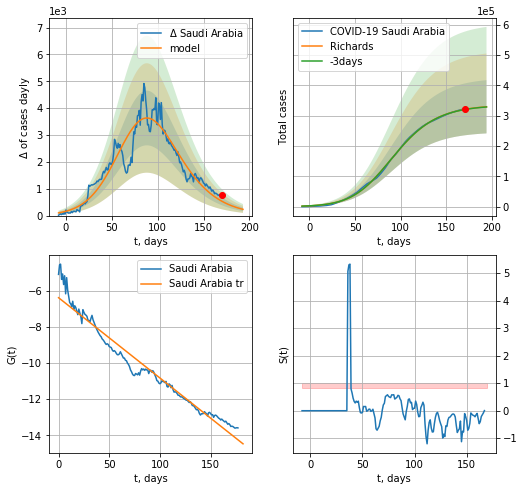

Saudi Arabia data at: 2020-09-09
+3 day model MAPE: 0.001400
model: Richards
coeffs: [3.35810540e+05 6.35435042e-02 7.49760289e+01 5.95801221e-01]
rational stdev: 0.266573
forecast at the end of period: +24 days
	 deltaDaycases: 233
	 total cases: 329678 ± 87883
	 total death: 4250 ± 3398
trend coefficient of determination: 0.956821
 intercept: -6.385795
 slope: -0.044423


In [1171]:
x = forecastRR('Saudi Arabia',dfSA[12:],d1,27*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Saudi Arabia',dfSA[12:],d1,27*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=75)
#x = forecastQR('Saudi Arabia',dfSA[12:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

Sri
           date   cases  active  death
179 2020-09-05  3121.0     184   12.0
180 2020-09-06  3123.0     186   12.0
181 2020-09-07  3123.5     185   12.0
182 2020-09-08  3140.0     182   12.0
183 2020-09-09  3147.0     189   12.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


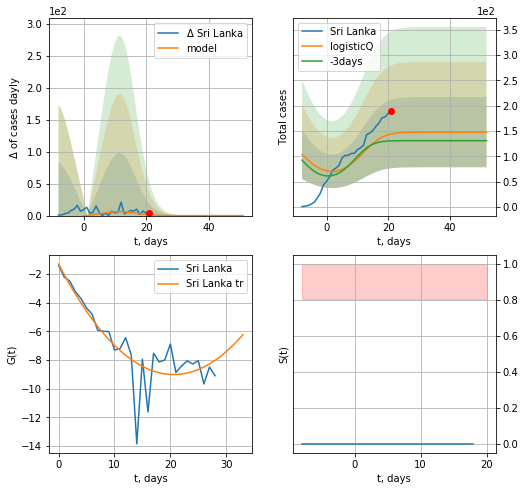

Sri Lanka data at: 2020-09-09
+3 day model MAPE: 0.111838
model: logisticQ
coeffs: [ 1.47873593e+02  1.02177717e-02  4.75700419e+00 -1.32326165e+00]
rational stdev: 0.468204
forecast at the end of period: +31 days
	 deltaDaycases: 0
	 total cases: 147 ± 69
	 total death: 0 ± 0
trend coefficient of determination: 0.737116
 intercept_: -1.300425972375204
 coeffs_: [ 0.         -0.74879164  0.01816974]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:294: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:333: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


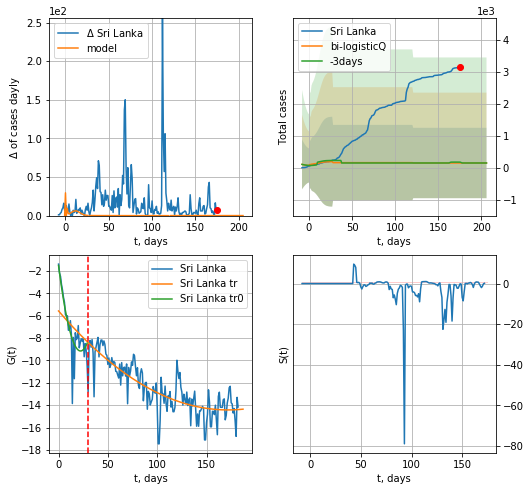

Sri Lanka data at: 2020-09-09
+3 day model MAPE: 0.132797
model: bi-logisticQ
coeffs: [30.39858711 -7.20449082 27.58052873  0.1521531 ]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 7.422416
forecast at the end of period: +31 days
	 deltaDaycases: 0
	 total cases: 147 ± 1097
	 total death: 0 ± 0
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.725855
 intercept_: -1.5084890363019623
 coeffs_: [ 0.         -0.68634546  0.01540158]
trend coefficient of determination: 0.659902
 intercept_: -5.575672533765067
 coeffs_: [ 0.         -0.1030367   0.00029992]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [1172]:
try:
    dfSri = read_df(pd.DataFrame(),"Sri")
    vL= 30
    x = forecastRRR('Sri Lanka',dfSri[:vL],d1,28*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    xx = forecast2RRR('Sri Lanka',dfSri[:],d1,28*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

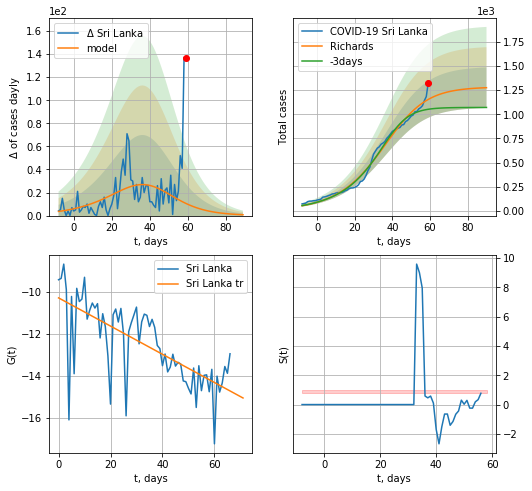

Sri Lanka data at: 2020-09-09
+3 day model MAPE: 0.103361
model: Richards
coeffs: [1.28171157e+03 6.47995832e-02 4.07030001e+01 1.48770145e+00]
rational stdev: 0.164364
forecast at the end of period: +31 days
	 deltaDaycases: 0
	 total cases: 1274 ± 209
	 total death: 4 ± 1
trend coefficient of determination: 0.481079
 intercept: -10.284657
 slope: -0.067327


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


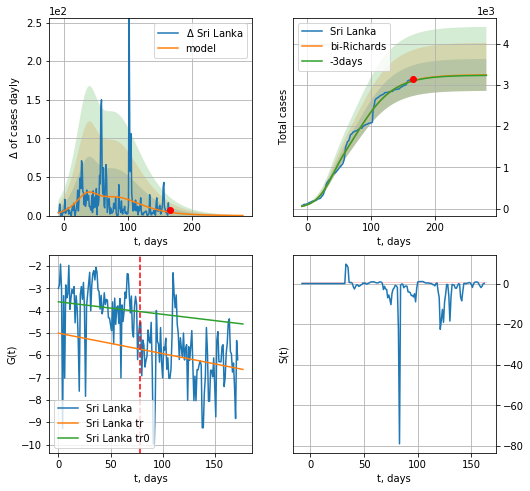

Sri Lanka data at: 2020-09-09
+3 day model MAPE: 0.002414
model: bi-Richards
coeffs: [ 1.96246650e+03  2.71603163e+00 -5.43809744e+01  1.17606345e-02]
rational stdev: 0.119672
forecast at the end of period: +115 days
	 deltaDaycases: 0
	 total cases: 3240 ± 387
	 total death: 12 ± 4
bi-Richards approximation splitting point: 78
trend coefficient of determination: 0.008888
 intercept: -3.608367
 slope: -0.005610
trend coefficient of determination: 0.033919
 intercept: -5.011418
 slope: -0.009176


In [1173]:
vL=88
x = forecastRR('Sri Lanka',dfSri[10:vL-10],d1,28*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Sri Lanka',dfSri[10:],d1,40*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10)
#x = forecastQR('Sri Lanka',dfSri[10:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

PS
           date     cases  active   death
191 2020-09-05  298509.0    6269  6342.0
192 2020-09-06  298903.0    6542  6345.0
193 2020-09-07  299233.0    6726  6350.0
194 2020-09-08  299659.0    6794  6359.0
195 2020-09-09  299855.0    5540  6365.0


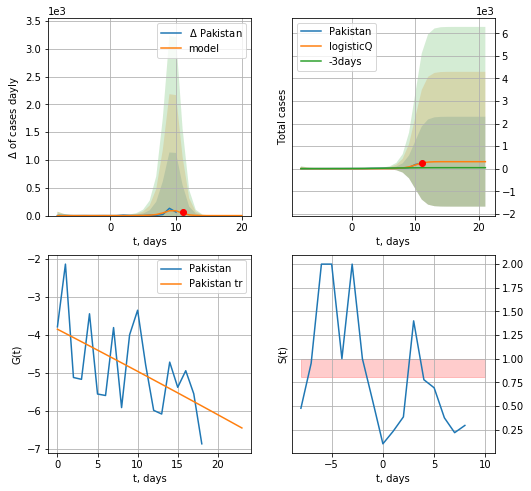

Pakistan data at: 2020-09-09
+3 day model MAPE: 5.954392
model: logisticQ
coeffs: [ 3.10300108e+02  5.80299149e-02  9.88962592e+00 -1.18245382e+01]
rational stdev: 6.420495
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 310 ± 1992
	 total death: 6 ± 115
trend coefficient of determination: 0.293073
 intercept_: -3.8498114630651457
 coeffs_: [ 0.         -0.10964083 -0.00016191]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


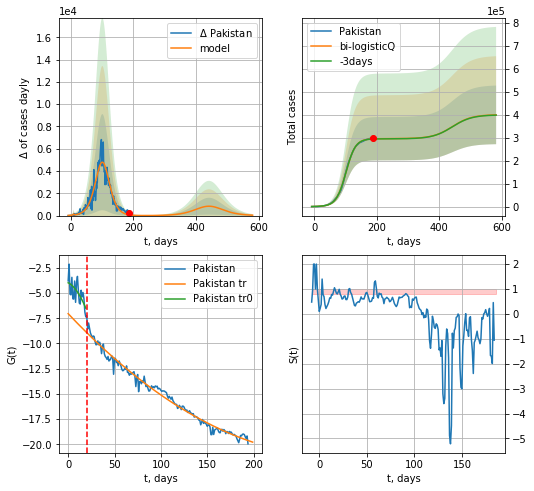

Pakistan data at: 2020-09-09
+3 day model MAPE: 0.002477
model: bi-logisticQ
coeffs: [ 2.95359403e+05  1.07812748e-05  1.01390166e+02 -5.92272520e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.319607
forecast at the end of period: +395 days
	 deltaDaycases: 36
	 total cases: 399153 ± 127572
	 total death: 8472 ± 8123
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.391568
 intercept_: -3.9808806978581046
 coeffs_: [ 0.         -0.04620278 -0.00453428]
trend coefficient of determination: 0.983925
 intercept_: -7.043574784743363
 coeffs_: [ 0.         -0.09730977  0.00016748]


In [1174]:
try:
    dfPS = read_df(pd.DataFrame(),"PS")
    vL= 20
    x = forecastRRR('Pakistan',dfPS[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    xx = forecast2RRR('Pakistan',dfPS[:],d1,80*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


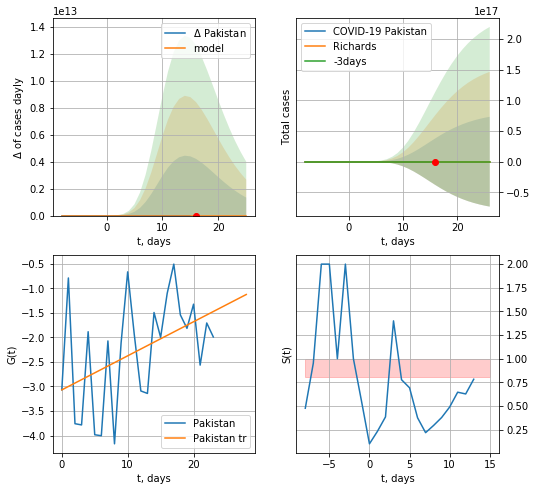

Pakistan data at: 2020-09-09
+3 day model MAPE: 0.118203
model: Richards
coeffs: [ 1.63838701e+03  6.06255652e+00 -3.11642699e+00  3.19416608e-02]
rational stdev: 49944222119087.820312
forecast at the end of period: +10 days
	 deltaDaycases: 34
	 total cases: 1465 ± 73215143679369088
	 total death: 31 ± 4644812657075168
trend coefficient of determination: 0.194578
 intercept: -3.069491
 slope: 0.069432


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


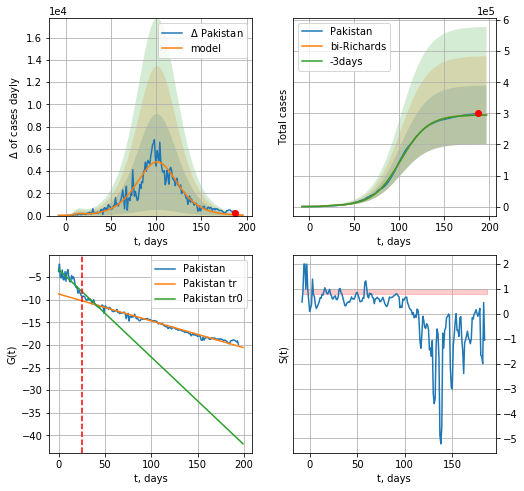

Pakistan data at: 2020-09-09
+3 day model MAPE: 0.002183
model: bi-Richards
coeffs: [2.94013051e+05 6.58882087e-02 1.01402036e+02 9.93850741e-01]
rational stdev: 0.319589
forecast at the end of period: +10 days
	 deltaDaycases: 38
	 total cases: 295087 ± 94306
	 total death: 6263 ± 6004
bi-Richards approximation splitting point: 25
trend coefficient of determination: 0.660682
 intercept: -3.283128
 slope: -0.193896
trend coefficient of determination: 0.975414
 intercept: -8.728394
 slope: -0.059508


In [1175]:
vL = 25
x = forecastRR('Pakistan',dfPS[:vL],d1,25*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Pakistan',dfPS[:],d1,25*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Pakistan',dfPS[:],d1,48*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

BN
           date     cases  active   death
181 2020-09-05  325157.0   99403  4479.0
182 2020-09-06  327359.0   98270  4516.0
183 2020-09-07  328303.0   98270  4516.0
184 2020-09-08  329251.0   96890  4552.0
185 2020-09-09  331078.0   95681  4593.0


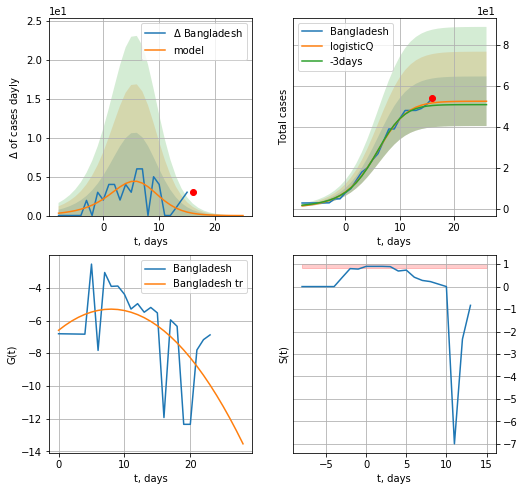

Bangladesh data at: 2020-09-09
+3 day model MAPE: 0.027574
model: logisticQ
coeffs: [ 5.24923910e+01  5.83606353e-03  5.49443194e+00 -5.18823422e+01]
rational stdev: 0.229682
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 52 ± 12
	 total death: 0 ± 0
trend coefficient of determination: 0.276192
 intercept_: -6.599187027141191
 coeffs_: [ 0.          0.32583568 -0.02049035]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


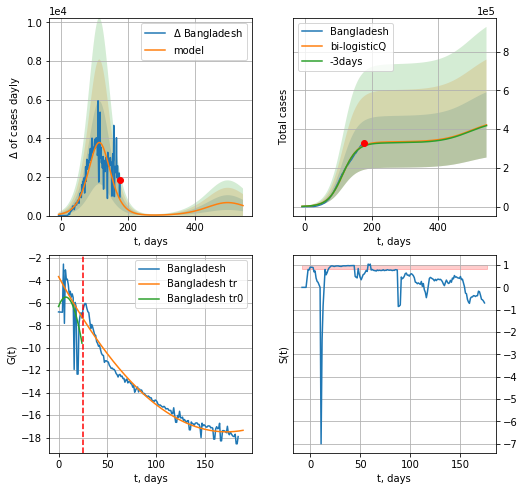

Bangladesh data at: 2020-09-09
+3 day model MAPE: 0.010308
model: bi-logisticQ
coeffs: [ 3.34344431e+05  1.99575136e-07  1.14178759e+02 -2.26478867e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.399600
forecast at the end of period: +367 days
	 deltaDaycases: 519
	 total cases: 422206 ± 168713
	 total death: 5857 ± 7021
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.232653
 intercept_: -6.325425729788838
 coeffs_: [ 0.          0.22449345 -0.0150245 ]
trend coefficient of determination: 0.972149
 intercept_: -3.6636330431423385
 coeffs_: [ 0.         -0.16075667  0.00046731]


In [1176]:
dfBN = read_df(pd.DataFrame(),"BN")
vL= 25
try:
    x = forecastRRR('Bangladesh',dfBN[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    xx = forecast2RRR('Bangladesh',dfBN[:],d1,76*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

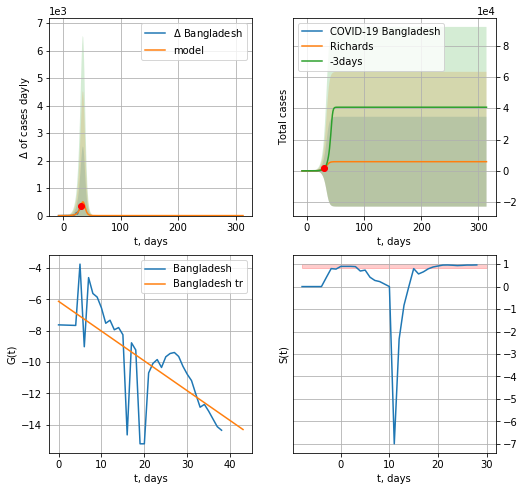

Bangladesh data at: 2020-09-09
+3 day model MAPE: 0.079004
model: Richards
coeffs: [5.83662075e+03 2.41285864e-01 3.62036516e+01 1.74331712e+00]
rational stdev: 4.915459
forecast at the end of period: +283 days
	 deltaDaycases: 0
	 total cases: 5836 ± 28689
	 total death: 80 ± 1179
trend coefficient of determination: 0.544590
 intercept: -6.123432
 slope: -0.190441


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


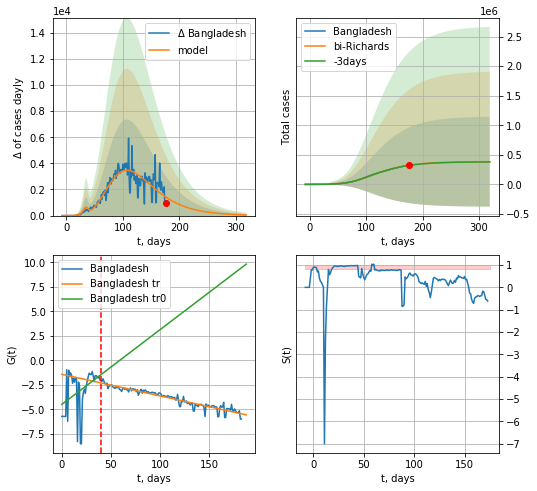

Bangladesh data at: 2020-09-09
+3 day model MAPE: 0.004883
model: bi-Richards
coeffs: [ 3.80499519e+05  2.14658565e+00 -7.12351049e+01  1.16134309e-02]
rational stdev: 1.977736
forecast at the end of period: +143 days
	 deltaDaycases: 49
	 total cases: 384389 ± 760220
	 total death: 5332 ± 31635
bi-Richards approximation splitting point: 40
trend coefficient of determination: 0.166324
 intercept: -4.501752
 slope: 0.076152
trend coefficient of determination: 0.910272
 intercept: -1.430283
 slope: -0.022008


In [1177]:
vL=40
x = forecastRR('Bangladesh',dfBN[:vL],d1,64*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bangladesh',dfBN[:-1],d1,44*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Bangladesh',dfBN[:],d1,16*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

KW
           date    cases  active  death
194 2020-09-05  88963.0    8520  540.0
195 2020-09-06  89582.0    8517  544.0
196 2020-09-07  90387.0    8804  546.0
197 2020-09-08  91244.0    9042  548.0
198 2020-09-09  92082.0    9308  552.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


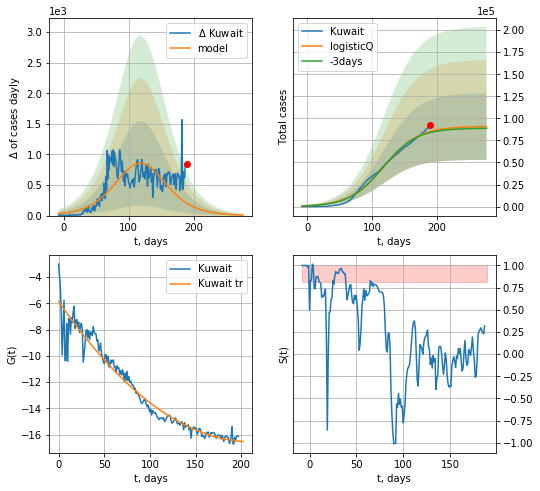

Kuwait data at: 2020-09-09
+3 day model MAPE: 0.014940
model: logisticQ
coeffs: [ 9.09055875e+04  9.87293845e-08  1.18515921e+02 -3.82002817e+05]
rational stdev: 0.415301
forecast at the end of period: +87 days
	 deltaDaycases: 8
	 total cases: 90676 ± 37658
	 total death: 543 ± 676
trend coefficient of determination: 0.943783
 intercept_: -5.838051602146539
 coeffs_: [ 0.         -0.1011483   0.00023875]


In [1178]:
try:
    dfKW = read_df(pd.DataFrame(),"KW")
    x = forecastRRR('Kuwait',dfKW[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


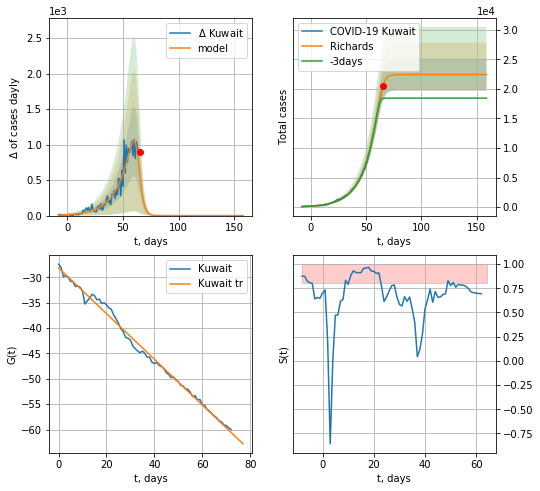

Kuwait data at: 2020-09-09
+3 day model MAPE: 0.136577
model: Richards
coeffs: [2.24365718e+04 7.66634183e-02 6.43548409e+01 5.72971780e+00]
rational stdev: 0.119998
forecast at the end of period: +94 days
	 deltaDaycases: 0
	 total cases: 22436 ± 2692
	 total death: 134 ± 48
trend coefficient of determination: 0.993036
 intercept: -28.143720
 slope: -0.450232


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


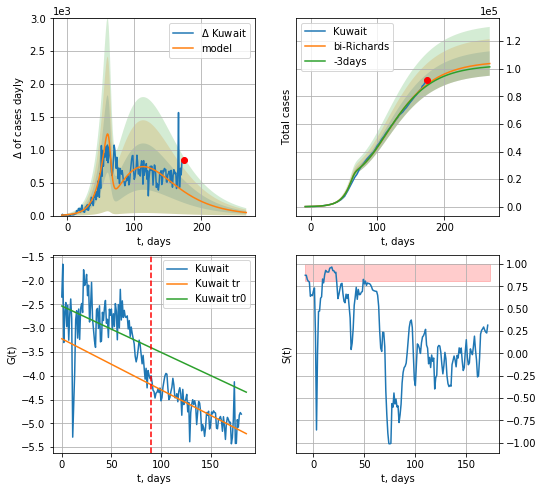

Kuwait data at: 2020-09-09
+3 day model MAPE: 0.009998
model: bi-Richards
coeffs: [ 8.32032882e+04  2.62677519e+00 -7.74946526e+01  9.30628807e-03]
rational stdev: 0.085307
forecast at the end of period: +94 days
	 deltaDaycases: 46
	 total cases: 103741 ± 8849
	 total death: 621 ± 158
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.167414
 intercept: -2.533340
 slope: -0.009738
trend coefficient of determination: 0.592417
 intercept: -3.222014
 slope: -0.010726


In [1179]:
iL= 16
vL = 90 + iL
x = forecastRR('Kuwait',dfKW[iL:vL-iL],d1,37*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Kuwait',dfKW[iL:],d1,37*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

DM
           date     cases  active   death
188 2020-09-05   98776.0   25035  1840.0
189 2020-09-06   99333.0   24921  1845.0
190 2020-09-07   99898.0   24806  1864.0
191 2020-09-08  100131.0   24447  1889.0
192 2020-09-09  100937.0   24718  1914.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


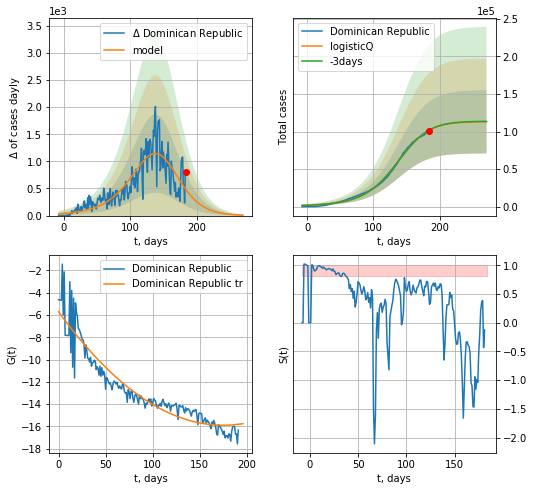

Dominican Republic data at: 2020-09-09
+3 day model MAPE: 0.002660
model: logisticQ
coeffs: [ 1.13031745e+05  6.95553508e-05  1.34141204e+02 -4.44214826e+02]
rational stdev: 0.373245
forecast at the end of period: +87 days
	 deltaDaycases: 7
	 total cases: 112907 ± 42142
	 total death: 2140 ± 2396
trend coefficient of determination: 0.888784
 intercept_: -5.705475668034864
 coeffs_: [ 0.         -0.1166536   0.00033337]


In [1180]:
try:
    dfDM = read_df(pd.DataFrame(),"DM")
    x = forecastRRR('Dominican Republic',dfDM[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


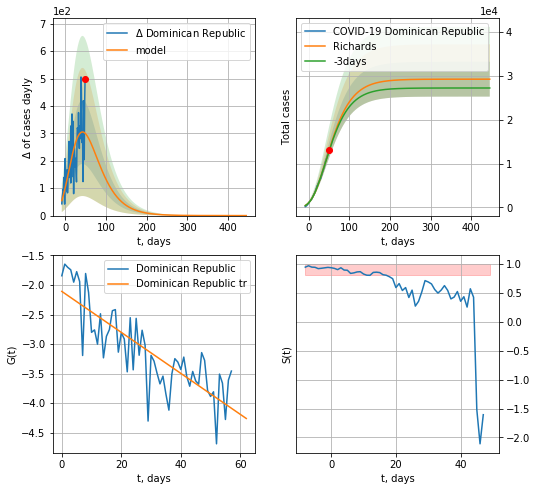

Dominican Republic data at: 2020-09-09
+3 day model MAPE: 0.011985
model: Richards
coeffs: [ 2.92636962e+04  1.52410692e+00 -9.56887865e+01  1.87798018e-02]
rational stdev: 0.135750
forecast at the end of period: +395 days
	 deltaDaycases: 0
	 total cases: 29263 ± 3972
	 total death: 554 ± 225
trend coefficient of determination: 0.671301
 intercept: -2.108314
 slope: -0.034707


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


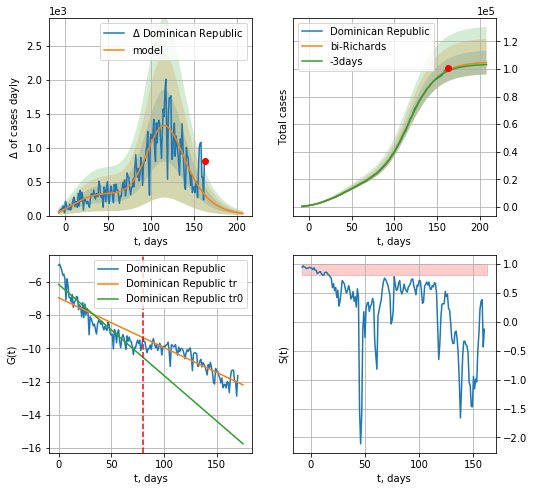

Dominican Republic data at: 2020-09-09
+3 day model MAPE: 0.007462
model: bi-Richards
coeffs: [7.60700798e+04 9.58616469e-02 1.07402055e+02 5.91200421e-01]
rational stdev: 0.082252
forecast at the end of period: +45 days
	 deltaDaycases: 32
	 total cases: 104645 ± 8607
	 total death: 1984 ± 489
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.852573
 intercept: -6.150755
 slope: -0.054785
trend coefficient of determination: 0.792220
 intercept: -6.955904
 slope: -0.029938


In [1181]:
vL = 80+21
x = forecastRR('Dominican Republic',dfDM[21:vL-21],d1,80*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Dominican Republic',dfDM[21:],d1,30*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-21)

MD
           date    cases  active   death
182 2020-09-05  39473.0   10611  1063.0
183 2020-09-06  39797.0   10935  1063.0
184 2020-09-07  40055.0   10403  1074.0
185 2020-09-08  40556.0   10891  1087.0
186 2020-09-09  41144.0   11086  1096.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


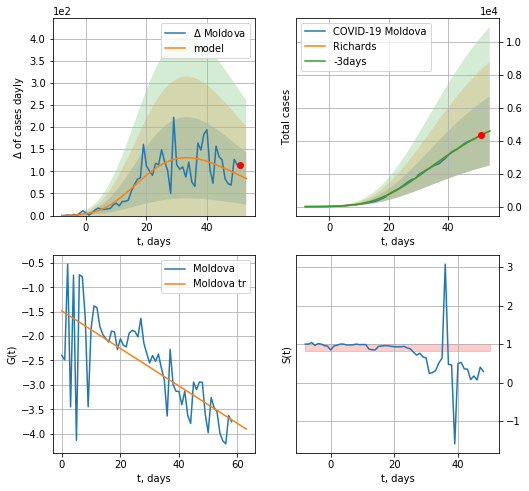

Moldova data at: 2020-09-09
+3 day model MAPE: 0.000798
model: Richards
coeffs: [ 6.30547519e+03  3.98861804e+00 -4.11482156e+01  1.42375767e-02]
rational stdev: 0.458356
forecast at the end of period: +3 days
	 deltaDaycases: 83
	 total cases: 4599 ± 2108
	 total death: 122 ± 167
trend coefficient of determination: 0.512178
 intercept: -1.485670
 slope: -0.038427


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


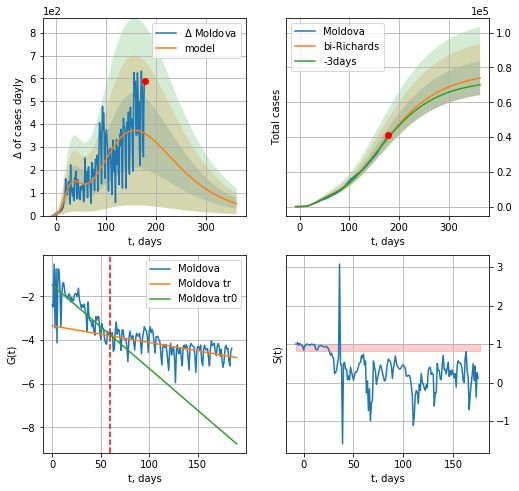

Moldova data at: 2020-09-09
+3 day model MAPE: 0.010368
model: bi-Richards
coeffs: [ 7.12921684e+04  1.15059661e+00 -1.48497596e+02  1.24285920e-02]
rational stdev: 0.132693
forecast at the end of period: +185 days
	 deltaDaycases: 52
	 total cases: 73880 ± 9803
	 total death: 1968 ± 783
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.522309
 intercept: -1.479994
 slope: -0.038276
trend coefficient of determination: 0.306742
 intercept: -3.348426
 slope: -0.007659


In [1182]:
dfMD = read_df(pd.DataFrame(),"MD")
dfMD = dfMD.fillna(0)
try:
    vL = 60
    x = forecastRR("Moldova",dfMD[:vL],d1,24*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Moldova",dfMD[:],d1,50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [1183]:
#np.diff(dfAF["cases"])

AF
           date     cases  active    death
184 2020-09-05  636884.0   60901  14779.0
185 2020-09-06  638517.0   59737  14889.0
186 2020-09-07  639362.0   57803  15004.0
187 2020-09-08  640441.0   57626  15086.0
188 2020-09-09  642431.0   57328  15168.0


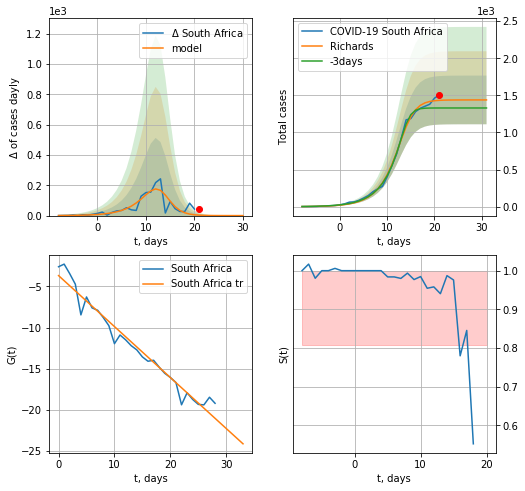

South Africa data at: 2020-09-09
+3 day model MAPE: 0.079443
model: Richards
coeffs: [1.43832006e+03 3.09188711e-01 1.37785511e+01 2.13840843e+00]
rational stdev: 0.227967
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 1438 ± 327
	 total death: 33 ± 22
trend coefficient of determination: 0.961533
 intercept: -3.675972
 slope: -0.619731


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


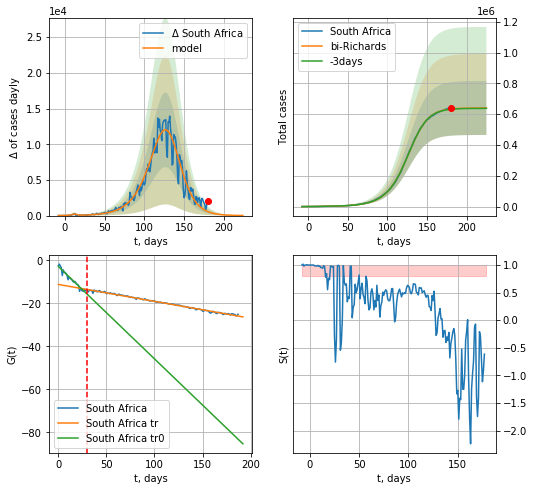

South Africa data at: 2020-09-09
+3 day model MAPE: 0.003415
model: bi-Richards
coeffs: [6.39021800e+05 5.90978778e-02 1.31289297e+02 1.44538646e+00]
rational stdev: 0.273857
forecast at the end of period: +45 days
	 deltaDaycases: 13
	 total cases: 640312 ± 175354
	 total death: 15117 ± 12419
bi-Richards approximation splitting point: 30
trend coefficient of determination: 0.942430
 intercept: -2.936773
 slope: -0.429145
trend coefficient of determination: 0.993131
 intercept: -11.253329
 slope: -0.078518


In [1184]:
dfAF = read_df(pd.DataFrame(),"AF").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 30
    x = forecastRR("South Africa",dfAF[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("South Africa",dfAF[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

UB
           date  cases  active  death
174 2020-09-05  43476    2251  345.0
175 2020-09-06  43775    2148  350.0
176 2020-09-07  44107    2157  356.0
177 2020-09-08  44557    2297  362.0
178 2020-09-09  45160    2580  368.0


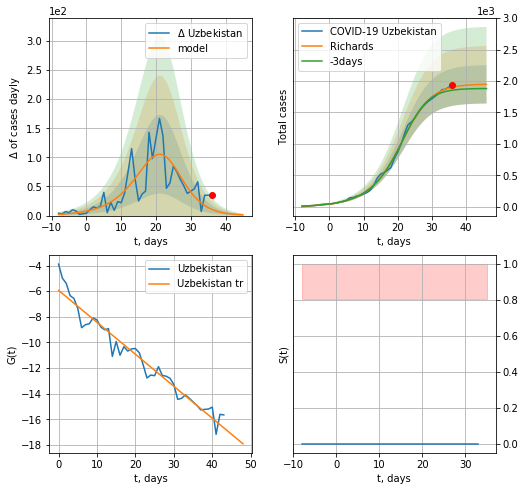

Uzbekistan data at: 2020-09-09
+3 day model MAPE: 0.027380
model: Richards
coeffs: [1.95086939e+03 1.63729535e-01 2.32758397e+01 1.53766466e+00]
rational stdev: 0.156222
forecast at the end of period: +10 days
	 deltaDaycases: 1
	 total cases: 1946 ± 304
	 total death: 15 ± 7
trend coefficient of determination: 0.953191
 intercept: -5.936816
 slope: -0.249439


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


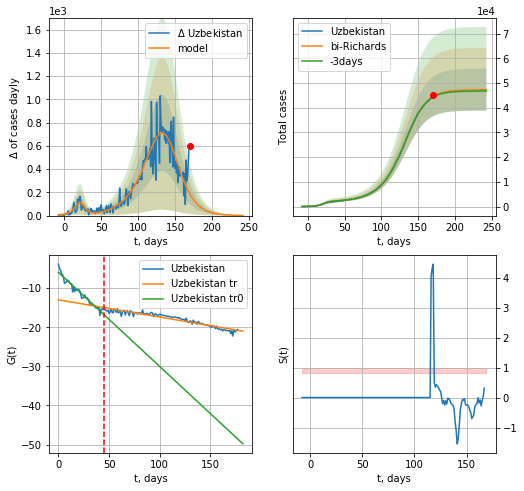

Uzbekistan data at: 2020-09-09
+3 day model MAPE: 0.005764
model: bi-Richards
coeffs: [4.53938325e+04 4.78858735e-02 1.38784367e+02 1.51115742e+00]
rational stdev: 0.178927
forecast at the end of period: +73 days
	 deltaDaycases: 1
	 total cases: 47328 ± 8468
	 total death: 385 ± 206
bi-Richards approximation splitting point: 45
trend coefficient of determination: 0.948103
 intercept: -5.928009
 slope: -0.241112
trend coefficient of determination: 0.911292
 intercept: -12.972761
 slope: -0.044057


In [1185]:
dfUB = read_df(pd.DataFrame(),"UB").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 45
    x = forecastRR("Uzbekistan",dfUB[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Uzbekistan",dfUB[:],d1,34*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [ ]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
#    "Saudi Arabia":["SA",5,4*7],
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":["UAE",5,8*7],
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [788]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=19:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

[19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19]
1:"#"
2:"Country,Other"
3:"TotalCases"
4:"NewCases"
5:"TotalDeaths"
6:"NewDeaths"
7:"TotalRecovered"
8:"NewRecovered"
9:"ActiveCases"
10:"Serious,Critical"
11:"Tot Cases/1M pop"
12:"Deaths/1M pop"
13:"TotalTests"
14:"Tests/
1M pop
"
15:"Population"
16:"Continent"
17:"1 Caseevery X ppl"
18:"1 Deathevery X ppl"
19:"1 Testevery X ppl"
[695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695]


In [789]:
df.head(10)
#df.columns[18]

,#,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",Tot Cases/1M pop,Deaths/1M pop,TotalTests,Tests/\n1M pop\n,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"7,790,513","+5,225","284,506",629,"4,704,062","+4,776","2,801,945","18,553",,,,,,North America,\n,,
1,,\nAsia\n,"8,106,017","+5,515","157,230",14,"6,546,947","+6,579","1,401,840","19,243",,,,,,Asia,\n,,
2,,\nSouth America\n,"6,862,894","+1,037","222,322",49,"5,566,454","+2,118","1,074,118","15,022",,,,,,South America,\n,,
3,,\nEurope\n,"3,917,579","+8,971","211,328",179,"2,205,268","+7,128","1,500,983","6,208",,,,,,Europe,\n,,
4,,\nAfrica\n,"1,328,263",,"31,962",,"1,063,653",,"232,648","1,468",,,,,,Africa,\n,,
5,,\nOceania\n,"29,662",53,819,7,"25,493",182,"3,350",31,,,,,,Australia/Oceania,\n,,
6,,\n\n,721,,15,,651,,55,4,,,,,,,\n,,
7,,World,"28,035,649","+20,801","908,182",878,"20,112,528","+20,783","7,014,939","60,529","3,597",116.5,,,,All,\n,,
8,1,USA,"6,549,475",,"195,239",,"3,846,095",,"2,508,141","14,578","19,764",589,"89,283,072","269,430","331,378,104",North America,51,"1,697",4
9,2,India,"4,465,863","+2,898","75,091",,"3,471,783","+2,699","918,989","8,944","3,230",54,"52,934,433","38,286","1,382,604,367",Asia,310,"18,412",26


In [790]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",'Deaths/1M pop':"Deathsper1Mpop","Serious,Critical":"Serious_Critical",'Tests/\n1M pop\n':"Testsper1Mpop",'Tot\xa0Cases/1M pop':"TotCasesper1Mpop"})
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"7,790,513","+5,225","284,506",629,"4,704,062","+4,776","2,801,945","18,553",,,,,,North America,\n,,
1,,\nAsia\n,"8,106,017","+5,515","157,230",14,"6,546,947","+6,579","1,401,840","19,243",,,,,,Asia,\n,,
2,,\nSouth America\n,"6,862,894","+1,037","222,322",49,"5,566,454","+2,118","1,074,118","15,022",,,,,,South America,\n,,
3,,\nEurope\n,"3,917,579","+8,971","211,328",179,"2,205,268","+7,128","1,500,983","6,208",,,,,,Europe,\n,,
4,,\nAfrica\n,"1,328,263",,"31,962",,"1,063,653",,"232,648","1,468",,,,,,Africa,\n,,


In [791]:
df[df["Country"]=="Lithuania"]

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
135,128,Lithuania,"3,163",,86,,"2,008",,"1,069",,"1,165",32,"676,600","249,243","2,714,619",Europe,858,"31,565",4
368,129,Lithuania,"3,163",32,86,,"2,008",14,"1,069",,"1,165",32,"676,600","249,243","2,714,619",Europe,858,"31,565",4
601,130,Lithuania,"3,131",31,86,,"1,994",39,"1,051",,"1,153",32,"666,930","245,681","2,714,619",Europe,867,"31,565",4


In [792]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

231


In [797]:
df.head(112)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"7,790,513","+5,225","284,506",629,"4,704,062","+4,776","2,801,945","18,553",,,,,,North America,\n,,
1,,\nAsia\n,"8,106,017","+5,515","157,230",14,"6,546,947","+6,579","1,401,840","19,243",,,,,,Asia,\n,,
2,,\nSouth America\n,"6,862,894","+1,037","222,322",49,"5,566,454","+2,118","1,074,118","15,022",,,,,,South America,\n,,
3,,\nEurope\n,"3,917,579","+8,971","211,328",179,"2,205,268","+7,128","1,500,983","6,208",,,,,,Europe,\n,,
4,,\nAfrica\n,"1,328,263",,"31,962",,"1,063,653",,"232,648","1,468",,,,,,Africa,\n,,
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107,100,Haiti,"8,384",,214,,"5,991",,"2,179",,734,19,"24,862","2,175","11,429,014",North America,"1,363","53,407",460
108,101,Zimbabwe,"7,429",,222,,"5,542",,"1,665",,498,15,"153,315","10,287","14,903,911",Africa,"2,006","67,135",97
109,102,Mauritania,"7,191",,161,,"6,701",,329,3,"1,539",34,"70,257","15,037","4,672,120",Africa,650,"29,019",67
110,103,Luxembourg,"7,023",,124,,"6,292",,607,,"11,185",197,"704,513","1,122,016","627,899",Europe,89,"5,064",1


In [798]:
df.at[20, 'TotalRecovered'] = 0
df.at[16, 'TotalRecovered'] = 0
df.at[45, 'TotalRecovered'] = 0
df.at[48, 'TotalRecovered'] = 0
#df.at[109, 'TotalRecovered'] = 0
df.at[20,"ActiveCases"] = 0
df.at[16,"ActiveCases"] = 0
df.at[45,"ActiveCases"] = 0
df.at[48,"ActiveCases"] = 0
#df.at[109,"ActiveCases"] = 0
#df.at[12, 'TotalRecovered'] = 0
df = df.fillna(0)

In [799]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,7790513,5225.0,284506.0,629.0,4704062.0,"+4,776",2801945,18553.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,\nAsia\n,8106017,5515.0,157230.0,14.0,6546947.0,"+6,579",1401840,19243.0,NaN,NaN,NaN,NaN,,Asia,\n,,
2,,\nSouth America\n,6862894,1037.0,222322.0,49.0,5566454.0,"+2,118",1074118,15022.0,NaN,NaN,NaN,NaN,,South America,\n,,
3,,\nEurope\n,3917579,8971.0,211328.0,179.0,2205268.0,"+7,128",1500983,6208.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,\nAfrica\n,1328263,NaN,31962.0,NaN,1063653.0,,232648,1468.0,NaN,NaN,NaN,NaN,,Africa,\n,,
5,,\nOceania\n,29662,53.0,819.0,7.0,25493.0,182,3350,31.0,NaN,NaN,NaN,NaN,,Australia/Oceania,\n,,
6,,\n\n,721,NaN,15.0,NaN,651.0,,55,4.0,NaN,NaN,NaN,NaN,,,\n,,
7,,World,28035649,20801.0,908182.0,878.0,20112528.0,"+20,783",7014939,60529.0,3597.0,116.5,NaN,NaN,,All,\n,,
8,1,USA,6549475,NaN,195239.0,NaN,3846095.0,,2508141,14578.0,19764.0,589.0,89283072.0,269430.0,"331,378,104",North America,51,"1,697",4
9,2,India,4465863,2898.0,75091.0,NaN,3471783.0,"+2,699",918989,8944.0,3230.0,54.0,52934433.0,38286.0,"1,382,604,367",Asia,310,"18,412",26


In [800]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
226,,Total:,3917579,8971.0,211328.0,179.0,2205268.0,"+7,128",1500983,6208.0,NaN,NaN,NaN,NaN,,Europe,,,
227,,Total:,1328263,NaN,31962.0,NaN,1063653.0,,232648,1468.0,NaN,NaN,NaN,NaN,,Africa,,,
228,,Total:,29662,53.0,819.0,7.0,25493.0,182,3350,31.0,NaN,NaN,NaN,NaN,,Australia/Oceania,,,
229,,Total:,721,NaN,15.0,NaN,651.0,,55,4.0,NaN,NaN,NaN,NaN,,,,,
230,NaN,European Union,2107705,1026.0,141713.0,7.0,835123.0,NaN,465638,3017.0,4733.750852,318.277005,65891240.0,147986.89261,NaN,Europe,NaN,NaN,NaN


In [801]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,North America,7790513,5225.0,284506.0,629.0,4704062.0,"+4,776",2801945,18553.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,Asia,8106017,5515.0,157230.0,14.0,6546947.0,"+6,579",1401840,19243.0,NaN,NaN,NaN,NaN,,Asia,\n,,
2,,South America,6862894,1037.0,222322.0,49.0,5566454.0,"+2,118",1074118,15022.0,NaN,NaN,NaN,NaN,,South America,\n,,
3,,Europe,3917579,8971.0,211328.0,179.0,2205268.0,"+7,128",1500983,6208.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,Africa,1328263,NaN,31962.0,NaN,1063653.0,,232648,1468.0,NaN,NaN,NaN,NaN,,Africa,\n,,


In [802]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [803]:
#df

In [804]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,North America,7790513,5225.0,284506.0,629.0,4704062.0,"+4,776",2801945,18553.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,Asia,8106017,5515.0,157230.0,14.0,6546947.0,"+6,579",1401840,19243.0,NaN,NaN,NaN,NaN,,Asia,\n,,
2,,South America,6862894,1037.0,222322.0,49.0,5566454.0,"+2,118",1074118,15022.0,NaN,NaN,NaN,NaN,,South America,\n,,
3,,Europe,3917579,8971.0,211328.0,179.0,2205268.0,"+7,128",1500983,6208.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,Africa,1328263,NaN,31962.0,NaN,1063653.0,,232648,1468.0,NaN,NaN,NaN,NaN,,Africa,\n,,
5,,Oceania,29662,53.0,819.0,7.0,25493.0,182,3350,31.0,NaN,NaN,NaN,NaN,,Australia/Oceania,\n,,
7,,World,28035649,20801.0,908182.0,878.0,20112528.0,"+20,783",7014939,60529.0,3597.0,116.5,NaN,NaN,,All,\n,,
8,1,USA,6549475,NaN,195239.0,NaN,3846095.0,,2508141,14578.0,19764.0,589.0,89283072.0,269430.0,"331,378,104",North America,51,"1,697",4
9,2,India,4465863,2898.0,75091.0,NaN,3471783.0,"+2,699",918989,8944.0,3230.0,54.0,52934433.0,38286.0,"1,382,604,367",Asia,310,"18,412",26
10,3,Brazil,4199332,NaN,128653.0,NaN,3453336.0,,617343,8318.0,19729.0,604.0,14408116.0,67691.0,"212,850,840",South America,51,"1,654",15


In [805]:
df.to_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [806]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
#    "Pakistan":"PK",
    "Luxembourg":"LX",
    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
    "South Africa":"AF",
    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC",
    "Dominican Republic":"DM",
    "Kuwait":"KW",
    "Bangladesh":"BN",
    "Sri Lanka":"Sri",
    "Pakistan":"PS",
    "Moldova":"MD",
    "Uzbekistan":"UB"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

USA US
Italy IT
Spain SP
Germany GR
France FR
Iran IN
UK GB
Switzerland SZ
S. Korea KR
Norway NG
Sweden SW
Israel IS
Denmark DK
Poland PL
Estonia ES
Ukraine Ukr
Latvia LV
Lithuania LT
China CN
Russia RS
Japan JP
Netherlands NL
Belgium BG
Singapore SG
Austria AT
Turkey TR
Canada CA
Portugal PT
World World
Australia AS
Brazil BZ
Malaysia ML
New Zealand ZL
Belarus BR
Ireland IR
Chile CL
Czechia CH
Romania RM
Finland FI
India ID
Ecuador ED
Philippines PH
Luxembourg LX
Saudi Arabia SA
Thailand TH
Indonesia IE
Mexico MX
Panama PM
Peru PU
Serbia SB
South Africa AF
UAE UAE
Argentina AG
Iceland IC
Colombia CB
Qatar QR
Algeria AR
Croatia CT
Egypt EG
Slovenia SV
Morocco MR
Iraq IQ
European Union EU
Bulgaria BL
Hungary HG
Malta MT
Slovakia SL
Cyprus CP
Greece GC
Dominican Republic DM
Kuwait KW
Bangladesh BN
Sri Lanka Sri
Pakistan PS
Moldova MD
Uzbekistan UB


In [807]:
len(countryDic)

76

In [808]:
df = pd.read_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    print (c)
    #if c in ['North America','South America','Asia','Europe','Africa','Oceania','World']:
    #    continue
    f = open("data/tmp/corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America
North America 2020-09-09,7790513,2801945,284506.0
Asia
Asia
Asia 2020-09-09,8106017,1401840,157230.0
South America
South America
South America 2020-09-09,6862894,1074118,222322.0
Europe
Europe
Europe 2020-09-09,3917579,1500983,211328.0
Africa
Africa
Africa 2020-09-09,1328263,232648,31962.0
Oceania
Oceania
Oceania 2020-09-09,29662,3350,819.0
World
World
World 2020-09-09,28035649,7014939,908182.0
USA
USA
USA 2020-09-09,6549475,2508141,195239.0
India
India
India 2020-09-09,4465863,918989,75091.0
Brazil
Brazil
Brazil 2020-09-09,4199332,617343,128653.0
Russia
Russia
Russia 2020-09-09,1046370,165734,18263.0
Peru
Peru
Peru 2020-09-09,702776,135581,30236.0
Colombia
Colombia
Colombia 2020-09-09,686856,111918,22053.0
Mexico
Mexico
Mexico 2020-09-09,647507,123430,69095.0
South Africa
South Africa
South Africa 2020-09-09,642431,57328,15168.0
Spain
Spain
Spain 2020-09-09,543379,0,29628.0
Argentina
Argentina
Argentina 2020-09-09,512293,119145,10658.0
Chile
Chile
Chile 202

Martinique 2020-09-09,939,823,18.0
Sao Tome and Principe
Sao Tome and Principe
Sao Tome and Principe 2020-09-09,898,21,15.0
French Polynesia
French Polynesia
French Polynesia 2020-09-09,795,267,nan
San Marino
San Marino
San Marino 2020-09-09,722,18,42.0
Diamond Princess
Diamond Princess
Diamond Princess 2020-09-09,712,48,13.0
Channel Islands
Channel Islands
Channel Islands 2020-09-09,631,8,48.0
Turks and Caicos
Turks and Caicos
Turks and Caicos 2020-09-09,628,357,5.0
Sint Maarten
Sint Maarten
Sint Maarten 2020-09-09,530,178,19.0
Tanzania
Tanzania
Tanzania 2020-09-09,509,305,21.0
Papua New Guinea
Papua New Guinea
Papua New Guinea 2020-09-09,504,267,5.0
Taiwan
Taiwan
Taiwan 2020-09-09,496,14,7.0
Burundi
Burundi
Burundi 2020-09-09,466,91,1.0
Comoros
Comoros
Comoros 2020-09-09,456,34,7.0
Faeroe Islands
Faeroe Islands
Faeroe Islands 2020-09-09,415,5,nan
Mauritius
Mauritius
Mauritius 2020-09-09,361,16,10.0
Eritrea
Eritrea
Eritrea 2020-09-09,341,46,nan
Isle of Man
Isle of Man
Isle of Man 2020

In [809]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [810]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("data/tmp/corona%sOneRaw.csv"%(c),'r')
    fff = open("data/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append data/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append data/coronaUS.csv 2020-09-09,6549475,2508141,195239.0

append data/coronaIT.csv 2020-09-09,281583,34734,35577.0

append data/coronaSP.csv 2020-09-09,543379,0,29628.0

append data/coronaGR.csv 2020-09-09,256349,15039,9410.0

append data/coronaFR.csv 2020-09-09,344101,224783,30794.0

append data/coronaIN.csv 2020-09-09,393425,31645,22669.0

append data/coronaGB.csv 2020-09-09,355219,0,41594.0

append data/coronaSZ.csv 2020-09-09,45306,5187,2019.0

append data/coronaKR.csv 2020-09-09,21743,4037,346.0

append data/coronaNG.csv 2020-09-09,11746,2134,264.0

append data/coronaSW.csv 2020-09-09,85880,0,5842.0

append data/coronaIS.csv 2020-09-09,142582,31771,1054.0

append data/coronaDK.csv 2020-09-09,18607,1989,628.0

append data/coronaPL.csv 2020-09-09,71947,12665,2147.0

append data/coronaES.csv 2020-09-09,2585,308,64.0

append data/coronaUkr.csv 2020-09-09,145612,76712,3023.0

append data/coronaLV.csv 2020-09-09,1443,174,35.0

append data/coronaLT.csv 2020-09-09,3163,1069,86.0

appe

In [811]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("data/europa_corona.csv", index=False)

In [812]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF","Afghanistan":"AFG"}
    
for  c in cD3:#countryDic1:
    if c != "Afghanistan":
        continue
    dfc = pd.read_csv("data/europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('data/corona%s.csv'%(cD3[c]), index=False)#countryDic1

Afghanistan 38520


In [813]:
#dfRM = read_df(pd.DataFrame(),"RM")

In [814]:
dfc.head()#[['date', 'cases']]

,date,day,month,year,cases,deaths,countriesAndTerritories,geoId,countryterritoryCode,popData2019,continentExp,Cumulative_number_for_14_days_of_COVID-19_cases_per_100000
187,2020-02-25,25,2,2020,1,0,Afghanistan,AF,AFG,38041757.0,Asia,0.002629
180,2020-03-08,8,3,2020,4,0,Afghanistan,AF,AFG,38041757.0,Asia,0.010515
179,2020-03-11,11,3,2020,7,0,Afghanistan,AF,AFG,38041757.0,Asia,0.018401
178,2020-03-15,15,3,2020,10,0,Afghanistan,AF,AFG,38041757.0,Asia,0.026287
177,2020-03-16,16,3,2020,16,0,Afghanistan,AF,AFG,38041757.0,Asia,0.042059


In [815]:
date(2012, 3, 16)

datetime.date(2012, 3, 16)

In [816]:
len(countriesEU)

27

In [ ]:
dfc = pd.read_csv("europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('/home/algiz/Desktop/corona%s.csv'%("EU"), index=False)

In [ ]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


In [ ]:
#dfD

In [ ]:
#dfAll[dfAll['Country'].isin(cLst)]

In [ ]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

In [ ]:
TT/7.7776e3

In [ ]:
dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]/(popEU/1e6)

In [ ]:
sum(dfp.Population)/1e6

In [ ]:
dfAll[dfAll.TotalTests>0]

In [ ]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [ ]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [ ]:
#cDicEU["Ireland"][1]

In [ ]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445.250514

In [ ]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

In [ ]:
#dfAll

In [ ]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/(7.777e3-445.250514)

In [ ]:
CList = ["USA",
"Spain", "Italy", "UK", "France", "Germany", "Turkey", "Russia", "Iran", "Brazil", "Canada", "Belgium",
"Peru", "Netherlands", "India", "Switzerland", "Ecuador", "Portugal", "Saudi Arabia", "Sweden", "Ireland",
"Mexico", "Pakistan", "Singapore", "Chile", "Israel", "Austria", "Belarus", "Japan", "Qatar", "Poland",
"UAE", "Romania", "Ukraine", "South_Korea", "Indonesia", "Denmark", "Serbia", "Philippines", "Norway", "Czechia",
"Colombia", "Australia", "Malaysia", "Egypt", "Finland", "Morocco", "Argentina", "Algeria", "Moldova", 
"Luxembourg", "Thailand", "Hungary", "Greece", "Iraq", "Croatia", "Iceland", "Estonia", "Bulgaria",
"New_Zealand", "Slovenia", "Slovakia", "Lithuania", "Latvia", "Cyprus", "Malta","Bangladesh","Kuwait",
"Dominican Republic","Moldova","South Africa","China","Uzbekistan"         
]

In [ ]:
len(CList)

In [ ]:
popModelled = sum(dfp[dfp["Country (or dependency)"].isin(CList) ].Population)
popModelled

In [ ]:
for CItem in CList:
    a = """
    %s
    <br />
    <img src="pictures/covidcases%s35_Q.png" alt="hi" class="inline"/><br /> 

      {%% include_relative _includes/covidcases%s35_Q.txt %%}
          <br /> 
    """%(CItem,CItem,CItem)
    print (a)

In [ ]:
R = (dfLT[:].cases.values/0.9240855762594893).astype(int)+1 -dfLT[:].active.values+dfLT[:].death.values
I = dfLT[:].active.values
S = 1700-R[:]-I
plt.plot(range(len(dfLT)),R,label="R")
plt.plot(range(len(dfLT)),I,label="I")
plt.plot(range(len(dfLT)),S,label="S")
plt.legend()
plt.grid()

In [ ]:
plt.plot(np.multiply(I,S)[1:]/1700,-np.diff(S[:]))
plt.grid()

In [ ]:
plt.plot(np.diff(R[:]),I[1:]/950)
plt.grid()

In [ ]:
plt.plot(np.diff(R[:])+np.diff(I)+np.diff(S))
plt.grid()

In [ ]:
def fS(x0,u):
    return x0*u
def fI(gamma,beta,x0,C1,u):
    return gamma*np.log(u)/beta-x0*u-C1/beta
def fR(gamma,beta,u):
    return -gamma*np.log(u)/beta
def fT(C1,gamma,x0,beta,u,u0):
    from scipy.integrate import quad
    def integrand(x, C1,gamma,x0,beta):
        return 1/(beta*x*(C1/beta-gamma*np.log(x)/beta+x0*x)) 
    return quad(integrand, u0, u, args=(C1,gamma,x0,beta),epsrel=1e-12)
vfS = np.vectorize(fS)
vfI = np.vectorize(fI)
vfR = np.vectorize(fR)
vfT = np.vectorize(fT)

In [ ]:
import scipy.optimize as optimize

T = np.linspace(.00001, 55., num=len(dfLT))
#U = np.linspace(1.0, 10*len(dfLT), num=len(dfLT))

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    gamma, norm = params # <-- for readability you may wish to assign names to the component variables
    C1 = -N*beta
    minT = np.min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
    sumT = np.sum((T[:]-(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm)**2)
    sumS = np.sum((S[:]-vfS(x0,U[:]))**2)
    sumI = np.sum((I[:]-vfI(gamma,beta,x0,C1,U[:]))**2)
    sumR = np.sum((R[:]-vfR(gamma,beta,U[:]))**2)
    return sumR+sumI+sumS+sumT
N = 1700
x0 = N*0.98
gamma = 4.18201705e+01
beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
norma = 55*2
initial_guess = [gamma, norma]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
else:
    fitted_params = result.x
    print(fitted_params)
    raise ValueError(result.message)

In [ ]:
55*19

In [ ]:
N = 1700
#x0 = N*0.995
gamma =  fitted_params[0]
#beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02*0.13
norm = fitted_params[1]
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
minT = min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
plt.plot(U[:-1],(np.diff(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT))*norm)
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfS(x0,U[:]))
plt.plot(range(len(dfLT)),S,label="S")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfI(gamma,beta,x0,C1,U[:]))
plt.plot(range(len(dfLT)),I,label="I")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfR(gamma,beta,U[:]))
plt.plot(range(len(dfLT)),R,label="R")
plt.grid()

In [ ]:
#T = np.linspace(1.0, len(dfLT), num=len(dfLT))

In [ ]:
#u0 = [1,0.01]
#vfS(x0,u0),vfI(gamma,beta,x0,C1,u0),vfR(gamma,beta,u0)

In [ ]:
gamma/(beta*x0)*55*4

In [ ]:
np.logspace(0.1,0.9,num=9-2+1,dtype='float64')/10

In [ ]:
10**0.1

In [ ]:
np.multiply(I,S)[1:].shape

In [ ]:
np.diff(S).shape

In [ ]:
50./400